In [4]:
import os
import sys
import math

sys.path.append('/home/feldheimlab/Documents/auditoryAnalysis/python')
sys.path.append('/home/feldheimlab/Documents/pyWholeBrain/')

from scipy.stats import poisson
from scipy.stats import norm
import scipy.io as sio

from preprocessing import *
from distributions_fit import *
from hdf5manager import hdf5manager as h5

from scipy.stats import poisson
from scipy.stats import nbinom

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from mpl_toolkits.axes_grid1 import make_axes_locatable
#Description of kilosort outputs: https://phy.readthedocs.io/en/latest/sorting_user_guide/

# VISION LOAD DATA AND VISUALIZE

In [5]:
#VISION SPECIFIC
dataloc = './'

#paths for necessary data 
risedpath = os.path.join(dataloc, 'ttlTimes.mat')
basicinfopath = os.path.join(dataloc, 'xy.mat')
segmentlengthspath = os.path.join(dataloc, 'segmentlengths.mat')
asdfpath = './asdf_raw.mat'

#locations of clusters calculated by Vision
basicinfo = sio.loadmat(basicinfopath)

#load datasep from Vision
datasep = np.squeeze(sio.loadmat(segmentlengthspath)['segmentseparations'])

# add a zero for the start of the experiments
datasep2 = np.zeros(datasep.shape[0]+1)
datasep2[1:] = datasep
datasep = datasep2


#load TTLs
rised = np.squeeze(sio.loadmat(risedpath)['ttlTimes'])

#load channel maps
chanposition = probeMap(probe='AN')

#load asdf information
asdf_raw = sio.loadmat(asdfpath)['asdf_raw']
# aud_ids = sio.loadmat(os.path.join(dataloc, 'AuditorySpotSummary_1-posneu.mat'))['posneu'] #for comparison 
        
#simplify the asdf and determine fr
nneur = asdf_raw.shape[0]-2
asdf = np.empty((nneur), dtype='object')
fr = np.empty(nneur)

for n in np.arange(nneur):
    asdf[n] = np.squeeze(asdf_raw[n][0]) #simplifies the asdf
    fr[n] = len(asdf[n])/datasep[-1]*1000 #firing rate per second

(149,)
(1, 149)


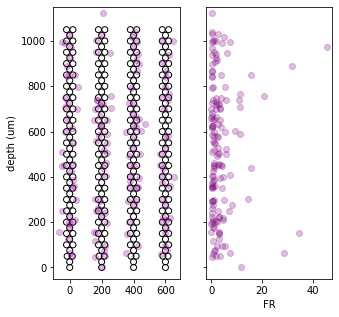

In [6]:
#visualize the clusters cross the probs
#Vision's output selects for only 'good' neurons, the other clusters are not returned
fig, axs = plt.subplots(1,2, figsize = (5,5), sharey=True)    

axs[0].scatter(chanposition[:,1], chanposition[:,0], facecolors='None', edgecolors='k')
axs[0].scatter(basicinfo['y'],basicinfo['x'], c='purple', alpha=0.25, vmin=0, vmax=2)
axs[0].set_ylim(-50,1150)
axs[0].set_ylabel('depth (um)')
axs[1].set_xlabel('span (um)')
axs[1].set_xlabel('FR')
print(fr.shape)
print(basicinfo['x'].shape)
im1 = axs[1].scatter(fr, np.squeeze(basicinfo['x']),  c='purple', alpha = 0.25)

plt.savefig('cluster_loc_wnoise.png', dpi=300)
plt.show()

Assessing 8 between 0.0 - 214.66 min(s), total of 215 bins


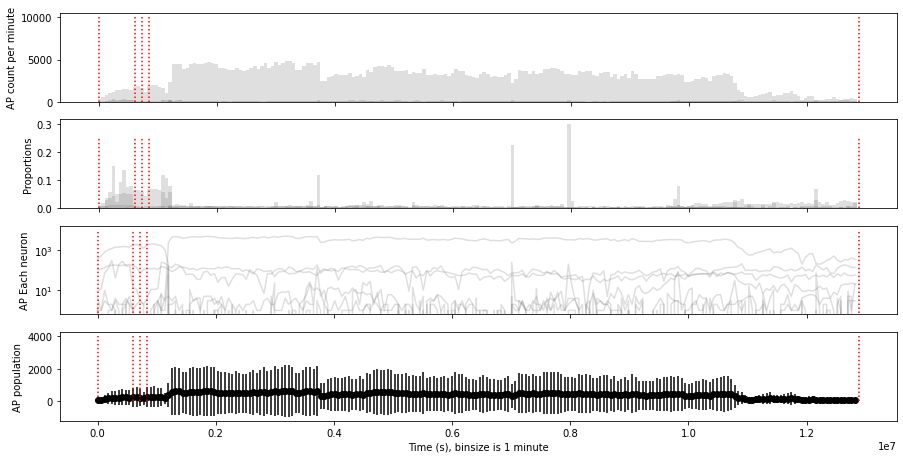

53.75
[  0   1   2   3   4  10  30 100]
[  6 107  16  61 152   0 135 194] 53.75
[ True False  True False False  True False False]
[0, 2, 5]


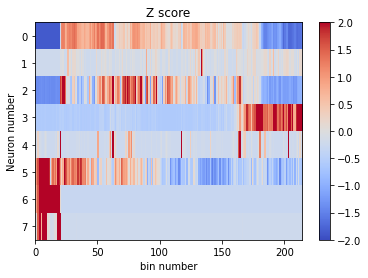

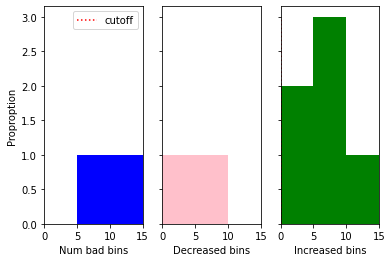

Good neuron: 0; number of bad bin(s): 6 (bins are size of a minute of data)


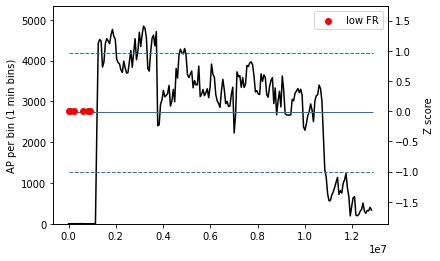

Bad neuron: 1; number of bad bin(s): 107 (bins are size of a minute of data)


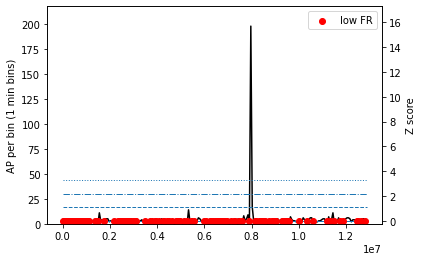

Good neuron: 2; number of bad bin(s): 16 (bins are size of a minute of data)


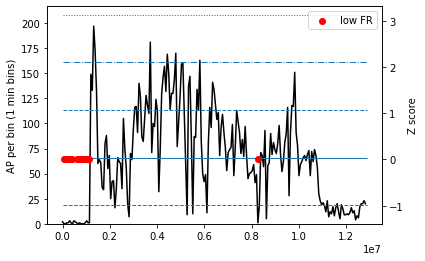

Bad neuron: 3; number of bad bin(s): 61 (bins are size of a minute of data)


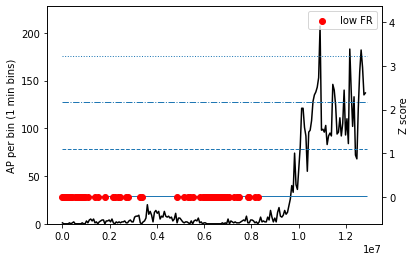

Bad neuron: 4; number of bad bin(s): 152 (bins are size of a minute of data)


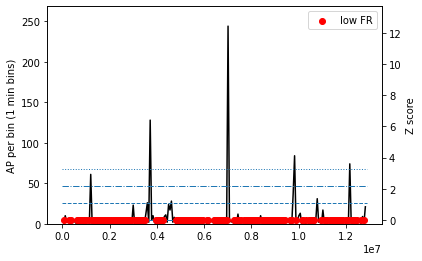

Good neuron: 10; number of bad bin(s): 0 (bins are size of a minute of data)


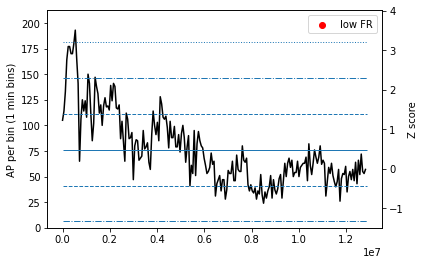

Bad neuron: 30; number of bad bin(s): 135 (bins are size of a minute of data)


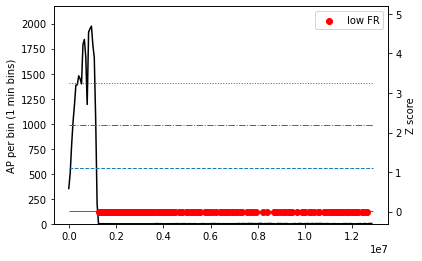

Bad neuron: 100; number of bad bin(s): 194 (bins are size of a minute of data)


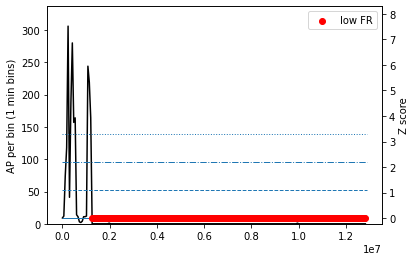


Consistent neurons 3/8: 37.5%
[ 0  2 10]


In [426]:
def consistentNeurons(asdf, datasep, neuronlist=[], minfiring = 1, fraction=0.25, vis = True, vis_ind=True):
    
    if len(neuronlist)==0:
        nneur = asdf.shape[0]
        neuronlist = np.arange(nneur)
    else:
        nneur = len(neuronlist)
        neuronlist = np.array(neuronlist)

    start_of_rec = datasep[0]
    end_of_rec = datasep[-1]

    nbins = int(np.ceil((end_of_rec-start_of_rec)/1000/60))#each bin a minute
    binsz = (end_of_rec-start_of_rec)/nbins
    bins = np.arange(start_of_rec, end_of_rec+binsz, binsz)
    print('Assessing {0} between {1} - {2} min(s), total of {3} bins'.format(nneur, np.round(start_of_rec/1000/60,2),
                                                                            np.round(end_of_rec/1000/60,2),nbins))
    
    wnums = np.zeros((nneur, nbins))
    nums = np.zeros((nneur, nbins))

    for n, neuron in enumerate(asdf[neuronlist]):
        neur = np.squeeze(neuron)
        nap = neur.shape[0]
        N, edges = np.histogram(neur, weights=np.ones(nap)/nap, bins=bins)
        try:
            wnums[n] = N
        except:
            wnums = np.zeros((nneur, N.shape[0]))
            nums = np.zeros((nneur, N.shape[0]))
            wnums[n] = N
        N, edges = np.histogram(neur, bins=bins)
        nums[n] = N
    
    if vis:
        fig, axs = plt.subplots(4,1, figsize = (15,7.5), sharey=False)
        alpha = 1/nneur*10
        if alpha > 1:
            alpha=0.25
        if alpha < 0.1:
            alpha=0.1
        for n, neuron in enumerate(asdf[neuronlist]):
            axs[0].bar(edges[:-1], nums[n], width=binsz, color='grey', alpha=alpha)
            axs[1].bar(edges[:-1], wnums[n], width=binsz, color='grey', alpha=alpha)
            axs[2].plot(edges[:-1], nums[n], color='grey', alpha=alpha)

        meanN = np.mean(nums, axis=0)#by bin
        stdN = np.std(nums, axis=0)
    
        axs[3].scatter(edges[:-1], meanN, color='k')
        axs[3].errorbar(edges[:-1], meanN, yerr=stdN, color='k')

        axs[0].vlines(datasep, 0, 10000, linestyle=':', color='r')
        axs[1].vlines(datasep, 0, 0.25, linestyle=':', color='r')
        axs[2].vlines(datasep, 0, 10000, linestyle=':', color='r')
        axs[3].vlines(datasep, 0, 4000, linestyle=':', color='r')
        axs[2].set_yscale('log')

        axs[0].set_ylabel('AP count per minute')
        axs[1].set_ylabel('Proportions')
        axs[2].set_ylabel('AP Each neuron')
        axs[3].set_ylabel('AP population')

        axs[0].set_xticklabels([])
        axs[1].set_xticklabels([])
        axs[2].set_xticklabels([])
        axs[3].set_xlabel('Time (s), binsize is 1 minute')

        plt.show()

    #calculate zscore
    meanNeuron = np.mean(nums, axis=1)#by neuron
    stdNeuron = np.std(nums, axis=1)
    zscore = (nums.T - meanNeuron)/stdNeuron #zscore

    zscorecopy = zscore.copy()*0
    
    zscorecopy[zscore<-2]=-1 #underperforming bins
    zscorecopy[nums.T<minfiring]=-1 #underperforming bins
    zscorecopy[zscore>2]=1 #exceeding bins  

    bin_allow = nbins*fraction #determins how many 'bad' bins are acceptable 
    summed = np.abs(np.sum(zscorecopy>=0, axis=0)-nbins) #number of bad bins per neuron

    consistent_neurons = list(np.where(summed<bin_allow)[0].astype(int))

    if vis: 
        #visualize Z scores
        plt.imshow(zscore.T, aspect='auto', cmap='coolwarm', vmin=-2, vmax=2, interpolation='none')
        plt.title('Z score')
        plt.ylabel('Neuron number')
        plt.xlabel('bin number')
        plt.colorbar()
        plt.show()
        
        #visualize choice histograms
        nmax = 0
        binsz = 5
        bins=np.arange(0, nneur*1.5+binsz, binsz)
        fig, axs = plt.subplots(1,3, sharey=True)
        n, edge, _ = axs[0].hist(nbins-np.sum(zscorecopy==0, axis=0), width=binsz,bins=bins, alpha=1, color='blue')
        if nmax < np.max(n): nmax = np.max(n)
        n, edge, _ = axs[1].hist(np.sum(zscorecopy==-1, axis=0), width=binsz, bins=bins, alpha=1, color='pink')
        if nmax < np.max(n): nmax = np.max(n)
        n, edge, _ = axs[2].hist(np.sum(zscorecopy==1, axis=0), width=binsz, bins=bins, alpha=1, color='green')
        if nmax < np.max(n): nmax = np.max(n)

        axs[0].vlines(bin_allow, 0, nmax, color='red', linestyle = ':', label='cutoff')
        axs[1].vlines(bin_allow, 0, nmax, color='red', linestyle = ':')
        axs[2].vlines(0, 0, nmax, color='red', linestyle = ':')
            
        axs[0].set_ylabel('Proproption')
        axs[0].set_xlabel('Num bad bins')
        axs[1].set_xlabel('Decreased bins')
        axs[2].set_xlabel('Increased bins')
        axs[0].set_xlim(bins[0], bins[-1])
        axs[1].set_xlim(bins[0], bins[-1])
        axs[2].set_xlim(bins[0], bins[-1])
        axs[0].legend()
        plt.show()
        
    if vis_ind:
    # show each neuron individually
        linestyles=[':','-.','--','-','--','-.',':']
        meanNeuron = np.mean(nums, axis=1)
        stdNeuron = np.std(nums, axis=1)

        for n, neur in enumerate(neuronlist):
            if n in consistent_neurons:
                print('Good neuron: {0}; number of bad bin(s): {1} (bins are size of a minute of data)'.format(neur, summed[n]))
            else:
                print('Bad neuron: {0}; number of bad bin(s): {1} (bins are size of a minute of data)'.format(neur, summed[n]))
            fig, axs = plt.subplots(1,1)
            axs.plot(edges[:-1], nums[n], color='k', label='AP count')
            nstdev = stdNeuron[n]
            nmean = meanNeuron[n]
            lines = [nmean-3*nstdev, nmean-2*nstdev, nmean-nstdev, 
                     nmean, nmean+nstdev, nmean+2*nstdev, nmean+3*nstdev]
            for l, line in enumerate(lines):
                axs.hlines(line, datasep[0], datasep[-1], linestyle=linestyles[l], linewidth = 1)

            axs.set_ylim(0,np.max(nums[n])*1.1)
            axs.set_ylabel('AP per bin (1 min bins)')

            axs2 = axs.twinx()
            badbin = np.where(zscorecopy.T[n]==-1)[0]
            axs2.scatter(edges[badbin], np.zeros(len(badbin)), color='red', label='low FR')
            axs2.set_ylabel('Z score')
            axs2.set_ylim(np.min(zscore.T[n]),np.max(zscore.T[n])*1.2)
            axs2.legend()
            plt.show()

    print('\nConsistent neurons {0}/{1}: {2}%'.format(len(consistent_neurons), nneur, np.round(len(consistent_neurons)/nneur*100,2)))

    return neuronlist[np.array(consistent_neurons).astype(int)]

consistent_neurons = consistentNeurons(asdf,#matrix of neurons with spike times
                                      datasep[:],#which datasets to assess
                                      neuronlist=[0,1,2,3,4,10,30,100],#list of neurons to assess
                                      minfiring = 2, #min number of AP per minute 
                                      fraction=0.25, #fraction of mins to allow to be low FR 
                                      vis=True, #vizualize populations
                                      vis_ind=True) #vizualize each individual neuron

print(consistent_neurons)


# KILOSORT LOAD DATA AND VISUALIZE

In [27]:
kilosortloc = '/media/feldheimlab/Seagate Expansion Drive/2023-10-26-0/data001data002/'
rate = 20000

#spikes information
#spike cluster in order of event
spiketemplates = np.load(os.path.join(kilosortloc, 'kilosort3/spike_clusters.npy')) # to make asdf
#event times
spiketimes = np.load(os.path.join(kilosortloc, 'kilosort3/spike_times.npy')) # to make asdf
#waveforms for original clusters
templates = np.load(os.path.join(kilosortloc, 'kilosort3/templates.npy')) #waveforms

#cluster information from kilosort
cluster = pd.read_csv(os.path.join(kilosortloc, 'kilosort3/cluster_info.tsv'), sep='\t') #class 
print(cluster.head())

#get session/data separations times 
datasep = np.squeeze(np.load(os.path.join(kilosortloc, 'datasep.npy')))*1000/rate 

if os.path.exists(os.path.join(kilosortloc, 'kilosort3/ttlTimes.npy')):
    rised = np.load(os.path.join(kilosortloc, 'kilosort3/ttlTimes.npy'))
else:
    #created from rhd files Save the ttl times in a file so we don't have to determine this every time
    print('TTL files not found, creating TTL files')
    digital = np.load(os.path.join(kilosortloc, 'digital.npy')) #get digital timecourse to determine ttls
    rised2 = ttl_rise(digital[0], rate=rate) #ttl from auditory info
    print(rised.shape)
    laser = ttl_rise(digital[2], rate=rate) #ttl from laser info (this is useless if auditory stimulation occurs indepent of )
    print(laser.shape)
    np.save(os.path.join(kilosortloc, 'kilosort3/ttlTimes.npy'), rised)
    np.save(os.path.join(kilosortloc, 'kilosort3/ttlTimes-laser.npy'), laser)
    digital = None

#load channel maps
chanposition = probeMap(probe='AN')

#create asdf strucured array, each index is a new neuron
neuron_clust = np.unique(spiketemplates)#determine unique clusters from the spiketemplates 
max_clust = np.max(neuron_clust)
asdf = np.empty((max_clust), dtype=object)

for n in np.arange(max_clust):
    if n in neuron_clust:
        try:
            asdf[n]=np.squeeze(spiketimes[spiketemplates==n])*1000/rate
        except:
            print(n)
            asdf[n]=np.ones(1)*np.nan
    else:
        asdf[n]=np.ones(1)*np.nan


   cluster_id  Amplitude  ContamPct KSLabel         amp  ch  depth        fr  \
0           1     3031.1      100.0    good  151.431992  50  150.0  2.157884   
1           2     1978.1      100.0    good  101.240036  51  100.0  7.839135   
2           3     2185.3      100.0    good  138.159164  50  150.0  0.694532   
3           5     2004.7      100.0     mua  135.457275  49  200.0  1.671782   
4           8     2914.2      100.0    good  180.831085  50  150.0  4.492022   

  group  n_spikes  sh  
0  good     27363   0  
1  good     99404   0  
2  good      8807   0  
3  good     21199   0  
4  good     56961   0  


In [28]:
# breaking down the cluster types
neurons = cluster[cluster['group']=='good']
neurons = neurons.append(cluster[cluster['group']=='mua'])

groups = ['good', 'mua', 'noise']
# aud_resp = [5,46,72,73,75,80,82,92,111,112,169,170,172,338,342,408]
aud_resp = []
for group in groups:
    frac = len(cluster[cluster['group']==group])/len(cluster)
    print('{0} fraction {1}/{2}: {3}%'.format(group, len(cluster[cluster['group']==group]), 
                                             len(cluster), np.round(frac*100, 2)))
print('\n')    
for group in groups:
    frac = len(neurons[neurons['group']==group])/len(neurons)
    if group == 'good':
        frac2 = len(aud_resp)/len(neurons[neurons['group']==group])
        print('good and auditory responsive fraction {0}/{1}: {2}%'.format(len(aud_resp), len(neurons[neurons['group']==group]), 
                                              np.round(frac2*100, 2)))  
    print('{0} fraction {1}/{2}: {3}%'.format(group, len(neurons[neurons['group']==group]), 
                                             len(neurons), np.round(frac*100, 2)))


good fraction 235/970: 24.23%
mua fraction 731/970: 75.36%
noise fraction 4/970: 0.41%


good and auditory responsive fraction 0/235: 0.0%
good fraction 235/966: 24.33%
mua fraction 731/966: 75.67%
noise fraction 0/966: 0.0%


/tmp/ipykernel_53819/2162746941.py:3: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  neurons = neurons.append(cluster[cluster['group']=='mua'])


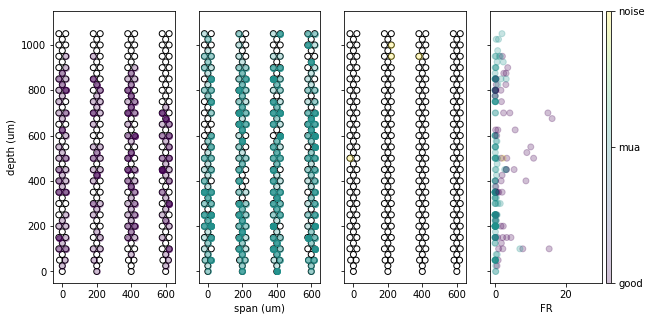

In [29]:
#visualize where the clusters are located across the probe
cluster['group_c'] = cluster['group']
for i, group in enumerate(groups):
    cluster.loc[cluster[cluster['group']==group].index, 'group_c'] = int(i)

fig, axs = plt.subplots(1,4, figsize = (10,5), sharey=True)    
for j, group in enumerate(groups):
    axs[j].scatter(chanposition[:,1], chanposition[:,0], facecolors='None', edgecolors='k')
    clust = cluster[cluster['group']==group].copy()
    for index in clust.index:
        pos = chanposition[clust.loc[index, 'ch']]
        color=clust.loc[index, 'group_c']
        axs[j].scatter(pos[1], pos[0], c=color, alpha=0.25, vmin=0, vmax=2)
        axs[j].set_ylim(-50,1150)
        
axs[0].set_ylabel('depth (um)')
axs[1].set_xlabel('span (um)')
axs[3].set_xlabel('FR')

im1 = axs[3].scatter(cluster['fr'], cluster['depth'],  c=cluster['group_c'], alpha = 0.25)
divider = make_axes_locatable(axs[3])

cax = divider.append_axes('right', size='5%', pad=0.05)
cbar = fig.colorbar(im1, cax =cax , orientation='vertical')
cbar.set_ticks([0,1,2])
cbar.set_ticklabels(groups)
plt.savefig('cluster_loc_wnoise.png', dpi=300)
plt.show()

# PIPELINE (both Vision and Kilosort)

In [12]:
def chiSquaredTest(data, modelfit, params, plot=False, savepath=None):
    
    normdata = np.sum(data)*modelfit/np.sum(modelfit)
    
    chiresults = stats.chisquare(data, normdata)
    df = data.size-len(params)
    print(chiresults)
    print('Chi squared per degrees freedom: ', chiresults.statistic/df)
    if plot:
        try:
            chibins = np.arange(0,df*3,0.1)
        except:
            chibins = np.arange(0,100,0.1)
            
        fig, axs = plt.subplots(1,2)
        axs[0].title.set_text('Chi2 test')
        axs[0].set_ylabel('probability')
        axs[0].set_xlabel('Chi2 statistic')

        axs[0].plot(chibins, stats.chi2.pdf(chibins, df=df))
        axs[0].vlines(chiresults.statistic,0,0.05, 'r')
        axs[0].text(chiresults.statistic,0.05, 'p-value: {}'.format(np.round(chiresults.pvalue,2)))
        axs[1].scatter(data,  modelfit, c='k')
        maxval = np.max(data)
        if any(maxval < modelfit):
            maxval = np.max(modelfit)
        axs[1].set_xlim(0,maxval)
        axs[1].set_ylim(0,maxval)
        axs[1].plot([0, maxval],[0, maxval], linestyle=':', color='k')
        axs[0].title.set_text('Chi2 test')
        axs[1].set_ylabel('fit values')
        axs[1].set_xlabel('actual values')
        plt.tight_layout()
        if savepath is not None:
            print('saving to :', savepath)
            plt.savefig(savepath, dpi=300)
        plt.show()

def kent(xyz, 
         height, 
         beta, kappa, gamma1, gamma2, gamma3):
#, base):
    kent_dist = height * np.exp(-kappa) * np.exp(kappa * np.dot(xyz, gamma1) + 
            beta * kappa * (np.dot(xyz, gamma2)**2 - np.dot(xyz, gamma3)**2)) 
#- base 
    return np.squeeze(kent_dist)

def kentdist(kappa, beta, theta, phi, alpha, height, 
             #base, 
             xyz):

    units = sphericalUnit(theta, phi)
    gamma1 = units[:, 0]

    gamma2 = rodrot(units[:, 1], units[:, 0], alpha)
    gamma3 = rodrot(units[:, 2], units[:, 0], alpha)
    
    return kent(xyz, height, beta, kappa, gamma1, gamma2, gamma3)
    #, base)

def kentRandStart():
    kappa = np.random.uniform(low=0, high=100, size=1)
    beta = np.random.uniform(low=-0.5, high=0.5, size=1)
    theta = np.random.uniform(low=0, high=np.pi/2, size=1)
    phi =  np.random.uniform(low = -144 / 180 * np.pi, high = 144 / 180 * np.pi, size=1)
    alpha = np.random.uniform(low = -2*np.pi, high = 2*np.pi, size=1)
    height = np.random.uniform(low=0, high=100, size=1)
    # base = np.random.uniform(low=0, high=100, size=1)
    
    params = np.array([kappa, beta, theta, phi, alpha, height])
#, base
   
    return np.squeeze(params)

def fitKent(data, xyz, method='scipy'):
    '''
    X in radians
    Returns (height, xmean, conc)
    '''    
    
    
    
    
    #kappa, beta, theta, phi, alpha, height
    limits = ((0  , -0.5, -np.pi/4, -np.pi, -2*np.pi, 0),
              (100,  0.5,  3*np.pi/2,  np.pi,  2*np.pi, 100))
    
    params = kentRandStart()
    error_function = lambda p: np.ravel(kentdist(*p, xyz) - data)
    results = optimize.least_squares(error_function, params, bounds=limits)
    
    if results.success:
        try:
            p = results.x
            jacobian = results.jac
            cov = np.linalg.inv(jacobian.T.dot(jacobian))
#             cov = jacobian.T.dot(jacobian)
            var = np.sqrt(np.diagonal(cov))
            fun = results.fun
        except Exception as e:
            print(e)
            p = results.x * np.nan
            var = p
            fun = np.nan
    else:
        print(results.message)
        p = results.x * np.nan
        var = p
        fun = np.nan
    
    return p, var, fun

def aic_leastsquare(residuals, params):
    if not np.isnan(residuals).any():
        return residuals.size * np.log(np.std(residuals)) + 2*len(params)

    
def readStimFile(wd, file):   
    lines = []
    n = 0
    with open(os.path.join(wd, file)) as f:
        [lines.append(line.strip()) for line in f.readlines()]
    f.close()
    
    print('Reading file: \n\t', os.path.join(wd, file))
    #get the different stimulations
    
    num_stim1 = lines[2] #stimulation list 1
    num_stim2 = lines[3] #stimulation list 2
    num_stim3 = lines[4] #stimulation list 3
    
    num_stim1 = num_stim1.split(' ')
    num_stim2 = num_stim2.split(' ')
    num_stim3 = num_stim3.split(' ')
    
    if not num_stim2==['']: # if its not empty
        num_stim = [num_stim1, num_stim2]
    
    if not num_stim3==['']: # if its not empty
        num_stim.append(num_stim3)
#     print(num_stim.shape)

    #get the order of stimulations
    for l, line in enumerate(lines[5:]):
        if l == 0:
            first = []
            n0 = 0
            for n, li in enumerate(line):
                if li == ' ':
                    try:
                        first.append(int(line[n0:n]))
                    except Exception as e: e
                    n0=n
            first.append(int(line[n0:]))
            stims = np.zeros((len(lines[4:]), len(first)))*np.nan
            stims[0] = np.array(first) 
        else:
            n0 = 0
            i = 0
            for n, li in enumerate(line):
                if li == ' ':
                    try:
                        stims[l, i] = int(line[n0:n])
                        i+=1
                    except Exception as e: e
                    n0=n      
            stims[l,i] = int(line[n0:])

    stim_ind = np.unique(stims)

    if np.isnan(stim_ind).any():
        n_stim = len(stim_ind)-1
        n_trial = np.sum(stims == 1)
        stims = stims[~np.isnan(stims)].reshape((n_trial, n_stim))
        
    stim_ind = np.unique(stims)             
            
    return stims, num_stim, stim_ind

In [13]:
def f(x):
    return int(x)
f2 = np.vectorize(f)

def sigAudFRCompareSpont(pattern, spont_win, windows, test='poisson', siglvl=0.001, minspike=10):
    
    if type(test) is str:
        test = [test]
    if type(siglvl) is float:
        siglvls = np.zeros(len(test))*siglvl
        siglvls = siglvls.tolist()
    if type(siglvl) is list:
        siglvls = siglvl
        
    assert len(test)==len(siglvls), 'Significance levels and number of testing distributions not equal'
    
    sz = pattern.shape
    nNeu = sz[0]
    nSeg = sz[1]*sz[2]*sz[3]
    nWin = windows.shape[0]
    
    columns = []
    
    if nWin > 1:
        for w in np.arange(nWin):
            ave = 'avg window {0} - {1} ms'.format(windows[w,0], windows[w,1])
            var = 'var window {0} - {1} ms'.format(windows[w,0], windows[w,1])
            columns.extend([ave, var])
    else:
        ave = 'avg window {0} - {1} ms'.format(windows[0,0], windows[0,1])
        var = 'var window {0} - {1} ms'.format(windows[0,0], windows[0,1])
        columns.extend([ave, var])
    
    spave = 'avg window {0} - {1} ms'.format(spont_win[0], spont_win[1])
    spvar = 'var window {0} - {1} ms'.format(spont_win[0], spont_win[1])
    columns.extend([spave, spvar])

    activity_df = pd.DataFrame(columns=columns)

    pvals = np.zeros((nNeu, nWin))
    spont_fr = np.zeros(nNeu)
    dur = np.diff(spont_win)[0]
    spont_fr = PatternToCount(pattern=pattern, timerange=list(spont_win), timeBinSz=dur)*1000/dur
    ns = spont_fr.shape
    activity_df[spave] = np.mean(spont_fr, axis=tuple(range(1, spont_fr.ndim)))
    activity_df[spvar] = np.var(spont_fr, axis=tuple(range(1, spont_fr.ndim)))
    
    activ_fr = np.zeros((nNeu, nWin, 2))
    tested = False
    for w in np.arange(nWin):
        window = windows[w]
        ave = 'avg window {0} - {1} ms'.format(windows[w,0], windows[w,1])
        var = 'var window {0} - {1} ms'.format(windows[w,0], windows[w,1])
        dur = np.diff(window)
    
        fr = PatternToCount(pattern=pattern,timerange=list(window), timeBinSz=dur)*1000/dur
        ns = spont_fr.shape
        activity_df[ave] = np.mean(fr, axis=tuple(range(1, spont_fr.ndim)))
        activity_df[var] = np.var(fr, axis=tuple(range(1, spont_fr.ndim)))
        
        if 'poisson' in test:
            tested = True
            ind = test.index('poisson')
            pval = 'poisson pval compare win {0} - {1}'.format(str(w), nWin)
            activity_df[pval] = poisson.cdf(activity_df[ave]*dur*nSeg/1000, mu=activity_df[spave]*dur*nSeg/1000)
                        
            pospval = 1 - activity_df[pval]
            
            possig = pospval <= siglvls[ind] #positive significance
            negsig = activity_df[pval] <= siglvls[ind] #negative significance
            
            fr_limit = activity_df[ave]*dur/1000 >= minspike
#             possig[fr_limit] = False 
#             negsig[fr_limit] = False
            
            possig[activity_df[var]==0]=False
            negsig[activity_df[var]==0]=False

            print('Window {0}: Identified significant reposive neurons that {1} increased and {2} decreased firing rates out of {3} with {4} test.'.format(str(w), np.sum(possig), np.sum(negsig),len(possig), 'poisson'))
            pflag = 'poisson win {0} pos'.format(str(w))
            nflag = 'poisson win {0} neg'.format(str(w))
            activity_df[pflag] = possig
            activity_df[nflag] = negsig
        
        if 'quasipoisson' in test:
            tested = True
            ind = test.index('quasipoisson')
            pval = 'quasipoisson pval compare win {0} - {1}'.format(str(w), nWin)
            
            segdisper = activity_df[spave]/activity_df[spvar]
            
            activity_df[pval] = poisson.cdf(activity_df[ave]*dur*nSeg/1000/segdisper, mu=activity_df[spave]*dur*nSeg/1000/segdisper)
            
            pospval = 1 - activity_df[pval]
            
            possig = pospval <= siglvls[ind] #positive significance
            negsig = activity_df[pval] <= siglvls[ind] #negative significance
            
            fr_limit = activity_df[ave]*dur/1000 >= minspike
#             possig[fr_limit] = False 
#             negsig[fr_limit] = False
            
            possig[activity_df[var]==0]=False
            negsig[activity_df[var]==0]=False
            print('Window {0}: Identified significant reposive neurons that {1} increased and {2} decreased firing rates out of {3} with {4} test.'.format(str(w), np.sum(possig), np.sum(negsig),len(possig), 'quasipoisson'))
            pflag = 'quasipoisson win {0} pos'.format(str(w))
            nflag = 'quasipoisson win {0} neg'.format(str(w))
            activity_df[pflag] = possig
            activity_df[nflag] = negsig
        
        if 'nbinom' in test:
            tested = True
            ind = test.index('nbinom')
            pval = 'nbinom pval compare win {0} - {1}'.format(str(w), nWin)
            n = activity_df[spave]**2 * dur*nSeg/1000/(activity_df[spvar]-activity_df[spave])
            p = activity_df[spave]/activity_df[spvar]
            activity_df[pval] = nbinom.cdf(activity_df[ave]*dur*nSeg/1000, n, p)
            
            pospval = 1 - activity_df[pval]
            
            possig = pospval <= siglvls[ind] #positive significance
            negsig = activity_df[pval] <= siglvls[ind] #negative significance
            
            fr_limit = activity_df[ave]*dur/1000 >= minspike
#             possig[fr_limit] = False 
#             negsig[fr_limit] = False
            
            possig[activity_df[var]==0]=False
            negsig[activity_df[var]==0]=False
            print('Window {0}: Identified significant reposive neurons that {1} increased and {2} decreased firing rates out of {3} with {4} test.'.format(str(w), np.sum(possig), np.sum(negsig),len(possig), 'nbinom'))
            pflag = 'nbinom win {0} pos'.format(str(w))
            nflag = 'nbinom win {0} neg'.format(str(w))
            activity_df[pflag] = possig
            activity_df[nflag] = negsig
        
        assert tested, "Testing distribution not specified or unknown testing distribution.\n\
                           Possible tests: poisson, quasipoisson or nbinom"
            
    return activity_df




In [14]:
def PatternToCount(pattern, timerange, timeBinSz = 10, verbose=False):
    # make 4D matrix of firing rates based on the events
    # visualize the firing rate based on the data given
    if timerange is None:
        maxtime = 2000
        mintime = 0
    elif not isinstance(timerange, list):
        mintime = 0
        maxtime = timerange
    elif len(timerange) == 1:
        mintime = 0
        maxtime = timerange[0]
    elif len(timerange)==2:
        mintime = timerange[0]
        maxtime = timerange[1]
    
        
    dur = maxtime - mintime
    
    bins = np.arange(mintime, maxtime+timeBinSz, timeBinSz)
    
    ns = pattern.shape

#     assert len(ns)<5, 'Give only patterns of shape (n neurons, nx, nrep) or (n neurons, nx, ny, nrep)'
    
    if len(ns) == 5:
        fr = np.zeros((ns[0], ns[1], ns[2], ns[3], ns[4], int(bins.shape[0]-1)))
        for n in np.arange(ns[0]):
            for x in np.arange(ns[1]):
                for y in np.arange(ns[2]):
                    for l in np.arange(ns[3]):
                        for t in np.arange(ns[4]):
                            try:
                                xs = np.squeeze(pattern[n,x,y,l,t])
                                fr[n,x,y,l,t], _ = np.histogram(xs, bins=bins)
                            except:
                                fr[n,x,y,l,t] = np.zeros(int(bins.shape[0]-1))
    elif len(ns) ==4:
        fr = np.zeros((ns[0], ns[1], ns[2], ns[3], int(bins.shape[0]-1)))
        for n in np.arange(ns[0]):
            for x in np.arange(ns[1]):
                for y in np.arange(ns[2]):
                    for t in np.arange(ns[3]):
                        try:
                            xs = np.squeeze(pattern[n,x,y,t])
                            fr[n,x,y,t], _ = np.histogram(xs, bins=bins)
                        except:
                            fr[n,x,y,t] = np.zeros(int(bins.shape[0]-1))
    elif len(ns) ==3:
        fr = np.zeros((ns[0], ns[1], ns[2], int(bins.shape[0]-1)))
        for n in np.arange(ns[0]):
            for x in np.arange(ns[1]):
                for t in np.arange(ns[2]):
                    try:
                        xs = np.squeeze(pattern[n,x,y,t])
                        fr[n,x,t], _ = np.histogram(xs, bins=bins)
                    except:
                        fr[n,x,t] = np.zeros(int(bins.shape[0]-1))
                        
    else:
        assert 'Unknown pattern shape'
    return fr

def patternGen(asdf, ttls, stims, num_stim, ttl_trig,  window=0, force=False):
    if window == 0:
        window=[0,2000]
    
    stim_indices = np.unique(stims)
    
    n_trial, n_stim = stims.shape
    print('\nTrials: ', n_trial, '\nStimulations: ', n_stim)

    n_neurons = asdf.shape[0]
    n_ttls = ttls.shape[0]
    print('Nuerons:', n_neurons)
    if n_stim != len(num_stim):
        sz = []
        for stim in num_stim:
            sz.append(len(stim))
        n_diff_stim = len(num_stim)
    else:
        n_diff_stim = 1
        sz = 1

    print('TTLs found: ', n_ttls, '\nPresentations in stimfile: ', n_trial*n_stim)
    if n_ttls != n_trial*n_stim:
        print('\nNumber of stimulations do not match the number of ttls captured')
        assert force, 'If you would like to proceed, assumptions of some stimuli will occur. Use the force parameter to continue.'
        print('\t{} seconds of recording'.format(np.round(ttls[-1]-ttl_trig, 2)))
        print('\tFORCED APPROX OF TTLS WILL HAPPEN!')
    
    #Make ttl array in the same format as the stims array (this step makes indexin easy)
    ttlarray = np.zeros((n_trial, n_stim))
    lastttl = ttls[0]
    stim = 0
    trial = 0
    i =0
    
    for t, ttl in enumerate(ttls):
        if force:
            if ((ttl-lastttl) > 1500):#THIS IS ASSUMING LAGER THAN 1.5sec WILL BE APPROXIMATED! (ONLY WHEN FORCED)
                i+=1
                ttlarray[trial, stim] = lastttl+1000
                stim = (stim+1) % n_stim
                if stim == 0:
                    trial = (trial+1) % n_trial
               
                if ((ttl-lastttl) > 2500):
                    ttlarray[trial, stim] = lastttl+2000
                    stim = (stim+1) % n_stim
                    if stim == 0:
                        trial = (trial+1) % n_trial

                assert ((ttl-lastttl) < 3500), 'Too complicated a fix: {0} - {1} = {2}'.format(ttl, lastttl, ttl-lastttl) 
                        
                ttlarray[trial, stim] = ttl
            else:
                ttlarray[trial, stim] = ttl
        else:
            ttlarray[trial, stim] = ttl
        stim = (stim+1) % n_stim
        if stim == 0:
            trial = (trial+1) % n_trial
        lastttl = ttl
        
    if force:
        print('\tUpdated TTLs: ', np.sum(ttlarray!=0))
    laser_stim_ttl = []
    print('\n')
    if n_diff_stim==3:
        pattern = np.empty((n_neurons,sz[0],sz[1],sz[2],n_trial), dtype=object)
        
        for n in np.arange(n_neurons):
            if (n % 100)==0:
                print('Working on neuron ', n)
            neuron = asdf[n]
            if np.isnan(neuron[0]):
                pattern[n] = np.nan
            else:
                for stim in stim_indices:
                    currentstim = np.sort(ttlarray[stims == int(stim)])
                    e, a, l = np.unravel_index(int(stim), sz)
                    if (n==0)&(l==1):
                        laser_stim_ttl.extend(currentstim)
                    for t, trial in enumerate(currentstim):
                         pattern[n,e,a,l,t] = neuron[(neuron>=trial+window[0])&(neuron<(trial+window[1]))]-trial
        
    if n_diff_stim==2:
        pattern = np.empty((n_neurons,sz[0], sz[1], 1, n_trial), dtype=object)
        
        for n in np.arange(n_neurons):
            if (n % 100)==0:
                print('Working on neuron ', n)
            neuron = asdf[n]
            for stim in stim_indices:
                currentstim = np.sort(ttlarray[stims == int(stim)])
                e, a = np.unravel_index(int(stim), sz)
                for t, trial in enumerate(currentstim):
                    pattern[n,e,a,0,t] = neuron[(neuron>=trial+window[0])&(neuron<(trial+window[1]))]-trial
            
    if n_diff_stim==1:
        pattern = np.empty((n_neurons, 1, n_stim, 1, n_trial), dtype=object) 
        
        for n in np.arange(n_neurons):
            if (n % 100)==0:
                print('Working on neuron ', n)
            neuron = asdf[n]
            for s, stim in enumerate(stim_indices):
                currentstim = np.sort(ttlarray[stims == int(stim)])
                for t, trial in enumerate(currentstim):
                    pattern[n,0,s,0,t] = neuron[(neuron>=trial+window[0])&(neuron<(trial+window[1]))]-trial
                    
    print('shape: ', pattern.shape)
    
    return pattern, ttlarray, laser_stim_ttl

def PatternRaster(pattern3d, timerange=None, savepath=None):
    # make/visualize a raster plot based on the data given
    if savepath != None:
        dirname = os.path.dirname(savepath)
        assert os.path.isdir(dirname), 'Directory not found: {}'.format(dirname)
        save = True
    else:
        save = False
        
    ns = pattern3d.shape
    assert len(ns)==3, 'Give only 3d pattern (ny, nx, nrep)'
    #or assume the first three dimensions after squeeze?
    
    if timerange is None:
        maxtime = 1000
        mintime = 0
    elif not isinstance(timerange, list):
        mintime = 0
        maxtime = timerange
    elif len(timerange) == 1:
        mintime = 0
        maxtime = timerange[0]
    elif len(timerange)==2:
        mintime = timerange[0]
        maxtime = timerange[1]
        
    dur = maxtime - mintime
    pattern3d = np.squeeze(pattern3d)
    
    fig, axs = plt.subplots(ns[0], ns[1], figsize=(10,5))
    
    for x in np.arange(ns[0]):
        xpos = ns[0]-x-1
        for y in np.arange(ns[1]):
            for t in np.arange(ns[2]):
                try:
                    xs = np.squeeze(pattern3d[x,y,t])
                    try:
                        ys = np.ones(xs.shape)*t
                    except:
                        ys = np.ones(xs.shape[0])*t
                except Exception as e:
                    print(e)
                    xs = np.nan
                    ys = np.nan
                if np.isnan(xs).any(): continue
                axs[xpos][y].scatter(xs, ys, s=10/ns[2], c='k')
                xs = np.nan
            axs[xpos][y].set_yticks([])
            axs[xpos][y].set_xticks([])
            axs[xpos][y].set_xlim([mintime, maxtime])
            axs[xpos][y].set_ylim([-1, ns[2]+1])
    axs[x][0].set_yticks([0, ns[2]])
    axs[x][0].set_xticks([mintime, maxtime])
    axs[x][0].set_xticklabels([0, dur])
    plt.subplots_adjust(wspace=0, hspace=0)
    if save:
        plt.savefig(savepath, dpi=300)
    plt.show()

In [16]:

# DOESN'T WORK IN A FUNCTION!!
# def sigAudFR_zeta_pvalue(asdf, ttls, datasep, seg, stim_dur=10, 
#     boolPlot = False):# Do we want to plot the results?
    
#     # use minimum of trial-to-trial durations as analysis window size
#     dblUseMaxDur = np.min(np.diff(ttls))

#     # 50 random resamplings should give us a good enough idea if this cell is responsive.
#     # If the p-value is close to 0.05, we should increase this number.
#     intResampNum = 50 

#     # what size of jittering do we want? (multiple of dblUseMaxDur; default is 2.0)
#     dblJitterSize = 2.0

#     # do we want to restrict the peak detection to for example the time during stimulus?
#     # Then put (0, 1) here.
#     tplRestrictRange = (0, np.inf)

#     # do we want to compute the instantaneous firing rate? 
#     boolReturnRate = True

#     # create a T by 2 array with stimulus onsets and offsets so we can also compute the t-test
#     arrEventTimes = np.transpose(np.array([ttls, ttls+stim_dur]))/1000

#     for n, neuron in enumerate(asdf):
#         neur = neuron[(neuron>datasep[seg])&(neuron<datasep[seg+1])]/1000
#         dblZetaP, dZETA, dRate = zetatest(neur, arrEventTimes,
#                                                     dblUseMaxDur=dblUseMaxDur,
#                                                     intResampNum=intResampNum,
#                                                     dblJitterSize=dblJitterSize,
#                                                     boolPlot=boolPlot,
#                                                     tplRestrictRange=tplRestrictRange,
#                                                     boolReturnRate=boolReturnRate)
#         if n == 0:
#             activity_df = pd.DataFrame()
#             vecTime = dRate['vecT']
#             IFR = np.zeros((asdf.shape[0], dRate['vecRates'].shape[0]))
#         IFR[n] = dRate['vecRates']
#         activity.loc[n, 'zeta p'] = dblZetaP
#         activity.loc[n, 't test p'] = dZETA['dblMeanP']

#     return activity_df, IFR, vecTime


# stimdir = '/home/feldheimlab/python/Auditory/stimgen/gen5/'
# savedir = stimdir + 'processed/'
stimdir = '/home/feldheimlab/python/Auditory/stimgen/optogenetic/fullfield_laser/'
savedir = stimdir + 'processed/'
# stimdir = '/Users/ackmanadmin/Documents/python/Auditory/stimgen/muscimol/'

stim_dict = {'seg3':['fullfield_laser.txt', 'kent'],
#            'seg2':'randchord.txt',
#             'seg3':'puretones.txt',
#             'seg4':'BLN_original.txt',
#             'seg5':'horizontal_pupcall_1_120rep.txt',
#             'seg6':'fullfield.txt',
#            'seg7':'randchord.txt',
#             'seg8':'puretones.txt',
#             'seg9':'BLN_original.txt',
#             'seg10':'horizontal_pupcall_1_120rep.txt'
            }


kilosort=False
vision=True
vis = False
noi = 2 #test neuron

if kilosort:
    nNeu = len(cluster[cluster['group']=='good'])

if vision:
    nNeu = asdf.shape[0]#n of neurons


timewindow = [0,2000] #pattern generation window
#determine auditory 
spont_win = [700,1000]
windows = np.array([[5,20]])#,[20,100],[105,120]])
testdist = ['poisson','quasipoisson', 'nbinom']
siglvl = [0.001,0.001,0.001]#[0.001,0.01,0.05]
nWin = windows.shape[0] #n of windows
print(rised.shape)
for key, value in stim_dict.items():
    
    print('New trial:', key, value)
    file = value[0]
    fit = value[1]
    seg = int(key[-1:])
    if len(key) > 4:
        seg = int(key[-2:])
        
    stims, num_stim, stim_ind = readStimFile(stimdir, file)

    if len(num_stim) != len(stim_ind):
        n_stim = 1
        for stim in num_stim:
            n_stim *= len(stim)
        print('Number of stimulations: ', n_stim)
        print(num_stim)
    else:
        print('Number of stimulations: ', len(num_stim))
        print(num_stim)

    print('\nStimulations order: ', stims.shape)
    print(stims)

    print('\nUnique indices: ', stim_ind.shape)
    print(stim_ind)
    print(datasep, seg)
    #get the ttls of interest
    ttls = getTTLseg(seg=seg, ttls=rised, datasets=datasep)
    print(ttls.shape)
    #get the pattern of this dataset
    pattern, ttlarray, laser_stim_ttl = patternGen(asdf, ttls, stims, num_stim, datasep[seg],  window=timewindow, force=False)
#     if vis:
#         PatternRaster(pattern[noi,:,:,0,:], timerange=50)
#         fr = PatternToCount(pattern, timerange=50, timeBinSz = 5, verbose=False)
#         # plot average/SEM
#         ns = fr[noi].shape
#         colormax = np.max(fr[noi])
#         colormin = np.min(fr[noi])
#         mintime = 0
#         maxtime = 50
#         timeBinSz=10
#         bins = np.arange(mintime, maxtime+timeBinSz, timeBinSz)

#         fig, axs = plt.subplots(ns[0], ns[1], figsize=(10,5))

#         for x in np.arange(ns[0]):
#             xpos = ns[0]-x-1
#             for y in np.arange(ns[1]):
#                 im = axs[xpos][y].imshow(fr[noi,x,y,0,::-1], vmin=colormin, vmax=colormax, 
#                                  cmap = 'Reds', aspect='auto', interpolation='none')
#                 axs[xpos][y].set_yticks([])
#                 axs[xpos][y].set_xticks([])
#         axs[x][0].set_yticks([0, ns[2]])
#         axs[x][0].set_yticklabels([ns[2], 0])
#         axs[x][0].set_ylabel('trials')
#         axs[x][0].set_xticks([0,  int(bins.shape[0]-1)])
#         axs[x][0].set_xticklabels([0, 250])
#         axs[x][0].set_xlabel('time(ms)')
#         if (x == (axs.shape[0]-1))&(y == (axs.shape[1]-1)):
#             divider = make_axes_locatable(axs[x][y])
#             cax = divider.append_axes('bottom', size='5%', pad = 0.05)
#             cbar = fig.colorbar(im, cax=cax, orientation='horizontal', 
#                                 ticks=[colormin, colormax], label='count')
#         plt.subplots_adjust(wspace=0, hspace=0)
#         plt.show()
#     print('\nNumber of windows assessed: ', windows.shape[0])
    #identify which cells are auditory responsive
    activity_df = sigAudFRCompareSpont(pattern=np.squeeze(pattern[:,:,:,0]), spont_win=spont_win, 
                                       windows=windows, test=testdist, 
                                       siglvl=siglvl, minspike=stims.size)
    
#     activity_df2, IFR, vecTime = sigAudFR_zeta_pvalue(asdf, ttls, datasep, seg, stim_dur=10, boolPlot = False)
    
#     activity_df[activity_df2.columns] = activity_df2.values
    
#     fit_data = np.array([[None] * nWin] * nNeu)

#     auditory_responive = fit_data.copy()
    
#     for w in range(nWin):
#         auditory_responive[:,w] = (activity_df['poisson win {} neg'.format(str(w))] + activity_df['poisson win {} pos'.format(str(w))]).values[:nNeu]
    
#         if fit == 'kent':
#             param_labels = ['kappa', 'beta', 'theta', 'phi', 'alpha', 'height']
            
#             elev = 90-np.array(num_stim[0]).astype(int)
#             azim = -1*np.array(num_stim[1]).astype(int)
#             azim = azim*np.pi/180
#             elev = elev*np.pi/180
#             try:
#                 laser = np.array(num_stim[2]).astype(int)
#                 parameters = np.zeros([nNeu, 2, len(param_labels)])
#                 variances = np.zeros([nNeu, 2, len(param_labels)])
#                 modelfits = np.zeros([nNeu, 2, len(elev), len(azim)])
#                 data_fits = modelfits.copy()
#                 aic = np.zeros((nNeu,2,2))
#                 sumresid = np.zeros((nNeu,2,2))
#             except:
#                 laser = None
#                 parameters = np.zeros([nNeu, len(param_labels)])
#                 variances = np.zeros([nNeu, len(param_labels)])
#                 modelfits = np.zeros([nNeu, len(elev), len(azim)])
#                 data_fits = modelfits.copy()
#                 aic = np.zeros((nNeu,2))
#                 sumresid = np.zeros((nNeu,2))

#             print('\nFitting kent distribution')

#             print('\tCalculating counts for the window size')
#             data = PatternToCount(pattern=np.squeeze(pattern),timerange=list(windows[w]), timeBinSz=np.diff(windows[w]))

#             for n in range(nNeu):
#                 if laser is not None:            
#                     if auditory_responive[n,w]:

#                             print('\nWorking on {}'.format(n))
#                             for l in laser:
#                                 if l == 0:
#                                     mean_data = np.mean(np.squeeze(data[n,:,:,0]), axis=2)
#                                 else: 
#                                     mean_data = np.mean(np.squeeze(data[n,:,:,1]), axis=2)

#     #                             xs = azimElevCoord(azim, elev, np.mean(np.squeeze(data[n]), axis=2))
#                                 xs = azimElevCoord(azim, elev, np.squeeze(mean_data))
#                                 xyz = xs[:,:3]

#                                 niter = 50 #number of random starts for determining 
#                                 for i in np.arange(niter):
#                                     p, var, residual = fitKent(xs[:,3], xyz)
#                                     fitdist = kentdist(*p, xyz)
#                                     if i == 0:
#                                         param_store = np.zeros((niter, len(p)))
#                                         resid_store = np.zeros(niter)
#                                         var_store = np.zeros((niter, len(p)))
#                                         fun_store = np.zeros(niter)
#                                     resid_store[i] = np.sum(np.abs(residual))
#                                     param_store[i] = p
#                                     var_store[i] = var    
#                                     fun_store[i] = aic_leastsquare(residual, p)

#                                 index = np.nanargmin(fun_store)
#                                 p = param_store[index]        
#                                 var = var_store[index]

#                                 up = fitUniform(mean_data.reshape(mean_data.size), np.arange(mean_data.size))
#                                 ufit = uniform(*up, np.arange(mean_data.size))
#                                 uresidual = ufit.reshape(mean_data.shape)-mean_data
#                                 uaic = aic_leastsquare(uresidual, up)

#                                 fitdist = kentdist(*p, xyz).reshape(mean_data.shape)

#                                 kentres = chiSquaredTest(mean_data.reshape(mean_data.size), fitdist.reshape(fitdist.size), p)

#                                 parameters[n, l] = p
#                                 variances[n, l] = var
#                                 modelfits[n, l] = fitdist
#                                 data_fits[n, l] = mean_data
#                                 aic[n, l] = [uaic, fun_store[index]]
#                                 sumresid[n, l] = [np.sum(np.abs(uresidual)), resid_store[index]]
#                 else:
#                     data = PatternToCount(pattern=np.squeeze(pattern),timerange=list(windows[w]), timeBinSz=np.diff(windows[w]))
#                     if auditory_responive[n,w]:
#                         print('\nWorking on {}'.format(n))
#                         mean_data = np.mean(np.squeeze(data[n]), axis=2)
#                         xs = azimElevCoord(azim, elev, np.mean(np.squeeze(data[n]), axis=2))
#                         xyz = xs[:,:3]

#                         niter = 50 #number of random starts for determining 
#                         for i in np.arange(niter):
#                             p, var, residual = fitKent(xs[:,3], xyz)
#                             fitdist = kentdist(*p, xyz)
#                             if i == 0:
#                                 param_store = np.zeros((niter, len(p)))
#                                 resid_store = np.zeros(niter)
#                                 var_store = np.zeros((niter, len(p)))
#                                 fun_store = np.zeros(niter)
#                             resid_store[i] = np.sum(np.abs(residual))
#                             param_store[i] = p
#                             var_store[i] = var    
#                             fun_store[i] = aic_leastsquare(residual, p)

#                         index = np.nanargmin(fun_store)
#                         p = param_store[index]        
#                         var = var_store[index]

#                         up = fitUniform(mean_data.reshape(mean_data.size), np.arange(mean_data.size))
#                         ufit = uniform(*up, np.arange(mean_data.size))
#                         uresidual = ufit.reshape(mean_data.shape)-mean_data
#                         uaic = aic_leastsquare(uresidual, up)

#                         fitdist = kentdist(*p, xyz).reshape(mean_data.shape)

#                         kentres = chiSquaredTest(mean_data.reshape(mean_data.size), fitdist.reshape(fitdist.size), p)

#                         parameters[n] = p
#                         variances[n] = var
#                         modelfits[n] = fitdist
#                         data_fits[n] = mean_data
#                         aic[n] = [uaic, fun_store[index]]
#                         sumresid[n] = [np.sum(np.abs(uresidual)), resid_store[index]]
                        
#         elif fit == 'gaussian':
#             print('')
#         elif fit == 'vonMises':
#             print('')
#         else: 
#             print('')
#         if fit == 'uniform':
#             print('')
#         else:
#             print('')
            
            
    
#     print(activity_df.columns)



(6300,)
New trial: seg3 ['fullfield_laser.txt', 'kent']
Reading file: 
	 /home/feldheimlab/python/Auditory/stimgen/optogenetic/fullfield_laser/fullfield_laser.txt
Number of stimulations:  170
[['0', '20', '40', '60', '80'], ['-144', '-126', '-108', '-90', '-72', '-54', '-36', '-18', '0', '18', '36', '54', '72', '90', '108', '126', '144'], ['0', '1']]

Stimulations order:  (30, 170)
[[133. 136. 168. ...  67. 117.  47.]
 [138. 126. 157. ...   9.  61. 137.]
 [106. 151.  96. ...  67.  18. 165.]
 ...
 [166. 126.  48. ...  79.  71. 124.]
 [ 77. 137.   5. ...  49.  44.  43.]
 [ 94.  23.  16. ... 115.  51.  30.]]

Unique indices:  (170,)
[  0.   1.   2.   3.   4.   5.   6.   7.   8.   9.  10.  11.  12.  13.
  14.  15.  16.  17.  18.  19.  20.  21.  22.  23.  24.  25.  26.  27.
  28.  29.  30.  31.  32.  33.  34.  35.  36.  37.  38.  39.  40.  41.
  42.  43.  44.  45.  46.  47.  48.  49.  50.  51.  52.  53.  54.  55.
  56.  57.  58.  59.  60.  61.  62.  63.  64.  65.  66.  67.  68.  69.
  70.  

In [22]:
# import scipy
# # %% load and prepare some example data
# # load data for example cell
# strDataFile = os.path.join(os.path.dirname('/home/feldheimlab/Downloads/'), 'ExampleDataZetaTest.mat')
# dLoad = scipy.io.loadmat(strDataFile)

# retrieve the spike times as an array from the field in dNeuron
# vecSpikeTimes1 = dLoad['sNeuron']['SpikeTimes'][0][0]
neuron = asdf[0]
vecSpikeTimes1 = neuron[(neuron>datasep[seg])&(neuron<datasep[seg+1]), np.newaxis]/1000
# vecSpikeTimes2 = dLoad['sNeuron']['SpikeTimes'][0][1]

# # load stimulation information
# sStim = dLoad['sStim']
# vecStimulusStartTimes = sStim['StimOnTime'][0][0][0]  # unpacking Matlab array
# vecStimulusStopTimes = sStim['StimOffTime'][0][0][0]  # unpacking Matlab array
# vecOrientation = sStim['Orientation'][0][0][0]  # unpacking Matlab array
vecStimulusStartTimes = ttls/1000

# # %% calculate instantaneous firing rate without performing the ZETA-test
# # if we simply want to plot the neuron's response, we can use:
# vecTime, vecRate, dIFR = ifr(vecSpikeTimes1, vecStimulusStartTimes)

# # plot results
# f, ax = plt.subplots(1, figsize=(6, 4))
# ax.plot(vecTime, vecRate)
# ax.set(xlabel='Time after event (s)', ylabel='Instantaneous spiking rate (Hz)')
# ax.set(title="A simple plot of the neuron's rate using ifr()")

# # %% run the ZETA-test with default parameters
# # set random seed
# np.random.seed(1)

# # run test
# # t = time.time()
# # dblZetaP = zetatest(vecSpikeTimes1, vecStimulusStartTimes)[0]  # use [0] to return only the p-value
# # dblElapsedT = time.time() - t

# print(f'\nDefault parameters (elapsed time: {dblElapsedT:.2f} s):\np-value: {dblZetaP}')

# # vecSpikeTimes2 = dLoad['sNeuron']['SpikeTimes'][0][1]


# # %% run the ZETA-test with specified parameters
# # set random seed
# np.random.seed(1)

# use minimum of trial-to-trial durations as analysis window size
dblUseMaxDur = np.min(np.diff(vecStimulusStartTimes))

# 50 random resamplings should give us a good enough idea if this cell is responsive.
# If the p-value is close to 0.05, we should increase this number.
intResampNum = 50

# what size of jittering do we want? (multiple of dblUseMaxDur; default is 2.0)
dblJitterSize = 2.0

# Do we want to plot the results?
boolPlot = True

# do we want to restrict the peak detection to for example the time during stimulus?
# Then put (0 1) here.
tplRestrictRange = (0, np.inf)

# do we want to compute the instantaneous firing rate?
boolReturnRate = True

# create a T by 2 array with stimulus onsets and offsets so we can also compute the t-test
# arrEventTimes = np.transpose(np.array([vecStimulusStartTimes, vecStimulusStopTimes]))
arrEventTimes = np.transpose(np.array([ttls, ttls+100]))/1000

# then run ZETA with those parameters
t = time.time()

print(arrEventTimes.shape, arrEventTimes[:10])

# for n in np.arange(6):
#     neuron = asdf[n]
#     vecSpikeTimes1 = neuron[(neuron>datasep[seg])&(neuron<datasep[seg+1]), np.newaxis]/1000
#     dblZetaP, dZETA, dRate = zetatest(vecSpikeTimes1, arrEventTimes,
#                                                     dblUseMaxDur=dblUseMaxDur,
#                                                     intResampNum=intResampNum,
#                                                     dblJitterSize=dblJitterSize,
#                                                     boolPlot=boolPlot,
#                                                     tplRestrictRange=tplRestrictRange,
#                                                     boolReturnRate=boolReturnRate)

#     dblElapsedT2 = time.time() - t
#     print(f"\nSpecified parameters (elapsed time: {dblElapsedT2:.2f} s): \
#           \nzeta-test p-value: {dblZetaP}\nt-test p-value:{dZETA['dblMeanP']}")

(5100, 2) [[839.6924  839.7924 ]
 [842.0624  842.1624 ]
 [844.41345 844.51345]
 [846.77255 846.87255]
 [849.12765 849.22765]
 [851.47665 851.57665]
 [853.8287  853.9287 ]
 [856.17975 856.27975]
 [858.5268  858.6268 ]
 [860.87995 860.97995]]


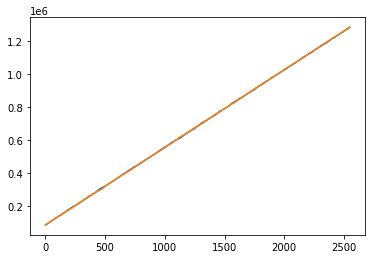

In [17]:
laserttl = np.sort(laser_stim_ttl)
nonlaserttl = np.zeros_like(laserttl)

l=0
s=0
for t in ttls:
    if t==laserttl[l]:
        if l < laserttl.shape[0]-1:
            l=l+1
    else:
        nonlaserttl[s]=t
        s=s+1


# plt.plot(ttls/10)
plt.plot(laserttl/10)
plt.plot(nonlaserttl/10)
plt.show()

In [26]:
import time
dblUseMaxDur = 1.00
# tplRestrictRange = (0,0.02)
tplRestrictRange = (0,0.1)

intResampNum=250
boolPlot=False
boolDirectQuantile=False
dblSuperResFactor=100

nneur = asdf.shape[0]
timedur = np.zeros(nneur)#auditory responsive
timedur2 = np.zeros(nneur)#laser difference

nevents = np.zeros(nneur)
zetapval = np.zeros(nneur)
ttestpval = np.zeros(nneur)
IRFlength = np.zeros(nneur)

ttestpval_laser = np.zeros(nneur)
zetapval_laser = np.zeros(nneur)

boolPlot = False

arrEventTimes = np.transpose(np.array([nonlaserttl, nonlaserttl+100]))/1000
arrLaserEventTimes = np.transpose(np.array([laserttl, laserttl+100]))/1000

for n in np.arange(nneur):
    print('Processing {} neuron, on auditory responsiveness (no laser)'.format(n))
    t = time.time()
    neuron = asdf[n]
    vecSpikeTimes1 = neuron[(neuron>datasep[seg])&(neuron<datasep[seg+1]), np.newaxis]/1000
    dblZetaP, dZETA, dRate = zetatest(vecSpikeTimes1, arrEventTimes,
                                                    dblUseMaxDur=dblUseMaxDur,
                                                    intResampNum=intResampNum,
                                                    dblJitterSize=dblJitterSize,
                                                    boolPlot=boolPlot,
                                                    tplRestrictRange=tplRestrictRange,
                                                    boolReturnRate=boolReturnRate)

    dblElapsedT2 = time.time() - t
    timedur[n]=dblElapsedT2
    nevents[n]=vecSpikeTimes1.shape[0]
    print(f"\t\tSpecified parameters (elapsed time: {dblElapsedT2:.2f} s): \
           \n\t\tzeta-test p-value: {dblZetaP}\n\t\tt-test p-value:{dZETA['dblMeanP']}")
    zetapval[n]=dblZetaP
    ttestpval[n]=dZETA['dblMeanP']
    IRFlength[n]=dRate['vecRate'].shape[0]
    
    #case 2: is neuron 1 responding differently to gratings oriented at 0 and 90 degrees?

    print('\n\tRunning two-sample zeta-test on one neuron, different stimuli (laser vs no laser)')
    t = time.time()
    dblZetaTwoSample2a, dZETA2a = zetatest2(vecSpikeTimes1,  arrEventTimes,
                                           vecSpikeTimes1,  arrLaserEventTimes,
                                           dblUseMaxDur, intResampNum, boolPlot=False)
    dblElapsedT6 = time.time() - t
    
    print(f"\t\tIs neuron {n} responding differently with and without laser? (elapsed time: {dblElapsedT6:.2f} s): \
          \n\t\ttwo-sample zeta-test p-value: {dblZetaTwoSample2a}\n\t\tt-test p-value:{dZETA2a['dblMeanP']}")
    
    ttestpval_laser[n]=dZETA2a['dblMeanP']
    zetapval_laser[n]=dblZetaTwoSample2a
    timedur2[n] = dblElapsedT6

Processing 0 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 505.06 s):            
		zeta-test p-value: 2.4619906113798606e-09
		t-test p-value:1.04689622681109e-25

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 0 responding differently with and without laser? (elapsed time: 183.01 s):           
		two-sample zeta-test p-value: 0.46386097061293563
		t-test p-value:0.5042303388389493
Processing 1 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 3.22 s):            
		zeta-test p-value: 0.019900247351870126
		t-test p-value:0.02864554737776762

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 1 responding differently with and without laser? (elapsed time: 2.24 s):           
		two-sample zeta-test p-value: 0.3754316619619511
		t-test p-value:0.24888332565880836
Processing 2 neuron, on auditory responsiveness (no laser)
		Sp

		Is neuron 17 responding differently with and without laser? (elapsed time: 2.64 s):           
		two-sample zeta-test p-value: 0.6572403628103138
		t-test p-value:0.7605932185168145
Processing 18 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 6.97 s):            
		zeta-test p-value: 0.0016203360271980216
		t-test p-value:0.1283649129774143

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 18 responding differently with and without laser? (elapsed time: 4.01 s):           
		two-sample zeta-test p-value: 0.321371894124147
		t-test p-value:0.6473158396351208
Processing 19 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 16.37 s):            
		zeta-test p-value: 1.454392162258955e-13
		t-test p-value:4.8972022979979465e-89

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 19 responding differently with and without laser? (e

		Specified parameters (elapsed time: 8.95 s):            
		zeta-test p-value: 0.0863567233626763
		t-test p-value:0.014053625985655557

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 35 responding differently with and without laser? (elapsed time: 5.09 s):           
		two-sample zeta-test p-value: 0.6719179995276539
		t-test p-value:0.387379004684694
Processing 36 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 3.88 s):            
		zeta-test p-value: 0.6951902976768524
		t-test p-value:0.17108864014715444

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 36 responding differently with and without laser? (elapsed time: 2.53 s):           
		two-sample zeta-test p-value: 0.804797411429796
		t-test p-value:0.6256130674075926
Processing 37 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 12.03 s):            
		zeta-test p

		Specified parameters (elapsed time: 6.08 s):            
		zeta-test p-value: 0.14595687621682918
		t-test p-value:0.844087949371574

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 53 responding differently with and without laser? (elapsed time: 3.93 s):           
		two-sample zeta-test p-value: 4.958033983371024e-12
		t-test p-value:0.3639766219742616
Processing 54 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 5.97 s):            
		zeta-test p-value: 0.008808985728794072
		t-test p-value:0.3449394597856509

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 54 responding differently with and without laser? (elapsed time: 3.59 s):           
		two-sample zeta-test p-value: 0.03760689459654076
		t-test p-value:0.2360043437918683
Processing 55 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 51.93 s):            
		zeta-t

		Specified parameters (elapsed time: 26.88 s):            
		zeta-test p-value: 0.03248557802290908
		t-test p-value:0.0004007598643876959

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 71 responding differently with and without laser? (elapsed time: 11.94 s):           
		two-sample zeta-test p-value: 0.7649975901423332
		t-test p-value:0.035463936341469104
Processing 72 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 3.52 s):            
		zeta-test p-value: 0.035871137489393634
		t-test p-value:0.13887149584400693

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 72 responding differently with and without laser? (elapsed time: 2.45 s):           
		two-sample zeta-test p-value: 0.39903907561442664
		t-test p-value:0.9999999999937617
Processing 73 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 6.82 s):            
		z

		Is neuron 88 responding differently with and without laser? (elapsed time: 9.48 s):           
		two-sample zeta-test p-value: 8.242660478607888e-07
		t-test p-value:0.01496019631168331
Processing 89 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 3.42 s):            
		zeta-test p-value: 0.0018446426065541477
		t-test p-value:0.26305622642720156

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 89 responding differently with and without laser? (elapsed time: 2.39 s):           
		two-sample zeta-test p-value: 0.681514416330838
		t-test p-value:0.6300531957814081
Processing 90 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 3.91 s):            
		zeta-test p-value: 3.308396428547411e-05
		t-test p-value:5.5148616217148686e-05

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 90 responding differently with and without laser

		Specified parameters (elapsed time: 3.18 s):            
		zeta-test p-value: 0.2927203861535451
		t-test p-value:0.9597371717453484

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 106 responding differently with and without laser? (elapsed time: 2.24 s):           
		two-sample zeta-test p-value: 0.8511853615357945
		t-test p-value:0.5630412329877026
Processing 107 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 3.28 s):            
		zeta-test p-value: 0.011489672815629182
		t-test p-value:0.022293465216520054

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 107 responding differently with and without laser? (elapsed time: 2.28 s):           
		two-sample zeta-test p-value: 0.5800194976013712
		t-test p-value:0.21013334799170755
Processing 108 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 8.54 s):            
		zeta

		Is neuron 123 responding differently with and without laser? (elapsed time: 8.47 s):           
		two-sample zeta-test p-value: 0.28609030999576457
		t-test p-value:0.024711435786553604
Processing 124 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 8.89 s):            
		zeta-test p-value: 0.5579587058072266
		t-test p-value:0.8602962269073752

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 124 responding differently with and without laser? (elapsed time: 4.95 s):           
		two-sample zeta-test p-value: 0.0003790124554309271
		t-test p-value:0.31803449248136384
Processing 125 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 4.82 s):            
		zeta-test p-value: 0.4676031258431632
		t-test p-value:0.26410859854273455

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 125 responding differently with and without laser?

		Specified parameters (elapsed time: 4.83 s):            
		zeta-test p-value: 0.002348515530974704
		t-test p-value:0.4557074637708137

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 141 responding differently with and without laser? (elapsed time: 2.98 s):           
		two-sample zeta-test p-value: 0.8621311826921862
		t-test p-value:0.8593496956849638
Processing 142 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 3.68 s):            
		zeta-test p-value: 2.323363723633065e-12
		t-test p-value:1.4324329673824029e-24

	Running two-sample zeta-test on one neuron, different stimuli (laser vs no laser)
		Is neuron 142 responding differently with and without laser? (elapsed time: 2.49 s):           
		two-sample zeta-test p-value: 0.4589353691802541
		t-test p-value:0.6965017767172152
Processing 143 neuron, on auditory responsiveness (no laser)
		Specified parameters (elapsed time: 13.10 s):            
	

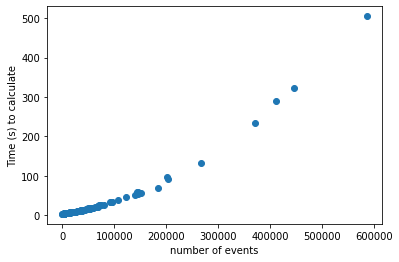

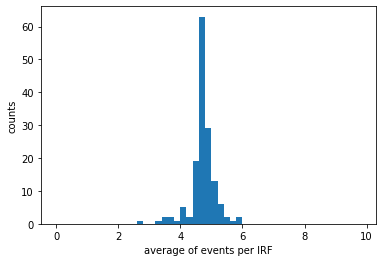

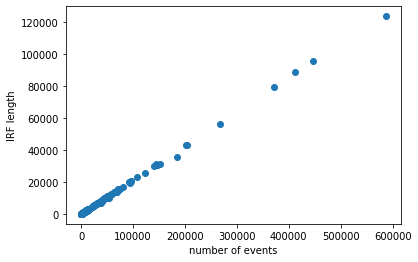

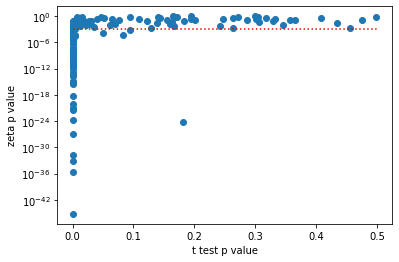

Auditory responsive neurons: 71 significant neurons p<0.001 ZETA
Auditory responsive neurons: 73 significant neurons p<0.001 t-test


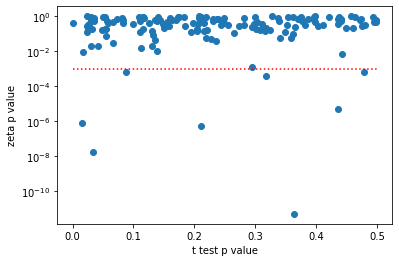

Laser responsive neurons: 8 significant neurons p<0.001 ZETA
Laser responsive neurons: 1 significant neurons p<0.001 t-test


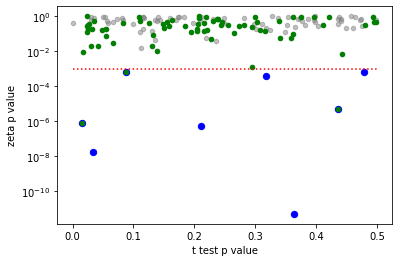

Laser and auditory responisve:  3
Laser only responisve:  5
Auditory only responisve:  68


In [28]:
plt.scatter(nevents, timedur)
# plt.scatter(nevent, timedur, color='r')

plt.ylabel('Time (s) to calculate')
plt.xlabel('number of events')
plt.show()

ntrials = 17*5*30

plt.hist(nevents/IRFlength, bins=np.arange(0,10,10/50))
plt.ylabel('counts')
plt.xlabel('average of events per IRF')
plt.show()

plt.scatter(nevents, IRFlength)
plt.ylabel('IRF length')
plt.xlabel('number of events')
plt.show()

ttestpvalcopy = ttestpval.copy()

ttestpvalcopy[ttestpvalcopy>0.5]=np.abs(ttestpvalcopy[ttestpvalcopy>0.5]-1)

plt.scatter(ttestpvalcopy, zetapval)
# plt.scatter(ttestpvalcopy[nois], zetapval[nois], color='r')

alpha = 0.001
plt.hlines(alpha,0,0.5, color='r', linestyle=':')
plt.ylabel('zeta p value')
plt.xlabel('t test p value')
plt.yscale('log')
# plt.xscale('log')
plt.show()

print('Auditory responsive neurons: {0} significant neurons p<{1} ZETA'.format(np.sum(zetapval < alpha) , alpha))
print('Auditory responsive neurons: {0} significant neurons p<{1} t-test'.format(np.sum(ttestpvalcopy < alpha) , alpha))

ttestpval_lasercopy = ttestpval_laser.copy()

ttestpval_lasercopy[ttestpval_lasercopy>0.5]=np.abs(ttestpval_lasercopy[ttestpval_lasercopy>0.5]-1)


plt.scatter(ttestpval_lasercopy, zetapval_laser)
# plt.scatter(ttestpval_lasercopy[nois], zetapval_laser[nois], color='r')

alpha = 0.001
plt.hlines(alpha,0,0.5, color='r', linestyle=':')
plt.ylabel('zeta p value')
plt.xlabel('t test p value')
plt.yscale('log')
# plt.xscale('log')
plt.show()

print('Laser responsive neurons: {0} significant neurons p<{1} ZETA'.format(np.sum(zetapval_laser < alpha) , alpha))
print('Laser responsive neurons: {0} significant neurons p<{1} t-test'.format(np.sum(ttestpval_lasercopy < alpha) , alpha))



audnois = np.where(zetapval < alpha)[0]
laser = np.where(zetapval_laser < alpha)[0]

plt.scatter(ttestpval_lasercopy, zetapval_laser, color='grey', s=20, alpha = 0.5)
plt.scatter(ttestpval_lasercopy[laser], zetapval_laser[laser], s=40, color='b')
plt.scatter(ttestpval_lasercopy[audnois], zetapval_laser[audnois], s=20, color='g')
plt.hlines(alpha,0,0.5, color='r', linestyle=':')
plt.ylabel('zeta p value')
plt.xlabel('t test p value')
plt.yscale('log')
# plt.xscale('log')
plt.show()


laser_aud = set(audnois)&set(laser)
print('Laser and auditory responisve: ', len(laser_aud))

laseronly = list(set(laser)-set(audnois))
print('Laser only responisve: ', len(laseronly))

audonly = list(set(audnois)-set(laser_aud))
# audonly = list(set(audnois)-set(laser))

print('Auditory only responisve: ', len(audonly))


Processing 88 neuron


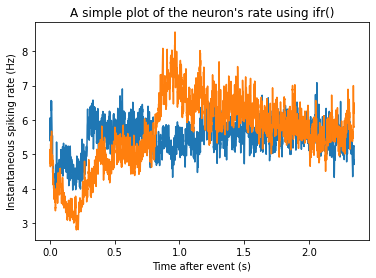


	Running two-sample zeta-test on one neuron, different stimuli


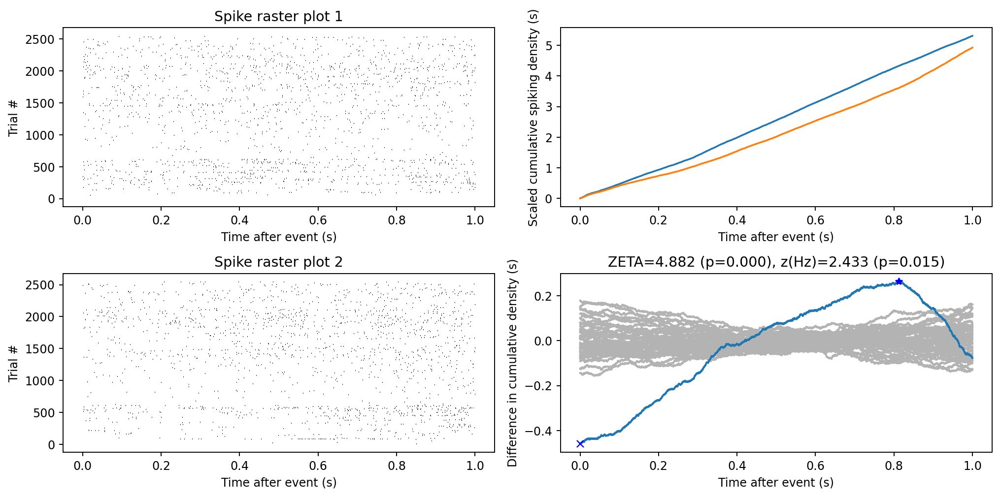

		Is neuron 88 responding differently with and without laser? (elapsed time: 23.76 s):           
		two-sample zeta-test p-value: 1.0523737977718994e-06
		t-test p-value:0.01496019631168331
Processing 14 neuron


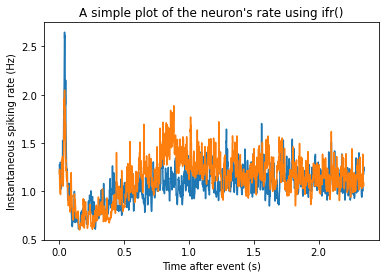


	Running two-sample zeta-test on one neuron, different stimuli


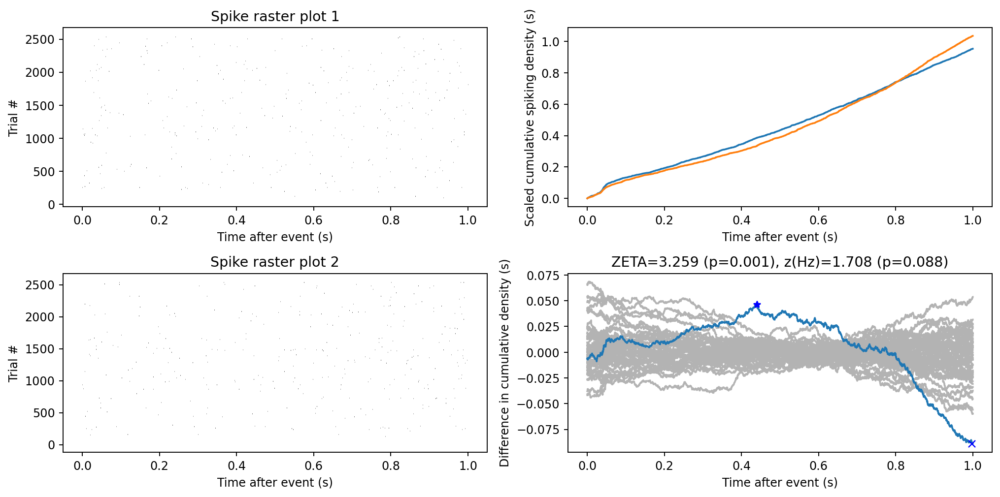

		Is neuron 14 responding differently with and without laser? (elapsed time: 10.26 s):           
		two-sample zeta-test p-value: 0.0011189349581303132
		t-test p-value:0.08767156538351577
Processing 127 neuron


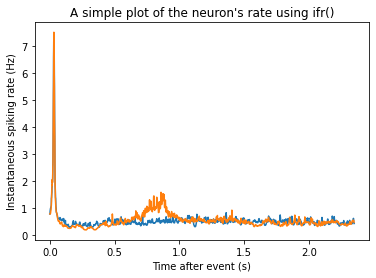


	Running two-sample zeta-test on one neuron, different stimuli


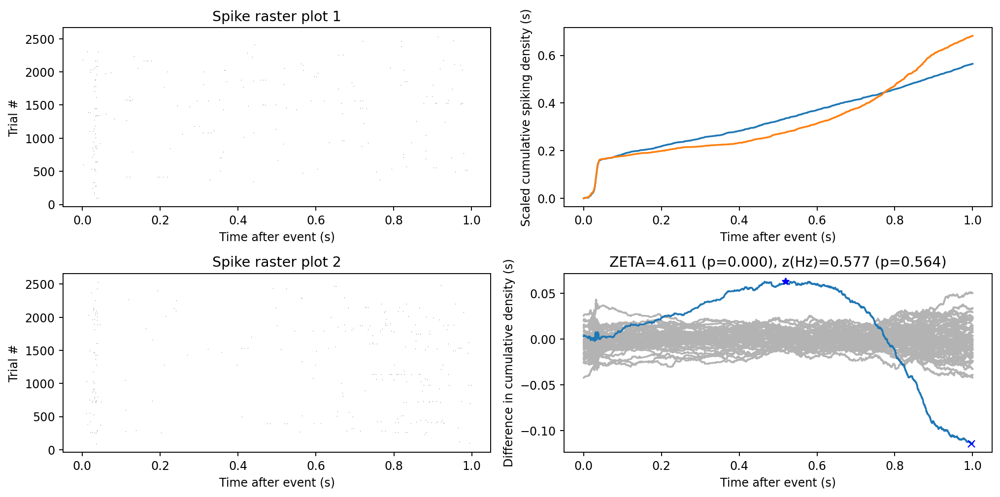

		Is neuron 127 responding differently with and without laser? (elapsed time: 9.46 s):           
		two-sample zeta-test p-value: 4.004554831515961e-06
		t-test p-value:0.5642127098482902


In [30]:
boolPlot = True

for n in laser_aud:
    print('Processing {} neuron'.format(n))
    t = time.time()
    neuron = asdf[n]
    vecSpikeTimes1 = neuron[(neuron>datasep[seg])&(neuron<datasep[seg+1]), np.newaxis]/1000

    vecTime, vecRate, dIFR = ifr(vecSpikeTimes1, arrEventTimes[:,0])
    vecTime_l, vecRate_l, dIFR = ifr(vecSpikeTimes1, arrLaserEventTimes[:,0])

    f, ax = plt.subplots(1, figsize=(6, 4))
    ax.plot(vecTime, vecRate)
    ax.plot(vecTime_l, vecRate_l)
    ax.set(xlabel='Time after event (s)', ylabel='Instantaneous spiking rate (Hz)')
    ax.set(title="A simple plot of the neuron's rate using ifr()")
    plt.show()
    
    
#     dblZetaP, dZETA, dRate = zetatest(vecSpikeTimes1, arrEventTimes,
#                                                     dblUseMaxDur=dblUseMaxDur,
#                                                     intResampNum=intResampNum,
#                                                     dblJitterSize=dblJitterSize,
#                                                     boolPlot=boolPlot,
#                                                     tplRestrictRange=tplRestrictRange,
#                                                     boolReturnRate=boolReturnRate)

#     dblElapsedT2 = time.time() - t
#     timedur[n]=dblElapsedT2
#     nevents[n]=vecSpikeTimes1.shape[0]
#     print(f"\t\tSpecified parameters (elapsed time: {dblElapsedT2:.2f} s): \
#            \n\t\tzeta-test p-value: {dblZetaP}\n\t\tt-test p-value:{dZETA['dblMeanP']}")
#     zetapval[n]=dblZetaP
#     ttestpval[n]=dZETA['dblMeanP']
#     IRFlength[n]=dRate['vecRate'].shape[0]
    
    #case 2: is neuron 1 responding differently to gratings oriented at 0 and 90 degrees?

    print('\n\tRunning two-sample zeta-test on one neuron, different stimuli')
    t = time.time()
    dblZetaTwoSample2a, dZETA2a = zetatest2(vecSpikeTimes1,  arrEventTimes,
                                           vecSpikeTimes1,  arrLaserEventTimes,
                                           dblUseMaxDur, intResampNum, boolPlot)
    dblElapsedT6 = time.time() - t
    
    print(f"\t\tIs neuron {n} responding differently with and without laser? (elapsed time: {dblElapsedT6:.2f} s): \
          \n\t\ttwo-sample zeta-test p-value: {dblZetaTwoSample2a}\n\t\tt-test p-value:{dZETA2a['dblMeanP']}")
    

Processing 139 neuron


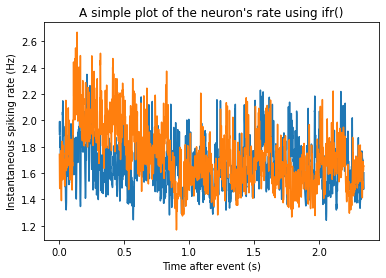


	Running two-sample zeta-test on one neuron, different stimuli


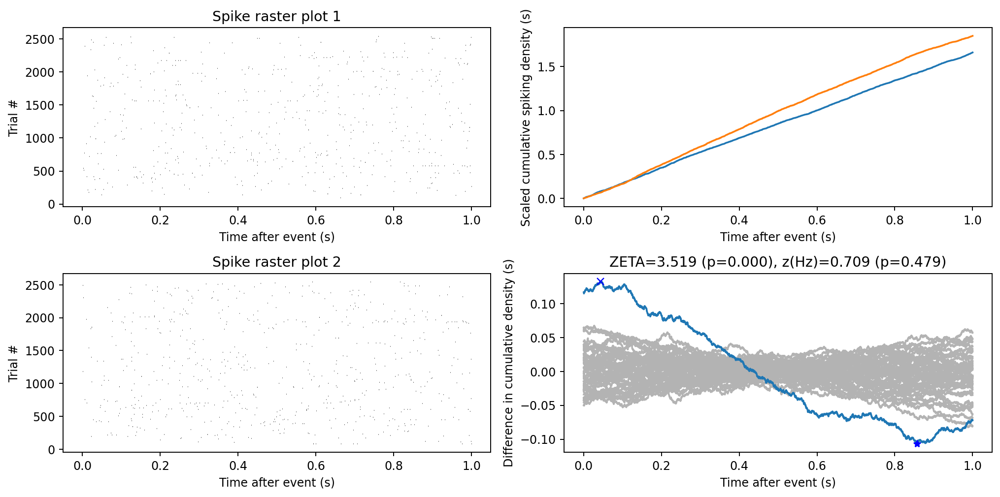

		Is neuron 139 responding differently with and without laser? (elapsed time: 12.44 s):           
		two-sample zeta-test p-value: 0.0004325905865592006
		t-test p-value:0.47855378690916095
Processing 116 neuron


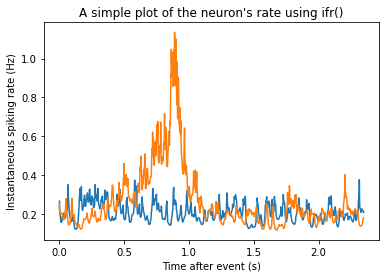


	Running two-sample zeta-test on one neuron, different stimuli


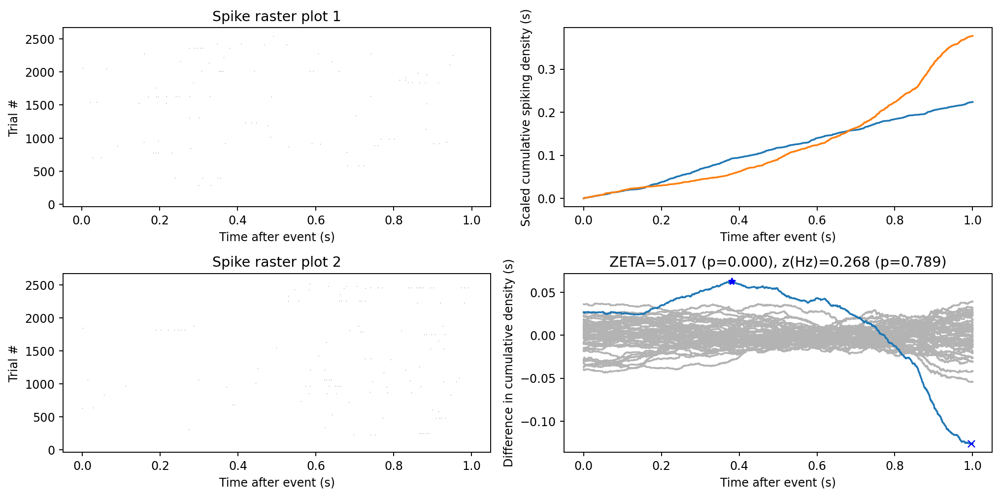

		Is neuron 116 responding differently with and without laser? (elapsed time: 9.35 s):           
		two-sample zeta-test p-value: 5.252515160591997e-07
		t-test p-value:0.7885846329981197
Processing 53 neuron


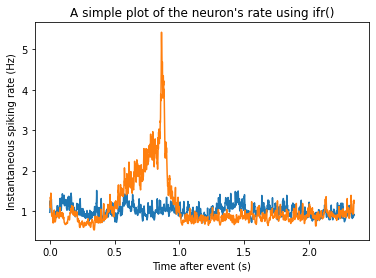


	Running two-sample zeta-test on one neuron, different stimuli


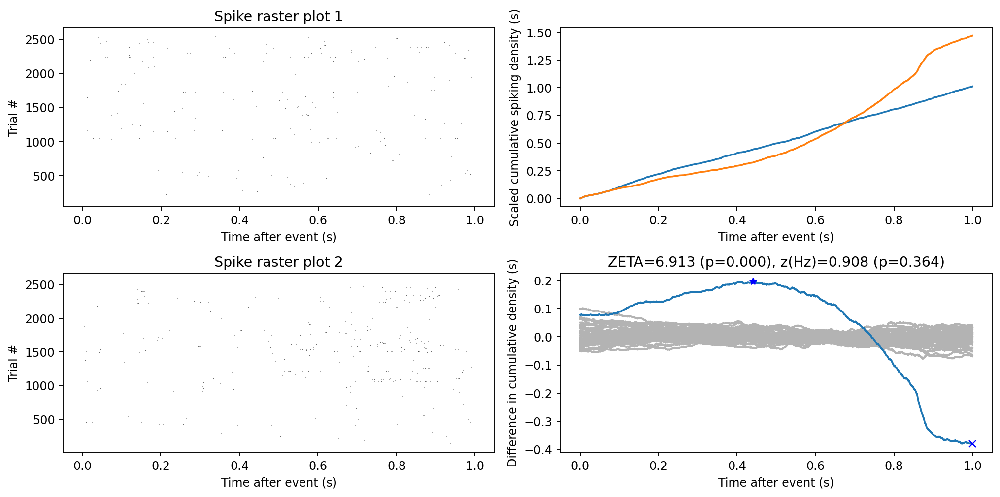

		Is neuron 53 responding differently with and without laser? (elapsed time: 10.79 s):           
		two-sample zeta-test p-value: 4.73543426693368e-12
		t-test p-value:0.3639766219742616
Processing 124 neuron


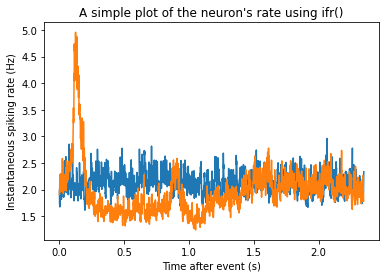


	Running two-sample zeta-test on one neuron, different stimuli


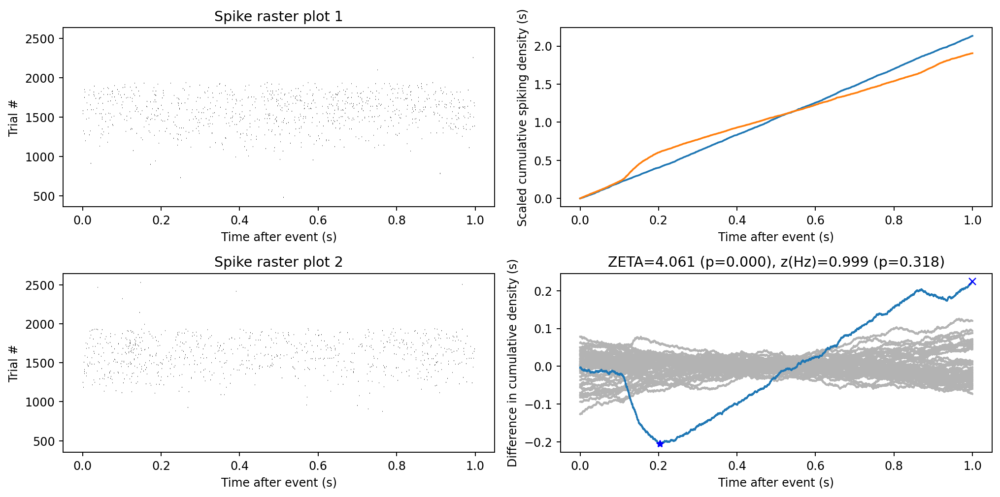

		Is neuron 124 responding differently with and without laser? (elapsed time: 13.12 s):           
		two-sample zeta-test p-value: 4.8774808083962284e-05
		t-test p-value:0.31803449248136384
Processing 125 neuron


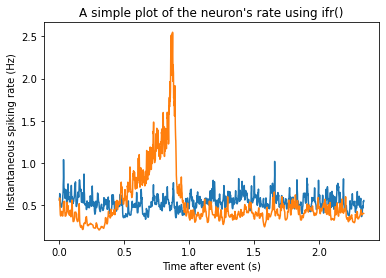


	Running two-sample zeta-test on one neuron, different stimuli


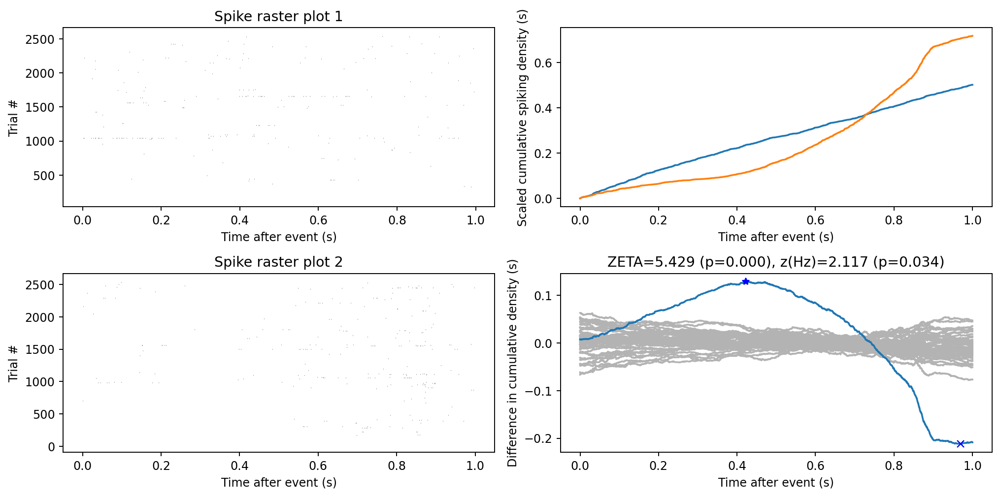

		Is neuron 125 responding differently with and without laser? (elapsed time: 10.04 s):           
		two-sample zeta-test p-value: 5.6826162664336266e-08
		t-test p-value:0.034273318384895717


In [31]:
boolPlot = True

for n in laseronly:
    print('Processing {} neuron'.format(n))
    t = time.time()
    neuron = asdf[n]
    vecSpikeTimes1 = neuron[(neuron>datasep[seg])&(neuron<datasep[seg+1]), np.newaxis]/1000

    vecTime, vecRate, dIFR = ifr(vecSpikeTimes1, arrEventTimes[:,0])
    vecTime_l, vecRate_l, dIFR = ifr(vecSpikeTimes1, arrLaserEventTimes[:,0])

    f, ax = plt.subplots(1, figsize=(6, 4))
    ax.plot(vecTime, vecRate)
    ax.plot(vecTime_l, vecRate_l)
    ax.set(xlabel='Time after event (s)', ylabel='Instantaneous spiking rate (Hz)')
    ax.set(title="A simple plot of the neuron's rate using ifr()")
    plt.show()
    
    
#     dblZetaP, dZETA, dRate = zetatest(vecSpikeTimes1, arrEventTimes,
#                                                     dblUseMaxDur=dblUseMaxDur,
#                                                     intResampNum=intResampNum,
#                                                     dblJitterSize=dblJitterSize,
#                                                     boolPlot=boolPlot,
#                                                     tplRestrictRange=tplRestrictRange,
#                                                     boolReturnRate=boolReturnRate)

#     dblElapsedT2 = time.time() - t
#     timedur[n]=dblElapsedT2
#     nevents[n]=vecSpikeTimes1.shape[0]
#     print(f"\t\tSpecified parameters (elapsed time: {dblElapsedT2:.2f} s): \
#            \n\t\tzeta-test p-value: {dblZetaP}\n\t\tt-test p-value:{dZETA['dblMeanP']}")
#     zetapval[n]=dblZetaP
#     ttestpval[n]=dZETA['dblMeanP']
#     IRFlength[n]=dRate['vecRate'].shape[0]
    
    #case 2: is neuron 1 responding differently to gratings oriented at 0 and 90 degrees?

    print('\n\tRunning two-sample zeta-test on one neuron, different stimuli')
    t = time.time()
    dblZetaTwoSample2a, dZETA2a = zetatest2(vecSpikeTimes1,  arrEventTimes,
                                           vecSpikeTimes1,  arrLaserEventTimes,
                                           dblUseMaxDur, intResampNum, boolPlot)
    dblElapsedT6 = time.time() - t
    
    print(f"\t\tIs neuron {n} responding differently with and without laser? (elapsed time: {dblElapsedT6:.2f} s): \
          \n\t\ttwo-sample zeta-test p-value: {dblZetaTwoSample2a}\n\t\tt-test p-value:{dZETA2a['dblMeanP']}")
    

Processing 0 neuron


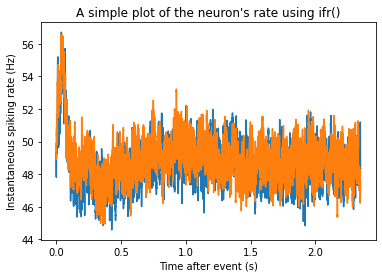


	Running two-sample zeta-test on one neuron, different stimuli


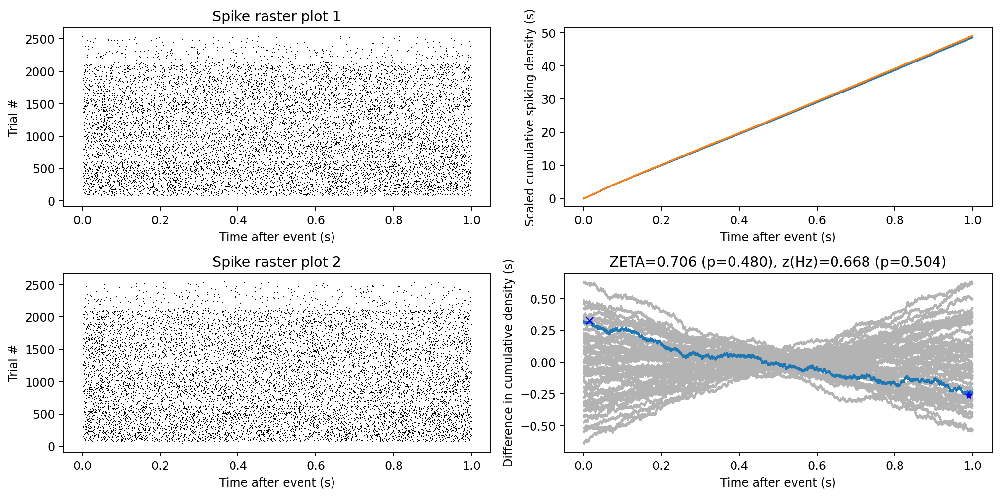

		Is neuron 0 responding differently with and without laser? (elapsed time: 888.61 s):           
		two-sample zeta-test p-value: 0.4798841680978827
		t-test p-value:0.5042303388389493
Processing 3 neuron


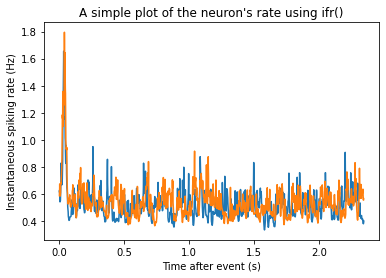


	Running two-sample zeta-test on one neuron, different stimuli


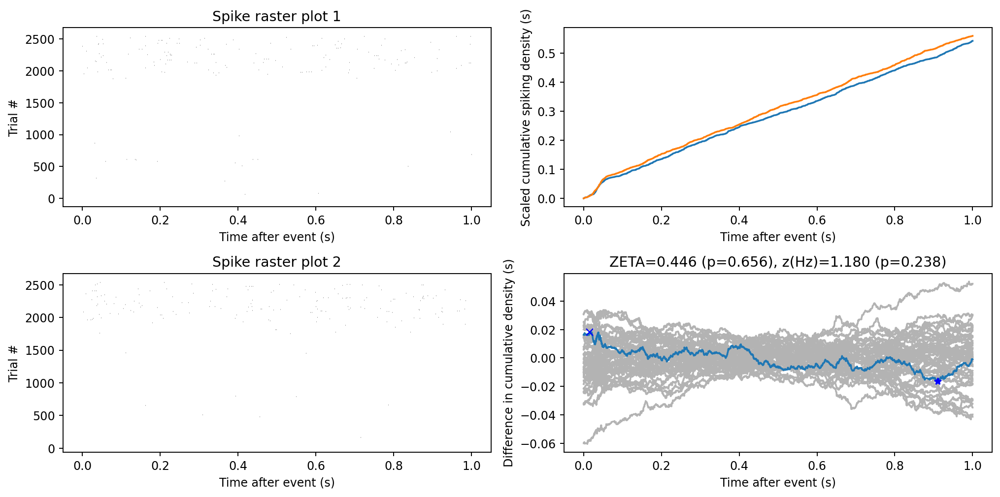

		Is neuron 3 responding differently with and without laser? (elapsed time: 9.21 s):           
		two-sample zeta-test p-value: 0.6558094091370414
		t-test p-value:0.23805833694270476
Processing 6 neuron


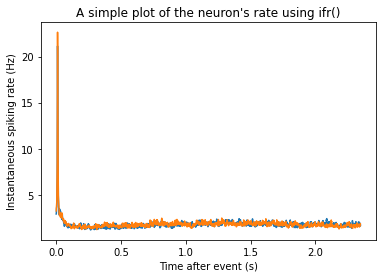


	Running two-sample zeta-test on one neuron, different stimuli


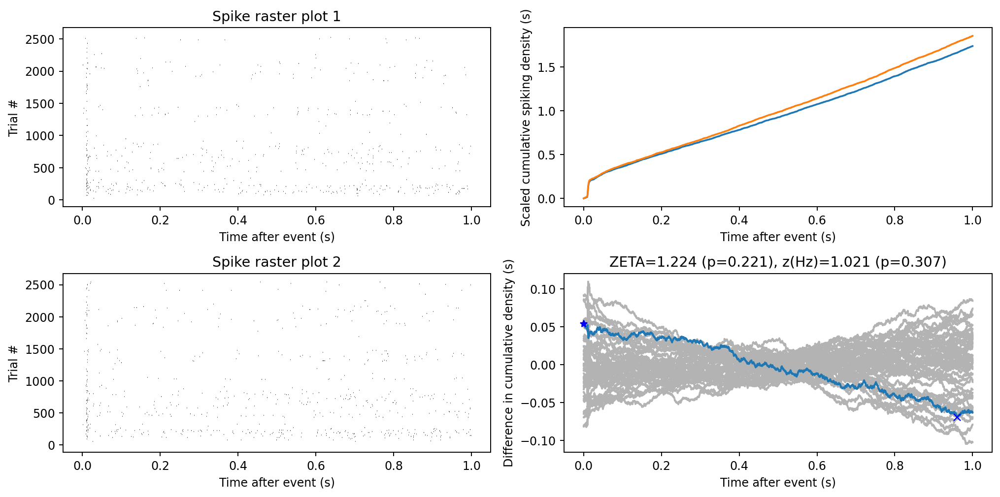

		Is neuron 6 responding differently with and without laser? (elapsed time: 12.82 s):           
		two-sample zeta-test p-value: 0.2208452792740484
		t-test p-value:0.3073889647192709
Processing 7 neuron


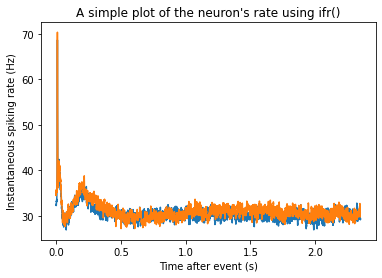


	Running two-sample zeta-test on one neuron, different stimuli


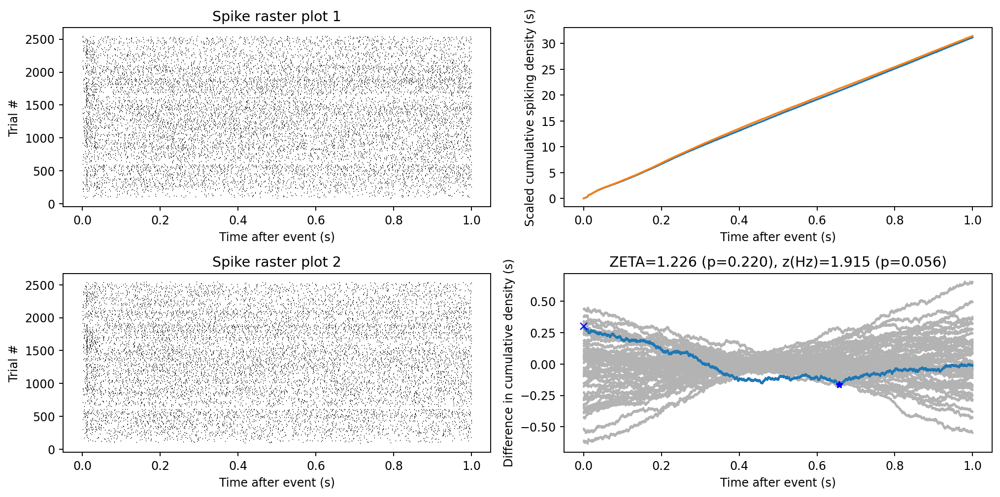

		Is neuron 7 responding differently with and without laser? (elapsed time: 500.10 s):           
		two-sample zeta-test p-value: 0.22009856252963422
		t-test p-value:0.05550062961517776
Processing 9 neuron


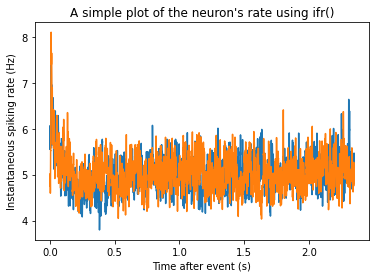


	Running two-sample zeta-test on one neuron, different stimuli


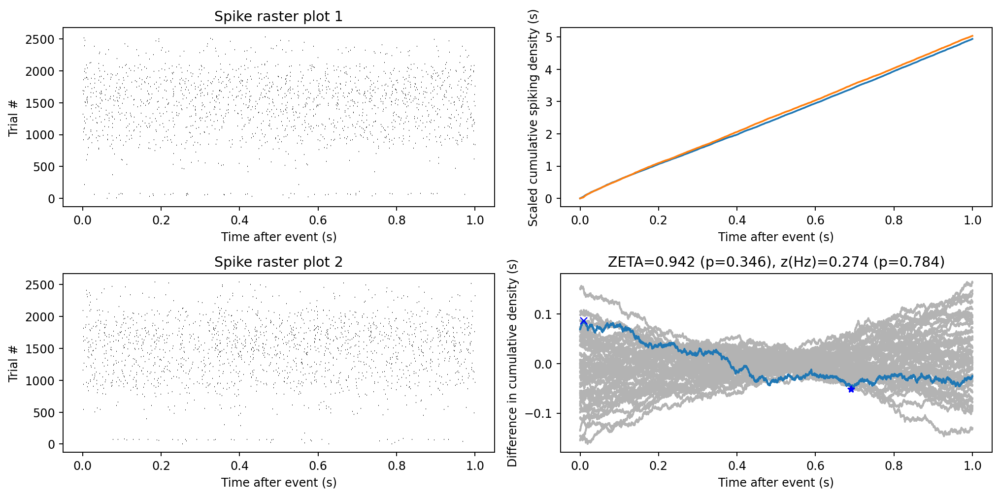

		Is neuron 9 responding differently with and without laser? (elapsed time: 29.31 s):           
		two-sample zeta-test p-value: 0.3463180394502665
		t-test p-value:0.7844159955595729
Processing 10 neuron


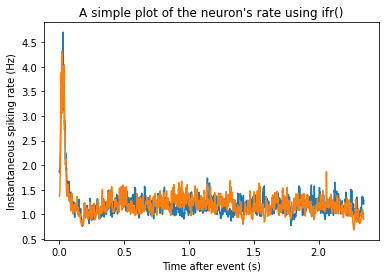


	Running two-sample zeta-test on one neuron, different stimuli


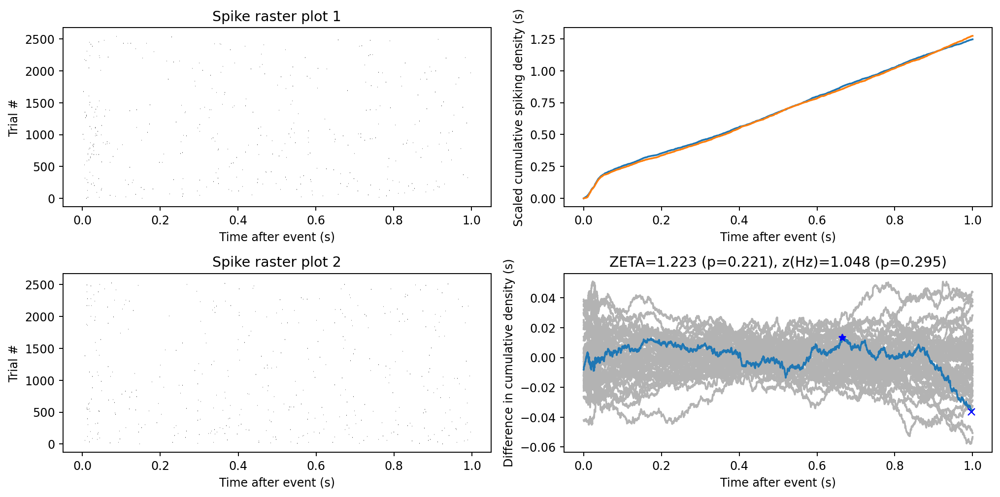

		Is neuron 10 responding differently with and without laser? (elapsed time: 10.27 s):           
		two-sample zeta-test p-value: 0.22132015867797816
		t-test p-value:0.2947874637619302
Processing 11 neuron


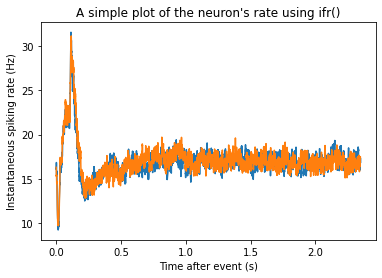


	Running two-sample zeta-test on one neuron, different stimuli


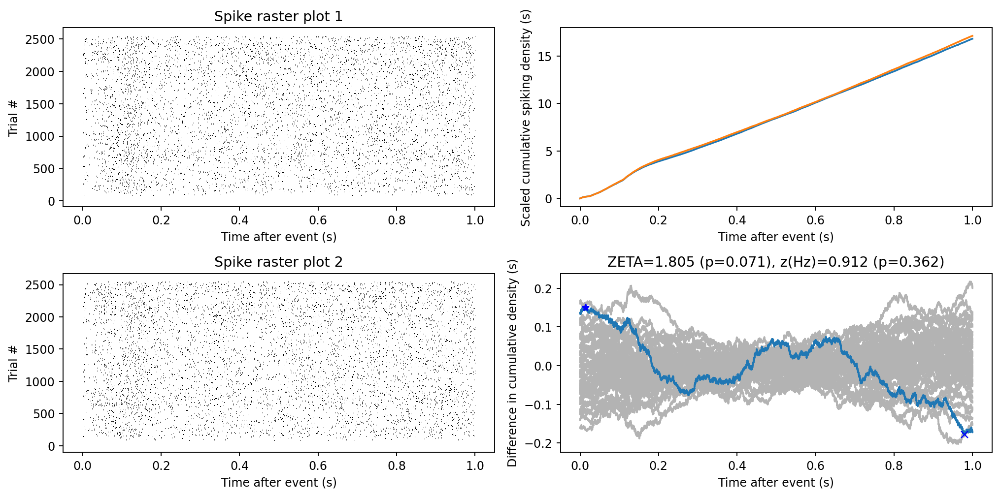

		Is neuron 11 responding differently with and without laser? (elapsed time: 111.86 s):           
		two-sample zeta-test p-value: 0.07112583298790465
		t-test p-value:0.3615244512411333
Processing 12 neuron


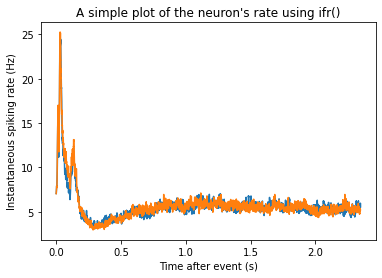


	Running two-sample zeta-test on one neuron, different stimuli


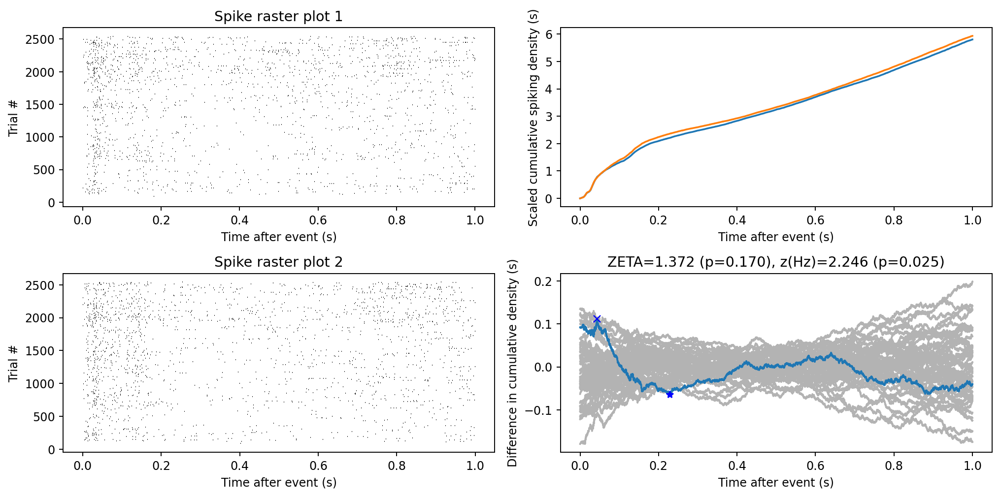

		Is neuron 12 responding differently with and without laser? (elapsed time: 25.50 s):           
		two-sample zeta-test p-value: 0.1700206811927445
		t-test p-value:0.02470149728103736
Processing 15 neuron


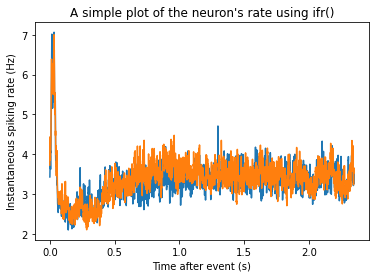


	Running two-sample zeta-test on one neuron, different stimuli


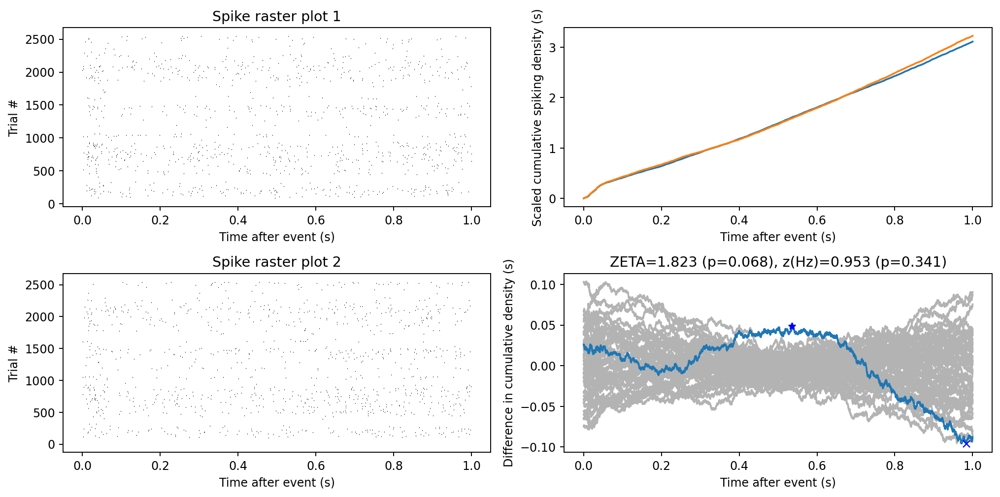

		Is neuron 15 responding differently with and without laser? (elapsed time: 17.90 s):           
		two-sample zeta-test p-value: 0.06830560698834798
		t-test p-value:0.3405645275686263
Processing 17 neuron


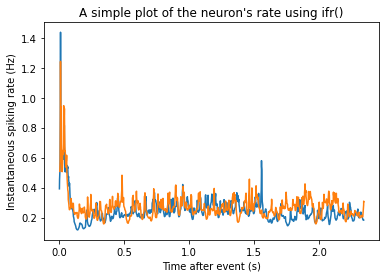


	Running two-sample zeta-test on one neuron, different stimuli


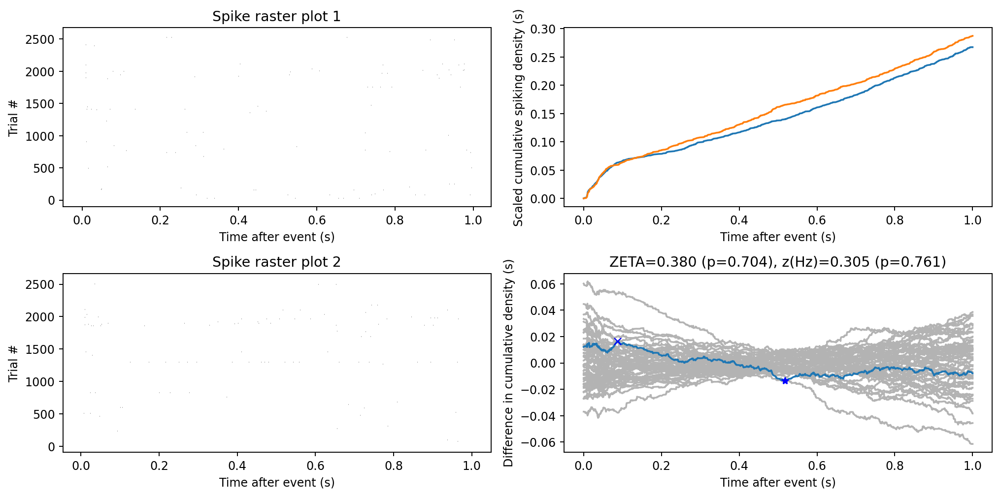

		Is neuron 17 responding differently with and without laser? (elapsed time: 8.13 s):           
		two-sample zeta-test p-value: 0.7037176925978922
		t-test p-value:0.7605932185168145
Processing 19 neuron


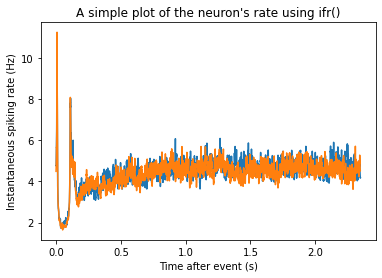


	Running two-sample zeta-test on one neuron, different stimuli


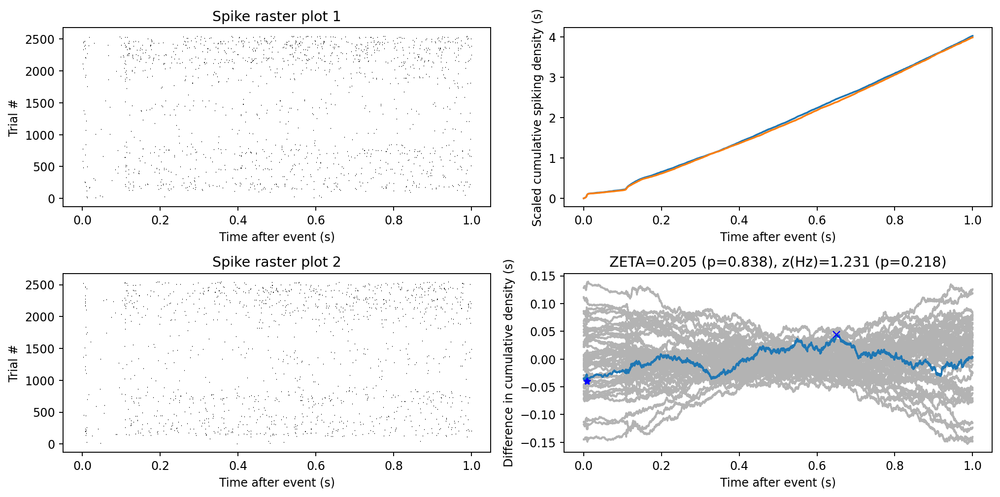

		Is neuron 19 responding differently with and without laser? (elapsed time: 18.23 s):           
		two-sample zeta-test p-value: 0.8376797006662697
		t-test p-value:0.21845961557868226
Processing 20 neuron


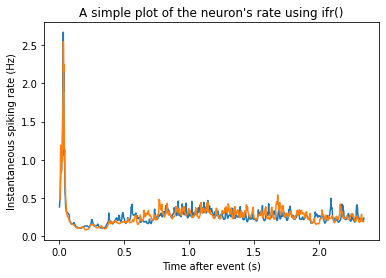


	Running two-sample zeta-test on one neuron, different stimuli


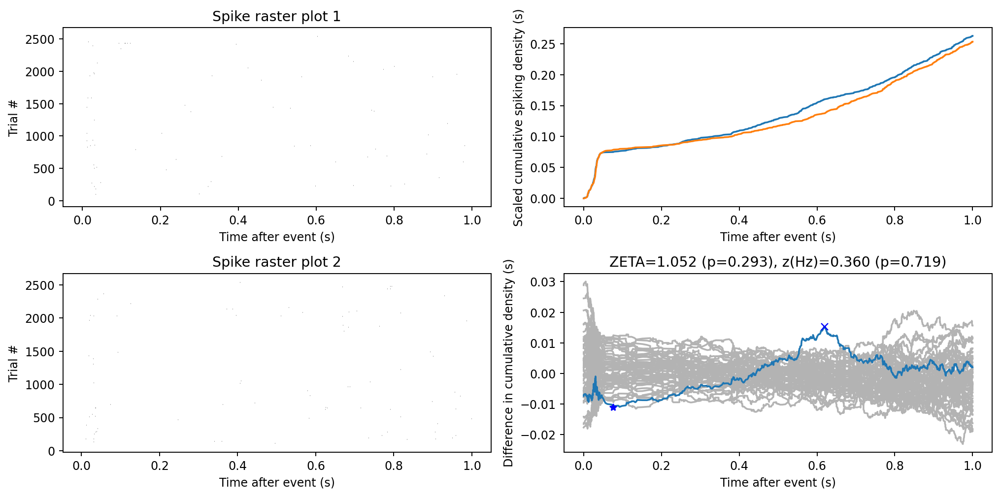

		Is neuron 20 responding differently with and without laser? (elapsed time: 8.24 s):           
		two-sample zeta-test p-value: 0.29264389530454404
		t-test p-value:0.719129264237937
Processing 21 neuron


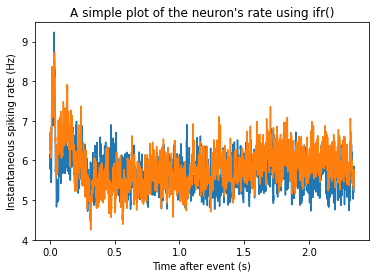


	Running two-sample zeta-test on one neuron, different stimuli


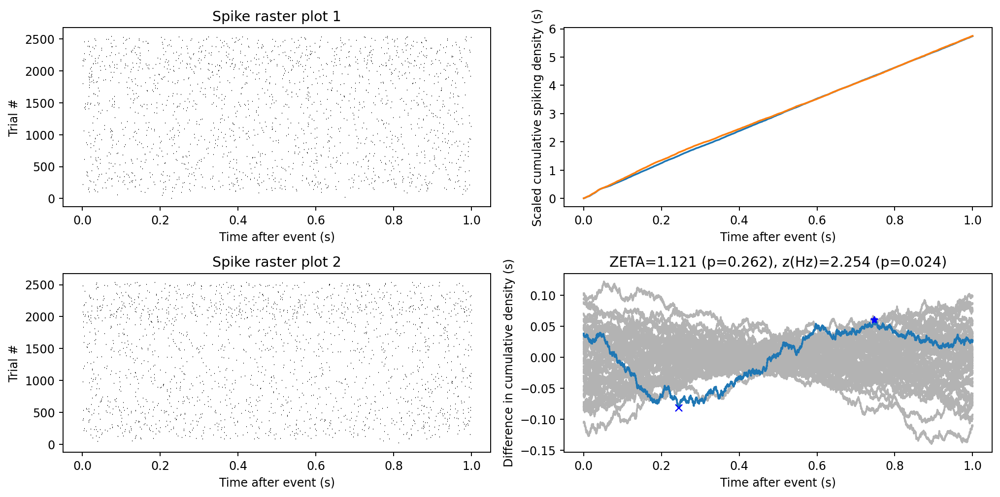

		Is neuron 21 responding differently with and without laser? (elapsed time: 26.41 s):           
		two-sample zeta-test p-value: 0.26235940589685003
		t-test p-value:0.024198389133071155
Processing 22 neuron


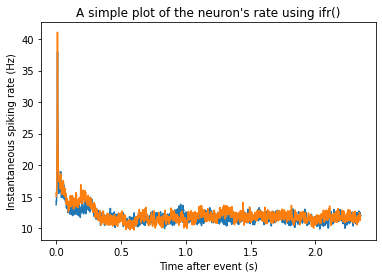


	Running two-sample zeta-test on one neuron, different stimuli


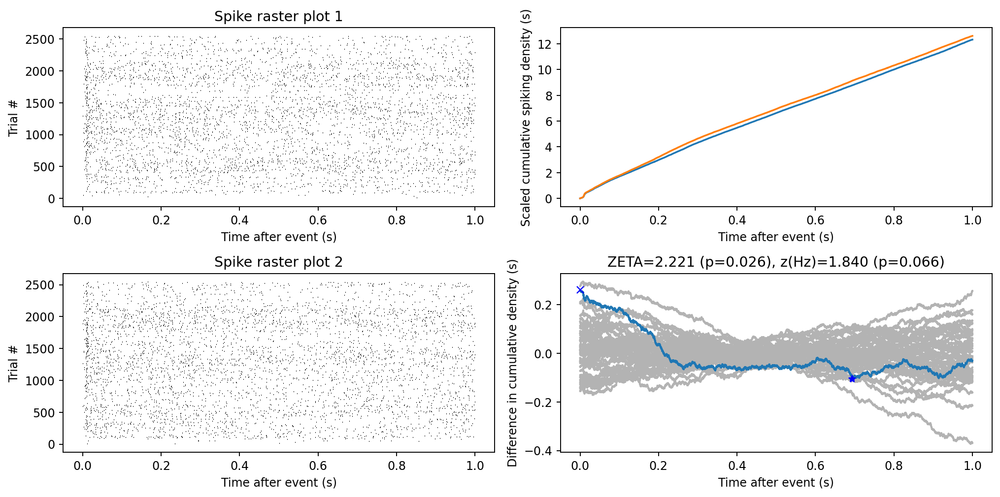

		Is neuron 22 responding differently with and without laser? (elapsed time: 70.94 s):           
		two-sample zeta-test p-value: 0.02637618953607912
		t-test p-value:0.06573014349449816
Processing 23 neuron


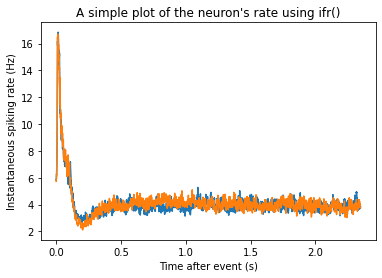


	Running two-sample zeta-test on one neuron, different stimuli


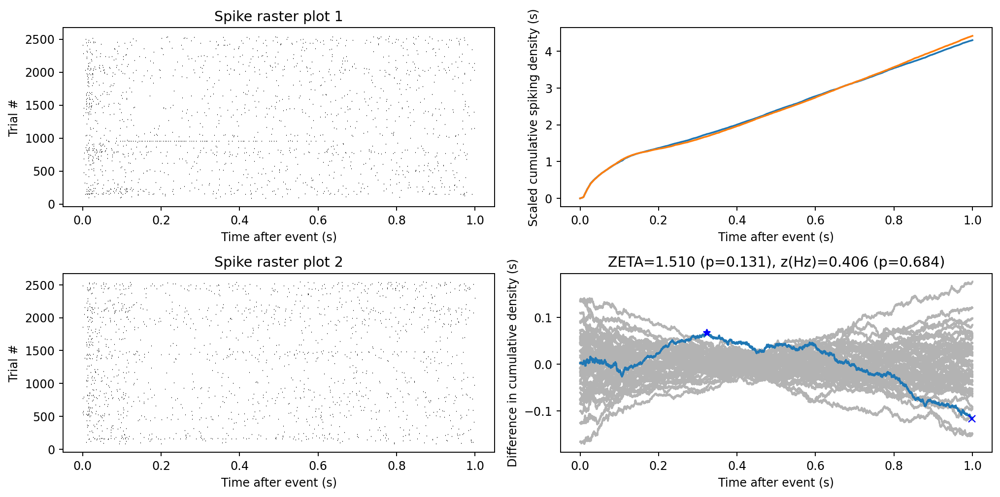

		Is neuron 23 responding differently with and without laser? (elapsed time: 20.09 s):           
		two-sample zeta-test p-value: 0.13105444409895317
		t-test p-value:0.6844898072152926
Processing 26 neuron


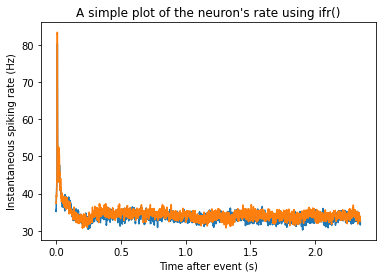


	Running two-sample zeta-test on one neuron, different stimuli


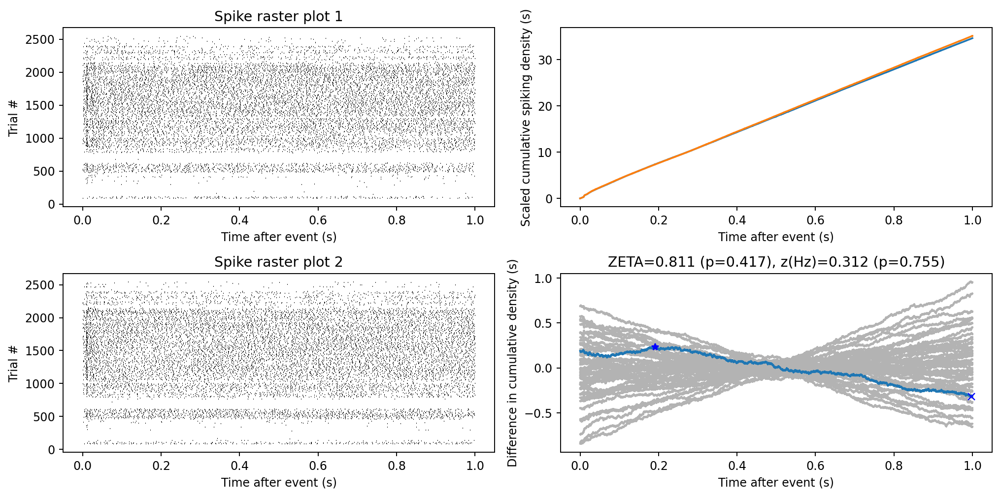

		Is neuron 26 responding differently with and without laser? (elapsed time: 478.02 s):           
		two-sample zeta-test p-value: 0.4171564357175007
		t-test p-value:0.7552558370097686
Processing 28 neuron


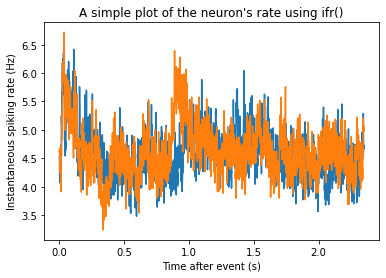


	Running two-sample zeta-test on one neuron, different stimuli


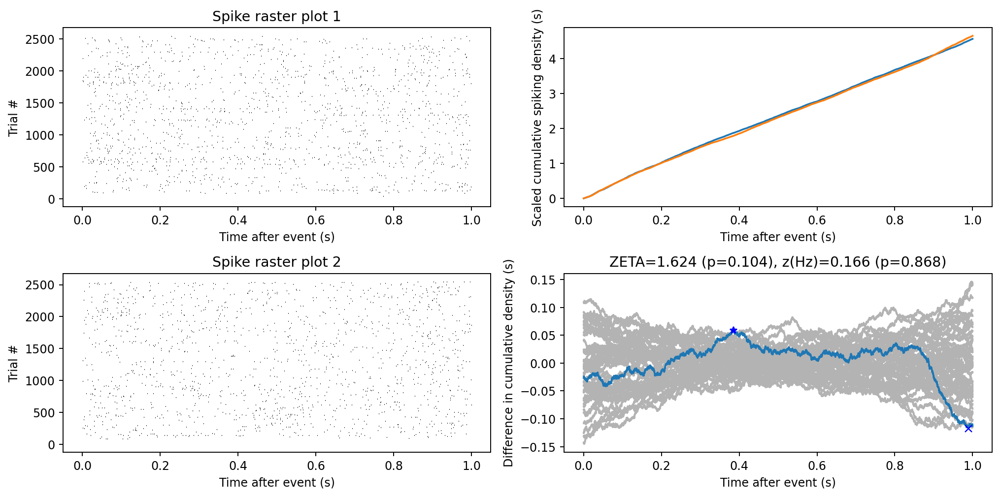

		Is neuron 28 responding differently with and without laser? (elapsed time: 19.61 s):           
		two-sample zeta-test p-value: 0.10433826452802186
		t-test p-value:0.8680101007466827
Processing 29 neuron


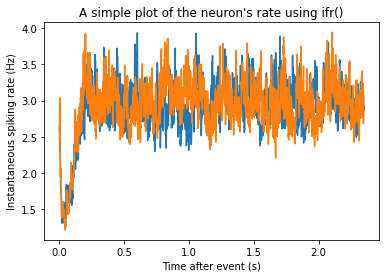


	Running two-sample zeta-test on one neuron, different stimuli


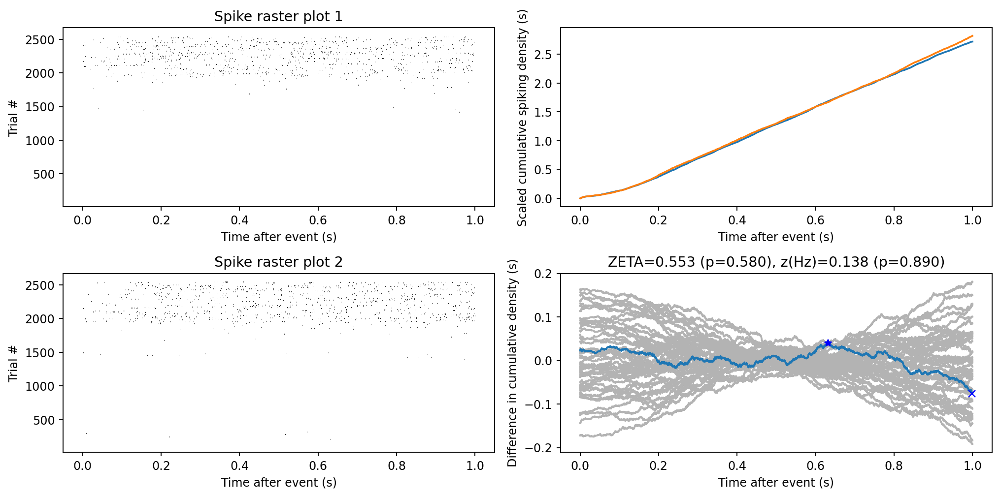

		Is neuron 29 responding differently with and without laser? (elapsed time: 13.30 s):           
		two-sample zeta-test p-value: 0.5804539390273877
		t-test p-value:0.8899319485985902
Processing 31 neuron


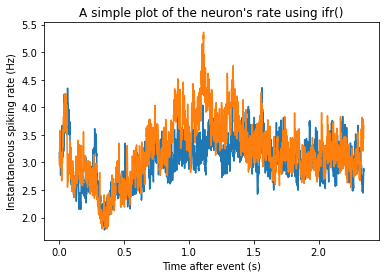


	Running two-sample zeta-test on one neuron, different stimuli


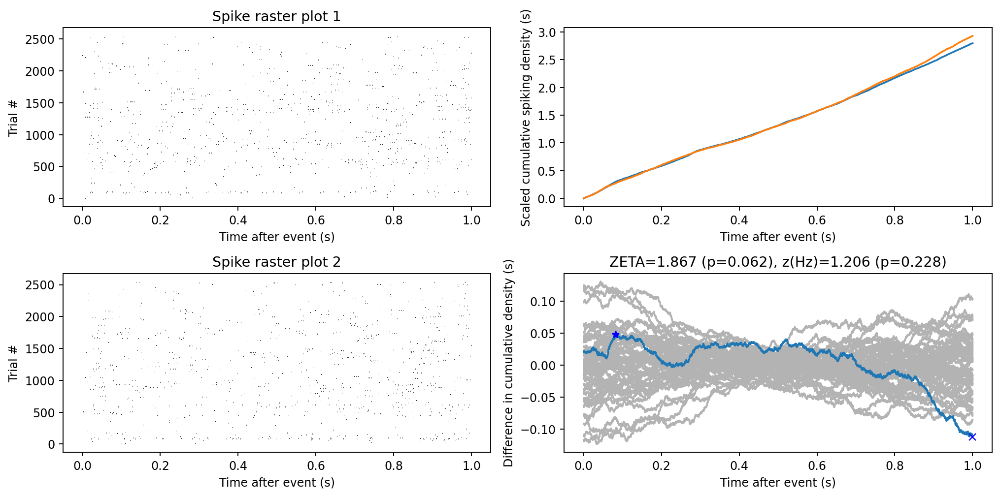

		Is neuron 31 responding differently with and without laser? (elapsed time: 24.66 s):           
		two-sample zeta-test p-value: 0.061936941078113206
		t-test p-value:0.2279542406932867
Processing 37 neuron


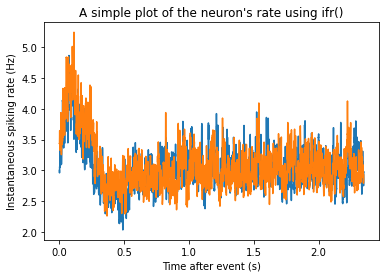


	Running two-sample zeta-test on one neuron, different stimuli


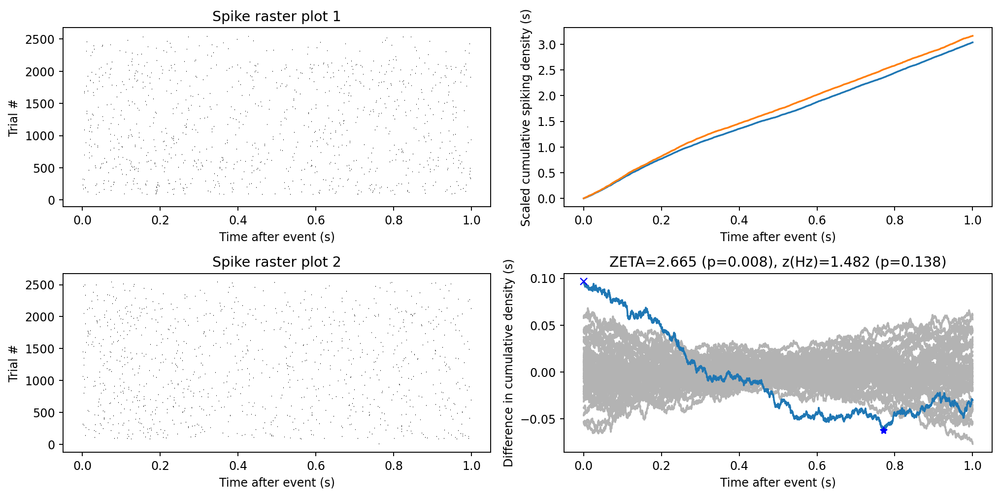

		Is neuron 37 responding differently with and without laser? (elapsed time: 14.95 s):           
		two-sample zeta-test p-value: 0.0077054550085137175
		t-test p-value:0.13829855307163655
Processing 41 neuron


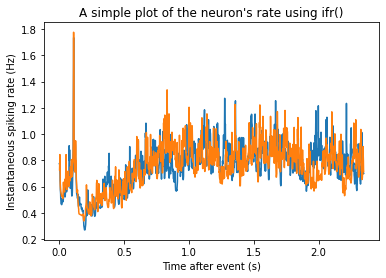


	Running two-sample zeta-test on one neuron, different stimuli


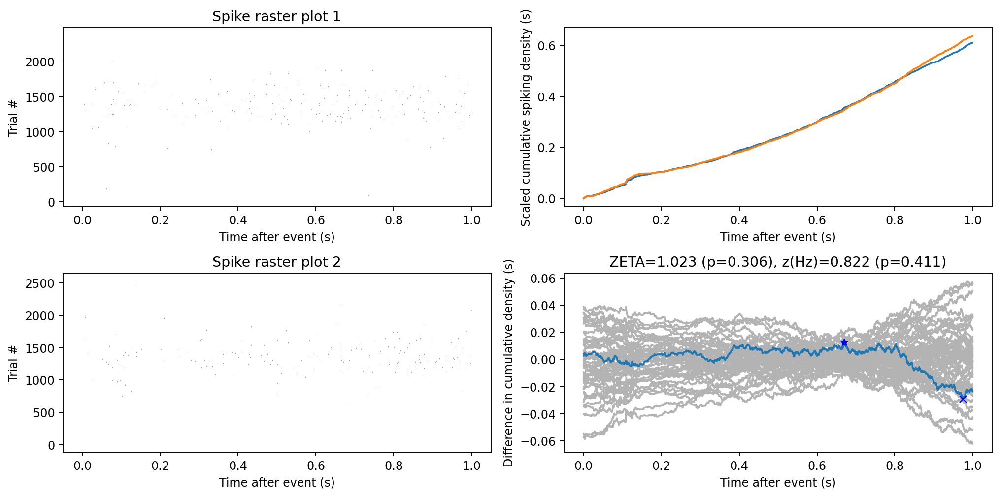

		Is neuron 41 responding differently with and without laser? (elapsed time: 8.83 s):           
		two-sample zeta-test p-value: 0.30649278925068957
		t-test p-value:0.4108976577300124
Processing 42 neuron


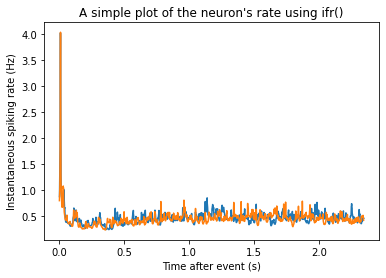


	Running two-sample zeta-test on one neuron, different stimuli


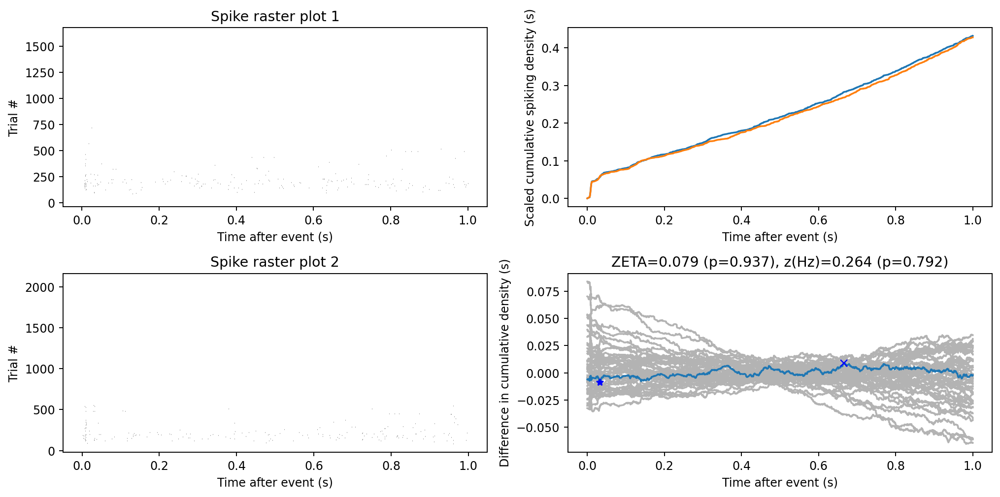

		Is neuron 42 responding differently with and without laser? (elapsed time: 8.37 s):           
		two-sample zeta-test p-value: 0.9368403152757466
		t-test p-value:0.7918893985849862
Processing 44 neuron


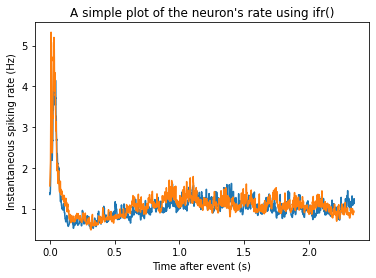


	Running two-sample zeta-test on one neuron, different stimuli


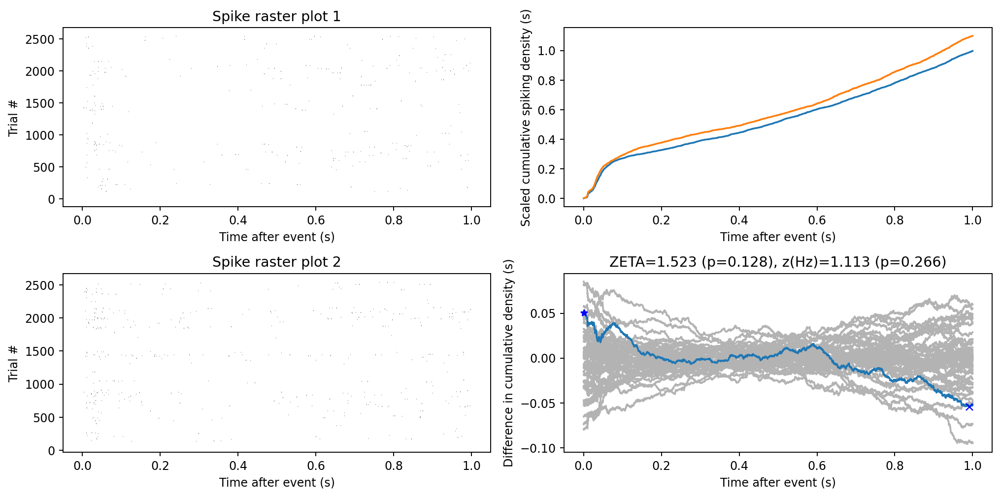

		Is neuron 44 responding differently with and without laser? (elapsed time: 9.66 s):           
		two-sample zeta-test p-value: 0.12776486427940892
		t-test p-value:0.2655311766105743
Processing 48 neuron


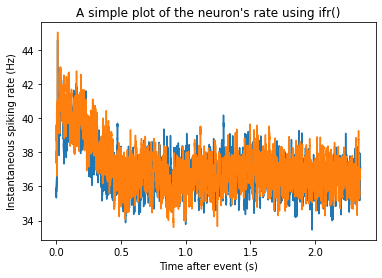


	Running two-sample zeta-test on one neuron, different stimuli


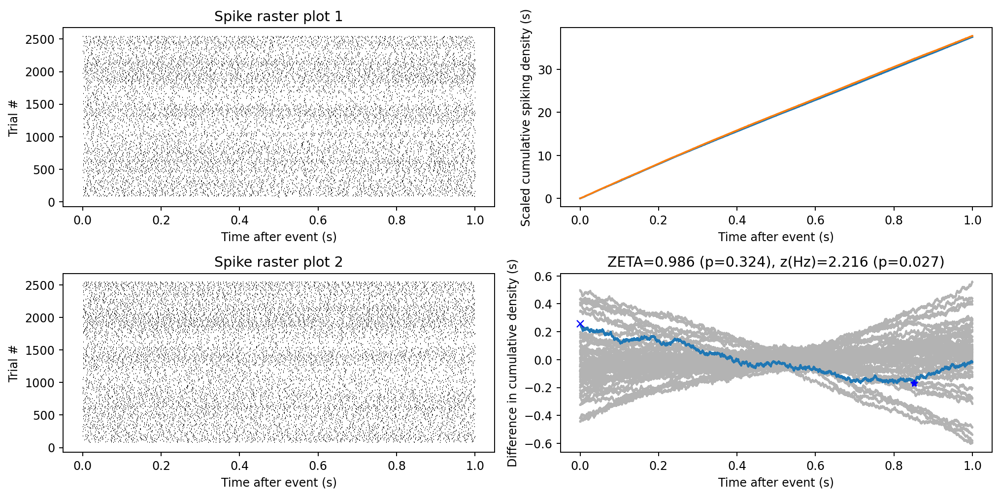

		Is neuron 48 responding differently with and without laser? (elapsed time: 459.54 s):           
		two-sample zeta-test p-value: 0.32413173883489876
		t-test p-value:0.026725704224357705
Processing 49 neuron


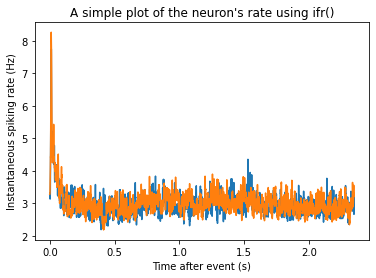


	Running two-sample zeta-test on one neuron, different stimuli


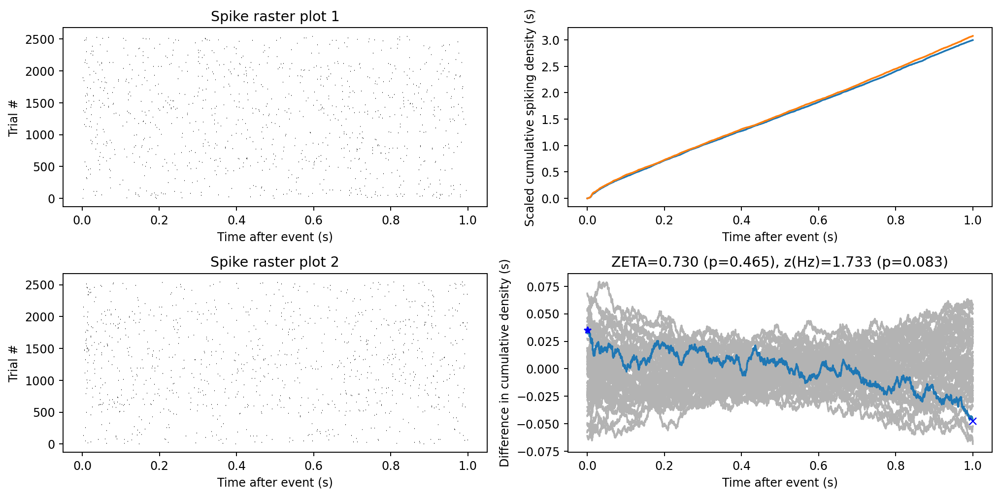

		Is neuron 49 responding differently with and without laser? (elapsed time: 14.47 s):           
		two-sample zeta-test p-value: 0.46512384110052396
		t-test p-value:0.08303598152339006
Processing 50 neuron


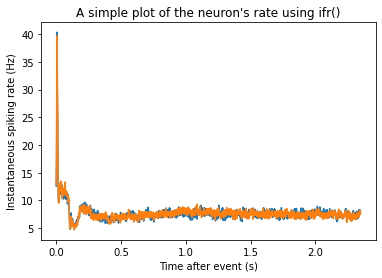


	Running two-sample zeta-test on one neuron, different stimuli


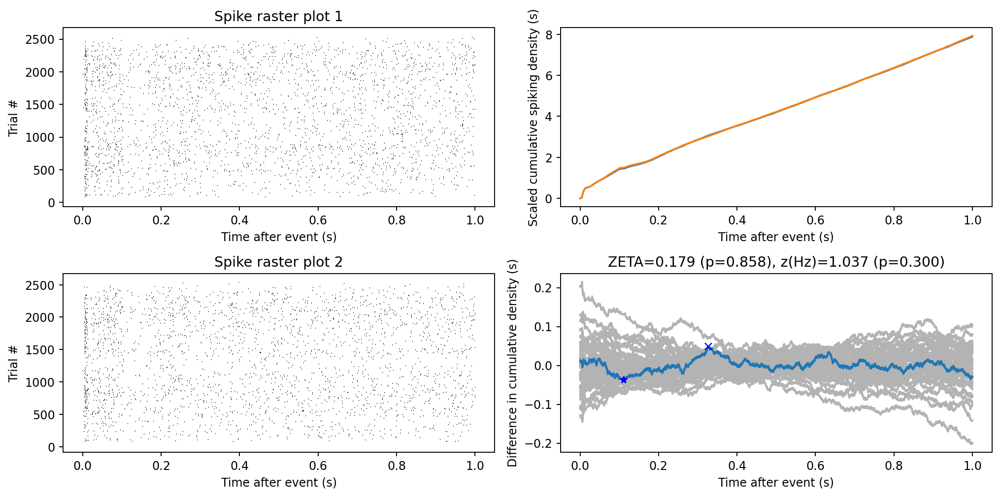

		Is neuron 50 responding differently with and without laser? (elapsed time: 38.46 s):           
		two-sample zeta-test p-value: 0.8580926225154616
		t-test p-value:0.29981266966071357
Processing 52 neuron


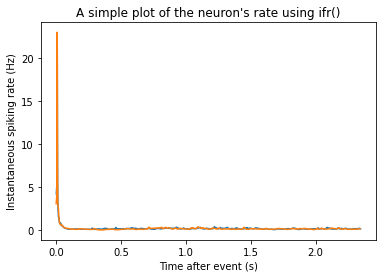


	Running two-sample zeta-test on one neuron, different stimuli


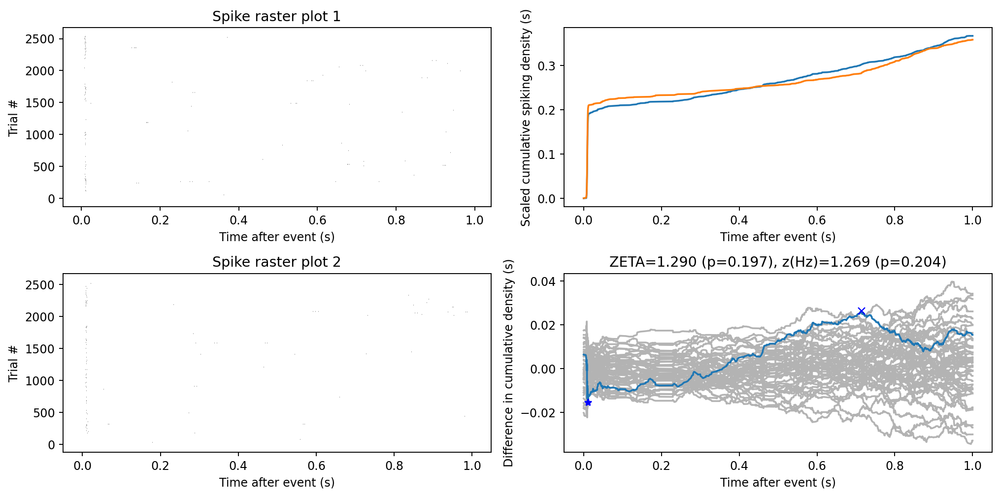

		Is neuron 52 responding differently with and without laser? (elapsed time: 9.03 s):           
		two-sample zeta-test p-value: 0.1971886239746301
		t-test p-value:0.20432344816609913
Processing 56 neuron


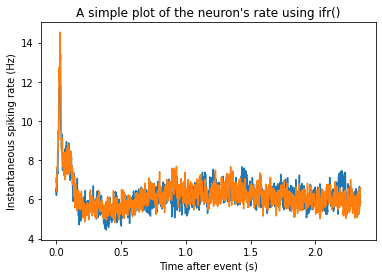


	Running two-sample zeta-test on one neuron, different stimuli


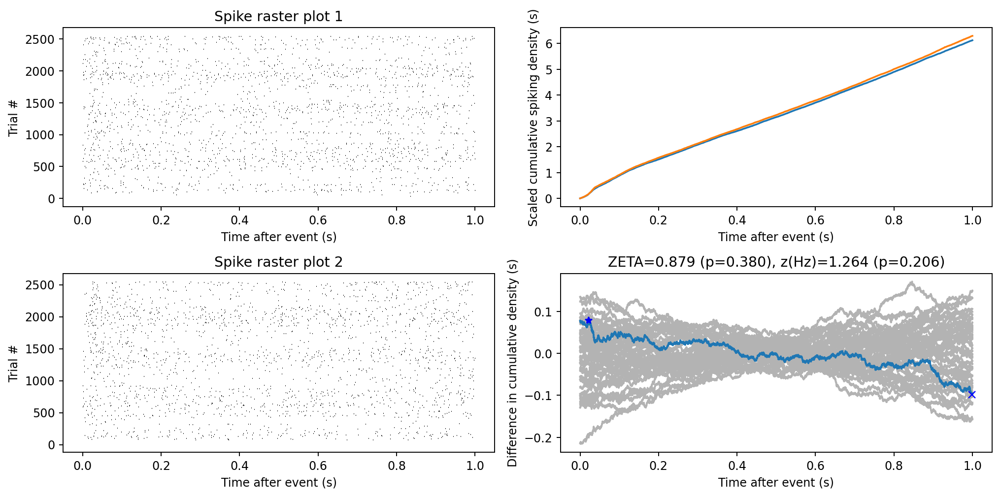

		Is neuron 56 responding differently with and without laser? (elapsed time: 26.86 s):           
		two-sample zeta-test p-value: 0.37963933527330473
		t-test p-value:0.20631014330357136
Processing 60 neuron


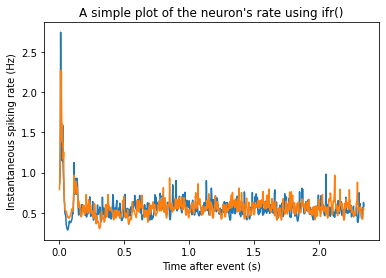


	Running two-sample zeta-test on one neuron, different stimuli


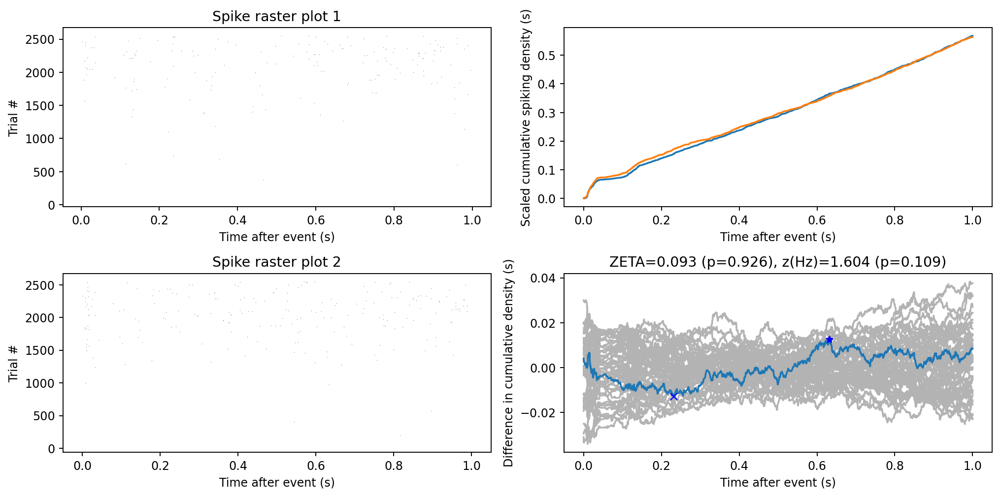

		Is neuron 60 responding differently with and without laser? (elapsed time: 9.01 s):           
		two-sample zeta-test p-value: 0.9260523288539313
		t-test p-value:0.1087813226463366
Processing 61 neuron


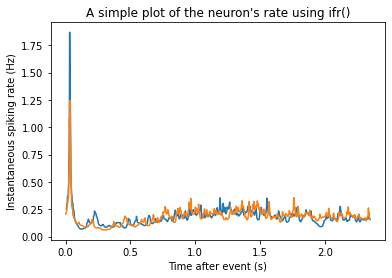


	Running two-sample zeta-test on one neuron, different stimuli


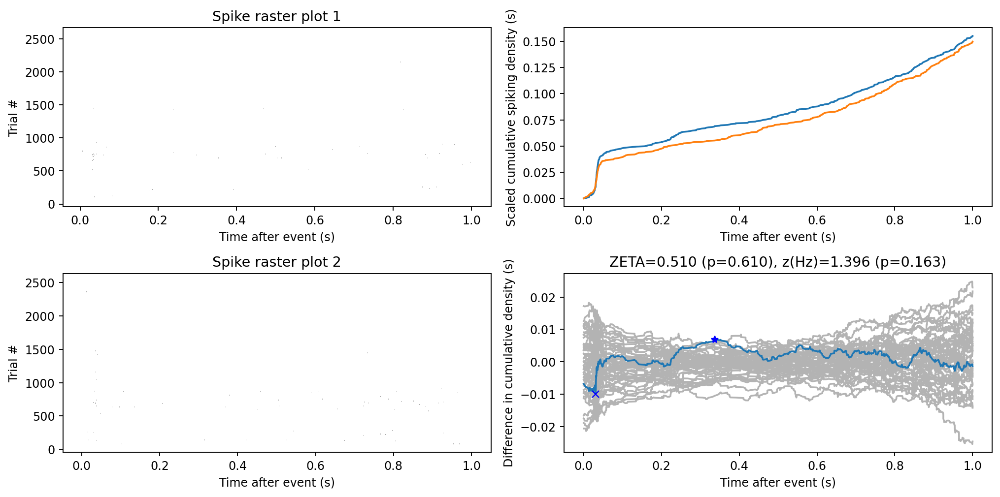

		Is neuron 61 responding differently with and without laser? (elapsed time: 7.88 s):           
		two-sample zeta-test p-value: 0.6097977215986835
		t-test p-value:0.1627609220621392
Processing 62 neuron


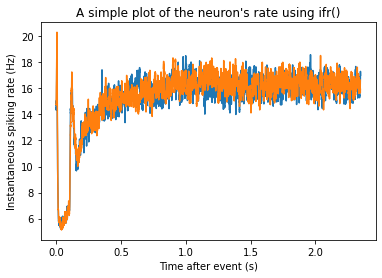


	Running two-sample zeta-test on one neuron, different stimuli


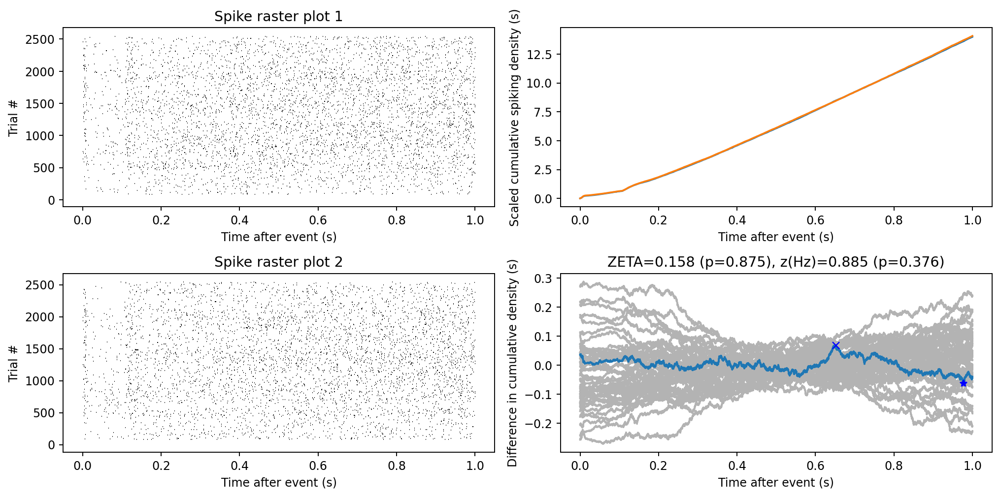

		Is neuron 62 responding differently with and without laser? (elapsed time: 99.50 s):           
		two-sample zeta-test p-value: 0.8748039070627645
		t-test p-value:0.3759881754116453
Processing 63 neuron


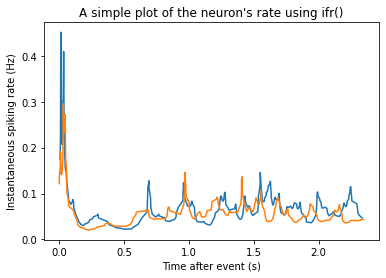


	Running two-sample zeta-test on one neuron, different stimuli


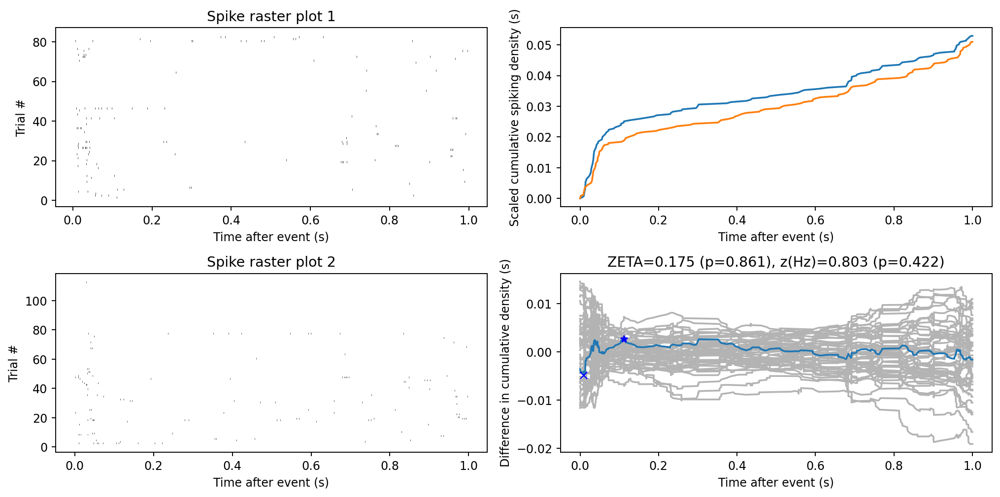

		Is neuron 63 responding differently with and without laser? (elapsed time: 7.57 s):           
		two-sample zeta-test p-value: 0.8610558359267508
		t-test p-value:0.42194468880397895
Processing 64 neuron


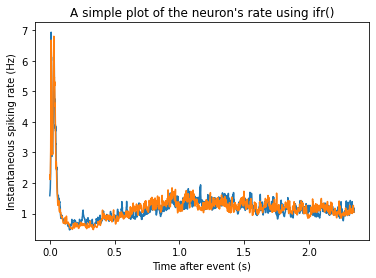


	Running two-sample zeta-test on one neuron, different stimuli


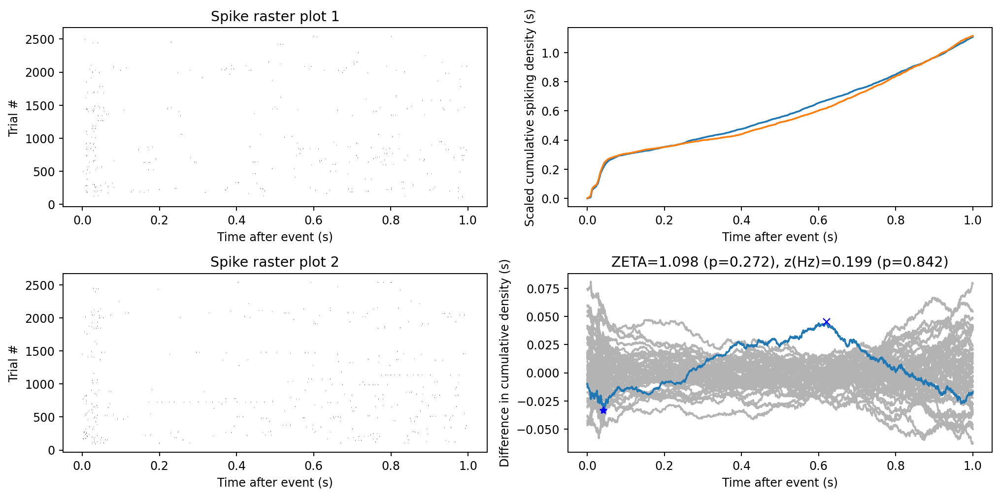

		Is neuron 64 responding differently with and without laser? (elapsed time: 9.99 s):           
		two-sample zeta-test p-value: 0.2720817147928003
		t-test p-value:0.8420452232510576
Processing 65 neuron


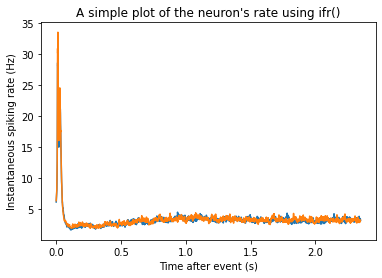


	Running two-sample zeta-test on one neuron, different stimuli


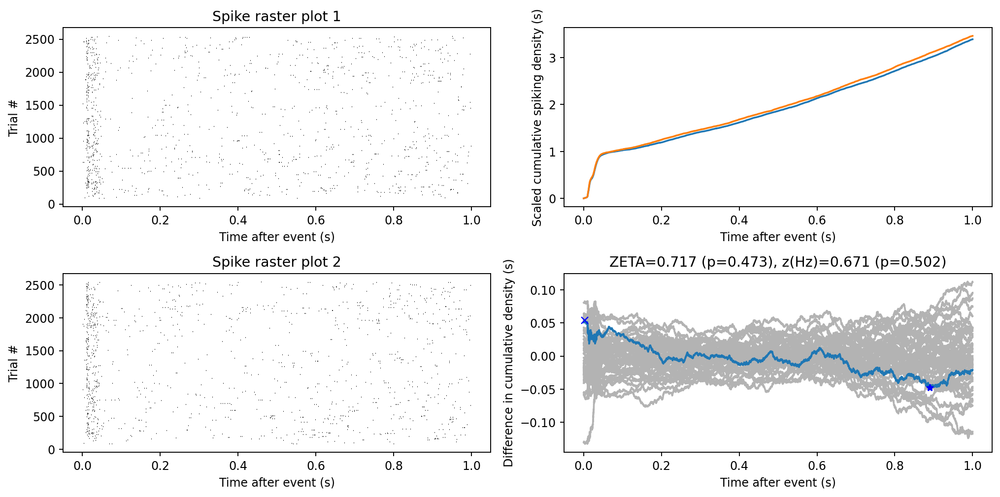

		Is neuron 65 responding differently with and without laser? (elapsed time: 17.05 s):           
		two-sample zeta-test p-value: 0.4733017252574868
		t-test p-value:0.5019832171211354
Processing 67 neuron


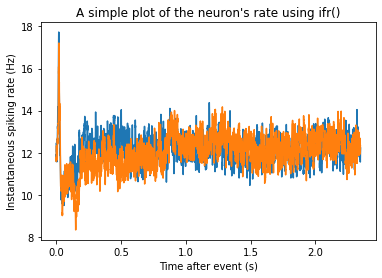


	Running two-sample zeta-test on one neuron, different stimuli


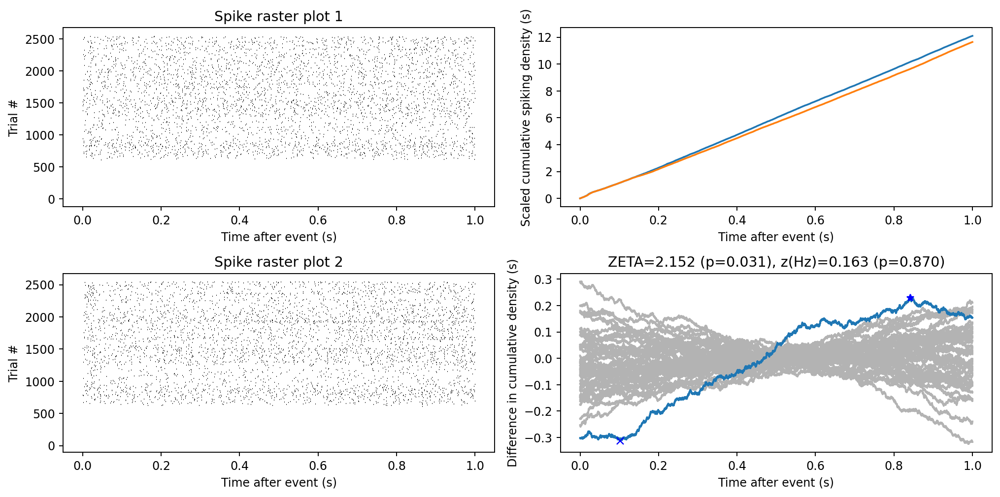

		Is neuron 67 responding differently with and without laser? (elapsed time: 61.47 s):           
		two-sample zeta-test p-value: 0.03138690518886911
		t-test p-value:0.8701794914673376
Processing 68 neuron


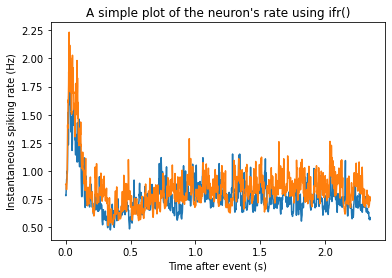


	Running two-sample zeta-test on one neuron, different stimuli


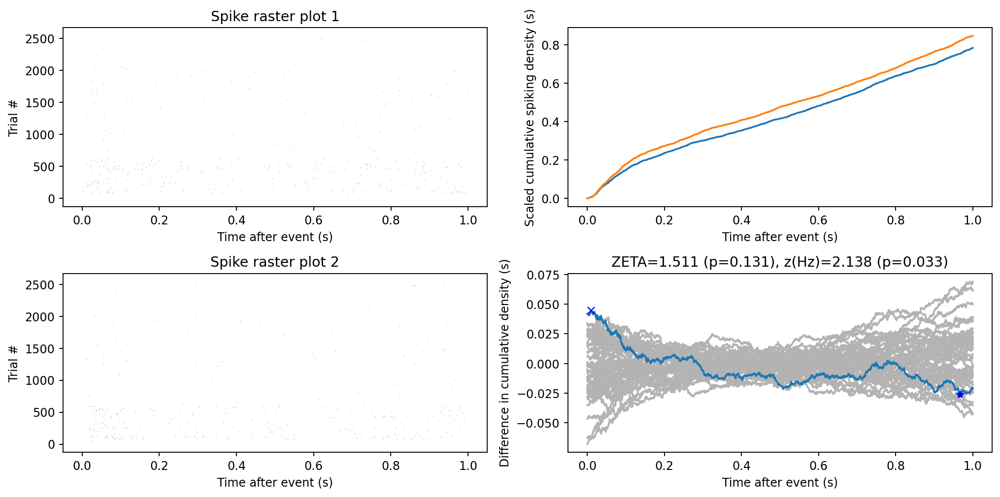

		Is neuron 68 responding differently with and without laser? (elapsed time: 9.39 s):           
		two-sample zeta-test p-value: 0.13085644845725342
		t-test p-value:0.032518014400398566
Processing 70 neuron


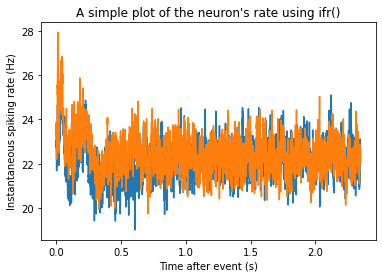


	Running two-sample zeta-test on one neuron, different stimuli


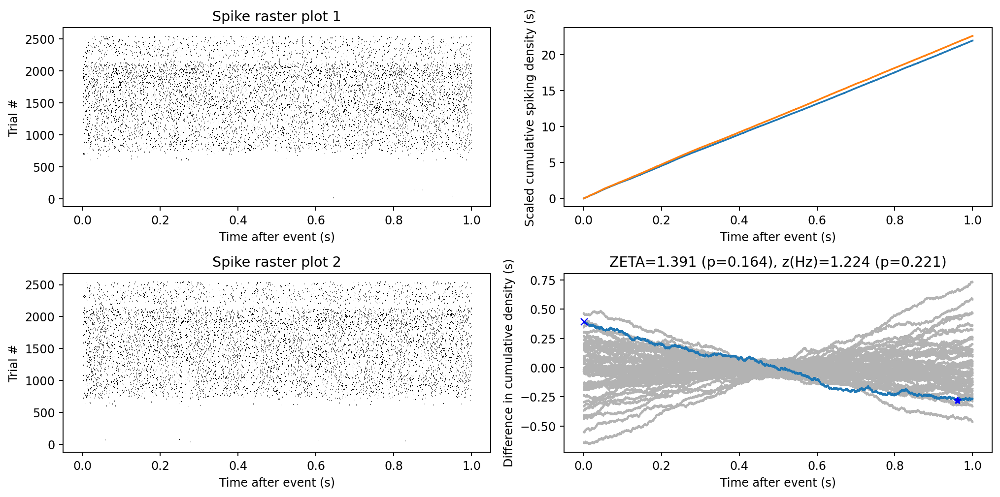

		Is neuron 70 responding differently with and without laser? (elapsed time: 180.38 s):           
		two-sample zeta-test p-value: 0.16428615008381753
		t-test p-value:0.22086756547306127
Processing 74 neuron


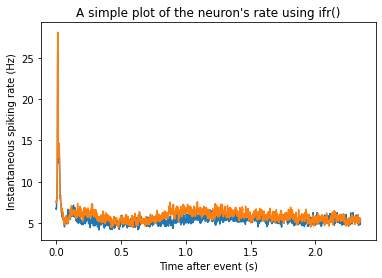


	Running two-sample zeta-test on one neuron, different stimuli


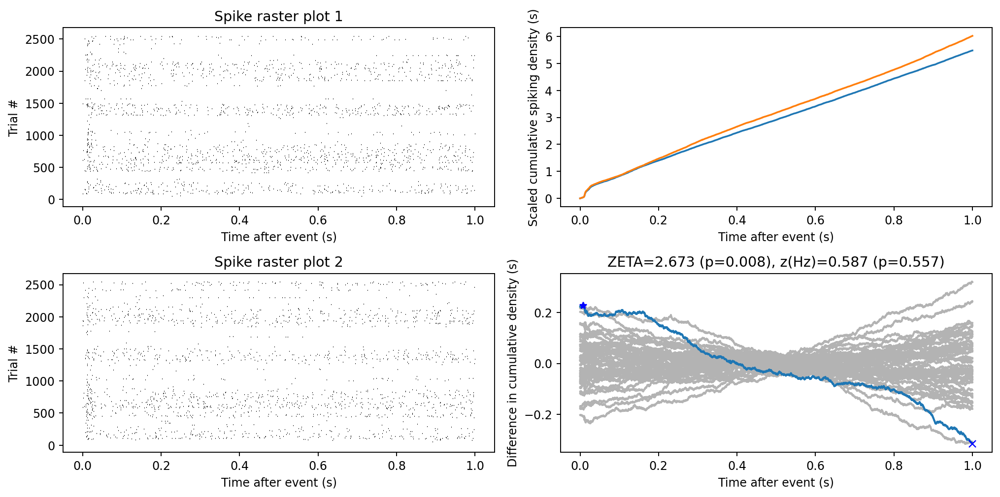

		Is neuron 74 responding differently with and without laser? (elapsed time: 24.87 s):           
		two-sample zeta-test p-value: 0.007511675740351165
		t-test p-value:0.5571858734785944
Processing 76 neuron


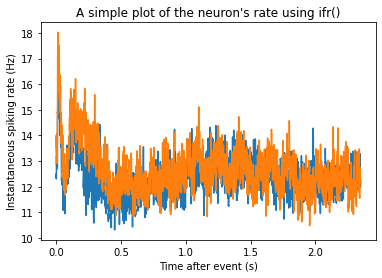


	Running two-sample zeta-test on one neuron, different stimuli


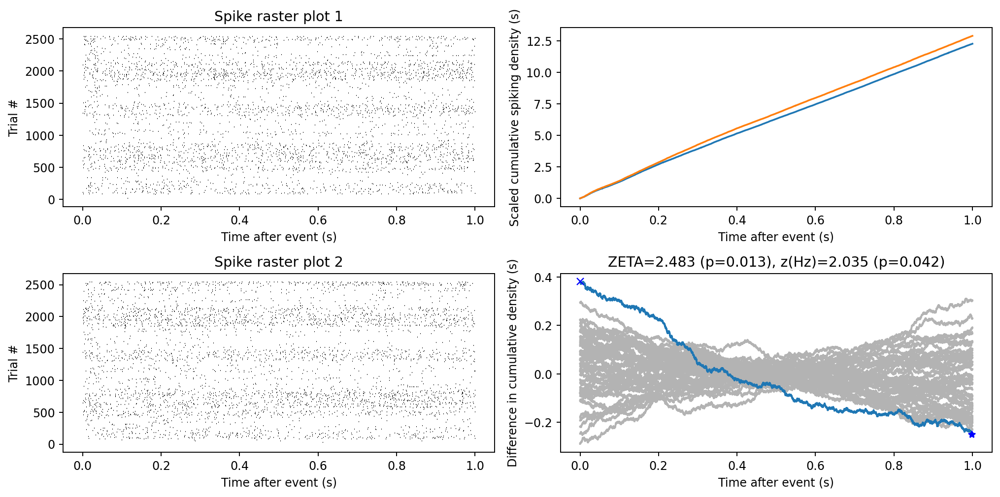

		Is neuron 76 responding differently with and without laser? (elapsed time: 71.09 s):           
		two-sample zeta-test p-value: 0.013032938124930782
		t-test p-value:0.04186703280169823
Processing 79 neuron


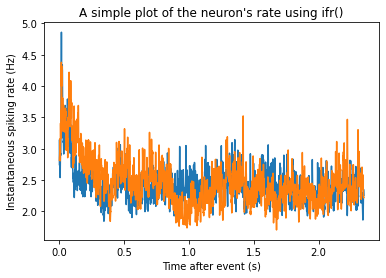


	Running two-sample zeta-test on one neuron, different stimuli


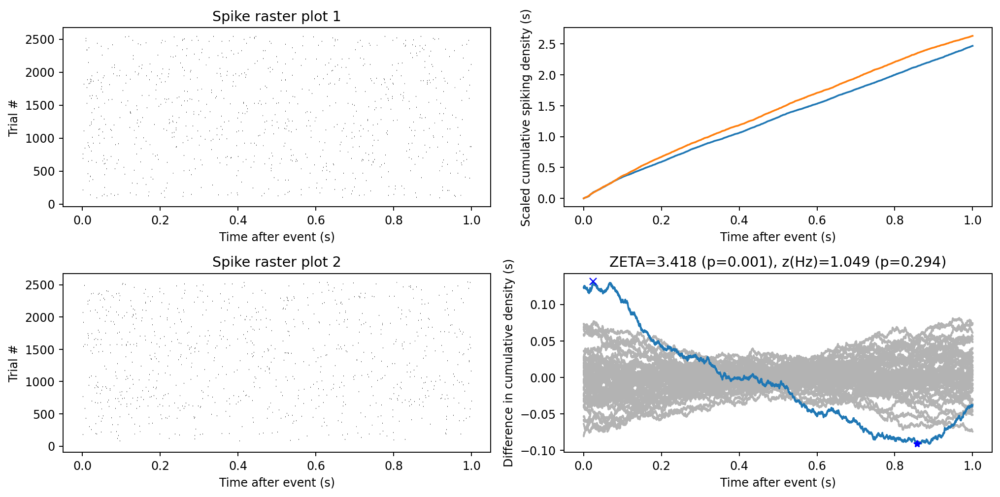

		Is neuron 79 responding differently with and without laser? (elapsed time: 13.30 s):           
		two-sample zeta-test p-value: 0.0006318701934988624
		t-test p-value:0.29435731317659564
Processing 81 neuron


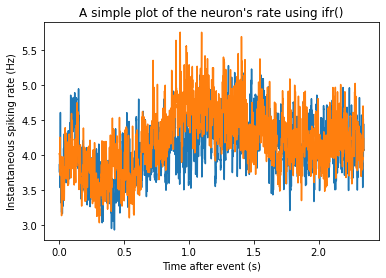


	Running two-sample zeta-test on one neuron, different stimuli


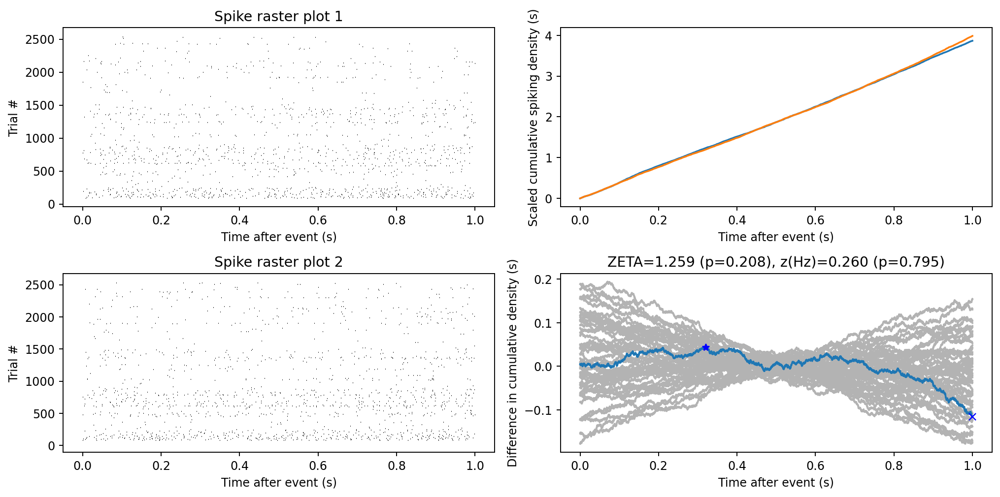

		Is neuron 81 responding differently with and without laser? (elapsed time: 19.12 s):           
		two-sample zeta-test p-value: 0.20795046183829036
		t-test p-value:0.7949053124997849
Processing 83 neuron


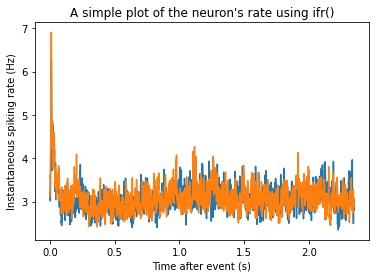


	Running two-sample zeta-test on one neuron, different stimuli


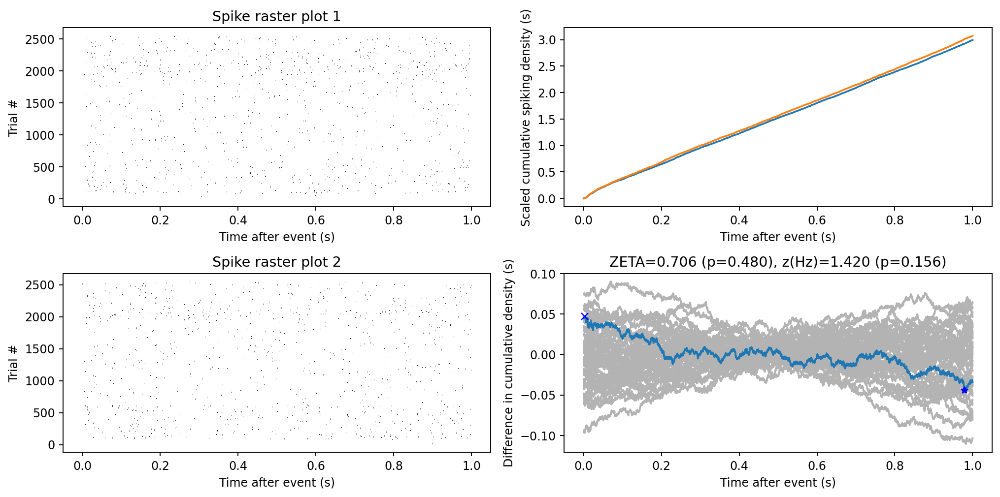

		Is neuron 83 responding differently with and without laser? (elapsed time: 15.44 s):           
		two-sample zeta-test p-value: 0.4799788923040387
		t-test p-value:0.15556635367920796
Processing 84 neuron


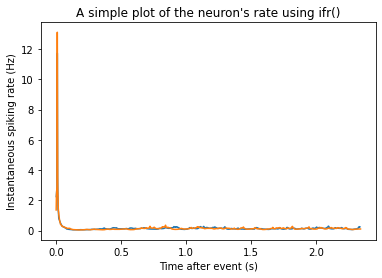


	Running two-sample zeta-test on one neuron, different stimuli


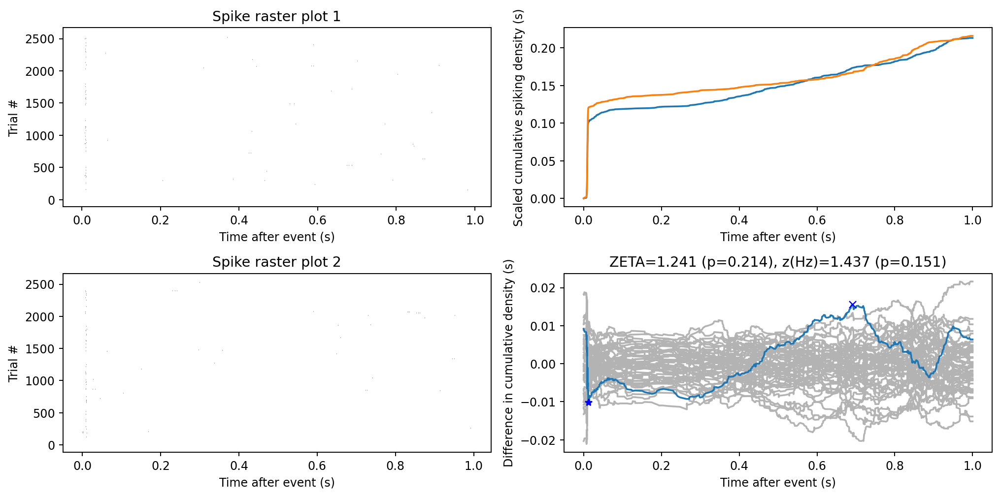

		Is neuron 84 responding differently with and without laser? (elapsed time: 9.19 s):           
		two-sample zeta-test p-value: 0.21444294766952132
		t-test p-value:0.15063720342309347
Processing 85 neuron


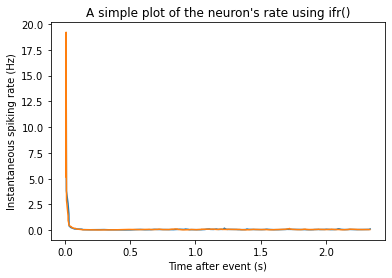


	Running two-sample zeta-test on one neuron, different stimuli


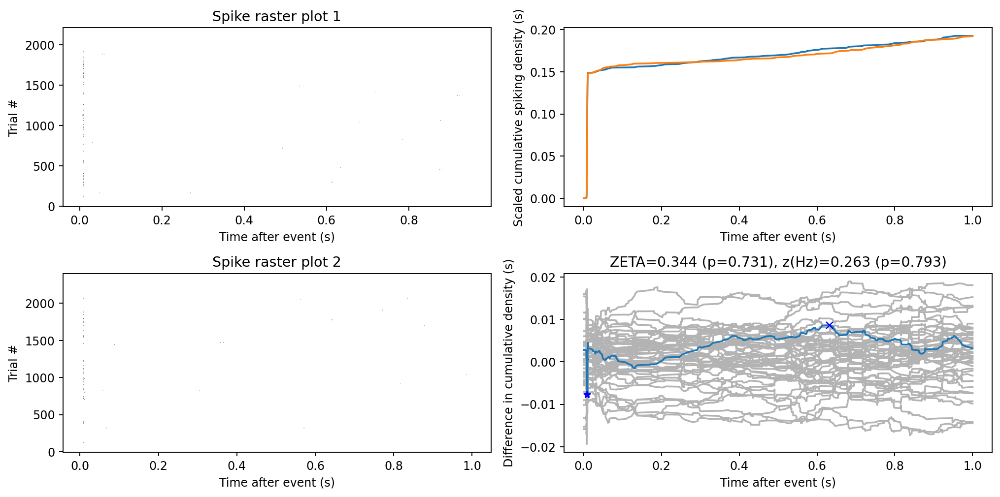

		Is neuron 85 responding differently with and without laser? (elapsed time: 9.38 s):           
		two-sample zeta-test p-value: 0.7306534538100805
		t-test p-value:0.7926052145250138
Processing 87 neuron


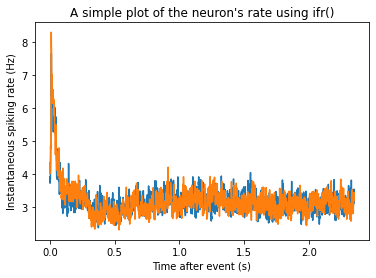


	Running two-sample zeta-test on one neuron, different stimuli


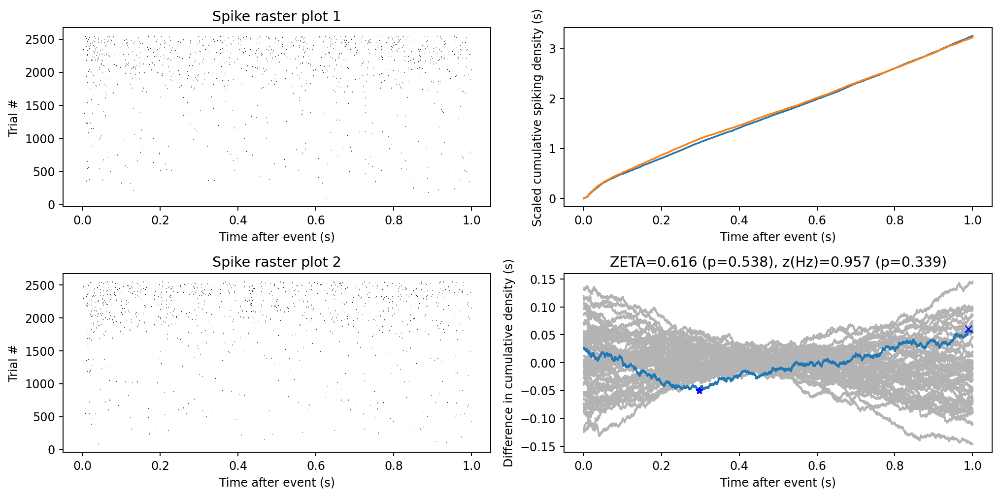

		Is neuron 87 responding differently with and without laser? (elapsed time: 15.74 s):           
		two-sample zeta-test p-value: 0.5378133530848681
		t-test p-value:0.3387980598896314
Processing 90 neuron


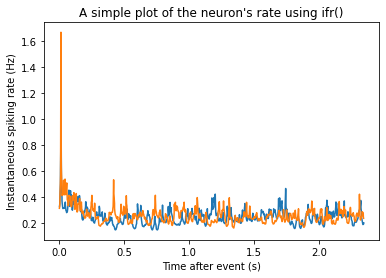


	Running two-sample zeta-test on one neuron, different stimuli


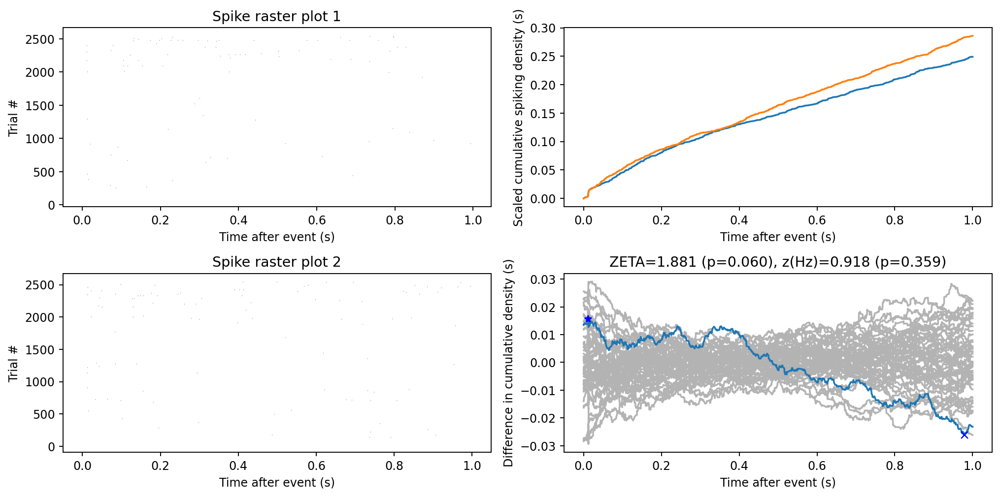

		Is neuron 90 responding differently with and without laser? (elapsed time: 8.68 s):           
		two-sample zeta-test p-value: 0.06000021118084842
		t-test p-value:0.35878824334444603
Processing 95 neuron


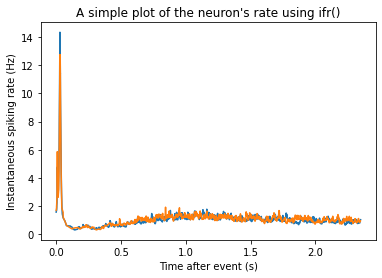


	Running two-sample zeta-test on one neuron, different stimuli


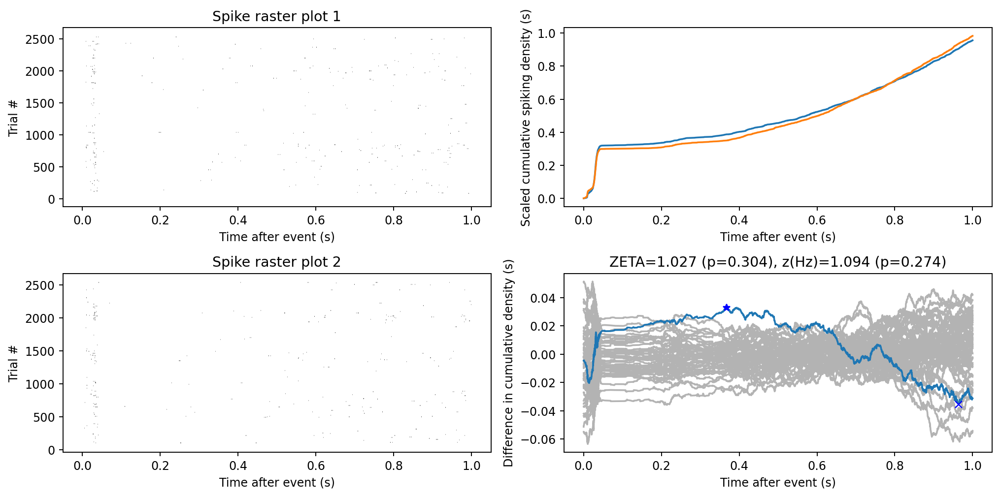

		Is neuron 95 responding differently with and without laser? (elapsed time: 10.26 s):           
		two-sample zeta-test p-value: 0.3043373949188264
		t-test p-value:0.27408000990888015
Processing 96 neuron


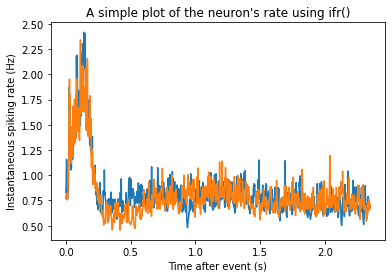


	Running two-sample zeta-test on one neuron, different stimuli


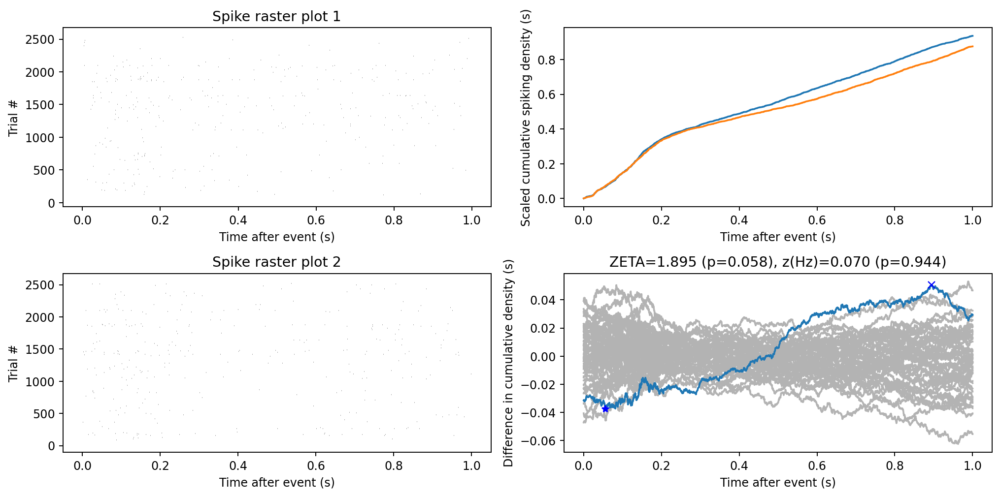

		Is neuron 96 responding differently with and without laser? (elapsed time: 10.07 s):           
		two-sample zeta-test p-value: 0.05815864578369778
		t-test p-value:0.9444097672155067
Processing 97 neuron


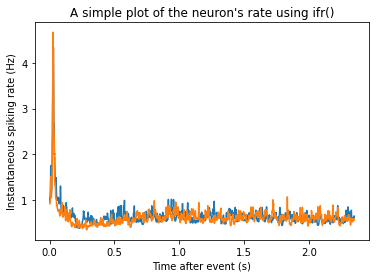


	Running two-sample zeta-test on one neuron, different stimuli


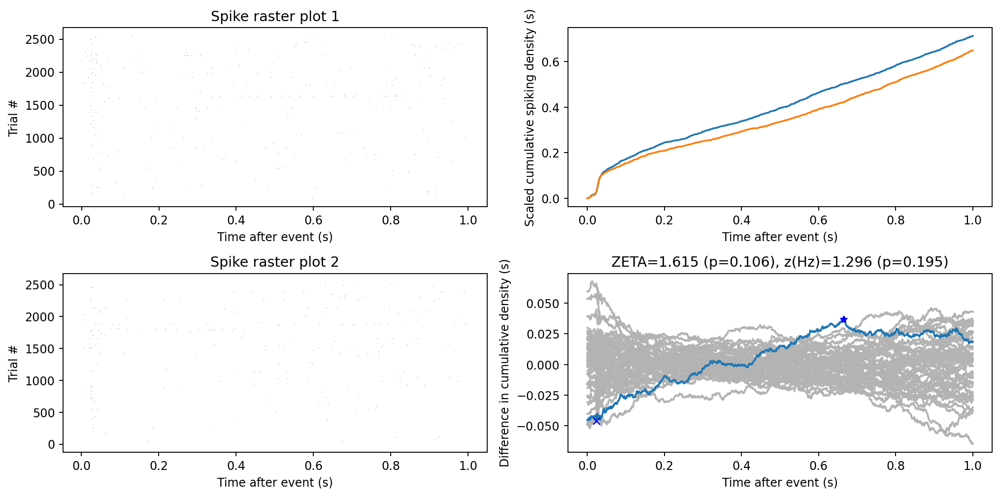

		Is neuron 97 responding differently with and without laser? (elapsed time: 9.40 s):           
		two-sample zeta-test p-value: 0.10635793535573446
		t-test p-value:0.19492046918625383
Processing 98 neuron


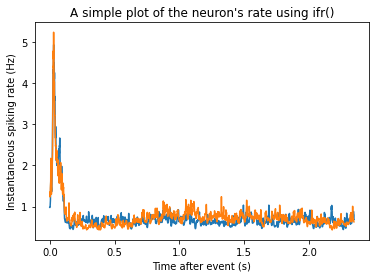


	Running two-sample zeta-test on one neuron, different stimuli


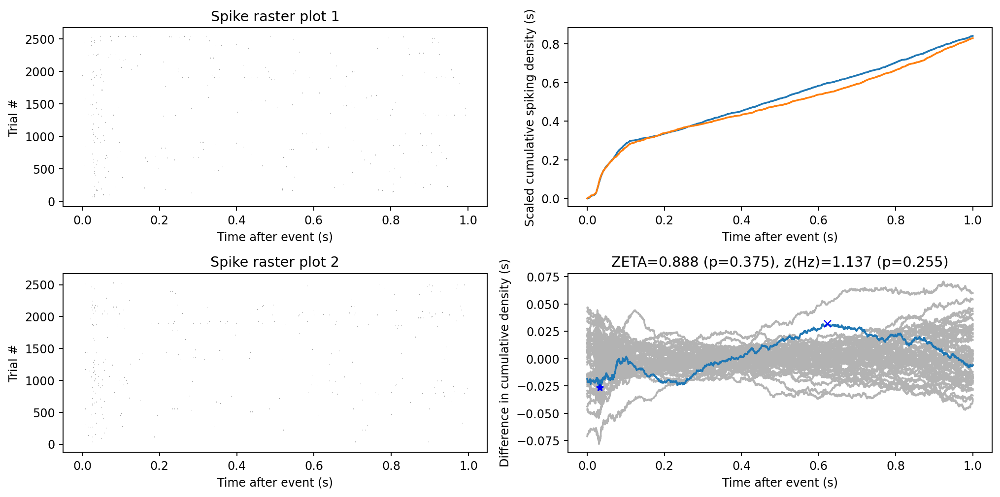

		Is neuron 98 responding differently with and without laser? (elapsed time: 9.99 s):           
		two-sample zeta-test p-value: 0.37474837570800423
		t-test p-value:0.255458240999058
Processing 99 neuron


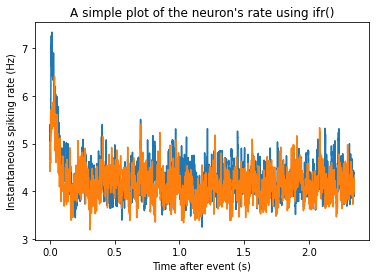


	Running two-sample zeta-test on one neuron, different stimuli


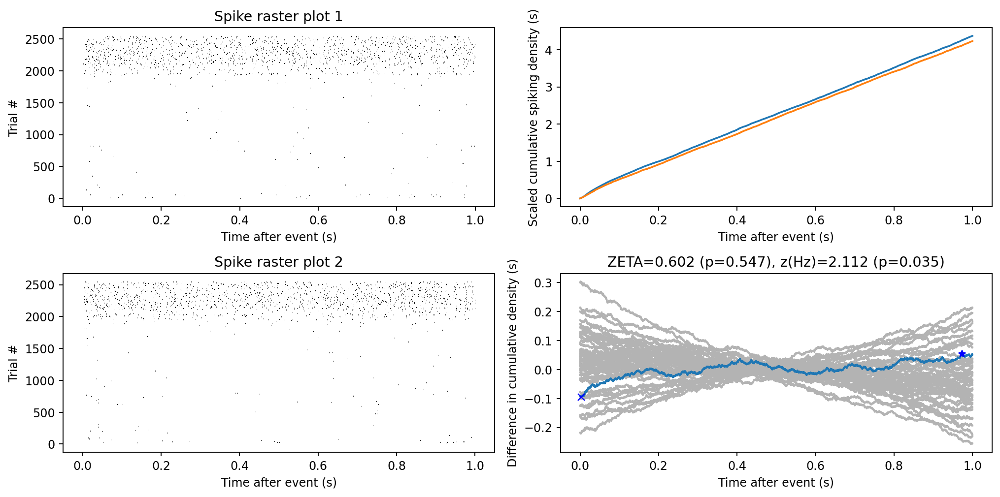

		Is neuron 99 responding differently with and without laser? (elapsed time: 18.98 s):           
		two-sample zeta-test p-value: 0.5470633921859109
		t-test p-value:0.034720151401434744
Processing 101 neuron


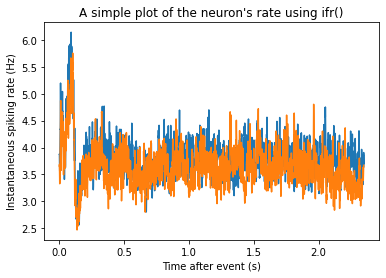


	Running two-sample zeta-test on one neuron, different stimuli


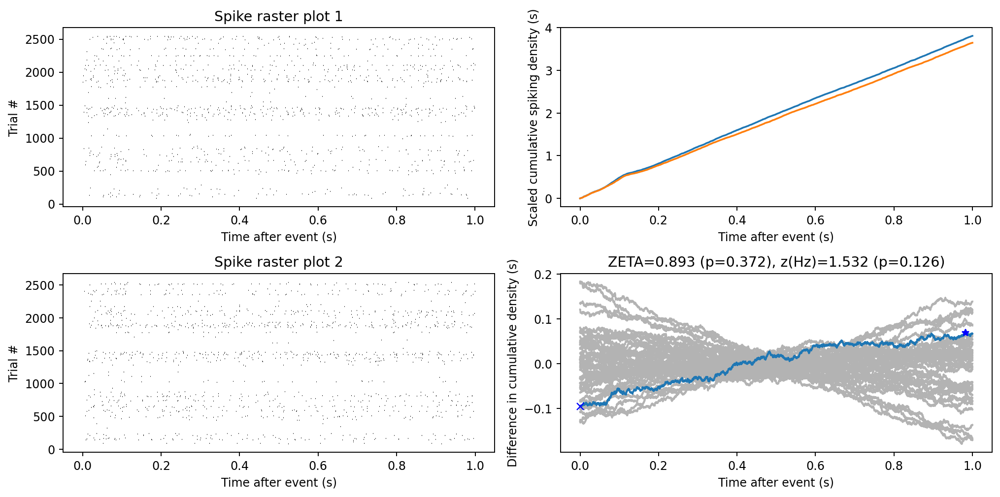

		Is neuron 101 responding differently with and without laser? (elapsed time: 17.21 s):           
		two-sample zeta-test p-value: 0.37168109511987124
		t-test p-value:0.12551970246077962
Processing 102 neuron


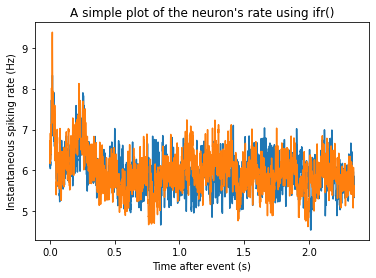


	Running two-sample zeta-test on one neuron, different stimuli


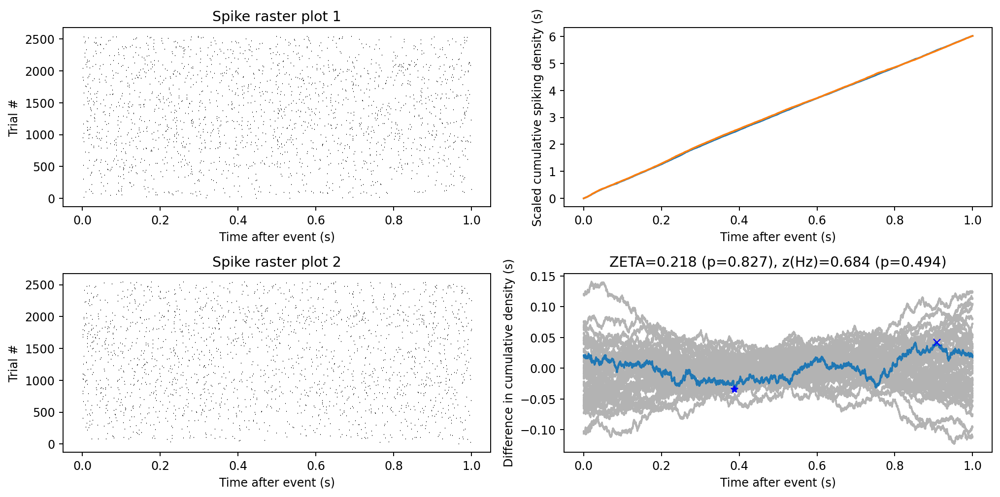

		Is neuron 102 responding differently with and without laser? (elapsed time: 27.69 s):           
		two-sample zeta-test p-value: 0.8272235456375459
		t-test p-value:0.4937087899703948
Processing 108 neuron


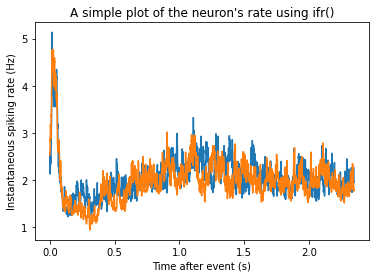


	Running two-sample zeta-test on one neuron, different stimuli


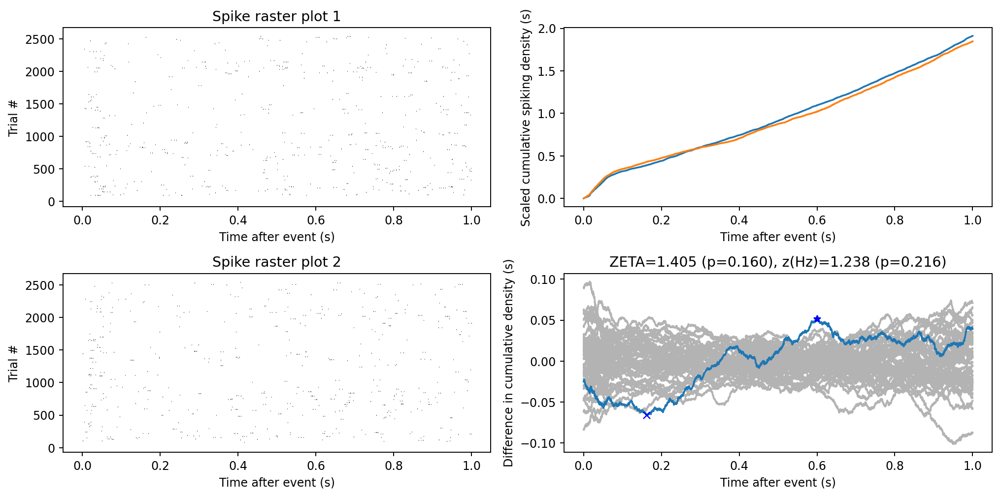

		Is neuron 108 responding differently with and without laser? (elapsed time: 12.57 s):           
		two-sample zeta-test p-value: 0.15995917575101448
		t-test p-value:0.21576368976775176
Processing 112 neuron


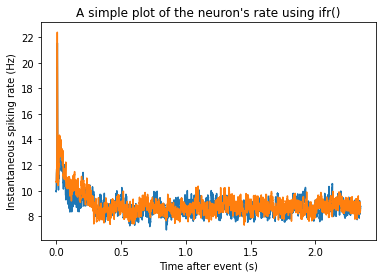


	Running two-sample zeta-test on one neuron, different stimuli


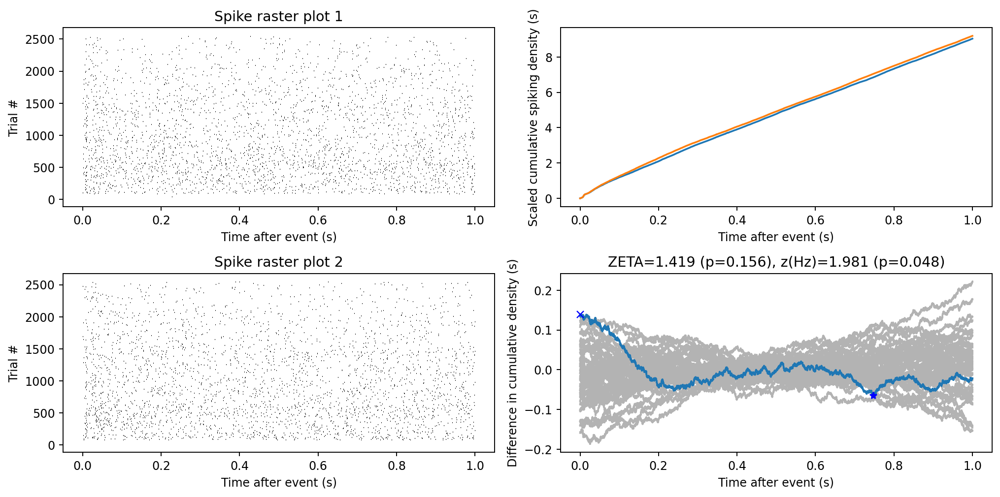

		Is neuron 112 responding differently with and without laser? (elapsed time: 44.16 s):           
		two-sample zeta-test p-value: 0.15603238969315547
		t-test p-value:0.04760609635284578
Processing 114 neuron


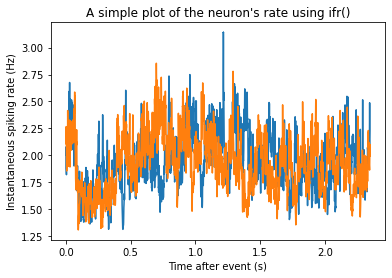


	Running two-sample zeta-test on one neuron, different stimuli


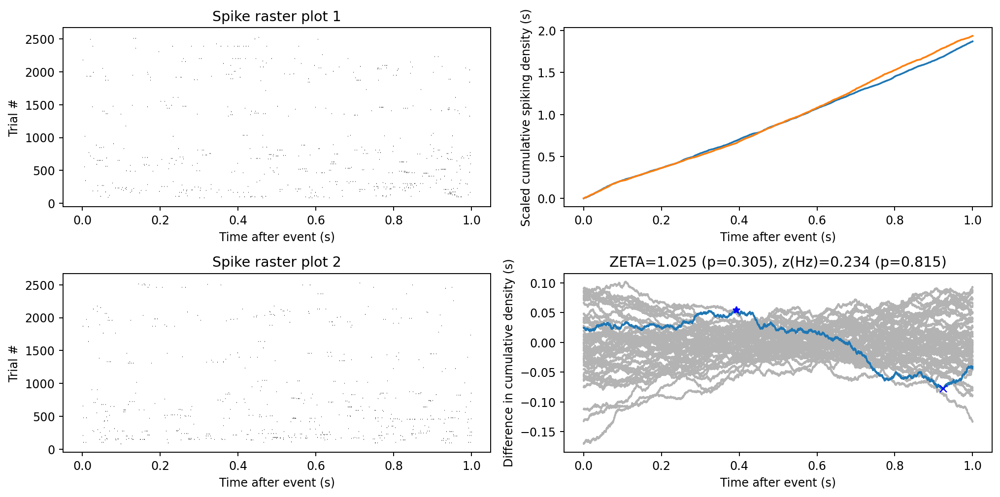

		Is neuron 114 responding differently with and without laser? (elapsed time: 12.30 s):           
		two-sample zeta-test p-value: 0.3053506270929369
		t-test p-value:0.8146763168147387
Processing 119 neuron


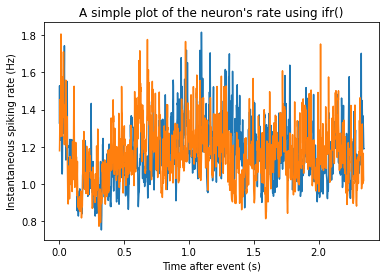


	Running two-sample zeta-test on one neuron, different stimuli


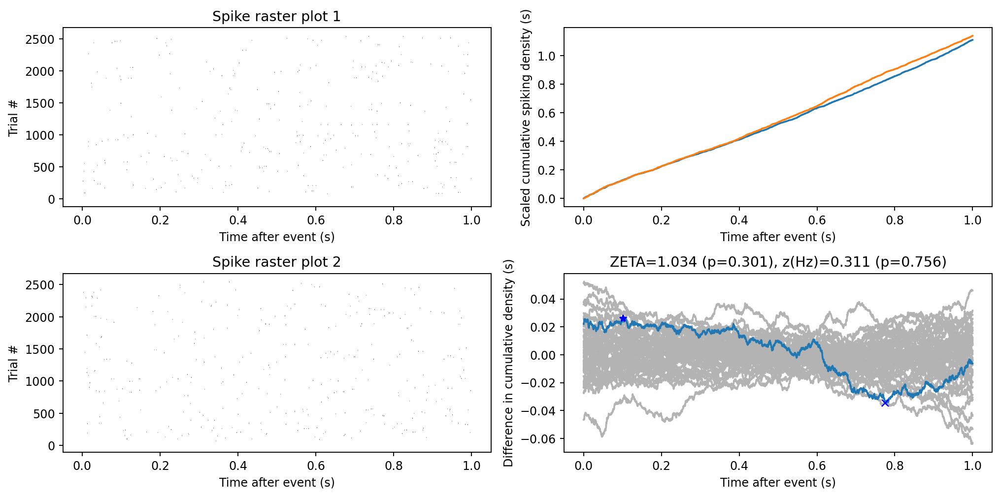

		Is neuron 119 responding differently with and without laser? (elapsed time: 10.25 s):           
		two-sample zeta-test p-value: 0.3012620239307767
		t-test p-value:0.7559239346714646
Processing 121 neuron


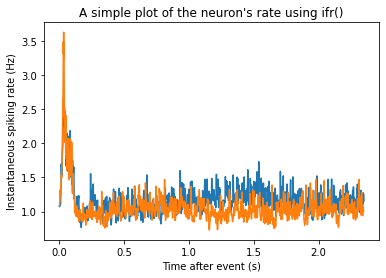


	Running two-sample zeta-test on one neuron, different stimuli


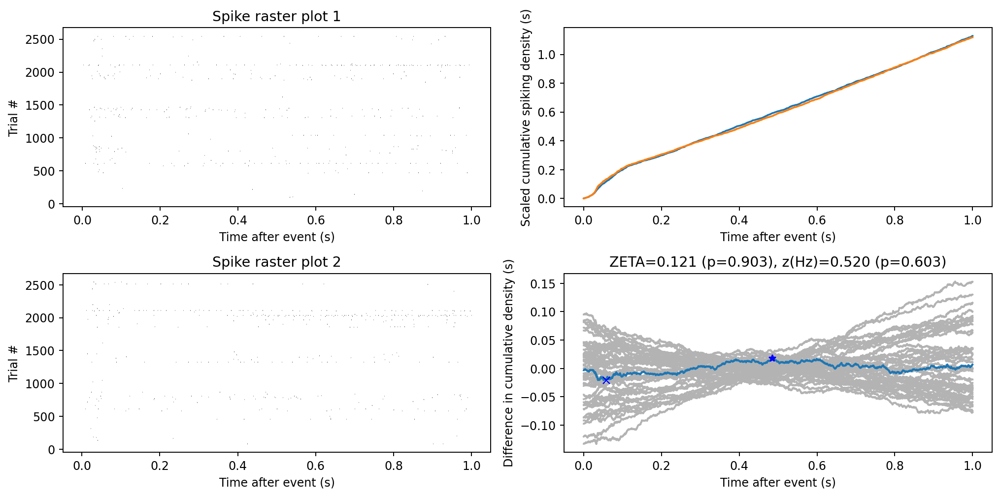

		Is neuron 121 responding differently with and without laser? (elapsed time: 10.11 s):           
		two-sample zeta-test p-value: 0.9034000473239744
		t-test p-value:0.6032995028521799
Processing 123 neuron


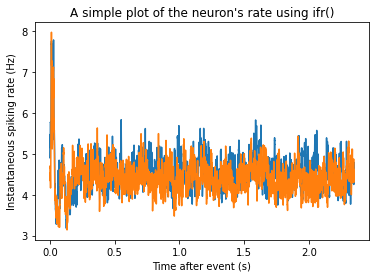


	Running two-sample zeta-test on one neuron, different stimuli


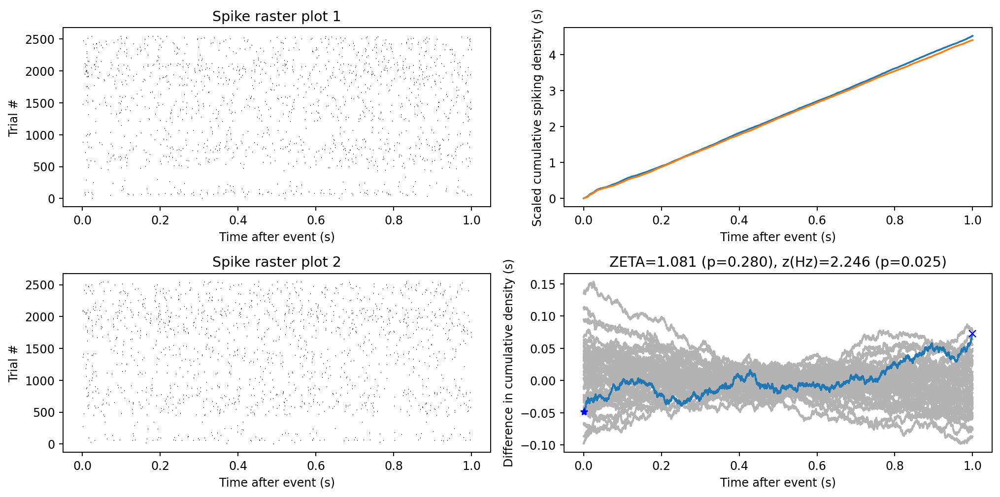

		Is neuron 123 responding differently with and without laser? (elapsed time: 20.59 s):           
		two-sample zeta-test p-value: 0.279670163441605
		t-test p-value:0.024711435786553604
Processing 128 neuron


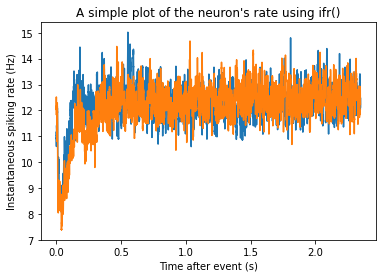


	Running two-sample zeta-test on one neuron, different stimuli


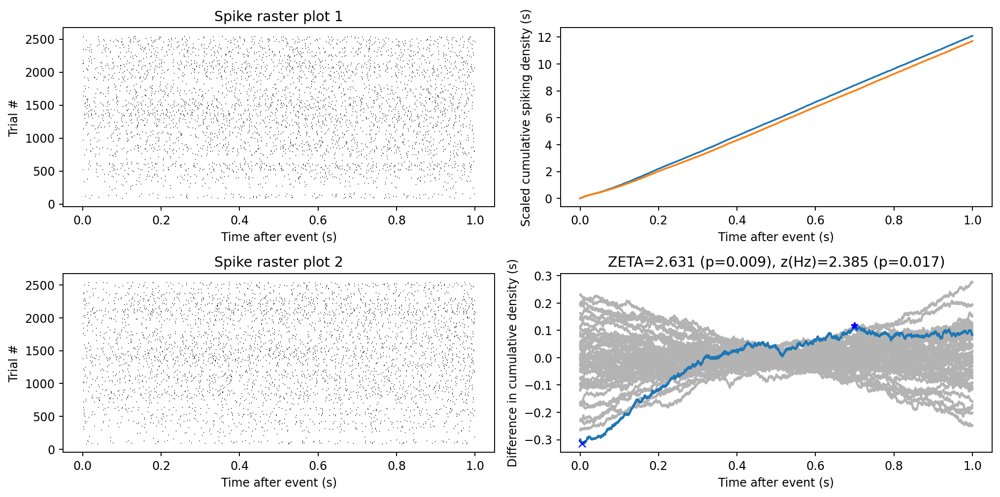

		Is neuron 128 responding differently with and without laser? (elapsed time: 66.37 s):           
		two-sample zeta-test p-value: 0.008507606002695511
		t-test p-value:0.017070510003117077
Processing 130 neuron


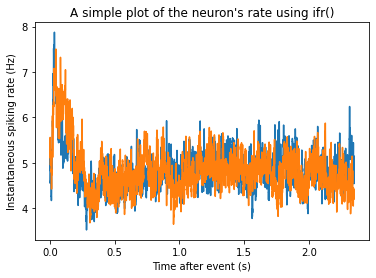


	Running two-sample zeta-test on one neuron, different stimuli


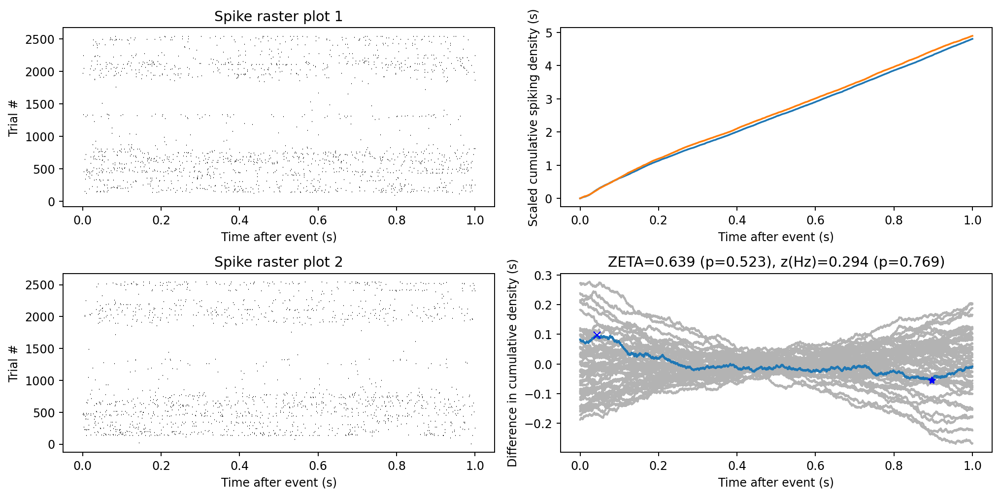

		Is neuron 130 responding differently with and without laser? (elapsed time: 21.87 s):           
		two-sample zeta-test p-value: 0.5226461945761697
		t-test p-value:0.7688405672405315
Processing 132 neuron


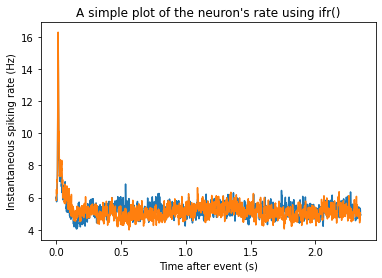


	Running two-sample zeta-test on one neuron, different stimuli


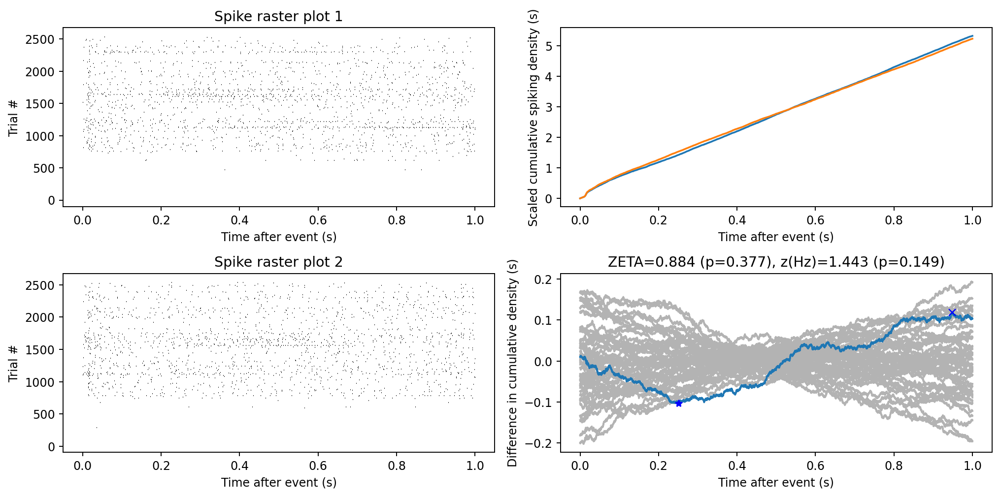

		Is neuron 132 responding differently with and without laser? (elapsed time: 23.10 s):           
		two-sample zeta-test p-value: 0.3769033705396261
		t-test p-value:0.14903977190770187
Processing 134 neuron


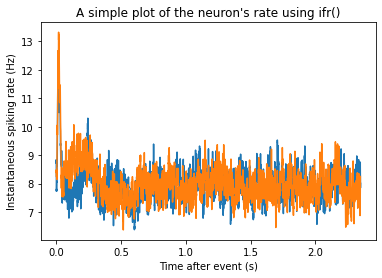


	Running two-sample zeta-test on one neuron, different stimuli


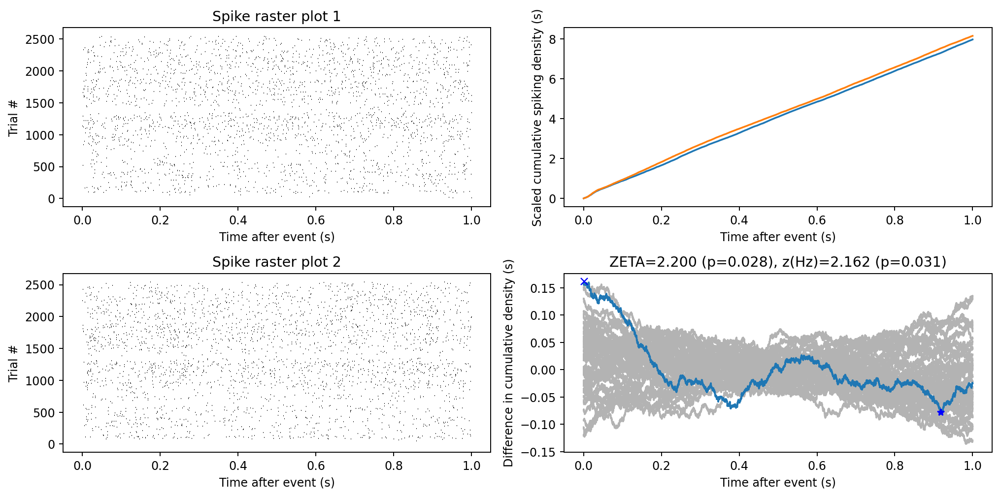

		Is neuron 134 responding differently with and without laser? (elapsed time: 38.84 s):           
		two-sample zeta-test p-value: 0.0277847025881236
		t-test p-value:0.030632157770980398
Processing 135 neuron


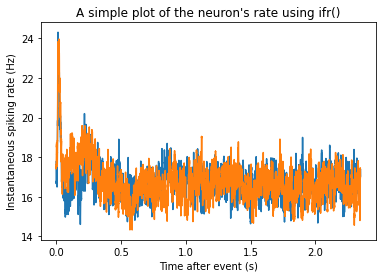


	Running two-sample zeta-test on one neuron, different stimuli


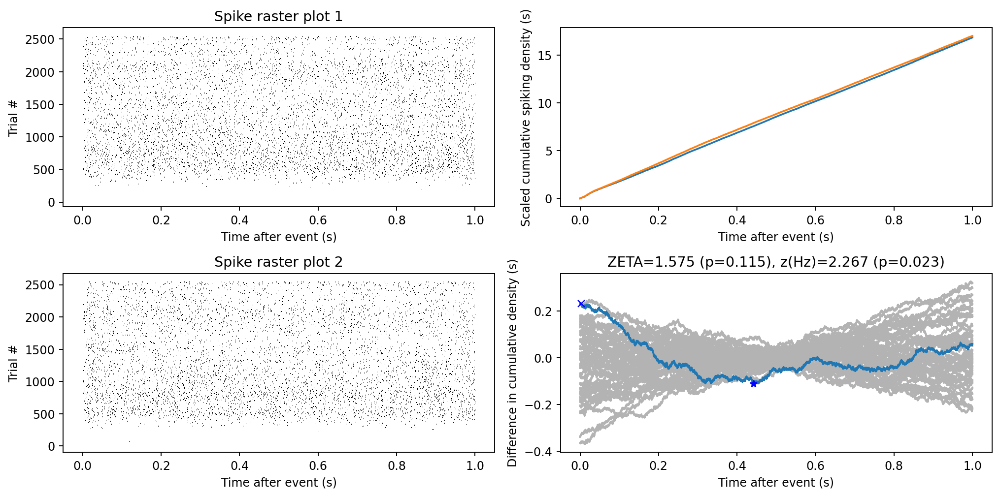

		Is neuron 135 responding differently with and without laser? (elapsed time: 110.86 s):           
		two-sample zeta-test p-value: 0.1152122602414124
		t-test p-value:0.023368608069079984
Processing 138 neuron


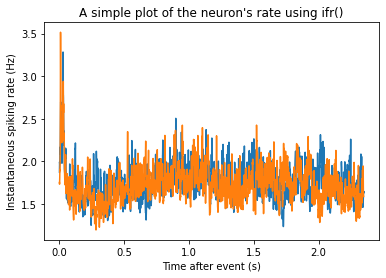


	Running two-sample zeta-test on one neuron, different stimuli


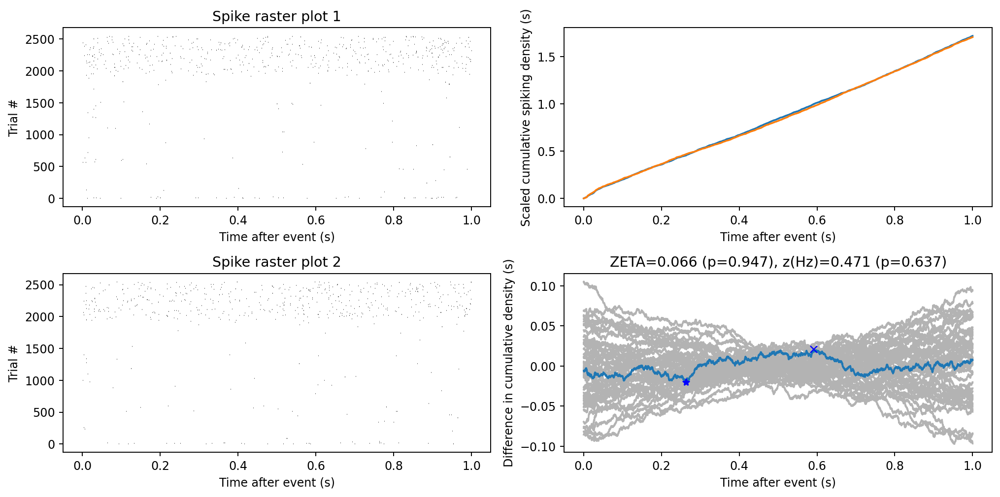

		Is neuron 138 responding differently with and without laser? (elapsed time: 10.89 s):           
		two-sample zeta-test p-value: 0.9474315937541777
		t-test p-value:0.6374284644289806
Processing 142 neuron


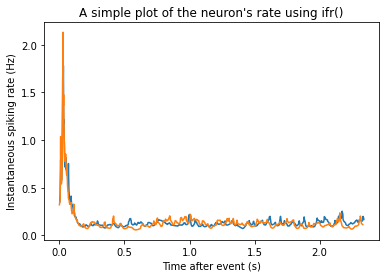


	Running two-sample zeta-test on one neuron, different stimuli


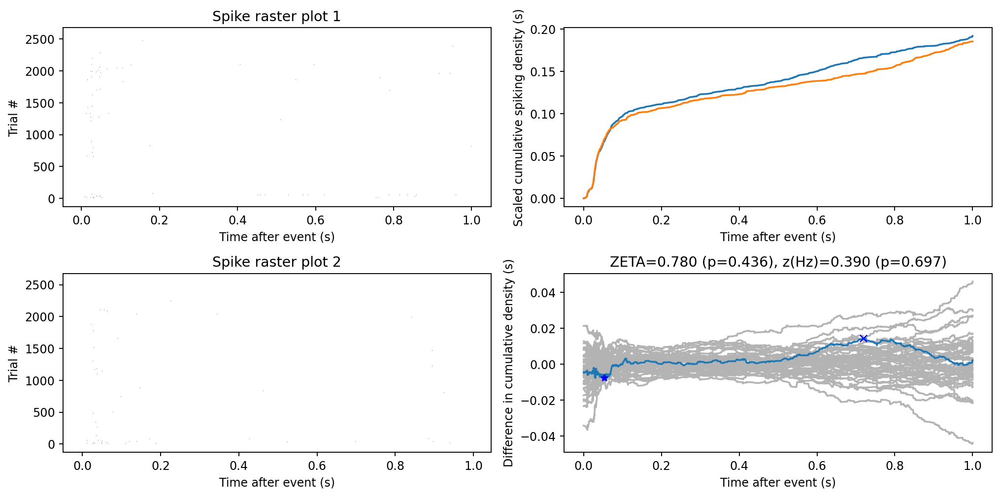

		Is neuron 142 responding differently with and without laser? (elapsed time: 7.93 s):           
		two-sample zeta-test p-value: 0.4356465566356438
		t-test p-value:0.6965017767172152
Processing 146 neuron


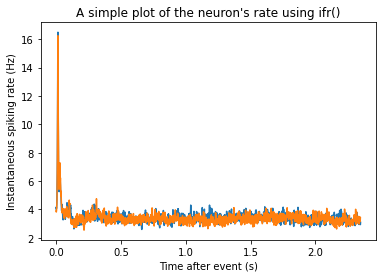


	Running two-sample zeta-test on one neuron, different stimuli


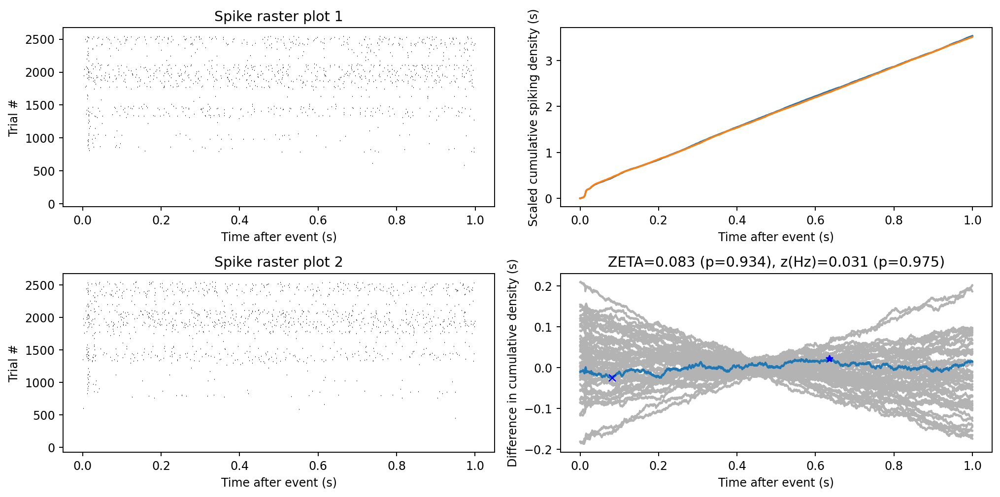

		Is neuron 146 responding differently with and without laser? (elapsed time: 18.69 s):           
		two-sample zeta-test p-value: 0.9339089459433406
		t-test p-value:0.9754890281165653
Processing 147 neuron


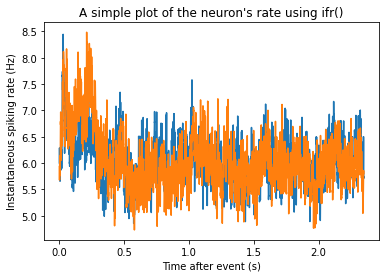


	Running two-sample zeta-test on one neuron, different stimuli


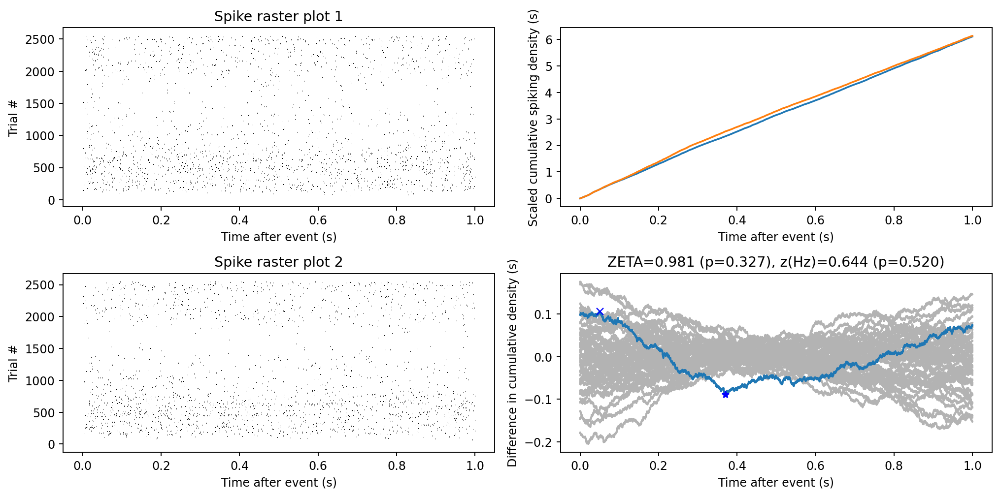

		Is neuron 147 responding differently with and without laser? (elapsed time: 26.88 s):           
		two-sample zeta-test p-value: 0.3266333452233986
		t-test p-value:0.5195543407085942


In [33]:
boolPlot = True

for n in audonly:
    print('Processing {} neuron'.format(n))
    t = time.time()
    neuron = asdf[n]
    vecSpikeTimes1 = neuron[(neuron>datasep[seg])&(neuron<datasep[seg+1]), np.newaxis]/1000

    vecTime, vecRate, dIFR = ifr(vecSpikeTimes1, arrEventTimes[:,0])
    vecTime_l, vecRate_l, dIFR = ifr(vecSpikeTimes1, arrLaserEventTimes[:,0])

    f, ax = plt.subplots(1, figsize=(6, 4))
    ax.plot(vecTime, vecRate)
    ax.plot(vecTime_l, vecRate_l)
    ax.set(xlabel='Time after event (s)', ylabel='Instantaneous spiking rate (Hz)')
    ax.set(title="A simple plot of the neuron's rate using ifr()")
    plt.show()
    
    
#     dblZetaP, dZETA, dRate = zetatest(vecSpikeTimes1, arrEventTimes,
#                                                     dblUseMaxDur=dblUseMaxDur,
#                                                     intResampNum=intResampNum,
#                                                     dblJitterSize=dblJitterSize,
#                                                     boolPlot=boolPlot,
#                                                     tplRestrictRange=tplRestrictRange,
#                                                     boolReturnRate=boolReturnRate)

#     dblElapsedT2 = time.time() - t
#     timedur[n]=dblElapsedT2
#     nevents[n]=vecSpikeTimes1.shape[0]
#     print(f"\t\tSpecified parameters (elapsed time: {dblElapsedT2:.2f} s): \
#            \n\t\tzeta-test p-value: {dblZetaP}\n\t\tt-test p-value:{dZETA['dblMeanP']}")
#     zetapval[n]=dblZetaP
#     ttestpval[n]=dZETA['dblMeanP']
#     IRFlength[n]=dRate['vecRate'].shape[0]
    
    #case 2: is neuron 1 responding differently to gratings oriented at 0 and 90 degrees?

    print('\n\tRunning two-sample zeta-test on one neuron, different stimuli')
    t = time.time()
    dblZetaTwoSample2a, dZETA2a = zetatest2(vecSpikeTimes1,  arrEventTimes,
                                           vecSpikeTimes1,  arrLaserEventTimes,
                                           dblUseMaxDur, intResampNum, boolPlot)
    dblElapsedT6 = time.time() - t
    
    print(f"\t\tIs neuron {n} responding differently with and without laser? (elapsed time: {dblElapsedT6:.2f} s): \
          \n\t\ttwo-sample zeta-test p-value: {dblZetaTwoSample2a}\n\t\tt-test p-value:{dZETA2a['dblMeanP']}")
    

In [82]:
#### DOESNT WORK IN A FUCTION!!!####
# import time
# def sigAudFR_zeta_pvalue(asdf, ttls, 
#                          datasep, seg, stim_dur=10, 
#                          boolPlot = False):# Do we want to plot the results?
    
#     nneur = asdf.shape[0]
#     # use minimum of trial-to-trial durations as analysis window size
#     dblUseMaxDur = np.min(np.diff(ttls))

#     # 50 random resamplings should give us a good enough idea if this cell is responsive.
#     # If the p-value is close to 0.05, we should increase this number.
#     intResampNum = 50 

#     # what size of jittering do we want? (multiple of dblUseMaxDur; default is 2.0)
#     dblJitterSize = 2.0

#     # do we want to restrict the peak detection to for example the time during stimulus?
#     # Then put (0, 1) here.
#     tplRestrictRange = (0, .02)

#     # do we want to compute the instantaneous firing rate? 
#     boolReturnRate = True

#     # create a T by 2 array with stimulus onsets and offsets so we can also compute the t-test
#     arrEventTimes = np.transpose(np.array([ttls, ttls+stim_dur]))/1000
#     vecStimulusStartTimes = ttls/1000
    
#     print('Starting loop: ')
    
#     for n in np.arange(6):
#         print('Processing {} neuron'.format(n))
#         t = time.time()
#         neuron = asdf[n]
#         vecSpikeTimes1 = neuron[(neuron>datasep[seg])&(neuron<datasep[seg+1]), np.newaxis]/1000
#         dblZetaP, dZETA, dRate = zetatest(vecSpikeTimes1, arrEventTimes,
#                                                         dblUseMaxDur=dblUseMaxDur,
#                                                         intResampNum=intResampNum,
#                                                         dblJitterSize=dblJitterSize,
#                                                         boolPlot=boolPlot,
#                                                         tplRestrictRange=tplRestrictRange,
#                                                         boolReturnRate=boolReturnRate)

#         dblElapsedT2 = time.time() - t
#         print(f"\nSpecified parameters (elapsed time: {dblElapsedT2:.2f} s): \
#               \nzeta-test p-value: {dblZetaP}\nt-test p-value:{dZETA['dblMeanP']}")
    
# #     for n in np.arange(nneur):
# #         print('Processing {} neuron'.format(n))
# #         t = time.time()
# #         neuron = asdf[n]
# #         vecSpikeTimes1 = neuron[(neuron>datasep[seg])&(neuron<datasep[seg+1]), np.newaxis]/1000
# #         dblZetaP, dZETA, dRate = zetatest(vecSpikeTimes1, arrEventTimes,
# #                                                         dblUseMaxDur=dblUseMaxDur,
# #                                                         intResampNum=intResampNum,
# #                                                         dblJitterSize=dblJitterSize,
# #                                                         boolPlot=boolPlot,
# #                                                         tplRestrictRange=tplRestrictRange,
# #                                                         boolReturnRate=boolReturnRate)

# #         dblElapsedT2 = time.time() - t
# #         print(f"\tSpecified parameters (elapsed time: {dblElapsedT2:.2f} s): \
# #               \tzeta-test p-value: {dblZetaP}\tt-test p-value:{dZETA['dblMeanP']}")
# #         if n == 0:
# #             activity_df = pd.DataFrame()
# #             vecTime = dRate['vecT']
# #             IFR = np.zeros((nneur, dRate['vecRates'].shape[0]))
# #             process_time = np.zeros(nneur)
# #             n_events = np.zeros(nneur)
# #         IFR[n] = dRate['vecRates']
# #         activity.loc[n, 'zeta p'] = dblZetaP
# #         activity.loc[n, 't test p'] = dZETA['dblMeanP']
# #         process_time[n] = time.time()-t
# #         n_events[n] = vecSpikeTimes1.shape[0]
# #         print('\tNeuron {0} took {1} secs'.format(n, time.time()-t))

#     return activity_df, IFR, vecTime, processing_time, n_events
# print(asdf[:10].shape)
# activity_df2, IFR, vecTime, processing_time, n_events = sigAudFR_zeta_pvalue(asdf[:10], ttls, datasep, seg, stim_dur=10, boolPlot=True)


(10,)
Starting loop: 
Processing 0 neuron


KeyboardInterrupt: 

# PREVIOUS ATTEMPTS FOR ANALYSIS

Bin the data

Check for spatial restricted neurons

Compare binned data between laser vs nonlaser

Neuron:  6
	No laser, 50 ms timewindow


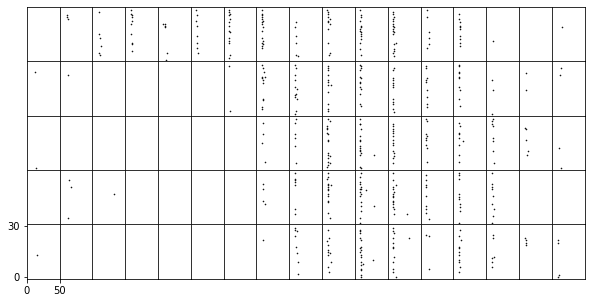

	Laser, 50 ms timewindow


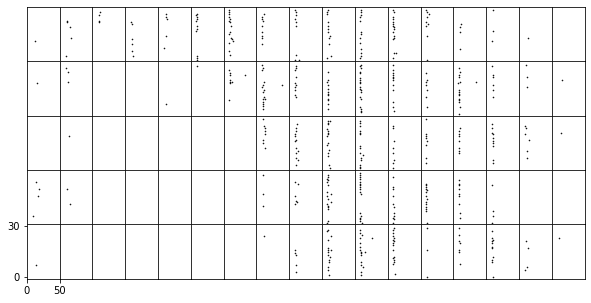

	No laser, 200 ms timewindow


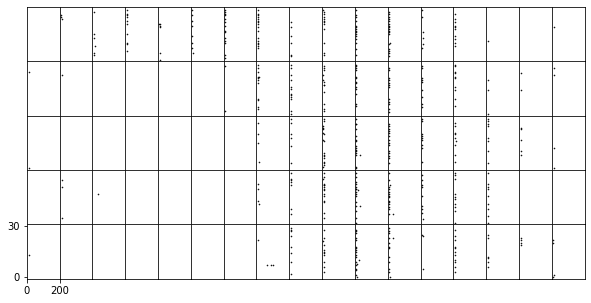

	Laser, 200 ms timewindow


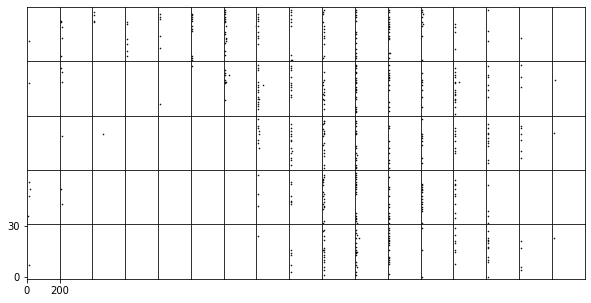

Neuron:  24
	No laser, 50 ms timewindow


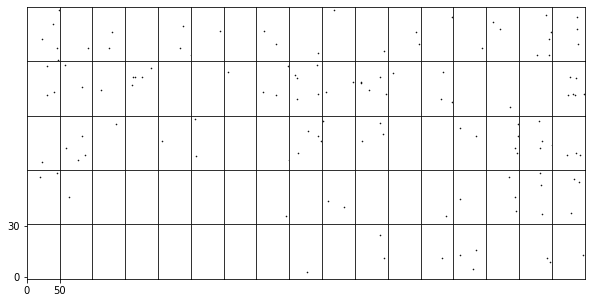

	Laser, 50 ms timewindow


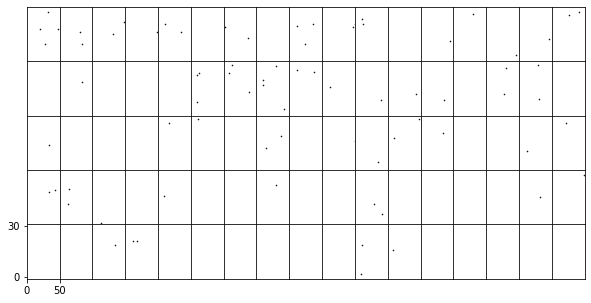

	No laser, 200 ms timewindow


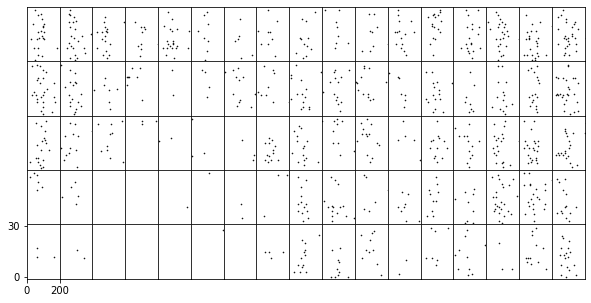

	Laser, 200 ms timewindow


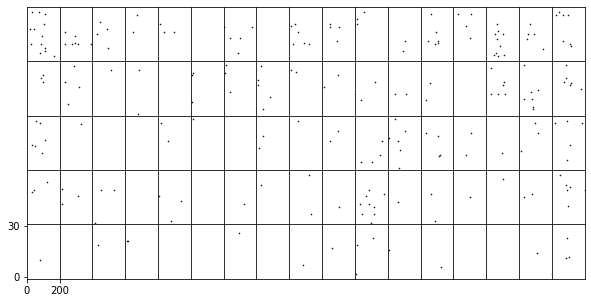

Neuron:  61
	No laser, 50 ms timewindow


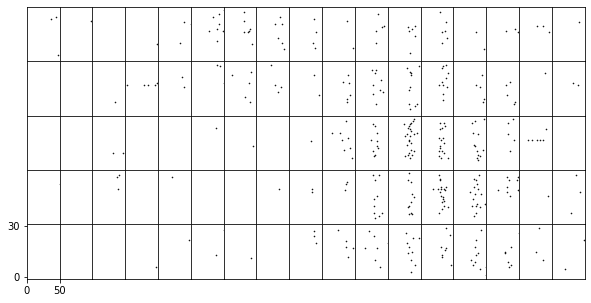

	Laser, 50 ms timewindow


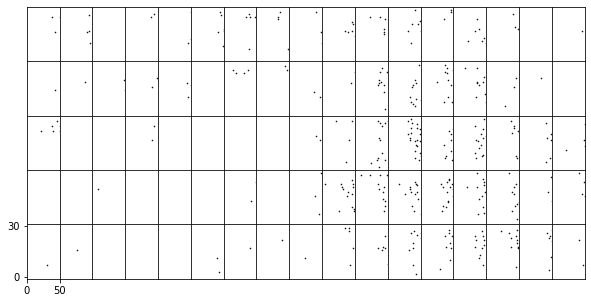

	No laser, 200 ms timewindow


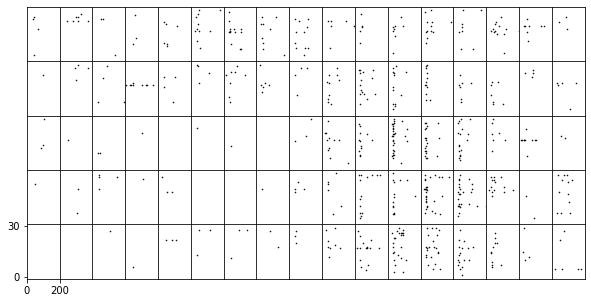

	Laser, 200 ms timewindow


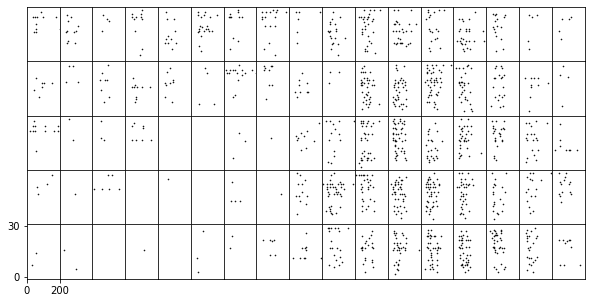

Neuron:  100
	No laser, 50 ms timewindow


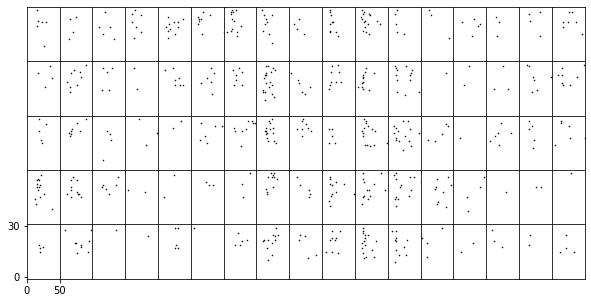

	Laser, 50 ms timewindow


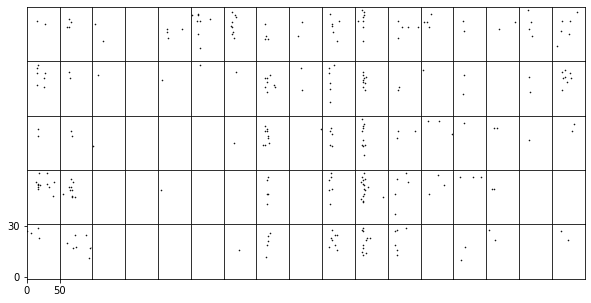

	No laser, 200 ms timewindow


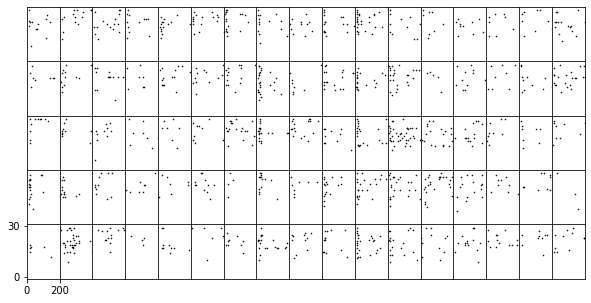

	Laser, 200 ms timewindow


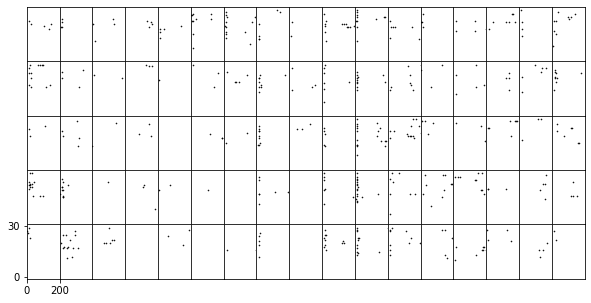

Neuron:  154
	No laser, 50 ms timewindow


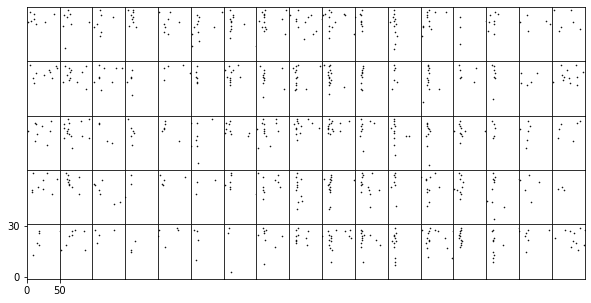

	Laser, 50 ms timewindow


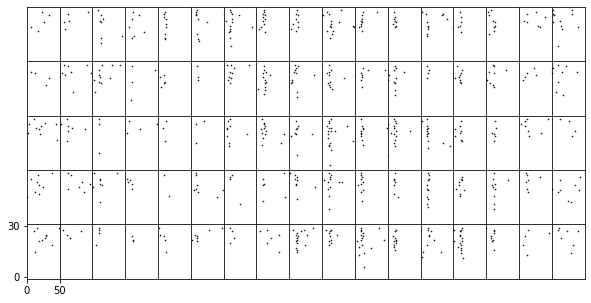

	No laser, 200 ms timewindow


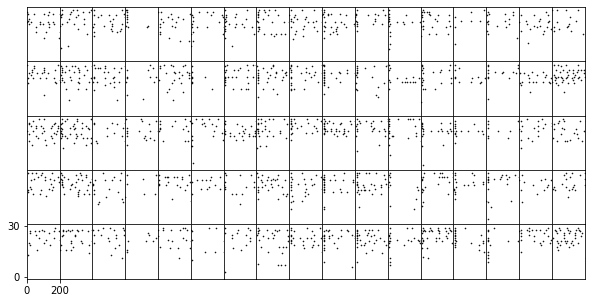

	Laser, 200 ms timewindow


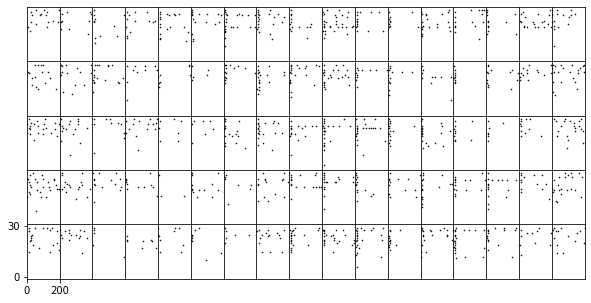

Neuron:  155
	No laser, 50 ms timewindow


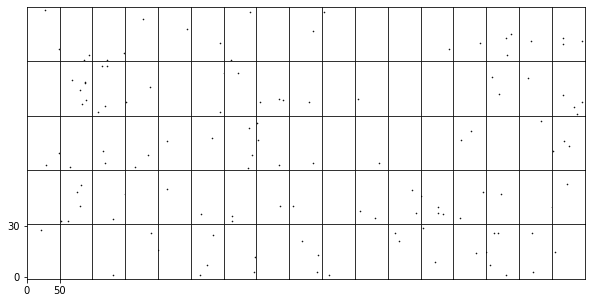

	Laser, 50 ms timewindow


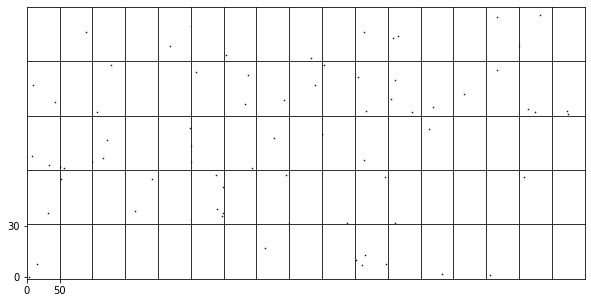

	No laser, 200 ms timewindow


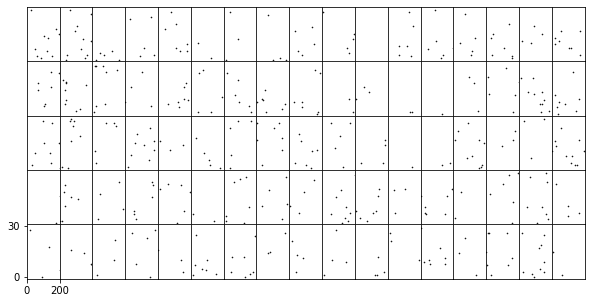

	Laser, 200 ms timewindow


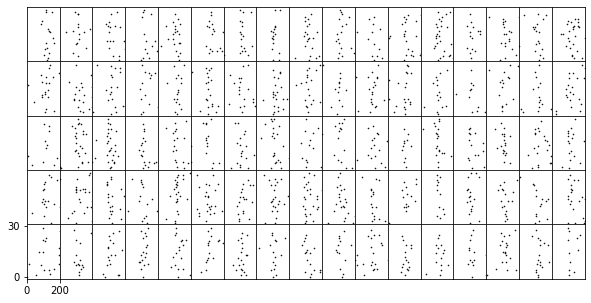

In [57]:
nois =[6, 24, 61, 100, 154, 155]
dirname = '/media/feldheimlab/E82E-1525/240131 labmeeting/'
for noi in nois:
    print('Neuron: ', noi)
    tr = 50
    print('\tNo laser, 50 ms timewindow')
    PatternRaster(pattern[noi,:,:,0,:], timerange=tr, 
                  savepath= os.path.join(dirname, 'neuron-{0}_no-laser_time-{1}ms.png'.format(noi, tr)))
    print('\tLaser, 50 ms timewindow')
    PatternRaster(pattern[noi,:,:,1,:], timerange=tr, 
                  savepath= os.path.join(dirname, 'neuron-{0}_laser_time-{1}ms.png'.format(noi, tr)))
    
    tr = 200
    print('\tNo laser, 200 ms timewindow')
    PatternRaster(pattern[noi,:,:,0,:], timerange=tr, 
                  savepath= os.path.join(dirname, 'neuron-{0}_no-laser_time-{1}ms.png'.format(noi, tr)))
    print('\tLaser, 200 ms timewindow')
    PatternRaster(pattern[noi,:,:,1,:], timerange=tr, 
                  savepath= os.path.join(dirname, 'neuron-{0}_laser_time-{1}ms.png'.format(noi, tr)))

Neuron 6 with 0-500 ms timerange
(5, 17, 2, 30, 100)


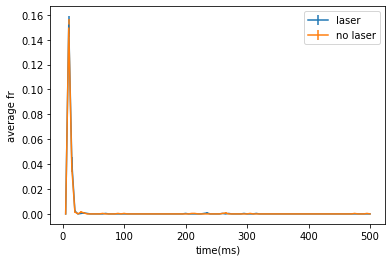

Neuron 24 with 0-500 ms timerange
(5, 17, 2, 30, 100)


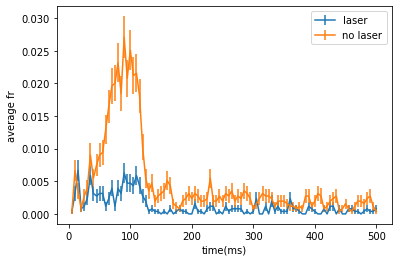

Neuron 61 with 0-500 ms timerange
(5, 17, 2, 30, 100)


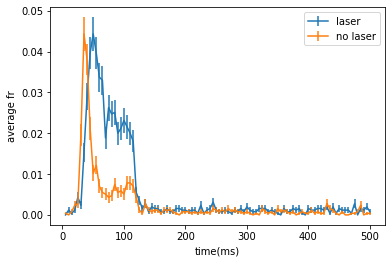

Neuron 100 with 0-500 ms timerange
(5, 17, 2, 30, 100)


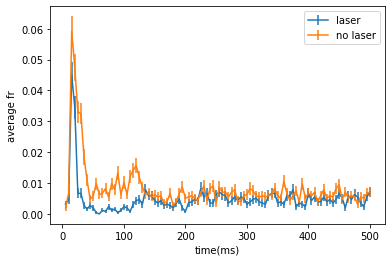

Neuron 154 with 0-500 ms timerange
(5, 17, 2, 30, 100)


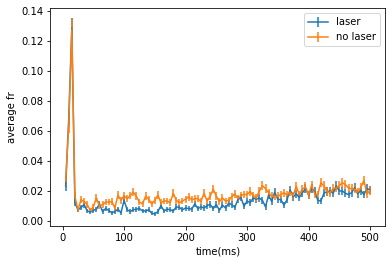

Neuron 155 with 0-500 ms timerange
(5, 17, 2, 30, 100)


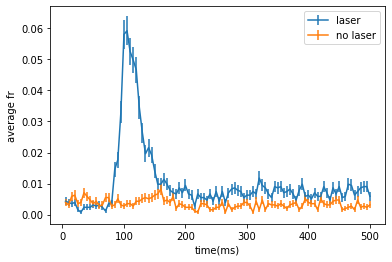

In [64]:
goodneur = np.where(aic[:,0,0] > aic[:,0,1])[0]

neurons = [6,7,62]

savedir = '/media/feldheimlab/E82E-1525/240131 labmeeting/'
nois =[6, 24, 61, 100, 154, 155]
save = True

for t, tr in enumerate([500]):
    for n, noi in enumerate(nois):
        print('Neuron {0} with 0-{1} ms timerange'.format(noi,tr))
        if n == 0:
            timeBinSz = 5
            fr = PatternToCount(pattern, timerange=tr, timeBinSz = timeBinSz, verbose=False)
            mintime = 0
            maxtime = tr
            bins = np.arange(mintime, maxtime+timeBinSz, timeBinSz)
#         print('\tTimerange {0} without laser'.format(tr))
#         PatternRaster(pattern[noi,:,:,0,:], timerange=tr)
#         print('\tTimerange {0} with laser'.format(tr))
#         PatternRaster(pattern[noi,:,:,1,:], timerange=tr)
        
        
        ns = fr[noi].shape
        print(ns)
        colormax = np.max(fr[noi])
        colormin = 0

#         print('No laser:')
#         fig, axs = plt.subplots(ns[0], ns[1], figsize=(10,5))

#         for x in np.arange(ns[0]):
#             xpos = ns[0]-x-1
#             for y in np.arange(ns[1]):
#                 im = axs[xpos][y].imshow(fr[noi,x,y,0,::-1], vmin=colormin, vmax=colormax, 
#                                  cmap = 'Reds', aspect='auto', interpolation='none')
#                 axs[xpos][y].set_yticks([])
#                 axs[xpos][y].set_xticks([])
#         axs[x][0].set_yticks([0, ns[3]])
#         axs[x][0].set_yticklabels([ns[3], 0])
#         axs[x][0].set_ylabel('trials')
#         axs[x][0].set_xticks([0,  int(bins.shape[0]-1)])
#         axs[x][0].set_xticklabels([0, 250])
#         axs[x][0].set_xlabel('time(ms)')
#         if (x == (axs.shape[0]-1))&(y == (axs.shape[1]-1)):
#             divider = make_axes_locatable(axs[x][y])
#             cax = divider.append_axes('bottom', size='5%', pad = 0.05)
#             cbar = fig.colorbar(im, cax=cax, orientation='horizontal', 
#                                 ticks=[colormin, colormax], label='count')
#         plt.subplots_adjust(wspace=0, hspace=0)
#         plt.show()
        
#         fig, axs = plt.subplots(ns[0], ns[1], figsize=(10,5))
#         print('Laser:')
#         for x in np.arange(ns[0]):
#             xpos = ns[0]-x-1
#             for y in np.arange(ns[1]):
#                 im = axs[xpos][y].imshow(fr[noi,x,y,1,::-1], vmin=colormin, vmax=colormax, 
#                                  cmap = 'Reds', aspect='auto', interpolation='none')
#                 axs[xpos][y].set_yticks([])
#                 axs[xpos][y].set_xticks([])
#         axs[x][0].set_yticks([0, ns[3]])
#         axs[x][0].set_yticklabels([ns[3], 0])
#         axs[x][0].set_ylabel('trials')
#         axs[x][0].set_xticks([0,  int(bins.shape[0]-1)])
#         axs[x][0].set_xticklabels([0, 250])
#         axs[x][0].set_xlabel('time(ms)')
#         if (x == (axs.shape[0]-1))&(y == (axs.shape[1]-1)):
#             divider = make_axes_locatable(axs[x][y])
#             cax = divider.append_axes('bottom', size='5%', pad = 0.05)
#             cbar = fig.colorbar(im, cax=cax, orientation='horizontal', 
#                                 ticks=[colormin, colormax], label='count')
#         plt.subplots_adjust(wspace=0, hspace=0)
#         plt.show()
        plt.figure()
    
        nolaser_mean = np.mean(fr[noi,:,:,0], axis=(0,1,2))
        nolaser_std = np.std(fr[noi,:,:,0], axis=(0,1,2))
        
        laser_mean = np.mean(fr[noi,:,:,1], axis=(0,1,2))
        laser_std = np.std(fr[noi,:,:,1], axis=(0,1,2))

        plt.errorbar(bins[1:], laser_mean, yerr= laser_std/np.sqrt(5*17*30), label='laser')
        plt.errorbar(bins[1:], nolaser_mean, yerr= nolaser_std/np.sqrt(5*17*30), label='no laser')
        plt.legend()
        plt.xlabel('time(ms)')
        plt.ylabel('average fr')
        if save:
            plt.savefig(savedir + 'neuron-{}_firingrate_.png'.format(noi))                
        plt.show()

6 5 5
24 85 10
61 30 45
100 10 10
154 10 10
155 155 100
-0.07490196078431373 0.07215686274509804


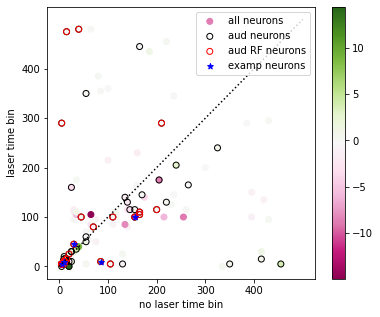

In [161]:
audids = np.where(auditory_responive[:,0])[0]
goodneur = np.where(aic[:,0,0] > aic[:,0,1])[0]

neurons = [6,7,62]

savedir = '/media/feldheimlab/E82E-1525/240131 labmeeting/'
nois =[6, 24, 61, 100, 154, 155]
save = False

for t, tr in enumerate([500]):
#     print('Neuron {0} with 0-{1} ms timerange'.format(noi,tr))
    if n == 0:
        timeBinSz = 5
        fr = PatternToCount(pattern, timerange=tr, timeBinSz = timeBinSz, verbose=False)
        mintime = 0
        maxtime = tr
        bins = np.arange(mintime, maxtime+timeBinSz, timeBinSz)

    plt.figure(figsize=(6,5))

    nolaser_mean = np.mean(fr[:,:,:,0], axis=(1,2,3))
    nolaser_max = np.max(nolaser_mean, axis=1)
    nolaser_max_loc = np.argmax(nolaser_mean, axis=1)
    
    nolaser_std = np.std(fr[:,:,:,0], axis=(1,2,3))
    nolaser_maxstd = nolaser_std[nolaser_max_loc]
    
    laser_mean = np.mean(fr[:,:,:,1], axis=(1,2,3))
    laser_max = np.max(laser_mean, axis=1)
    laser_max_loc = np.argmax(laser_mean, axis=1)
    
    laser_std = np.std(fr[:,:,:,1], axis=(1,2,3))
    laser_maxstd = laser_std[nolaser_max_loc]

    nneuro = len(nolaser_max_loc)
    for n in nois:
        print(n, nolaser_max_loc[n]*timeBinSz, laser_max_loc[n]*timeBinSz)
    print(np.min(nolaser_max-laser_max), np.max(nolaser_max-laser_max))
    plt.scatter(nolaser_max_loc, laser_max_loc, c=(nolaser_max-laser_max)/(timeBinSz/1000), cmap='PiYG', label='all neurons')
    plt.colorbar()
    plt.scatter(nolaser_max_loc[audids], laser_max_loc[audids], edgecolors= 'k', facecolors='none', alpha=1, label='aud neurons')

    plt.scatter(nolaser_max_loc[goodneur], laser_max_loc[goodneur], edgecolors='red', facecolors='none', label='aud RF neurons')
    plt.scatter(nolaser_max_loc[nois], laser_max_loc[nois], c='blue', marker='*', label='examp neurons')
    plt.plot([0,100],[0,100], linestyle=':', color ='k')
#     plt.errorbar(bins[1:], nolaser_mean, yerr= nolaser_std/np.sqrt(5*17*30), label='no laser')
    plt.yticks(np.arange(100)[::20],np.arange(100)[::20]*timeBinSz)
    plt.xticks(np.arange(100)[::20],np.arange(100)[::20]*timeBinSz)
    plt.xlabel('no laser time bin')
    plt.ylabel('laser time bin')
    plt.legend(loc='upper right')
    if save:
        plt.savefig(savedir + 'neuron-pop_firingrate_maxdiff_class.png'.format(noi))                
    plt.show()

# Visualize the data/fits

Number of neurons with RF of auditory responsive neurons: 446/663 67.27%
Plotting neuron 9: vmin=0, vmax=0.97
Plotting neuron 9: vmin=0, vmax=0.97


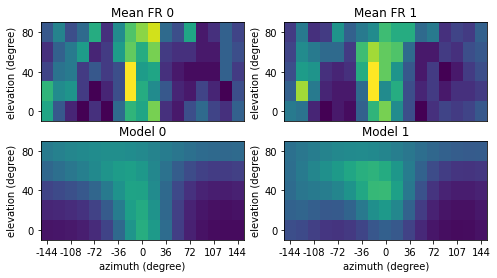

Plotting neuron 13: vmin=0, vmax=0.23
Plotting neuron 13: vmin=0, vmax=0.23


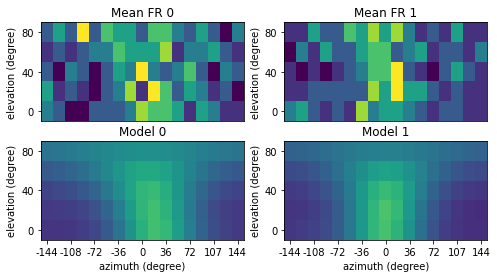

Plotting neuron 14: vmin=0, vmax=0.23
Plotting neuron 14: vmin=0, vmax=0.23


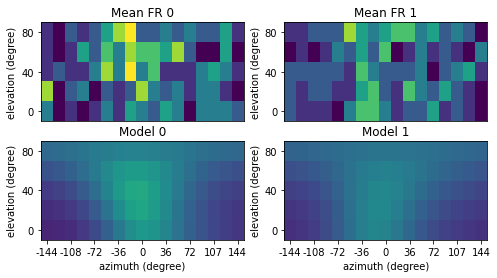

Plotting neuron 15: vmin=0, vmax=0.03
Plotting neuron 15: vmin=0, vmax=0.03


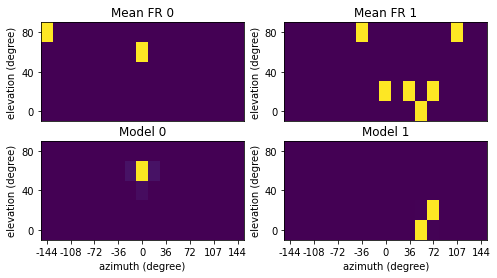

Plotting neuron 16: vmin=0, vmax=0.03
Plotting neuron 16: vmin=0, vmax=0.03


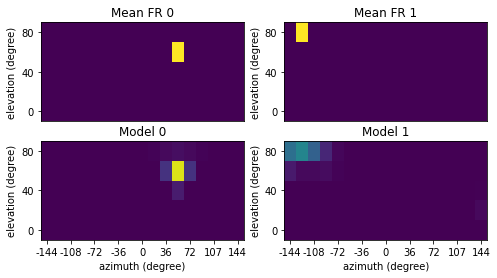

Plotting neuron 17: vmin=0, vmax=0.03
Plotting neuron 17: vmin=0, vmax=0.03


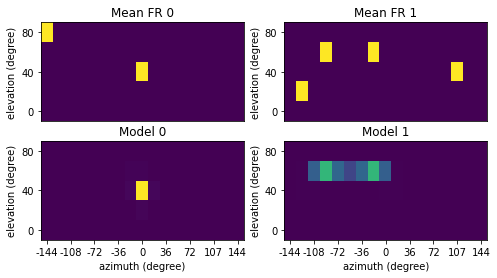

Plotting neuron 20: vmin=0, vmax=0.13
Plotting neuron 20: vmin=0, vmax=0.13


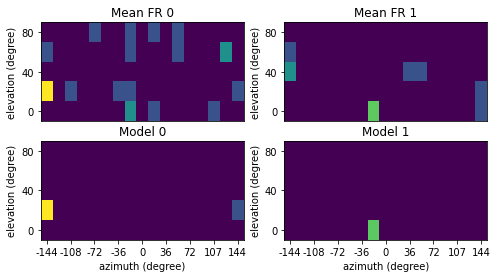

Plotting neuron 23: vmin=0, vmax=0.3
Plotting neuron 23: vmin=0, vmax=0.3


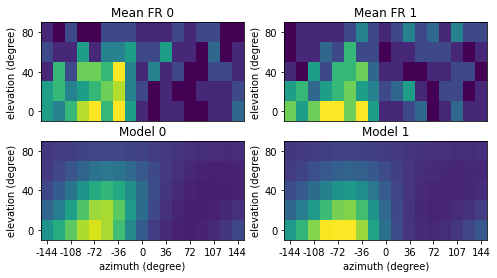

Plotting neuron 31: vmin=0, vmax=0.63
Plotting neuron 31: vmin=0, vmax=0.63


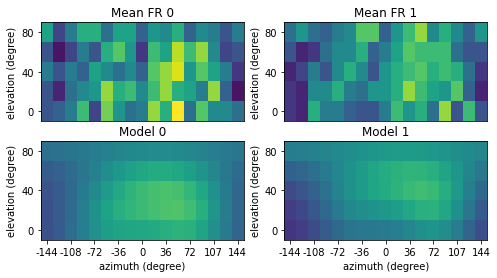

Plotting neuron 32: vmin=0, vmax=0.13
Plotting neuron 32: vmin=0, vmax=0.13


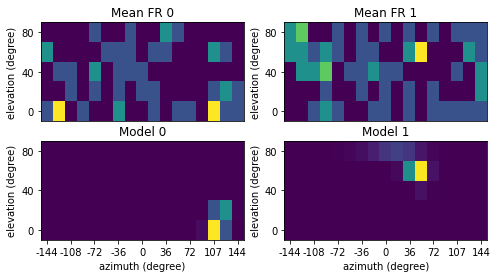

Plotting neuron 37: vmin=0, vmax=0.03
Plotting neuron 37: vmin=0, vmax=0.03


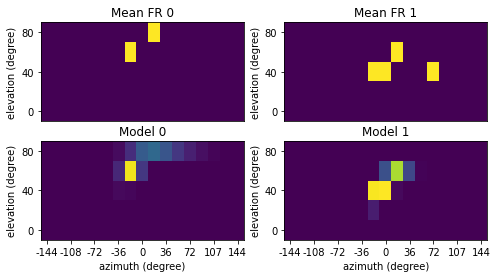

Plotting neuron 38: vmin=0, vmax=0.03
Plotting neuron 38: vmin=0, vmax=0.03


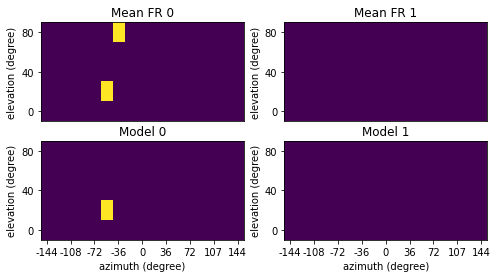

Plotting neuron 50: vmin=0, vmax=0.03
Plotting neuron 50: vmin=0, vmax=0.03


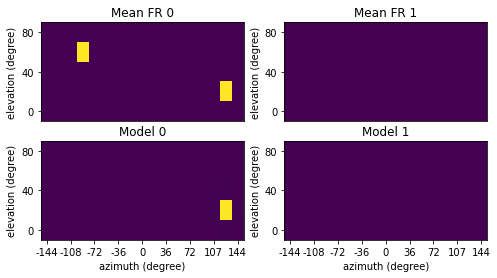

Plotting neuron 51: vmin=0, vmax=0.03
Plotting neuron 51: vmin=0, vmax=0.03


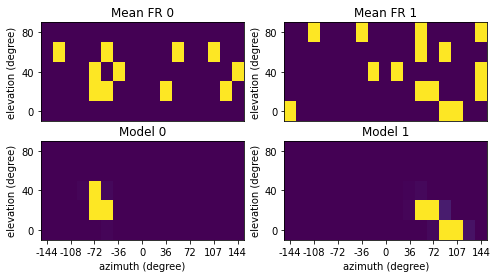

Plotting neuron 62: vmin=0, vmax=0.47
Plotting neuron 62: vmin=0, vmax=0.47


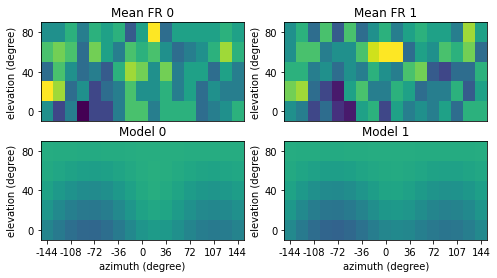

Plotting neuron 63: vmin=0, vmax=0.03
Plotting neuron 63: vmin=0, vmax=0.03


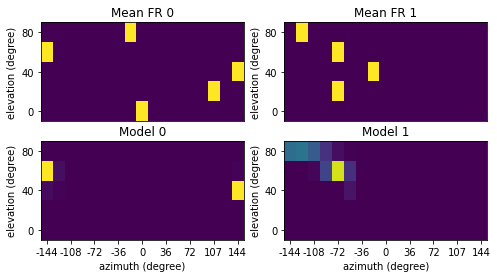

Plotting neuron 67: vmin=0, vmax=0.03
Plotting neuron 67: vmin=0, vmax=0.03


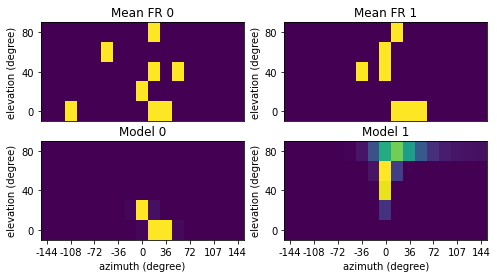

Plotting neuron 68: vmin=0, vmax=0.03
Plotting neuron 68: vmin=0, vmax=0.03


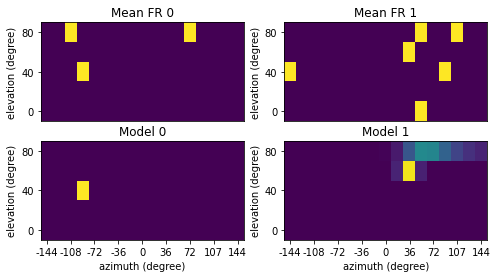

Plotting neuron 73: vmin=0, vmax=0.07
Plotting neuron 73: vmin=0, vmax=0.07


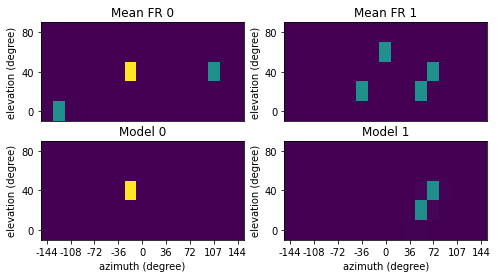

Plotting neuron 85: vmin=0, vmax=0.03
Plotting neuron 85: vmin=0, vmax=0.03


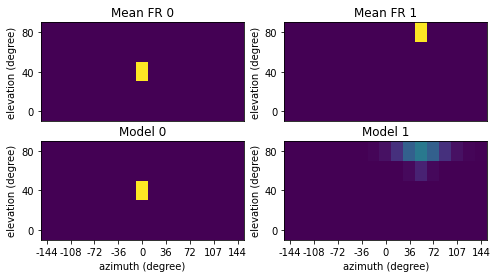

Plotting neuron 86: vmin=0, vmax=0.03
Plotting neuron 86: vmin=0, vmax=0.03


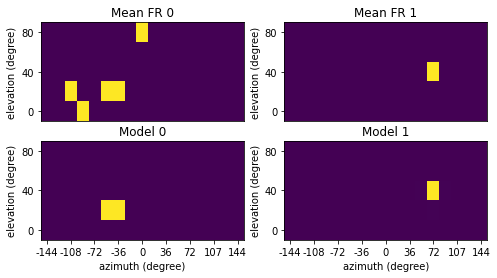

Plotting neuron 87: vmin=0, vmax=0.03
Plotting neuron 87: vmin=0, vmax=0.03


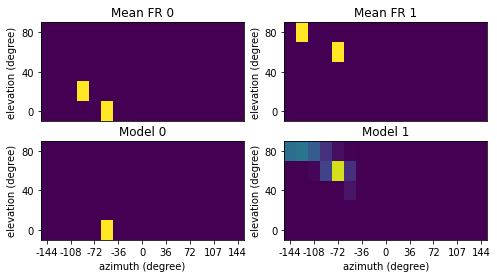

Plotting neuron 93: vmin=0, vmax=0.03
Plotting neuron 93: vmin=0, vmax=0.03


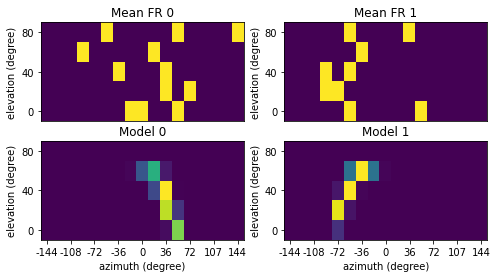

Plotting neuron 97: vmin=0, vmax=0.03
Plotting neuron 97: vmin=0, vmax=0.03


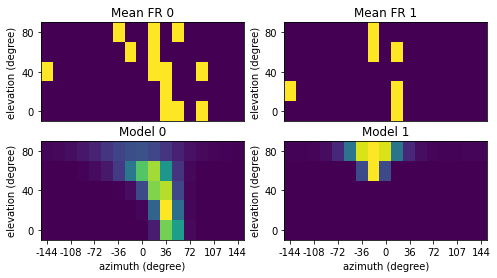

Plotting neuron 98: vmin=0, vmax=0.07
Plotting neuron 98: vmin=0, vmax=0.07


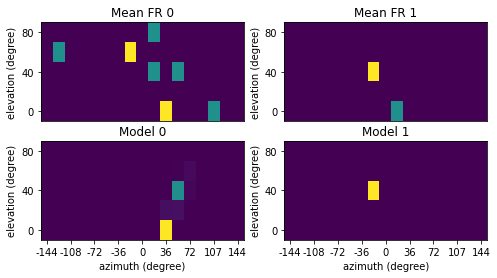

Plotting neuron 108: vmin=0, vmax=0.07
Plotting neuron 108: vmin=0, vmax=0.07


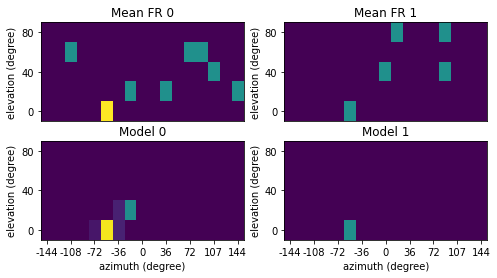

Plotting neuron 109: vmin=0, vmax=0.1
Plotting neuron 109: vmin=0, vmax=0.1


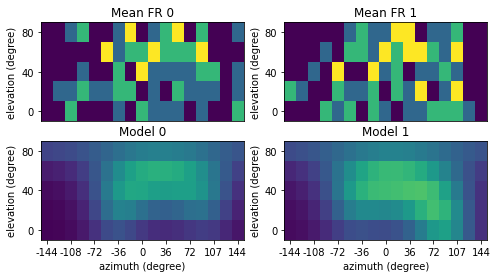

Plotting neuron 111: vmin=0, vmax=0.67
Plotting neuron 111: vmin=0, vmax=0.67


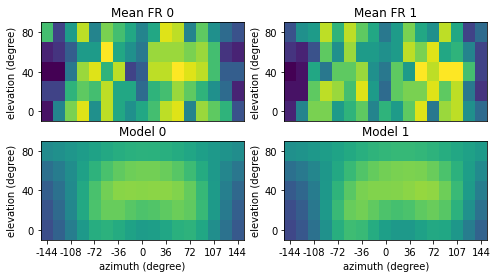

Plotting neuron 114: vmin=0, vmax=0.13
Plotting neuron 114: vmin=0, vmax=0.13


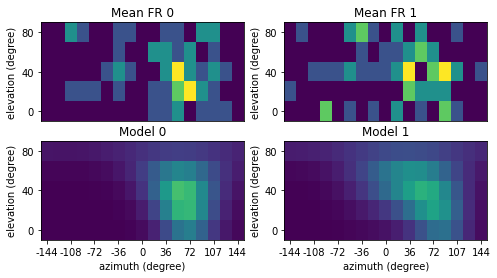

Plotting neuron 116: vmin=0, vmax=0.2
Plotting neuron 116: vmin=0, vmax=0.2


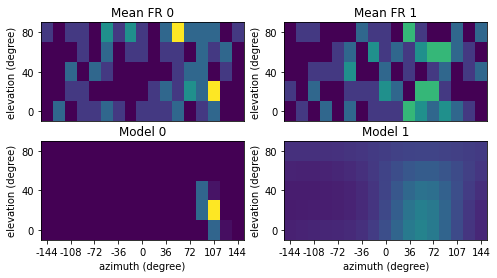

Plotting neuron 124: vmin=0, vmax=0.9
Plotting neuron 124: vmin=0, vmax=0.9


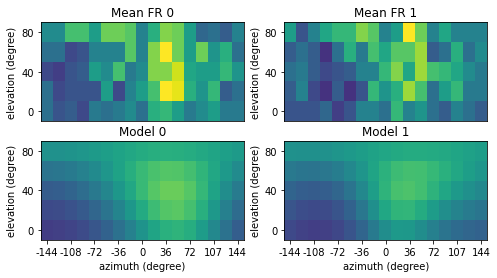

Plotting neuron 125: vmin=0, vmax=0.23
Plotting neuron 125: vmin=0, vmax=0.23


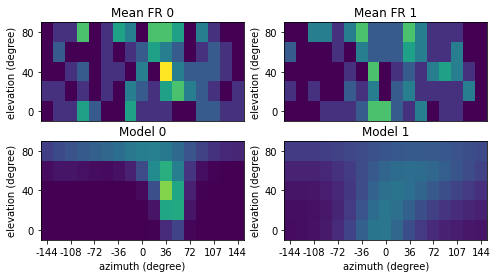

Plotting neuron 126: vmin=0, vmax=0.1
Plotting neuron 126: vmin=0, vmax=0.1


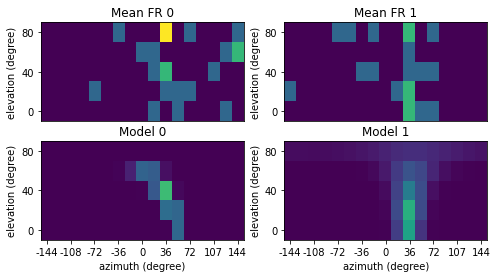

Plotting neuron 129: vmin=0, vmax=0.03
Plotting neuron 129: vmin=0, vmax=0.03


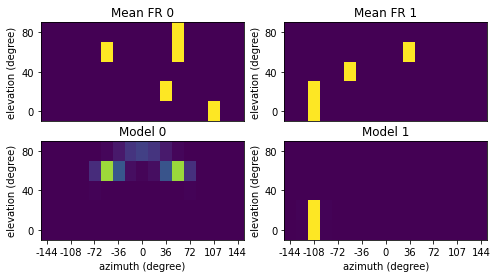

Plotting neuron 131: vmin=0, vmax=0.23
Plotting neuron 131: vmin=0, vmax=0.23


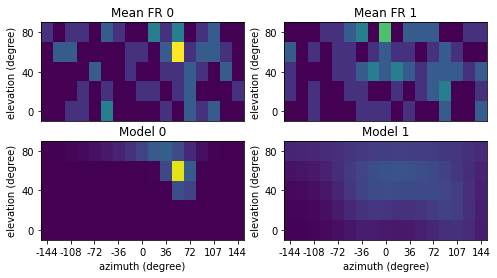

Plotting neuron 134: vmin=0, vmax=0.17
Plotting neuron 134: vmin=0, vmax=0.17


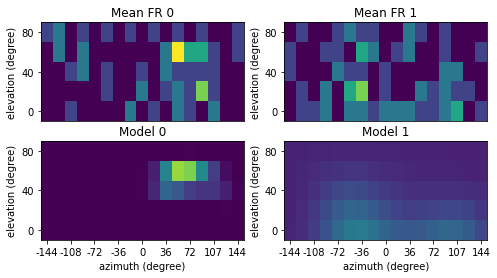

Plotting neuron 135: vmin=0, vmax=0.27
Plotting neuron 135: vmin=0, vmax=0.27


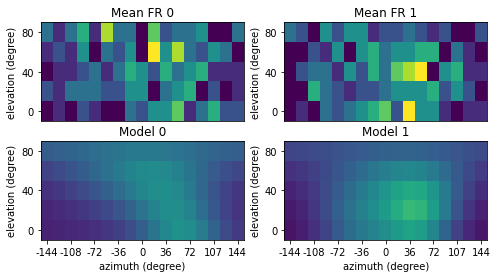

Plotting neuron 137: vmin=0, vmax=0.33
Plotting neuron 137: vmin=0, vmax=0.33


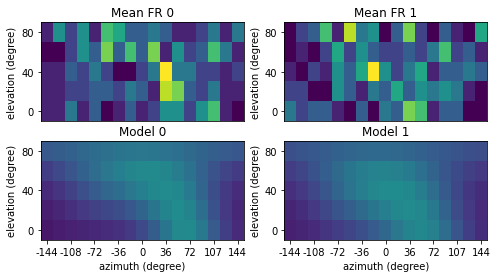

Plotting neuron 138: vmin=0, vmax=0.03
Plotting neuron 138: vmin=0, vmax=0.03


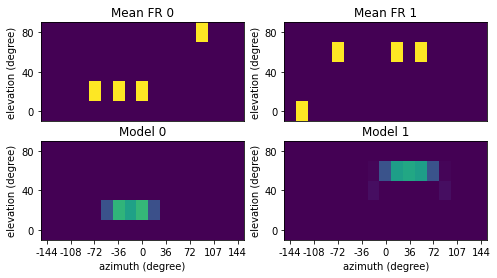

Plotting neuron 139: vmin=0, vmax=0.03
Plotting neuron 139: vmin=0, vmax=0.03


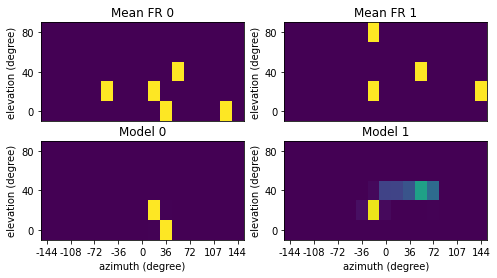

Plotting neuron 140: vmin=0, vmax=0.03
Plotting neuron 140: vmin=0, vmax=0.03


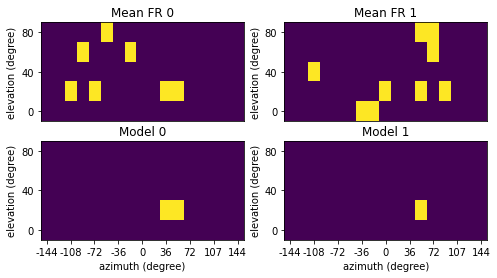

Plotting neuron 142: vmin=0, vmax=0.03
Plotting neuron 142: vmin=0, vmax=0.03


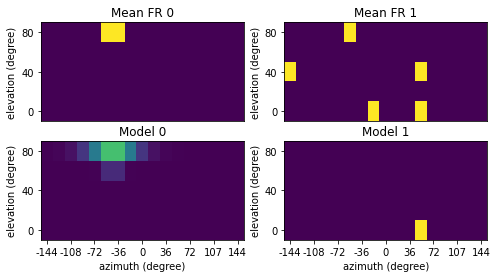

Plotting neuron 143: vmin=0, vmax=0.13
Plotting neuron 143: vmin=0, vmax=0.13


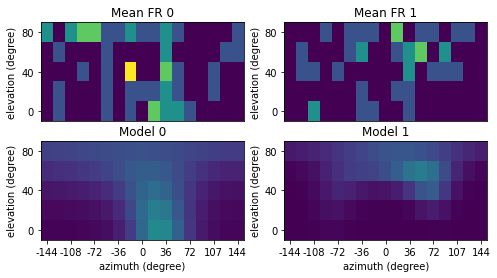

Plotting neuron 144: vmin=0, vmax=0.1
Plotting neuron 144: vmin=0, vmax=0.1


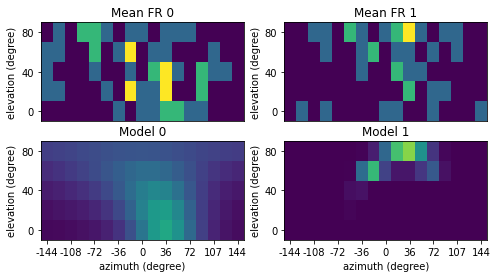

Plotting neuron 145: vmin=0, vmax=0.1
Plotting neuron 145: vmin=0, vmax=0.1


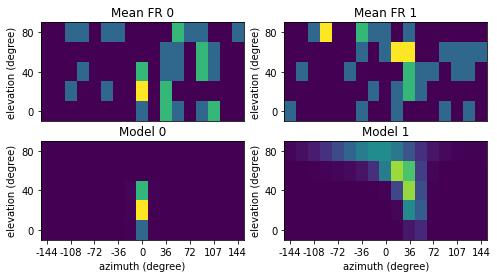

Plotting neuron 147: vmin=0, vmax=0.13
Plotting neuron 147: vmin=0, vmax=0.13


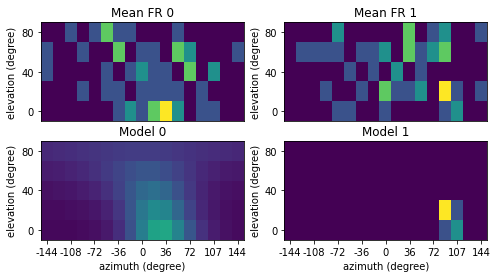

Plotting neuron 148: vmin=0, vmax=0.07
Plotting neuron 148: vmin=0, vmax=0.07


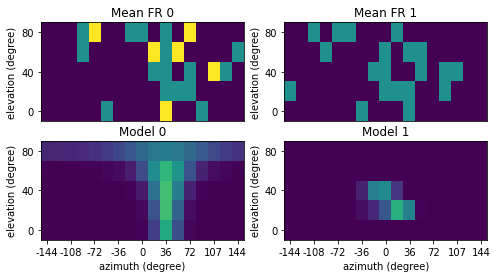

Plotting neuron 149: vmin=0, vmax=0.23
Plotting neuron 149: vmin=0, vmax=0.23


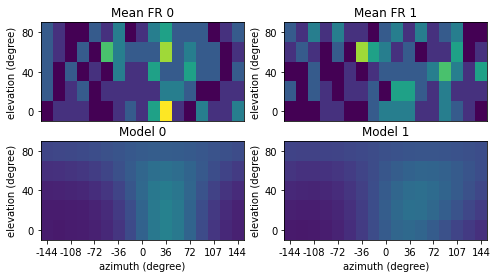

Plotting neuron 153: vmin=0, vmax=0.27
Plotting neuron 153: vmin=0, vmax=0.27


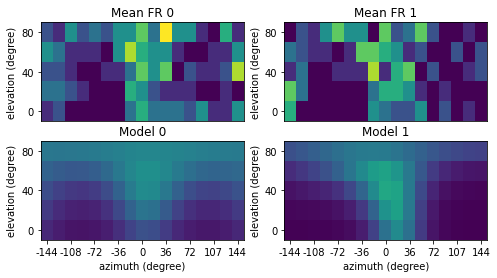

Plotting neuron 154: vmin=0, vmax=0.13
Plotting neuron 154: vmin=0, vmax=0.13


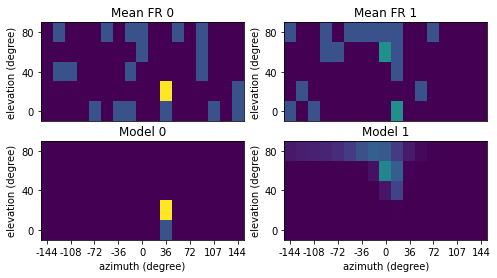

Plotting neuron 155: vmin=0, vmax=0.03
Plotting neuron 155: vmin=0, vmax=0.03


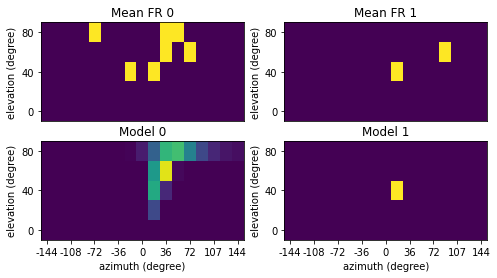

Plotting neuron 157: vmin=0, vmax=0.07
Plotting neuron 157: vmin=0, vmax=0.07


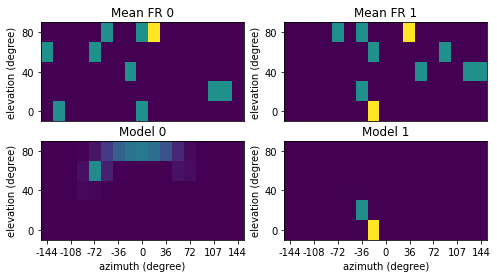

Plotting neuron 158: vmin=0, vmax=0.17
Plotting neuron 158: vmin=0, vmax=0.17


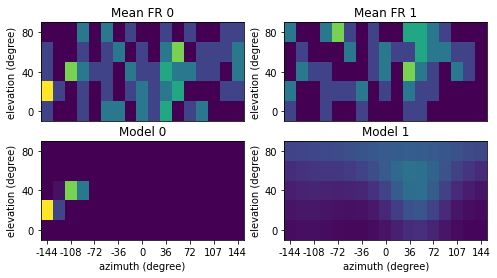

Plotting neuron 161: vmin=0, vmax=0.23
Plotting neuron 161: vmin=0, vmax=0.23


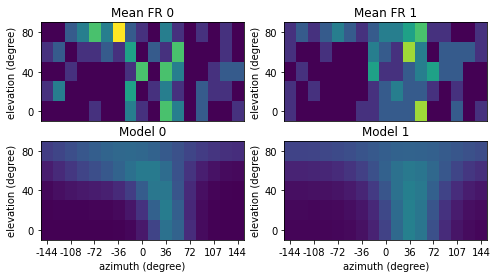

Plotting neuron 162: vmin=0, vmax=0.67
Plotting neuron 162: vmin=0, vmax=0.67


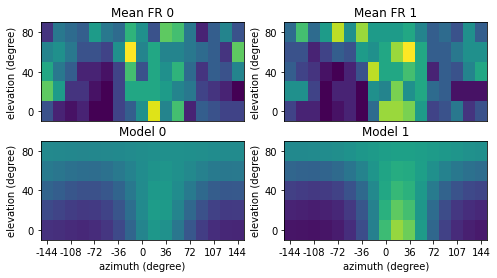

Plotting neuron 174: vmin=0, vmax=0.67
Plotting neuron 174: vmin=0, vmax=0.67


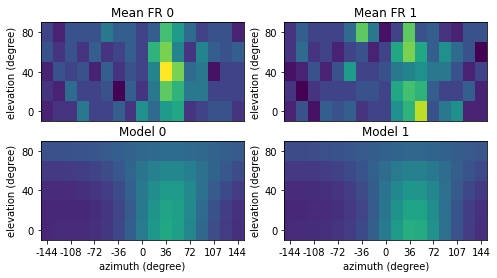

Plotting neuron 179: vmin=0, vmax=0.03
Plotting neuron 179: vmin=0, vmax=0.03


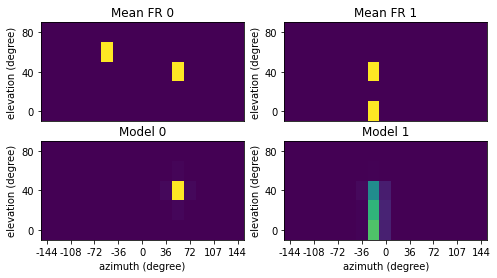

Plotting neuron 180: vmin=0, vmax=0.03
Plotting neuron 180: vmin=0, vmax=0.03


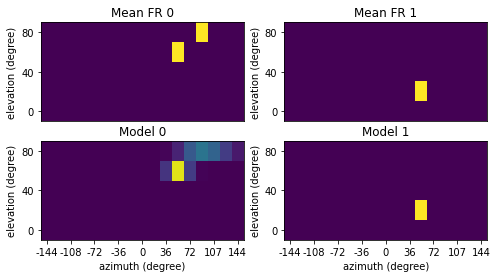

Plotting neuron 182: vmin=0, vmax=0.03
Plotting neuron 182: vmin=0, vmax=0.03


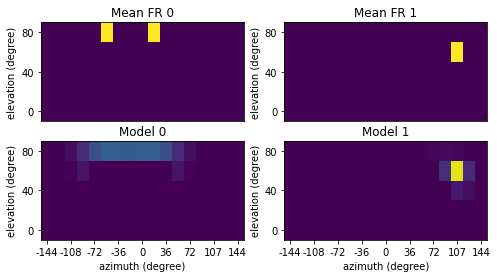

Plotting neuron 183: vmin=0, vmax=0.03
Plotting neuron 183: vmin=0, vmax=0.03


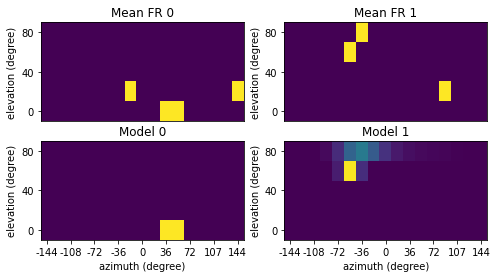

Plotting neuron 195: vmin=0, vmax=0.1
Plotting neuron 195: vmin=0, vmax=0.1


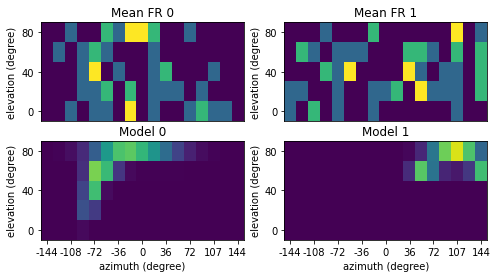

Plotting neuron 196: vmin=0, vmax=0.07
Plotting neuron 196: vmin=0, vmax=0.07


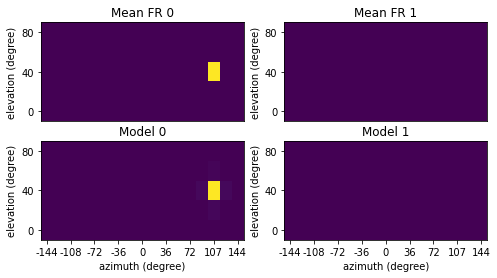

Plotting neuron 200: vmin=0, vmax=0.23
Plotting neuron 200: vmin=0, vmax=0.23


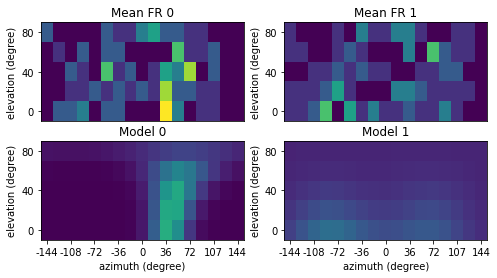

Plotting neuron 202: vmin=0, vmax=0.03
Plotting neuron 202: vmin=0, vmax=0.03


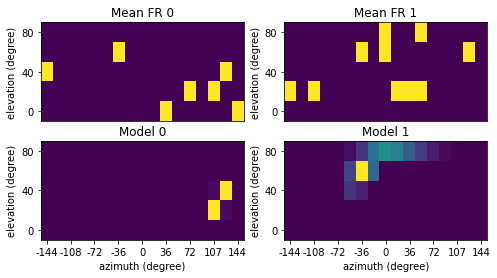

Plotting neuron 203: vmin=0, vmax=0.1
Plotting neuron 203: vmin=0, vmax=0.1


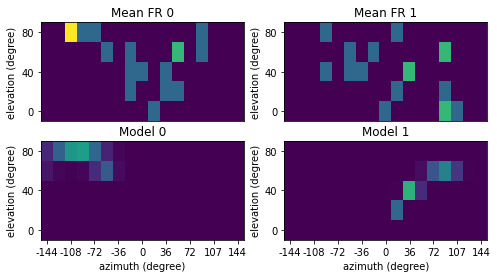

Plotting neuron 206: vmin=0, vmax=0.07
Plotting neuron 206: vmin=0, vmax=0.07


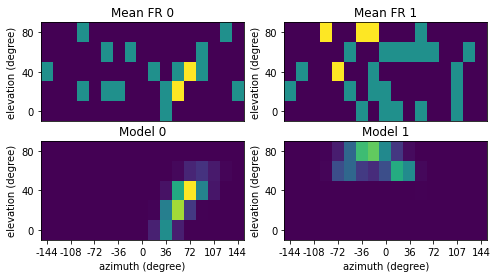

Plotting neuron 208: vmin=0, vmax=0.57
Plotting neuron 208: vmin=0, vmax=0.57


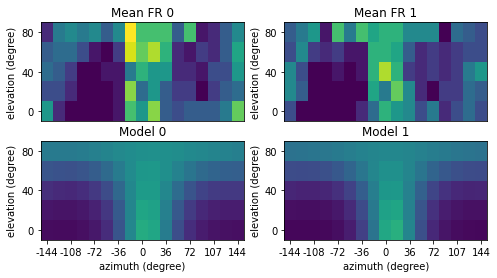

Plotting neuron 210: vmin=0, vmax=0.2
Plotting neuron 210: vmin=0, vmax=0.2


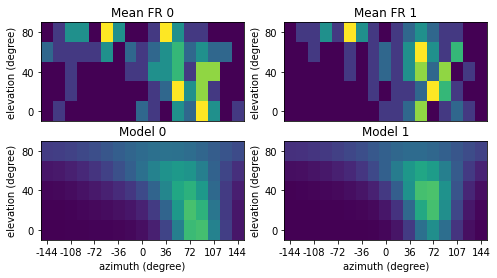

Plotting neuron 211: vmin=0, vmax=0.27
Plotting neuron 211: vmin=0, vmax=0.27


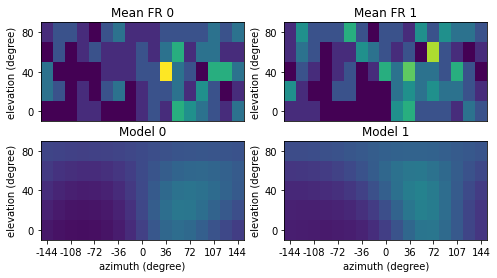

Plotting neuron 212: vmin=0, vmax=0.03
Plotting neuron 212: vmin=0, vmax=0.03


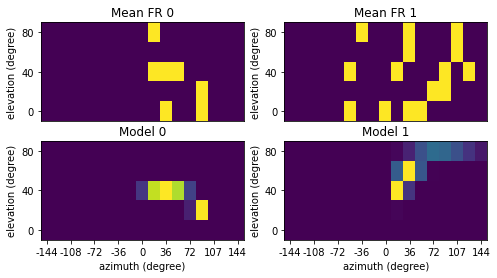

Plotting neuron 213: vmin=0, vmax=0.17
Plotting neuron 213: vmin=0, vmax=0.17


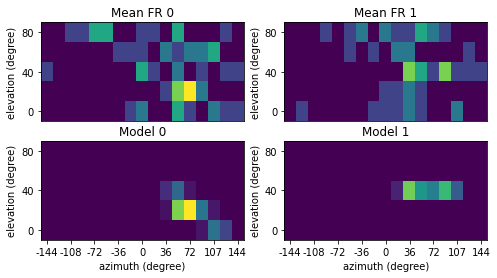

Plotting neuron 214: vmin=0, vmax=0.2
Plotting neuron 214: vmin=0, vmax=0.2


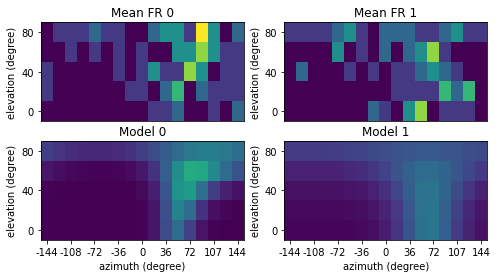

Plotting neuron 215: vmin=0, vmax=0.23
Plotting neuron 215: vmin=0, vmax=0.23


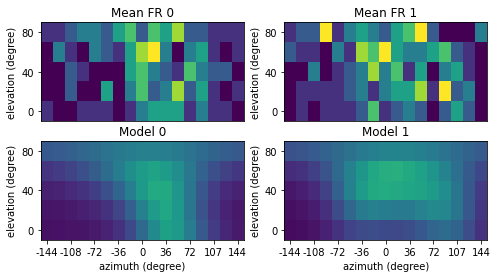

Plotting neuron 216: vmin=0, vmax=0.53
Plotting neuron 216: vmin=0, vmax=0.53


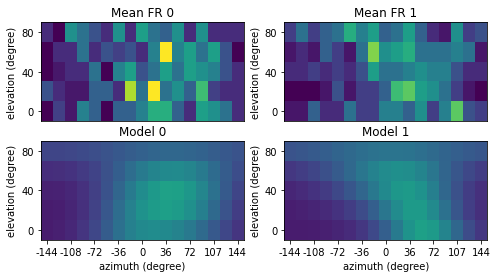

Plotting neuron 217: vmin=0, vmax=0.13
Plotting neuron 217: vmin=0, vmax=0.13


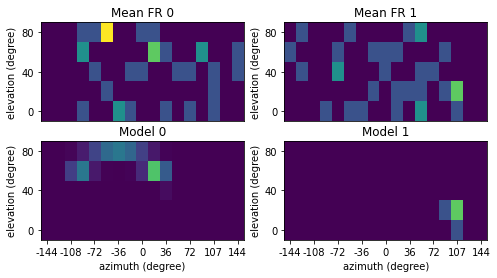

Plotting neuron 220: vmin=0, vmax=0.2
Plotting neuron 220: vmin=0, vmax=0.2


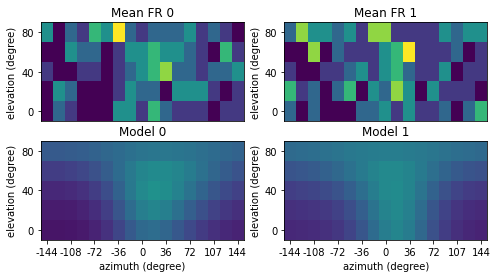

Plotting neuron 222: vmin=0, vmax=0.17
Plotting neuron 222: vmin=0, vmax=0.17


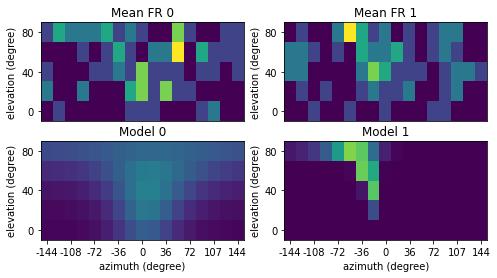

Plotting neuron 224: vmin=0, vmax=0.07
Plotting neuron 224: vmin=0, vmax=0.07


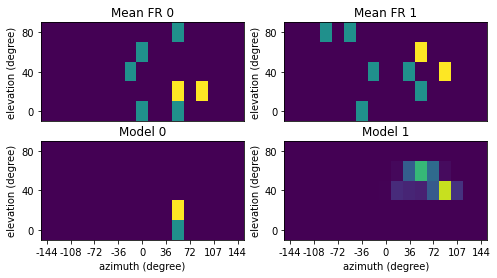

Plotting neuron 225: vmin=0, vmax=0.37
Plotting neuron 225: vmin=0, vmax=0.37


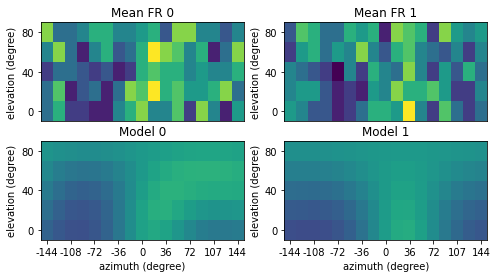

Plotting neuron 226: vmin=0, vmax=0.4
Plotting neuron 226: vmin=0, vmax=0.4


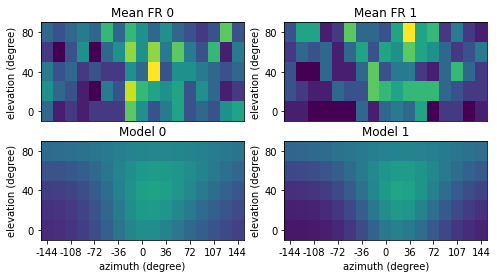

Plotting neuron 227: vmin=0, vmax=0.43
Plotting neuron 227: vmin=0, vmax=0.43


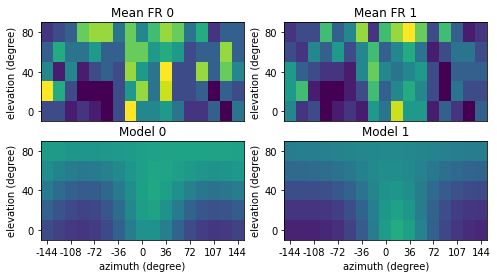

Plotting neuron 228: vmin=0, vmax=0.07
Plotting neuron 228: vmin=0, vmax=0.07


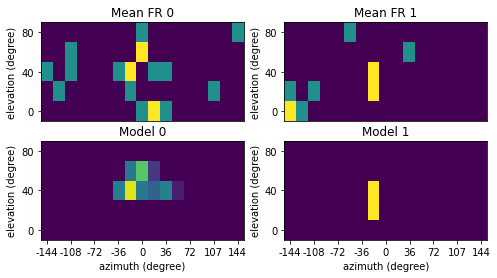

Plotting neuron 229: vmin=0, vmax=0.53
Plotting neuron 229: vmin=0, vmax=0.53


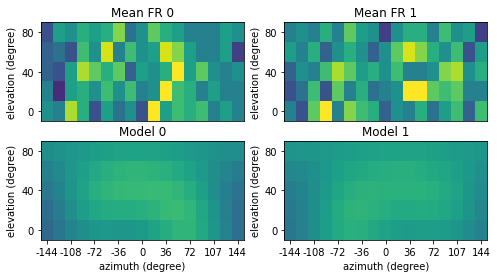

Plotting neuron 231: vmin=0, vmax=0.2
Plotting neuron 231: vmin=0, vmax=0.2


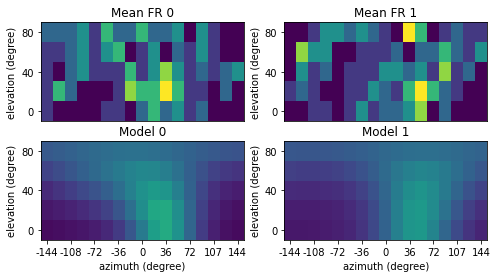

Plotting neuron 232: vmin=0, vmax=1.17
Plotting neuron 232: vmin=0, vmax=1.17


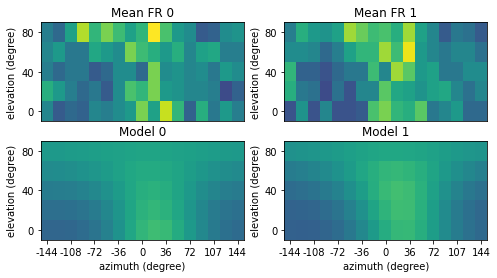

Plotting neuron 233: vmin=0, vmax=0.4
Plotting neuron 233: vmin=0, vmax=0.4


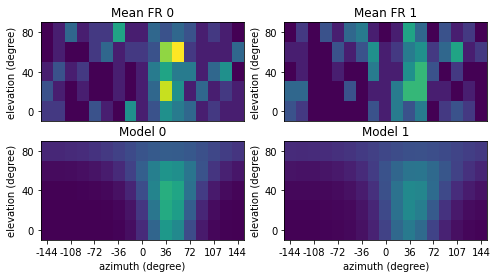

Plotting neuron 244: vmin=0, vmax=0.03
Plotting neuron 244: vmin=0, vmax=0.03


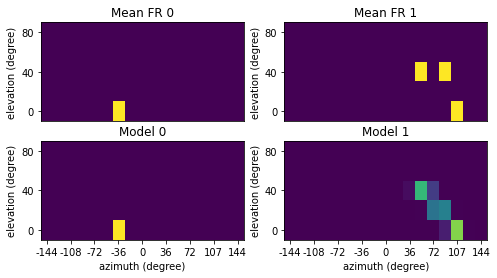

Plotting neuron 245: vmin=0, vmax=0.07
Plotting neuron 245: vmin=0, vmax=0.07


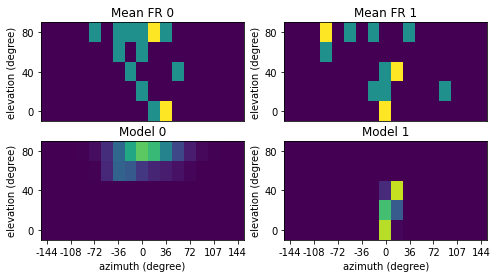

Plotting neuron 246: vmin=0, vmax=0.07
Plotting neuron 246: vmin=0, vmax=0.07


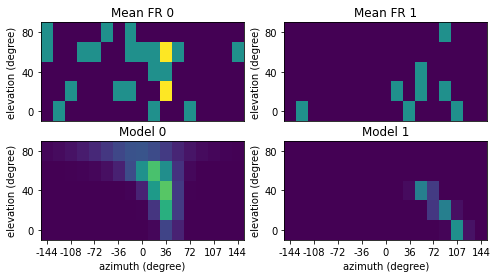

Plotting neuron 247: vmin=0, vmax=0.1
Plotting neuron 247: vmin=0, vmax=0.1


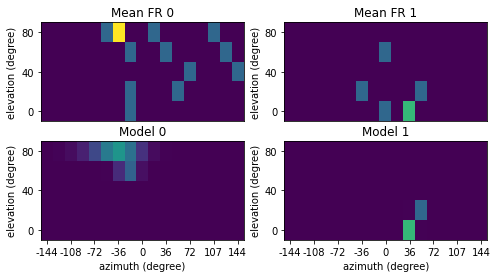

Plotting neuron 249: vmin=0, vmax=0.1
Plotting neuron 249: vmin=0, vmax=0.1


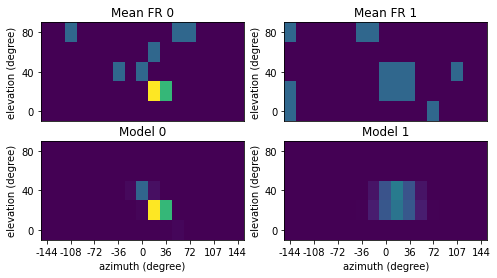

Plotting neuron 250: vmin=0, vmax=0.1
Plotting neuron 250: vmin=0, vmax=0.1


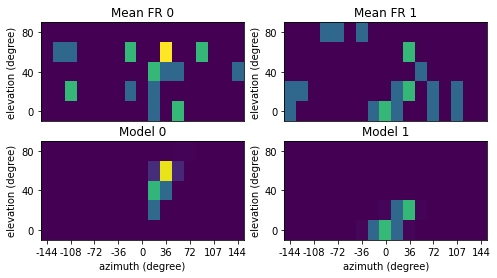

Plotting neuron 253: vmin=0, vmax=0.3
Plotting neuron 253: vmin=0, vmax=0.3


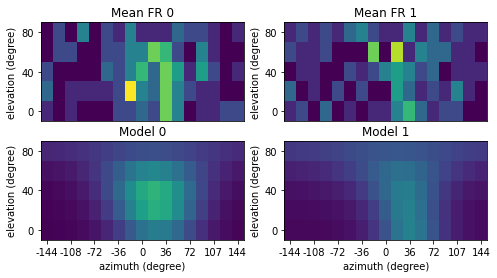

Plotting neuron 262: vmin=0, vmax=0.03
Plotting neuron 262: vmin=0, vmax=0.03


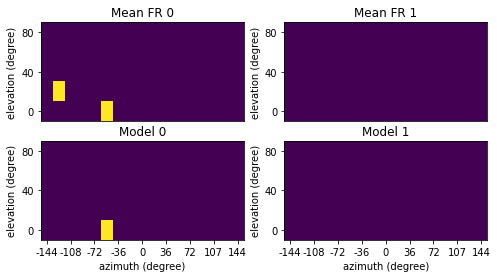

Plotting neuron 263: vmin=0, vmax=0.07
Plotting neuron 263: vmin=0, vmax=0.07


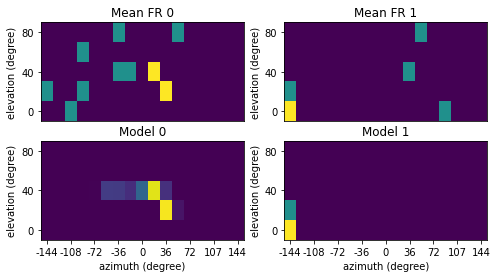

Plotting neuron 264: vmin=0, vmax=0.03
Plotting neuron 264: vmin=0, vmax=0.03


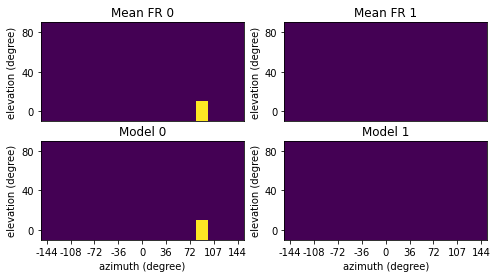

Plotting neuron 266: vmin=0, vmax=0.03
Plotting neuron 266: vmin=0, vmax=0.03


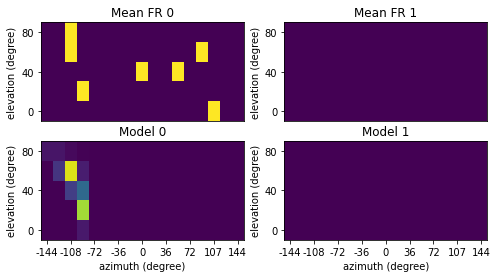

Plotting neuron 267: vmin=0, vmax=0.17
Plotting neuron 267: vmin=0, vmax=0.17


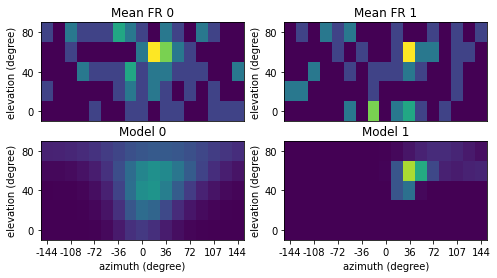

Plotting neuron 270: vmin=0, vmax=0.03
Plotting neuron 270: vmin=0, vmax=0.03


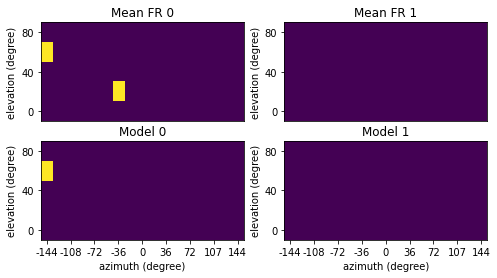

Plotting neuron 272: vmin=0, vmax=0.03
Plotting neuron 272: vmin=0, vmax=0.03


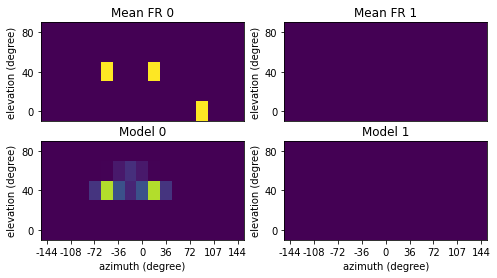

Plotting neuron 273: vmin=0, vmax=0.07
Plotting neuron 273: vmin=0, vmax=0.07


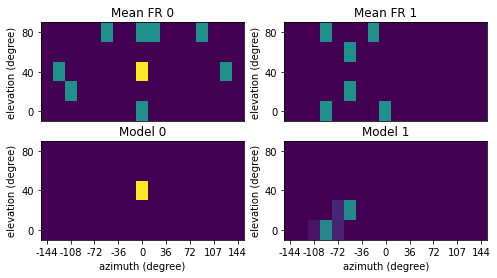

Plotting neuron 280: vmin=0, vmax=0.13
Plotting neuron 280: vmin=0, vmax=0.13


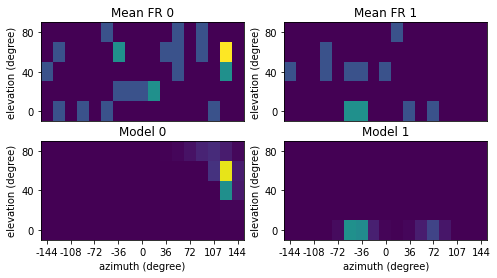

Plotting neuron 282: vmin=0, vmax=0.07
Plotting neuron 282: vmin=0, vmax=0.07


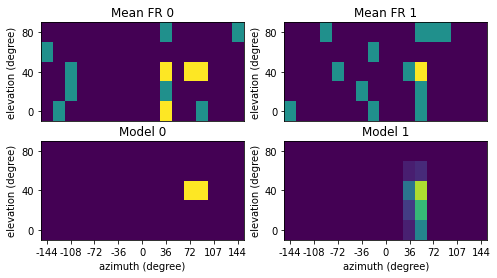

Plotting neuron 285: vmin=0, vmax=0.07
Plotting neuron 285: vmin=0, vmax=0.07


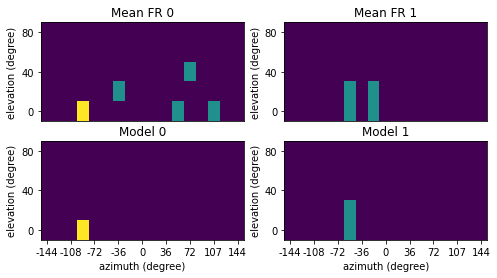

Plotting neuron 286: vmin=0, vmax=0.1
Plotting neuron 286: vmin=0, vmax=0.1


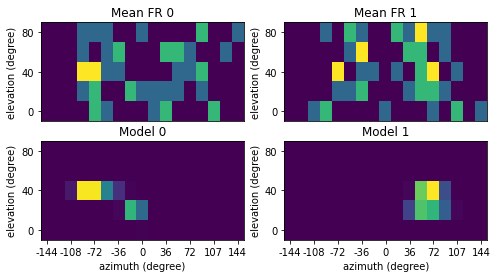

Plotting neuron 287: vmin=0, vmax=0.17
Plotting neuron 287: vmin=0, vmax=0.17


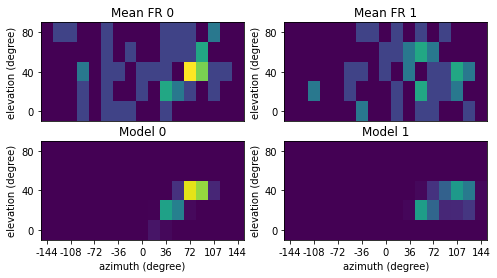

Plotting neuron 288: vmin=0, vmax=0.07
Plotting neuron 288: vmin=0, vmax=0.07


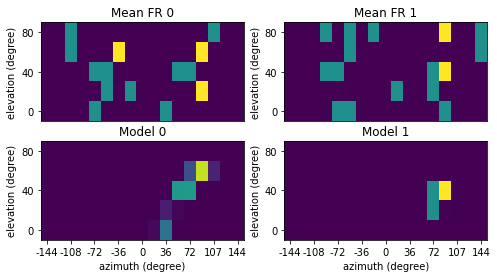

Plotting neuron 290: vmin=0, vmax=0.1
Plotting neuron 290: vmin=0, vmax=0.1


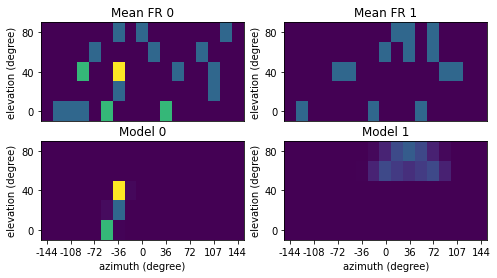

Plotting neuron 291: vmin=0, vmax=0.07
Plotting neuron 291: vmin=0, vmax=0.07


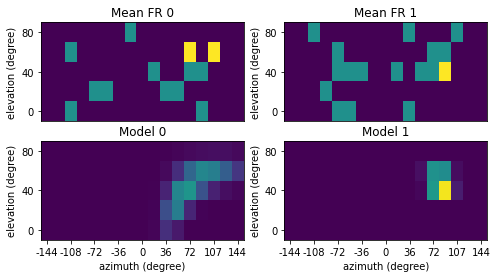

Plotting neuron 293: vmin=0, vmax=0.07
Plotting neuron 293: vmin=0, vmax=0.07


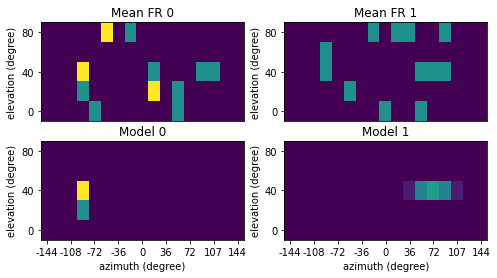

Plotting neuron 294: vmin=0, vmax=0.1
Plotting neuron 294: vmin=0, vmax=0.1


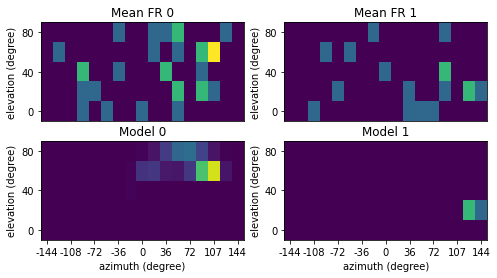

Plotting neuron 297: vmin=0, vmax=0.03
Plotting neuron 297: vmin=0, vmax=0.03


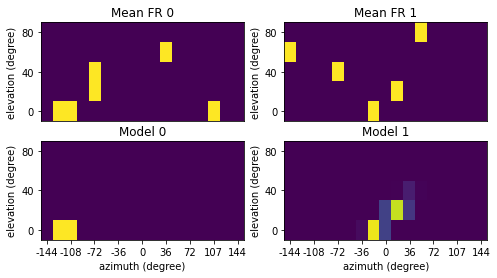

Plotting neuron 298: vmin=0, vmax=0.03
Plotting neuron 298: vmin=0, vmax=0.03


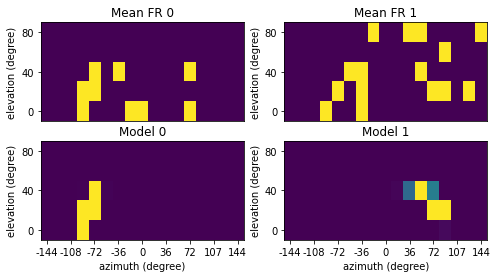

Plotting neuron 300: vmin=0, vmax=0.1
Plotting neuron 300: vmin=0, vmax=0.1


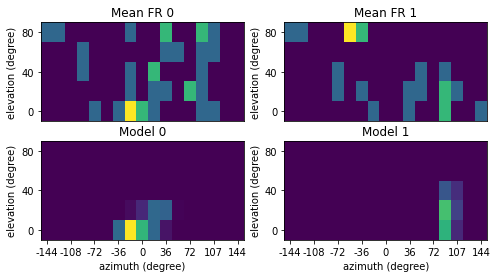

Plotting neuron 301: vmin=0, vmax=0.03
Plotting neuron 301: vmin=0, vmax=0.03


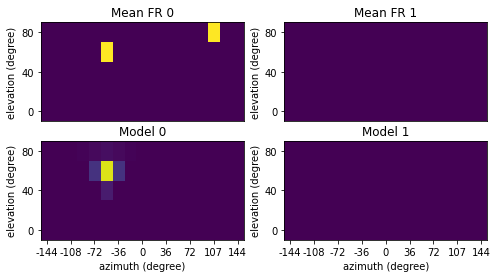

Plotting neuron 302: vmin=0, vmax=0.23
Plotting neuron 302: vmin=0, vmax=0.23


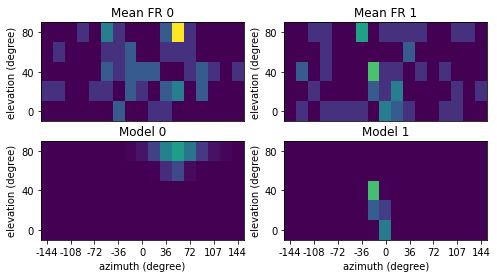

Plotting neuron 303: vmin=0, vmax=0.23
Plotting neuron 303: vmin=0, vmax=0.23


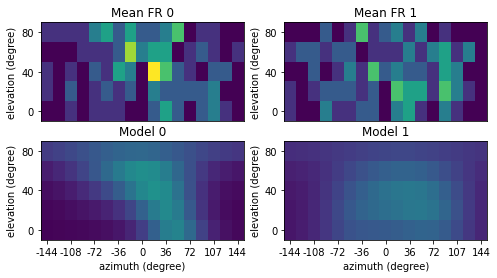

Plotting neuron 304: vmin=0, vmax=0.5
Plotting neuron 304: vmin=0, vmax=0.5


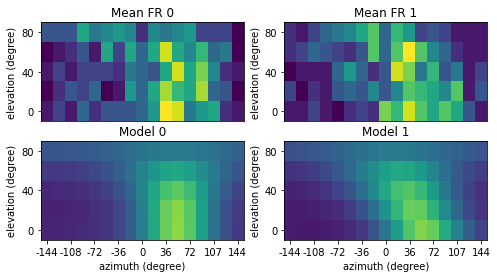

Plotting neuron 312: vmin=0, vmax=0.17
Plotting neuron 312: vmin=0, vmax=0.17


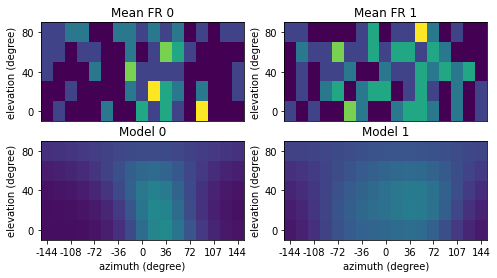

Plotting neuron 322: vmin=0, vmax=0.07
Plotting neuron 322: vmin=0, vmax=0.07


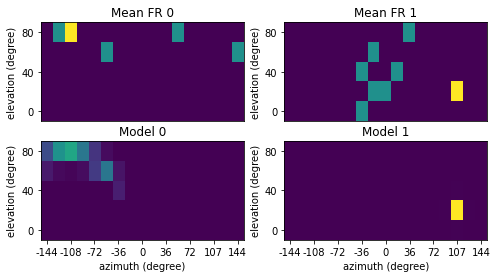

Plotting neuron 324: vmin=0, vmax=0.03
Plotting neuron 324: vmin=0, vmax=0.03


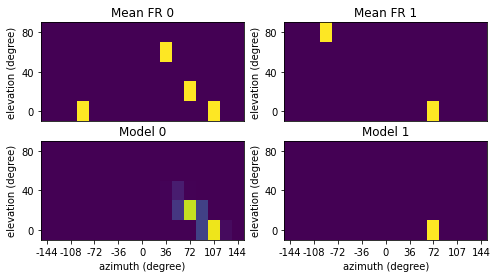

Plotting neuron 325: vmin=0, vmax=0.4
Plotting neuron 325: vmin=0, vmax=0.4


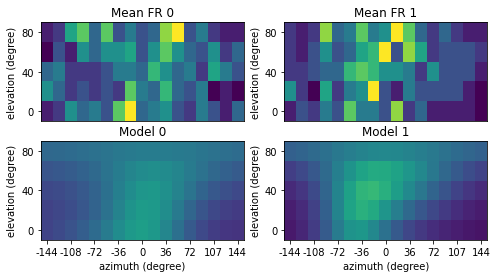

Plotting neuron 336: vmin=0, vmax=0.33
Plotting neuron 336: vmin=0, vmax=0.33


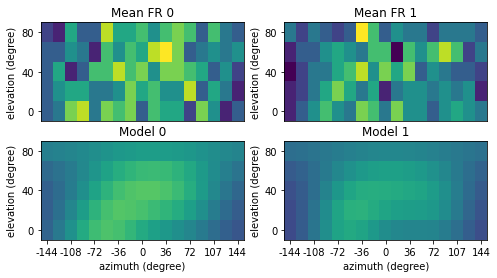

Plotting neuron 338: vmin=0, vmax=0.03
Plotting neuron 338: vmin=0, vmax=0.03


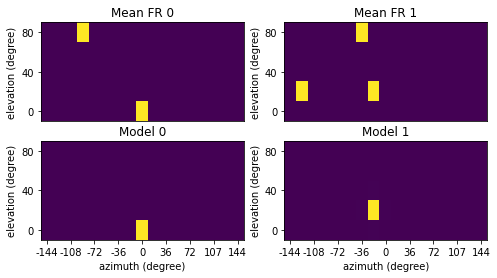

Plotting neuron 339: vmin=0, vmax=0.03
Plotting neuron 339: vmin=0, vmax=0.03


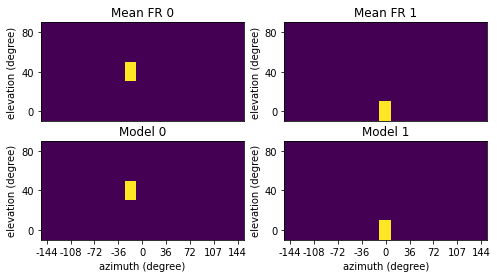

Plotting neuron 340: vmin=0, vmax=0.07
Plotting neuron 340: vmin=0, vmax=0.07


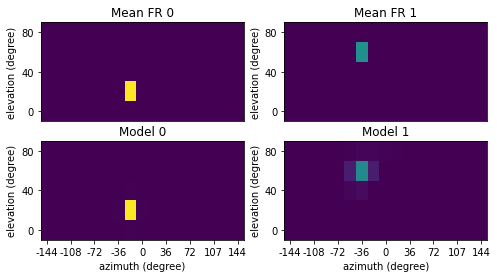

Plotting neuron 341: vmin=0, vmax=0.03
Plotting neuron 341: vmin=0, vmax=0.03


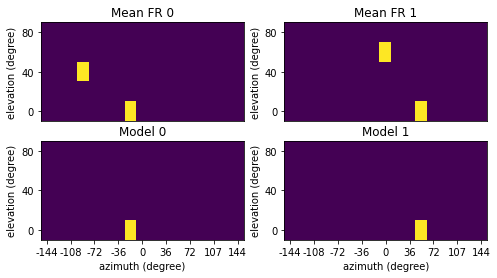

Plotting neuron 342: vmin=0, vmax=0.07
Plotting neuron 342: vmin=0, vmax=0.07


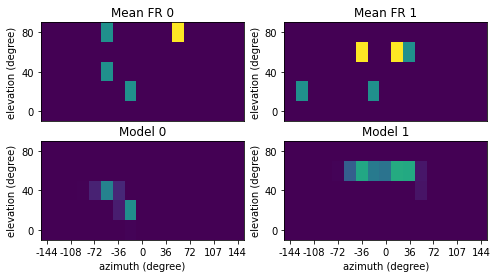

Plotting neuron 343: vmin=0, vmax=0.5
Plotting neuron 343: vmin=0, vmax=0.5


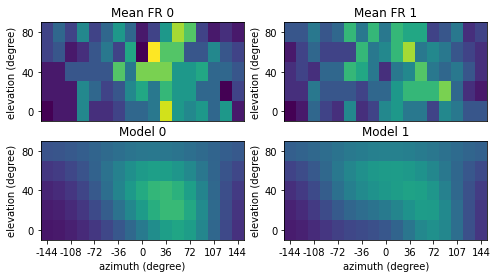

Plotting neuron 345: vmin=0, vmax=1.33
Plotting neuron 345: vmin=0, vmax=1.33


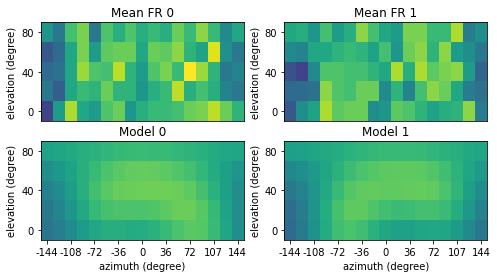

Plotting neuron 347: vmin=0, vmax=0.03
Plotting neuron 347: vmin=0, vmax=0.03


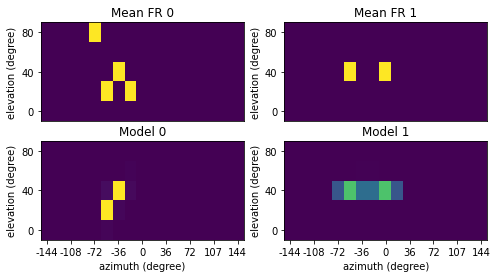

Plotting neuron 348: vmin=0, vmax=0.03
Plotting neuron 348: vmin=0, vmax=0.03


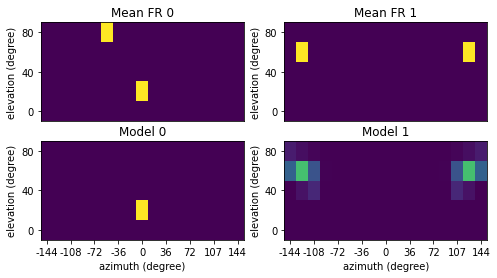

Plotting neuron 350: vmin=0, vmax=0.07
Plotting neuron 350: vmin=0, vmax=0.07


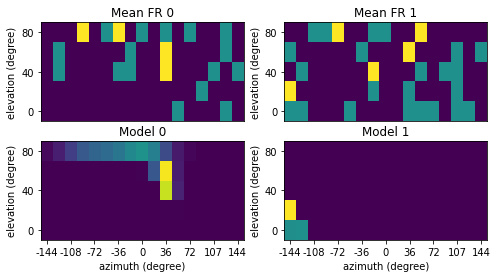

Plotting neuron 351: vmin=0, vmax=0.17
Plotting neuron 351: vmin=0, vmax=0.17


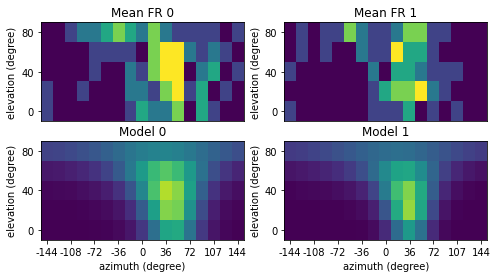

Plotting neuron 352: vmin=0, vmax=0.47
Plotting neuron 352: vmin=0, vmax=0.47


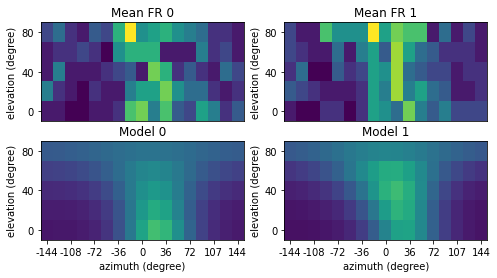

Plotting neuron 354: vmin=0, vmax=0.13
Plotting neuron 354: vmin=0, vmax=0.13


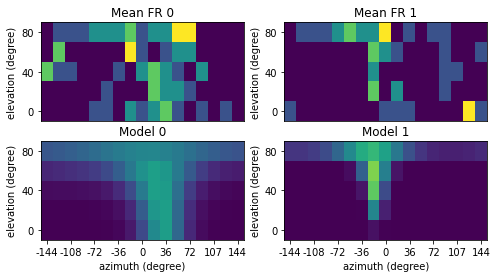

Plotting neuron 356: vmin=0, vmax=0.4
Plotting neuron 356: vmin=0, vmax=0.4


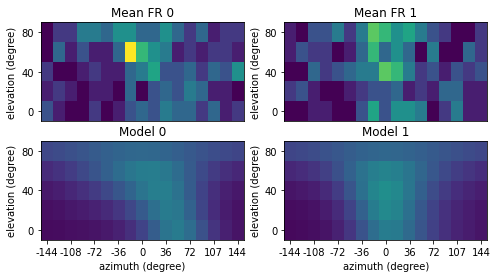

Plotting neuron 359: vmin=0, vmax=0.03
Plotting neuron 359: vmin=0, vmax=0.03


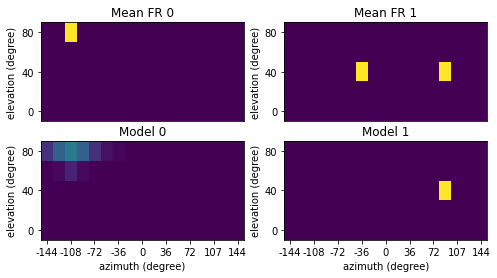

Plotting neuron 360: vmin=0, vmax=0.3
Plotting neuron 360: vmin=0, vmax=0.3


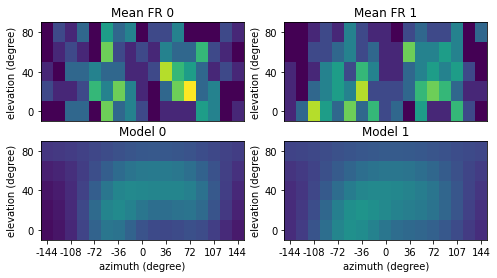

Plotting neuron 366: vmin=0, vmax=0.07
Plotting neuron 366: vmin=0, vmax=0.07


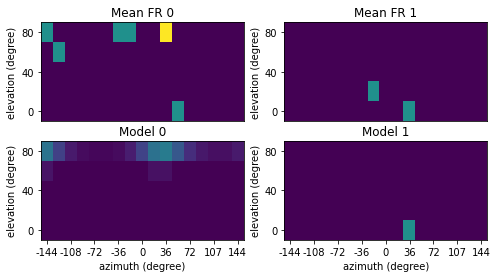

Plotting neuron 367: vmin=0, vmax=0.07
Plotting neuron 367: vmin=0, vmax=0.07


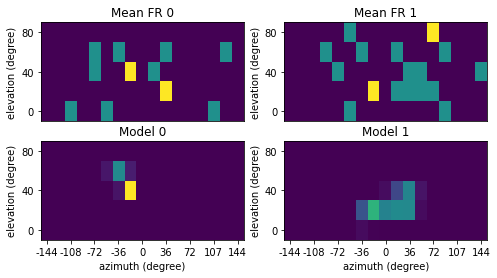

Plotting neuron 379: vmin=0, vmax=0.1
Plotting neuron 379: vmin=0, vmax=0.1


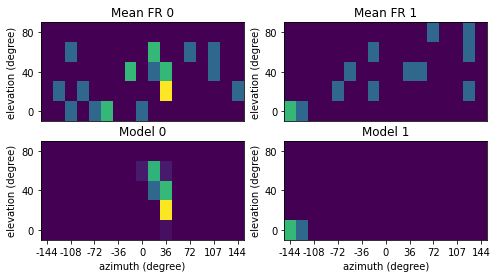

Plotting neuron 392: vmin=0, vmax=0.07
Plotting neuron 392: vmin=0, vmax=0.07


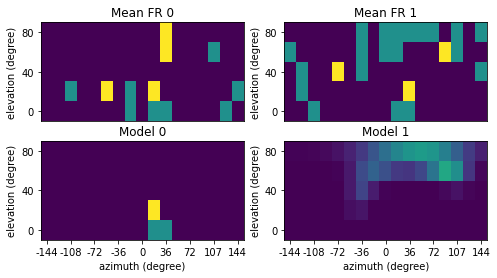

Plotting neuron 396: vmin=0, vmax=0.03
Plotting neuron 396: vmin=0, vmax=0.03


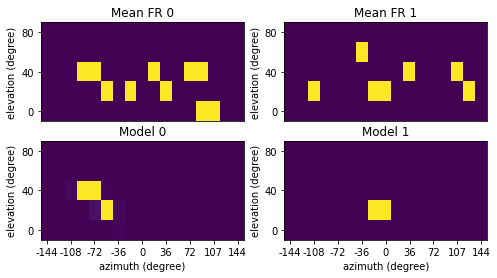

Plotting neuron 397: vmin=0, vmax=0.1
Plotting neuron 397: vmin=0, vmax=0.1


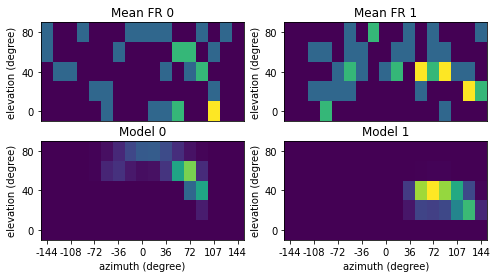

Plotting neuron 399: vmin=0, vmax=0.3
Plotting neuron 399: vmin=0, vmax=0.3


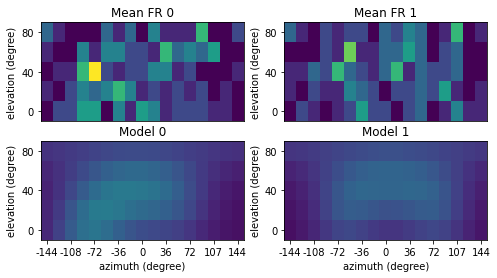

Plotting neuron 402: vmin=0, vmax=0.1
Plotting neuron 402: vmin=0, vmax=0.1


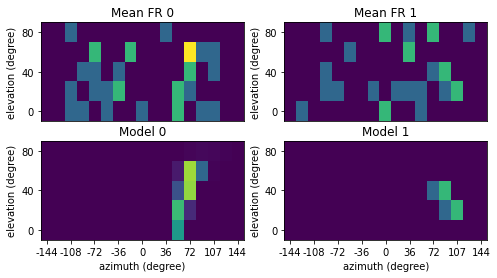

Plotting neuron 403: vmin=0, vmax=0.07
Plotting neuron 403: vmin=0, vmax=0.07


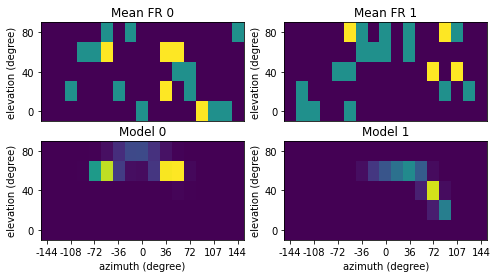

Plotting neuron 407: vmin=0, vmax=0.1
Plotting neuron 407: vmin=0, vmax=0.1


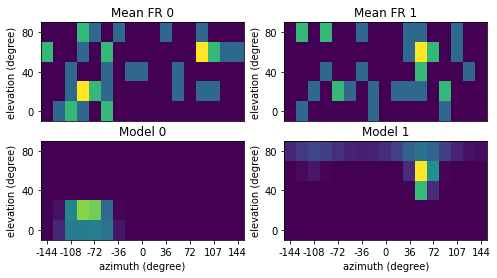

Plotting neuron 413: vmin=0, vmax=0.03
Plotting neuron 413: vmin=0, vmax=0.03


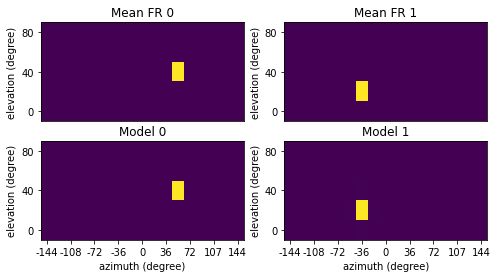

Plotting neuron 418: vmin=0, vmax=0.1
Plotting neuron 418: vmin=0, vmax=0.1


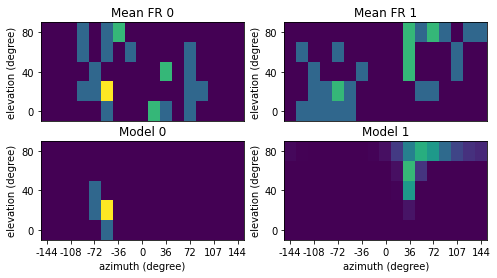

Plotting neuron 419: vmin=0, vmax=0.1
Plotting neuron 419: vmin=0, vmax=0.1


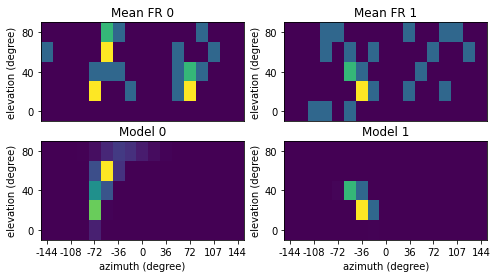

Plotting neuron 420: vmin=0, vmax=0.07
Plotting neuron 420: vmin=0, vmax=0.07


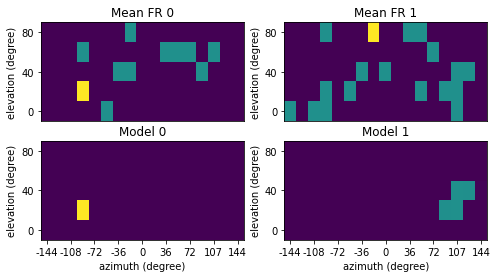

Plotting neuron 422: vmin=0, vmax=0.07
Plotting neuron 422: vmin=0, vmax=0.07


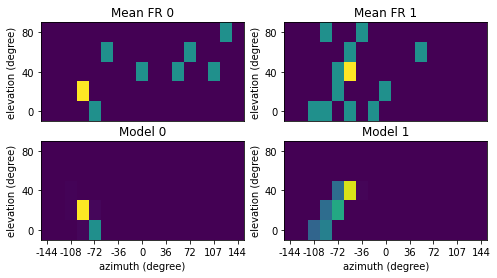

Plotting neuron 423: vmin=0, vmax=0.1
Plotting neuron 423: vmin=0, vmax=0.1


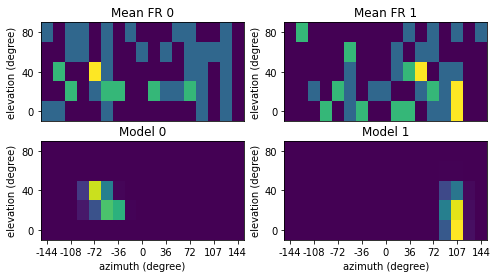

Plotting neuron 424: vmin=0, vmax=1.3
Plotting neuron 424: vmin=0, vmax=1.3


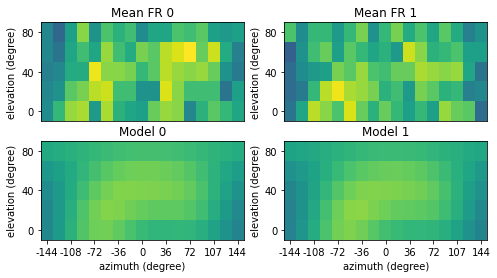

Plotting neuron 426: vmin=0, vmax=0.1
Plotting neuron 426: vmin=0, vmax=0.1


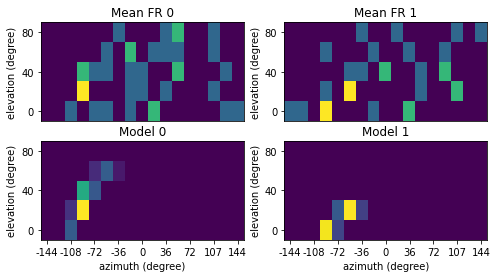

Plotting neuron 435: vmin=0, vmax=0.03
Plotting neuron 435: vmin=0, vmax=0.03


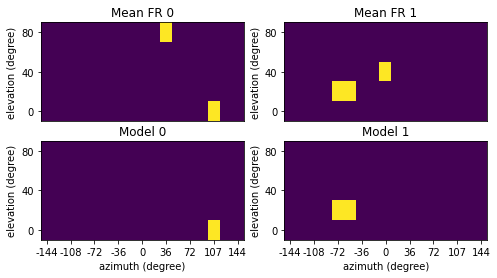

Plotting neuron 436: vmin=0, vmax=0.03
Plotting neuron 436: vmin=0, vmax=0.03


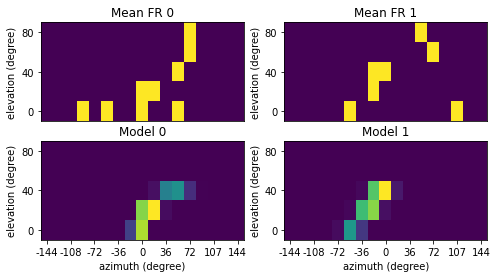

Plotting neuron 440: vmin=0, vmax=0.1
Plotting neuron 440: vmin=0, vmax=0.1


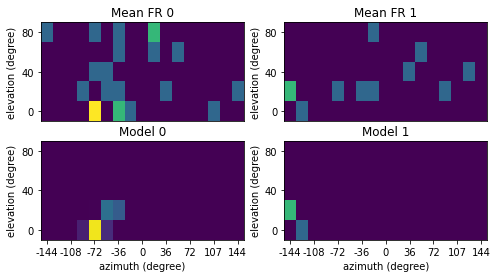

Plotting neuron 444: vmin=0, vmax=0.97
Plotting neuron 444: vmin=0, vmax=0.97


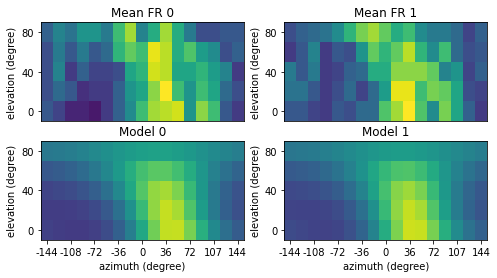

Plotting neuron 445: vmin=0, vmax=0.33
Plotting neuron 445: vmin=0, vmax=0.33


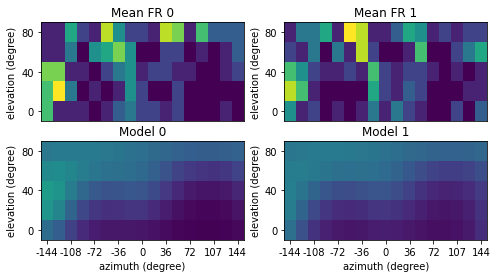

Plotting neuron 447: vmin=0, vmax=0.03
Plotting neuron 447: vmin=0, vmax=0.03


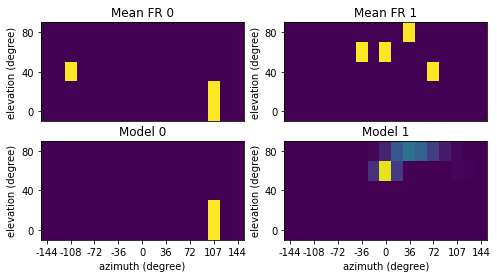

Plotting neuron 450: vmin=0, vmax=0.07
Plotting neuron 450: vmin=0, vmax=0.07


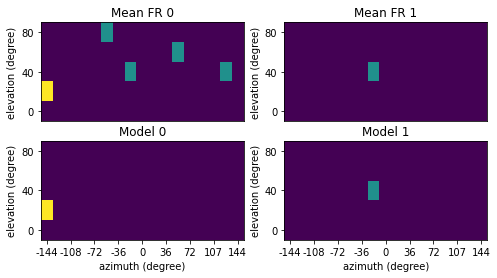

Plotting neuron 451: vmin=0, vmax=0.03
Plotting neuron 451: vmin=0, vmax=0.03


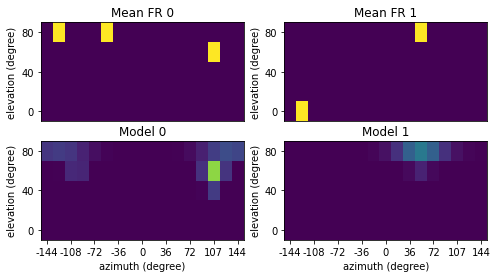

Plotting neuron 465: vmin=0, vmax=0.07
Plotting neuron 465: vmin=0, vmax=0.07


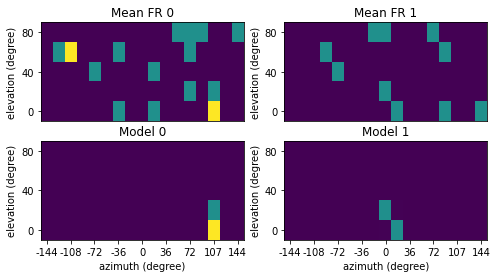

Plotting neuron 474: vmin=0, vmax=0.03
Plotting neuron 474: vmin=0, vmax=0.03


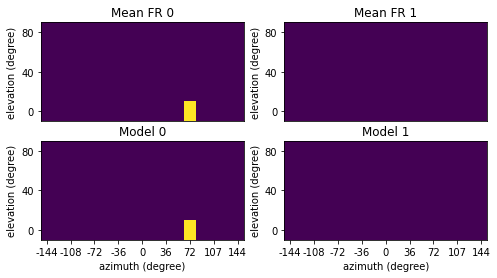

Plotting neuron 479: vmin=0, vmax=0.03
Plotting neuron 479: vmin=0, vmax=0.03


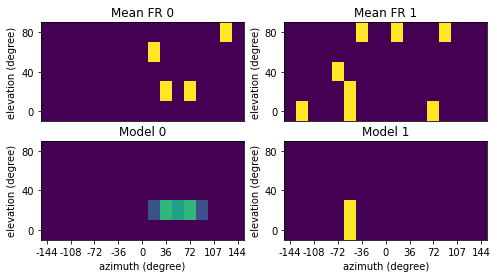

Plotting neuron 480: vmin=0, vmax=0.07
Plotting neuron 480: vmin=0, vmax=0.07


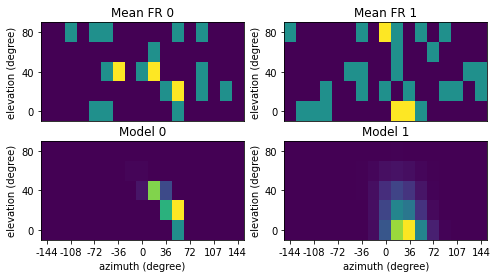

Plotting neuron 482: vmin=0, vmax=0.03
Plotting neuron 482: vmin=0, vmax=0.03


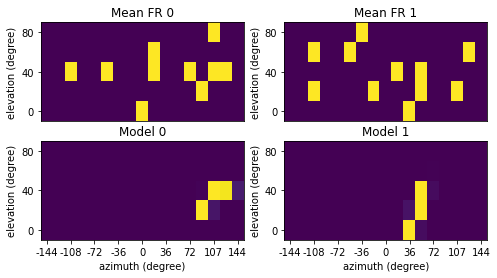

Plotting neuron 483: vmin=0, vmax=0.03
Plotting neuron 483: vmin=0, vmax=0.03


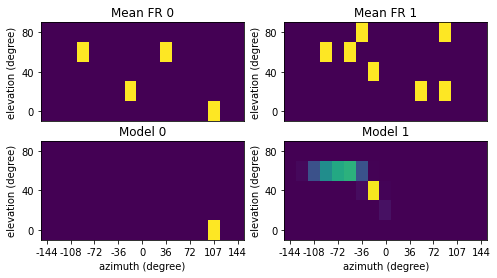

Plotting neuron 487: vmin=0, vmax=0.13
Plotting neuron 487: vmin=0, vmax=0.13


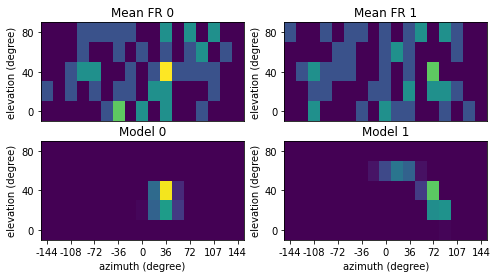

Plotting neuron 488: vmin=0, vmax=0.1
Plotting neuron 488: vmin=0, vmax=0.1


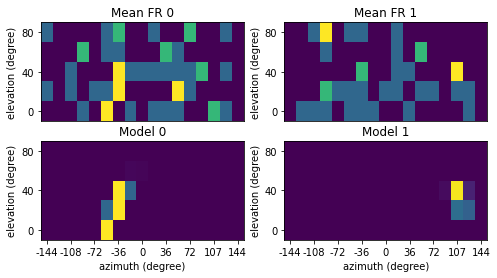

Plotting neuron 491: vmin=0, vmax=0.07
Plotting neuron 491: vmin=0, vmax=0.07


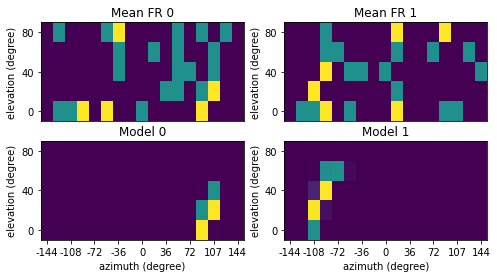

Plotting neuron 492: vmin=0, vmax=0.1
Plotting neuron 492: vmin=0, vmax=0.1


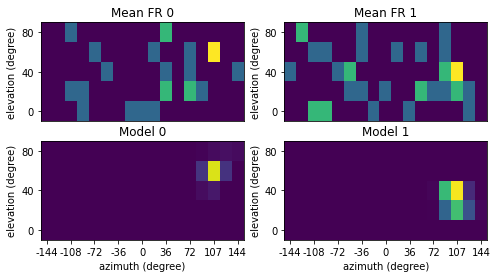

Plotting neuron 493: vmin=0, vmax=0.1
Plotting neuron 493: vmin=0, vmax=0.1


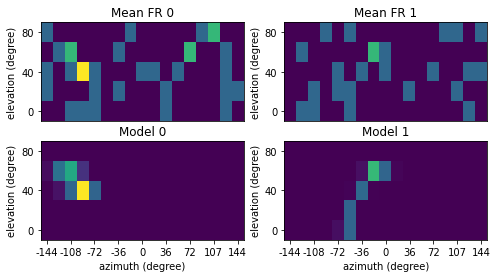

Plotting neuron 495: vmin=0, vmax=0.33
Plotting neuron 495: vmin=0, vmax=0.33


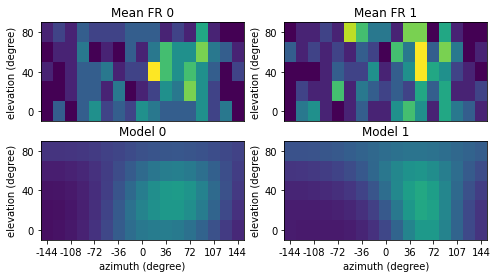

Plotting neuron 498: vmin=0, vmax=0.13
Plotting neuron 498: vmin=0, vmax=0.13


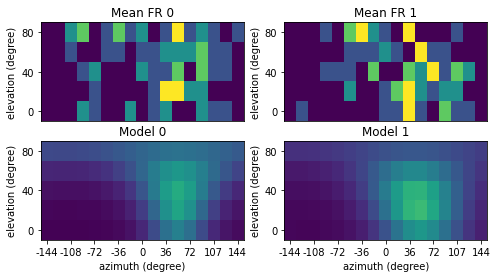

Plotting neuron 500: vmin=0, vmax=0.17
Plotting neuron 500: vmin=0, vmax=0.17


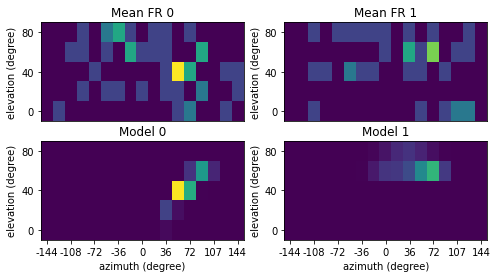

Plotting neuron 501: vmin=0, vmax=0.03
Plotting neuron 501: vmin=0, vmax=0.03


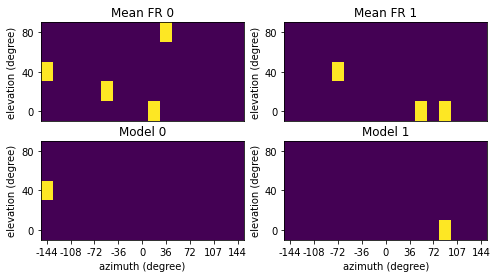

Plotting neuron 502: vmin=0, vmax=0.03
Plotting neuron 502: vmin=0, vmax=0.03


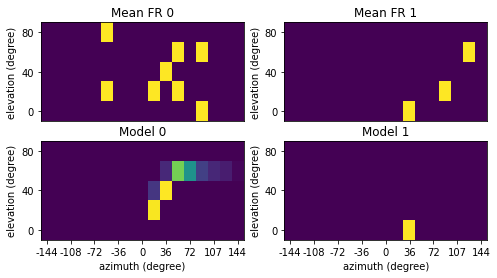

Plotting neuron 506: vmin=0, vmax=0.07
Plotting neuron 506: vmin=0, vmax=0.07


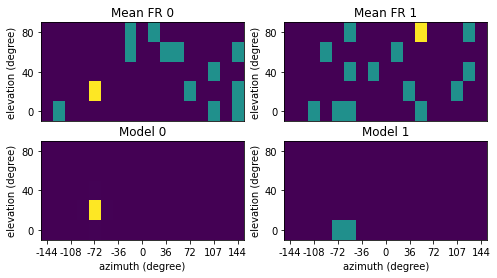

Plotting neuron 509: vmin=0, vmax=0.1
Plotting neuron 509: vmin=0, vmax=0.1


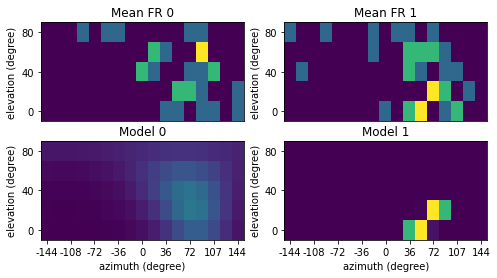

Plotting neuron 510: vmin=0, vmax=0.87
Plotting neuron 510: vmin=0, vmax=0.87


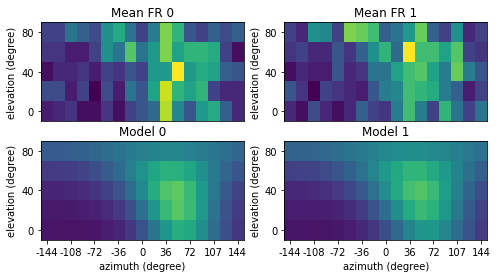

Plotting neuron 511: vmin=0, vmax=0.53
Plotting neuron 511: vmin=0, vmax=0.53


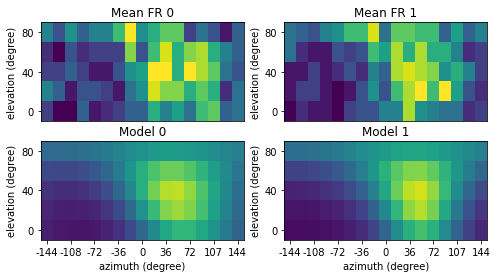

Plotting neuron 512: vmin=0, vmax=0.23
Plotting neuron 512: vmin=0, vmax=0.23


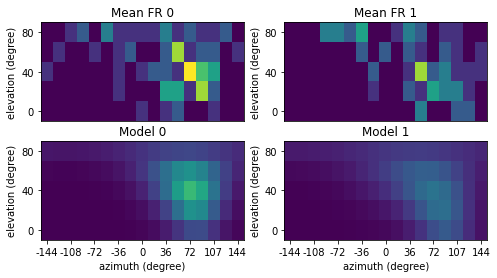

Plotting neuron 513: vmin=0, vmax=0.13
Plotting neuron 513: vmin=0, vmax=0.13


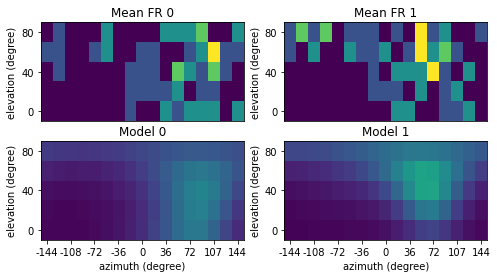

Plotting neuron 514: vmin=0, vmax=0.03
Plotting neuron 514: vmin=0, vmax=0.03


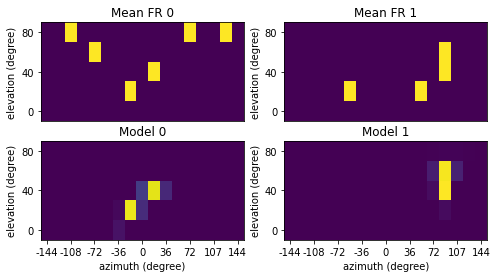

Plotting neuron 515: vmin=0, vmax=0.03
Plotting neuron 515: vmin=0, vmax=0.03


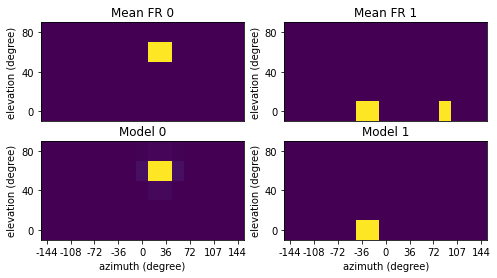

Plotting neuron 516: vmin=0, vmax=0.03
Plotting neuron 516: vmin=0, vmax=0.03


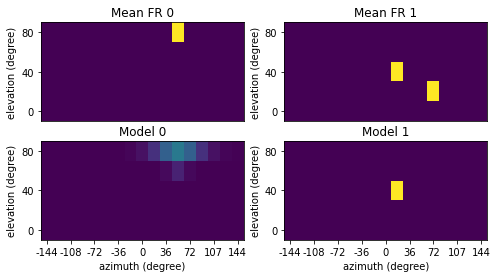

Plotting neuron 517: vmin=0, vmax=0.03
Plotting neuron 517: vmin=0, vmax=0.03


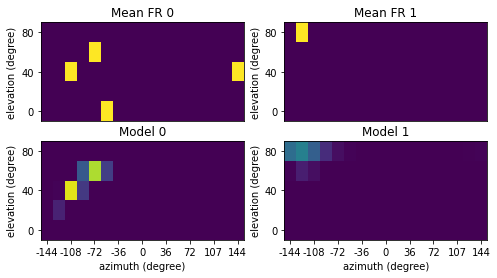

Plotting neuron 518: vmin=0, vmax=0.07
Plotting neuron 518: vmin=0, vmax=0.07


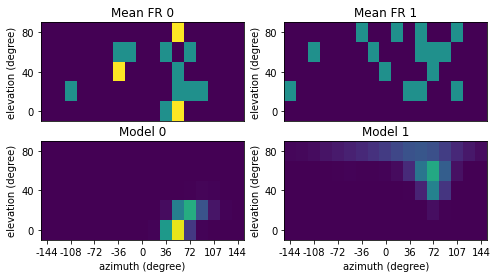

Plotting neuron 519: vmin=0, vmax=0.1
Plotting neuron 519: vmin=0, vmax=0.1


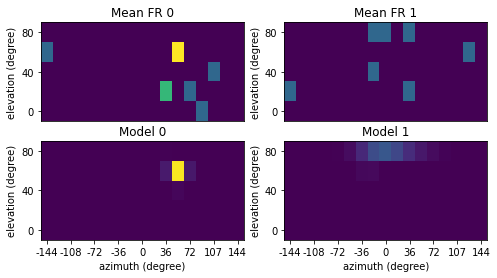

Plotting neuron 520: vmin=0, vmax=0.07
Plotting neuron 520: vmin=0, vmax=0.07


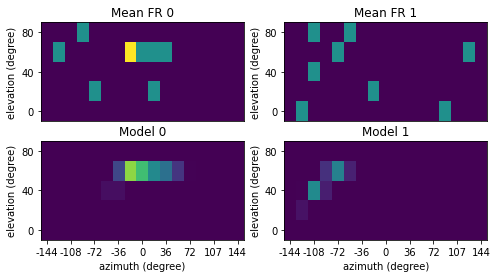

Plotting neuron 522: vmin=0, vmax=0.07
Plotting neuron 522: vmin=0, vmax=0.07


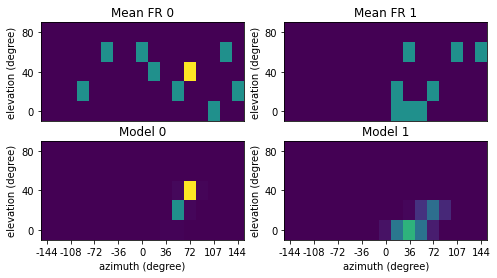

Plotting neuron 523: vmin=0, vmax=0.47
Plotting neuron 523: vmin=0, vmax=0.47


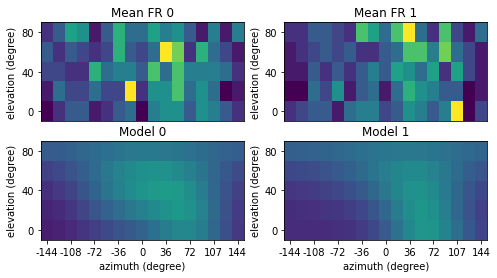

Plotting neuron 524: vmin=0, vmax=0.2
Plotting neuron 524: vmin=0, vmax=0.2


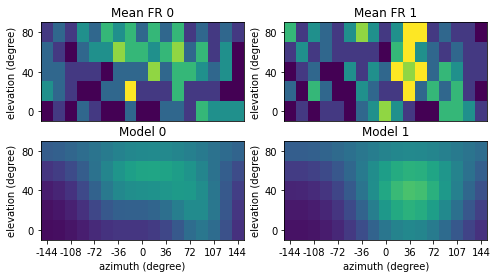

Plotting neuron 525: vmin=0, vmax=0.07
Plotting neuron 525: vmin=0, vmax=0.07


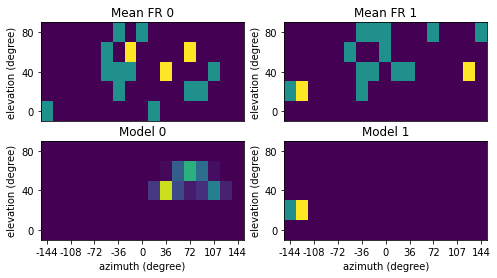

Plotting neuron 528: vmin=0, vmax=0.53
Plotting neuron 528: vmin=0, vmax=0.53


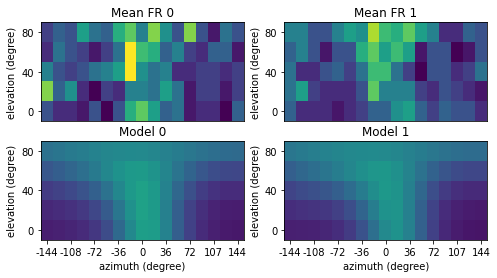

Plotting neuron 529: vmin=0, vmax=0.33
Plotting neuron 529: vmin=0, vmax=0.33


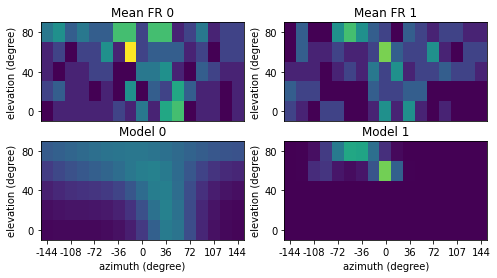

Plotting neuron 530: vmin=0, vmax=0.47
Plotting neuron 530: vmin=0, vmax=0.47


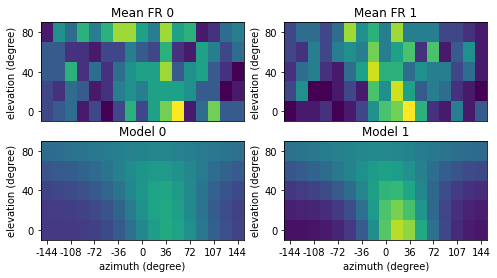

Plotting neuron 531: vmin=0, vmax=0.4
Plotting neuron 531: vmin=0, vmax=0.4


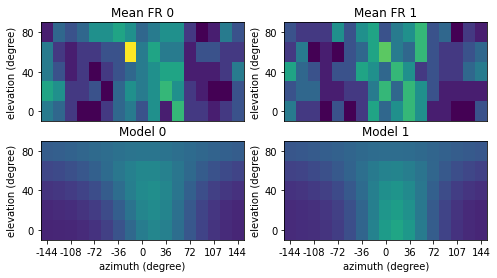

Plotting neuron 534: vmin=0, vmax=0.1
Plotting neuron 534: vmin=0, vmax=0.1


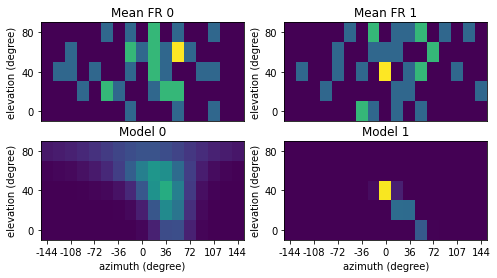

Plotting neuron 538: vmin=0, vmax=0.17
Plotting neuron 538: vmin=0, vmax=0.17


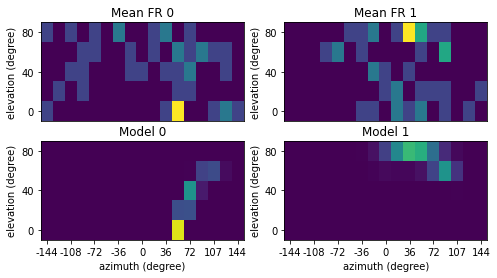

Plotting neuron 539: vmin=0, vmax=0.03
Plotting neuron 539: vmin=0, vmax=0.03


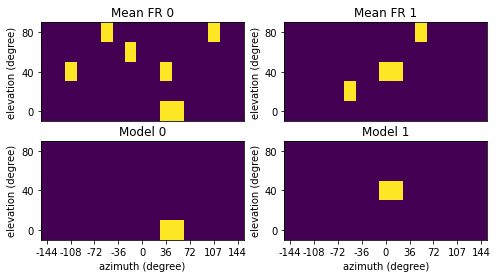

Plotting neuron 540: vmin=0, vmax=0.03
Plotting neuron 540: vmin=0, vmax=0.03


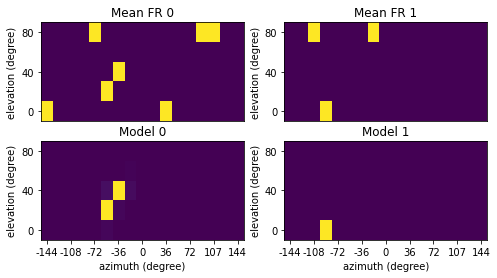

Plotting neuron 541: vmin=0, vmax=0.07
Plotting neuron 541: vmin=0, vmax=0.07


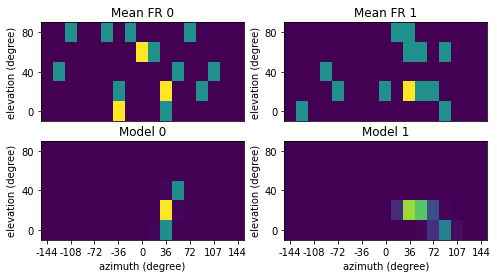

Plotting neuron 542: vmin=0, vmax=0.4
Plotting neuron 542: vmin=0, vmax=0.4


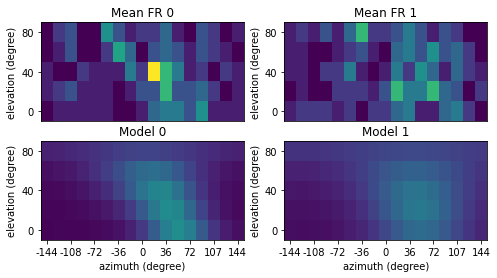

Plotting neuron 543: vmin=0, vmax=0.4
Plotting neuron 543: vmin=0, vmax=0.4


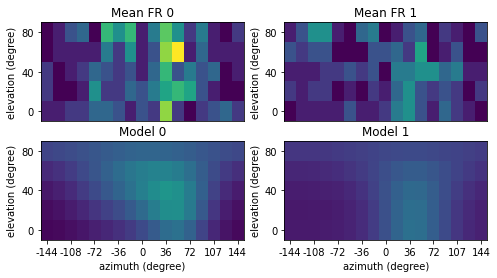

Plotting neuron 547: vmin=0, vmax=0.4
Plotting neuron 547: vmin=0, vmax=0.4


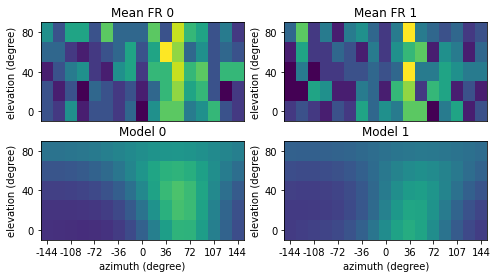

Plotting neuron 551: vmin=0, vmax=0.13
Plotting neuron 551: vmin=0, vmax=0.13


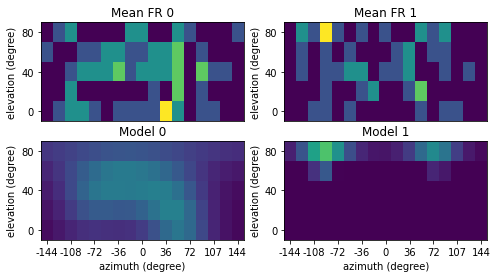

Plotting neuron 552: vmin=0, vmax=0.1
Plotting neuron 552: vmin=0, vmax=0.1


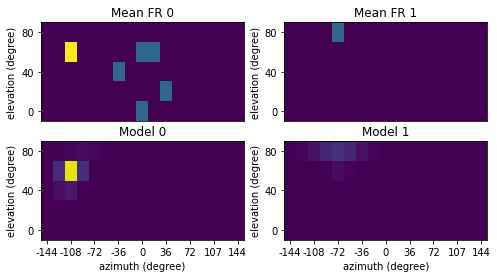

Plotting neuron 555: vmin=0, vmax=0.03
Plotting neuron 555: vmin=0, vmax=0.03


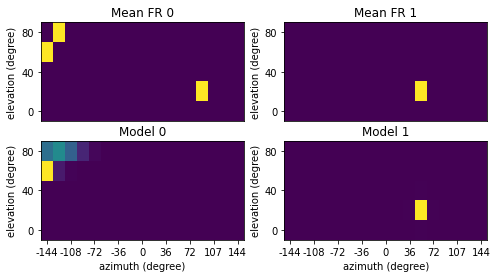

Plotting neuron 562: vmin=0, vmax=0.07
Plotting neuron 562: vmin=0, vmax=0.07


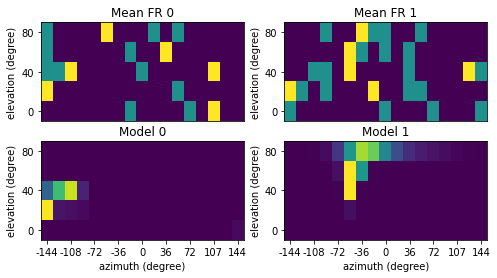

Plotting neuron 565: vmin=0, vmax=0.07
Plotting neuron 565: vmin=0, vmax=0.07


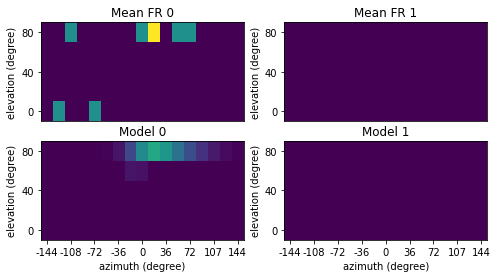

Plotting neuron 566: vmin=0, vmax=0.03
Plotting neuron 566: vmin=0, vmax=0.03


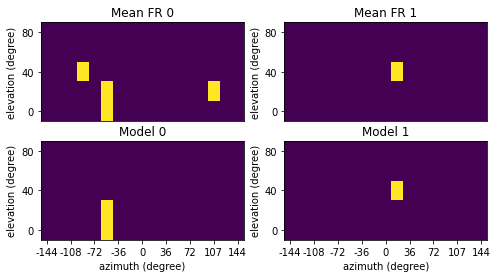

Plotting neuron 567: vmin=0, vmax=0.07
Plotting neuron 567: vmin=0, vmax=0.07


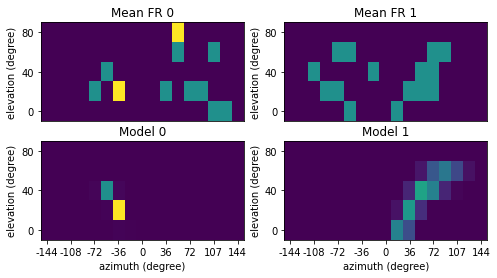

Plotting neuron 568: vmin=0, vmax=0.07
Plotting neuron 568: vmin=0, vmax=0.07


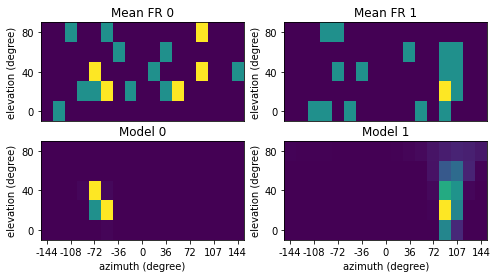

Plotting neuron 569: vmin=0, vmax=0.13
Plotting neuron 569: vmin=0, vmax=0.13


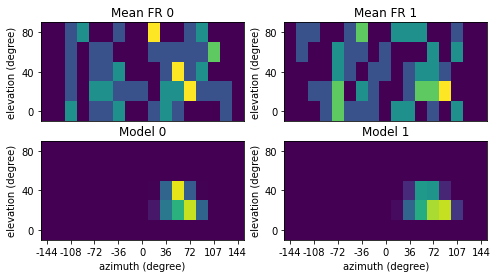

Plotting neuron 571: vmin=0, vmax=0.6
Plotting neuron 571: vmin=0, vmax=0.6


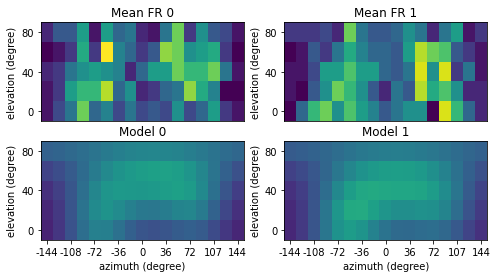

Plotting neuron 572: vmin=0, vmax=0.33
Plotting neuron 572: vmin=0, vmax=0.33


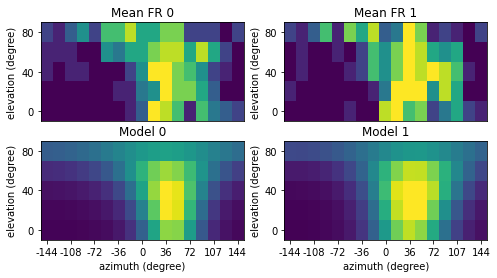

Plotting neuron 573: vmin=0, vmax=0.17
Plotting neuron 573: vmin=0, vmax=0.17


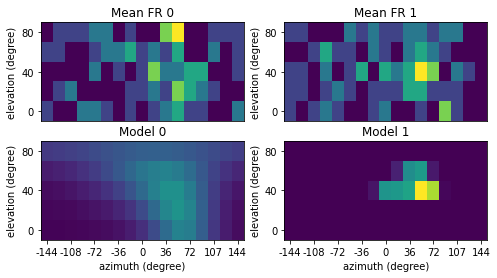

Plotting neuron 575: vmin=0, vmax=0.27
Plotting neuron 575: vmin=0, vmax=0.27


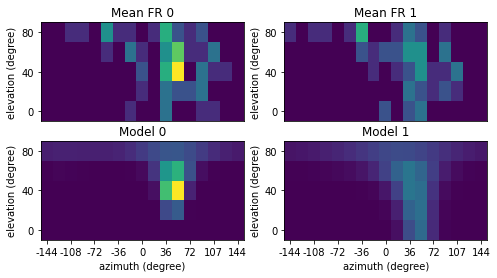

Plotting neuron 577: vmin=0, vmax=0.07
Plotting neuron 577: vmin=0, vmax=0.07


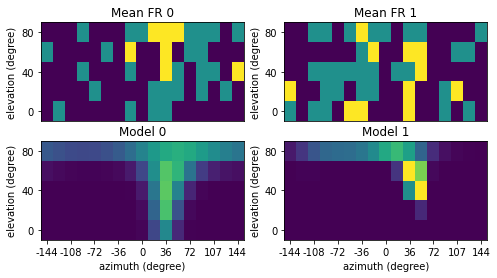

Plotting neuron 578: vmin=0, vmax=0.5
Plotting neuron 578: vmin=0, vmax=0.5


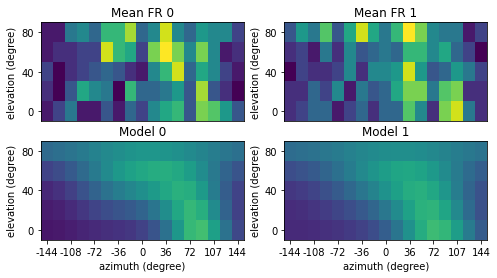

Plotting neuron 579: vmin=0, vmax=0.27
Plotting neuron 579: vmin=0, vmax=0.27


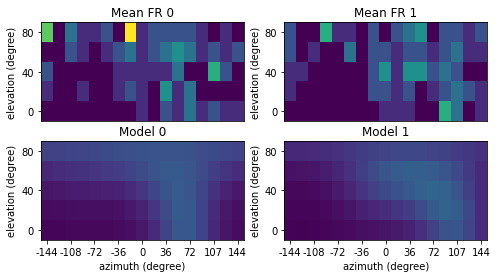

Plotting neuron 581: vmin=0, vmax=0.2
Plotting neuron 581: vmin=0, vmax=0.2


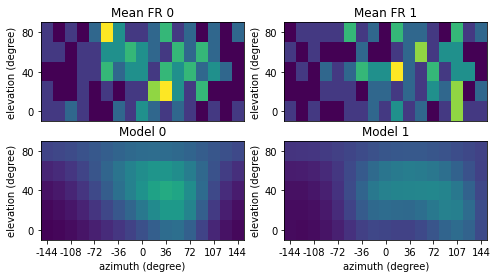

Plotting neuron 587: vmin=0, vmax=0.07
Plotting neuron 587: vmin=0, vmax=0.07


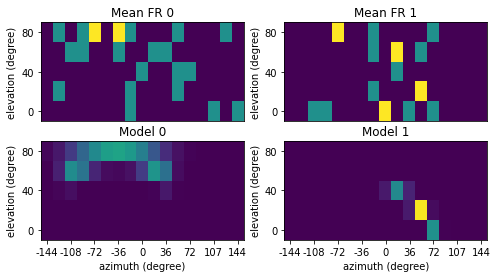

Plotting neuron 588: vmin=0, vmax=0.23
Plotting neuron 588: vmin=0, vmax=0.23


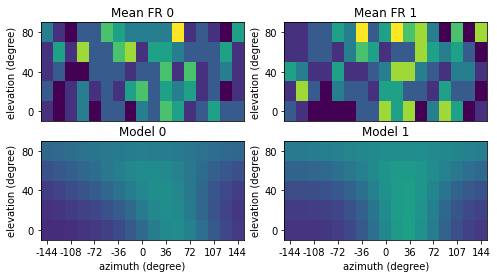

Plotting neuron 591: vmin=0, vmax=0.03
Plotting neuron 591: vmin=0, vmax=0.03


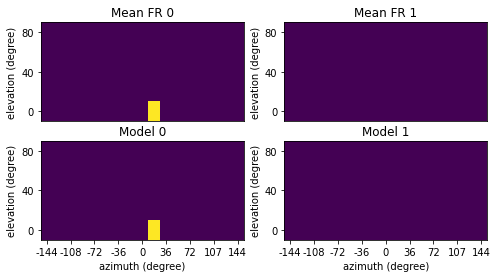

Plotting neuron 592: vmin=0, vmax=0.03
Plotting neuron 592: vmin=0, vmax=0.03


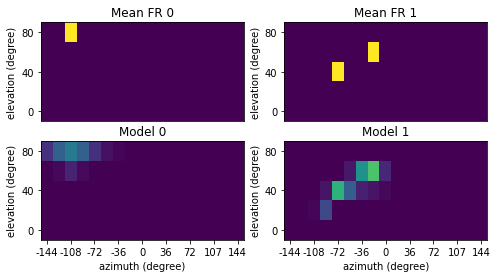

Plotting neuron 593: vmin=0, vmax=0.03
Plotting neuron 593: vmin=0, vmax=0.03


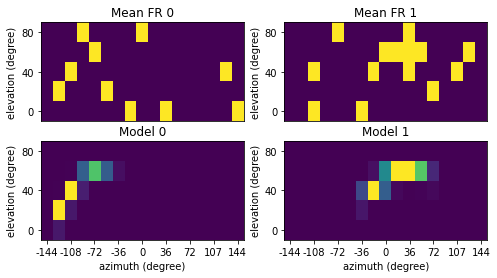

Plotting neuron 597: vmin=0, vmax=0.6
Plotting neuron 597: vmin=0, vmax=0.6


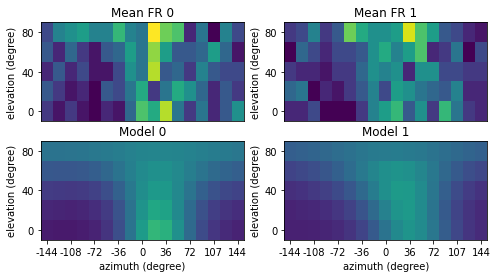

Plotting neuron 598: vmin=0, vmax=0.33
Plotting neuron 598: vmin=0, vmax=0.33


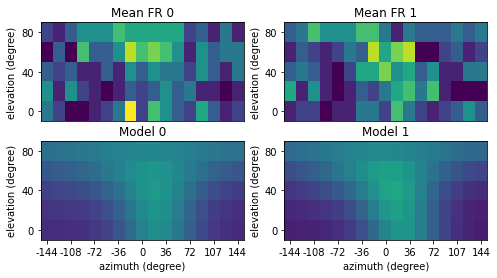

Plotting neuron 599: vmin=0, vmax=1.03
Plotting neuron 599: vmin=0, vmax=1.03


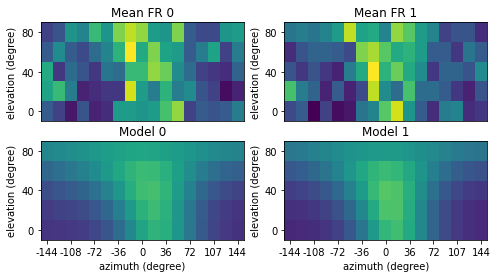

Plotting neuron 603: vmin=0, vmax=0.03
Plotting neuron 603: vmin=0, vmax=0.03


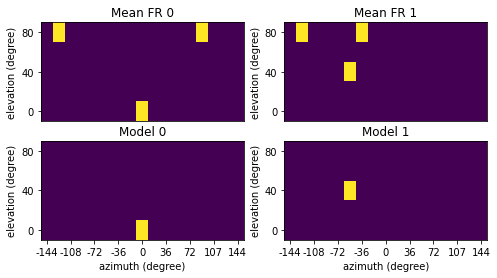

Plotting neuron 609: vmin=0, vmax=0.4
Plotting neuron 609: vmin=0, vmax=0.4


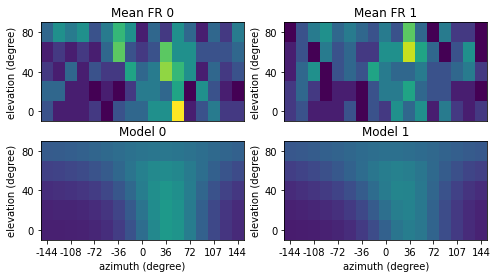

Plotting neuron 610: vmin=0, vmax=0.1
Plotting neuron 610: vmin=0, vmax=0.1


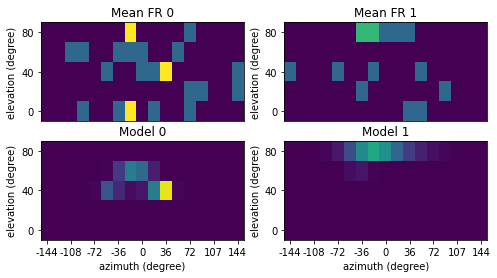

Plotting neuron 613: vmin=0, vmax=0.2
Plotting neuron 613: vmin=0, vmax=0.2


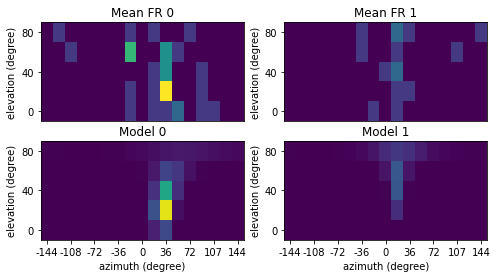

Plotting neuron 615: vmin=0, vmax=0.07
Plotting neuron 615: vmin=0, vmax=0.07


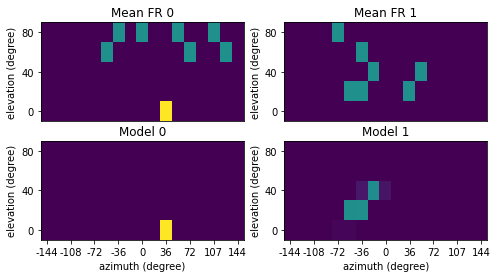

Plotting neuron 616: vmin=0, vmax=0.07
Plotting neuron 616: vmin=0, vmax=0.07


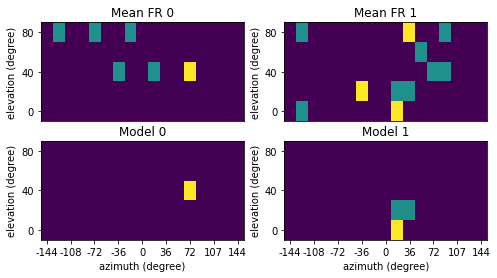

Plotting neuron 617: vmin=0, vmax=0.03
Plotting neuron 617: vmin=0, vmax=0.03


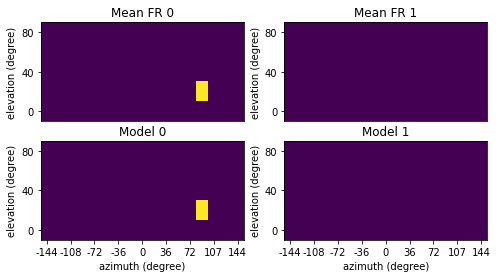

Plotting neuron 622: vmin=0, vmax=0.03
Plotting neuron 622: vmin=0, vmax=0.03


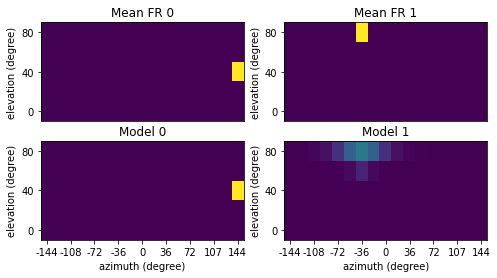

Plotting neuron 623: vmin=0, vmax=0.03
Plotting neuron 623: vmin=0, vmax=0.03


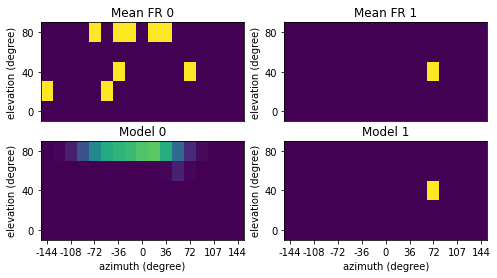

Plotting neuron 637: vmin=0, vmax=0.03
Plotting neuron 637: vmin=0, vmax=0.03


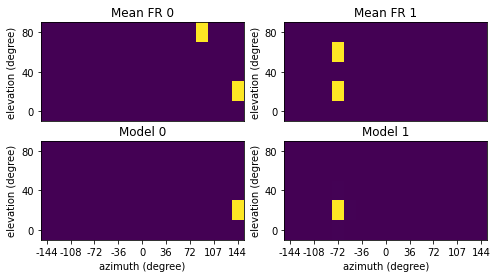

Plotting neuron 642: vmin=0, vmax=0.03
Plotting neuron 642: vmin=0, vmax=0.03


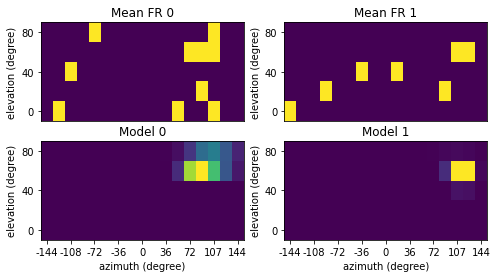

Plotting neuron 644: vmin=0, vmax=0.03
Plotting neuron 644: vmin=0, vmax=0.03


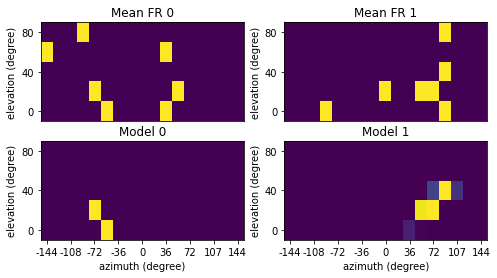

Plotting neuron 645: vmin=0, vmax=0.13
Plotting neuron 645: vmin=0, vmax=0.13


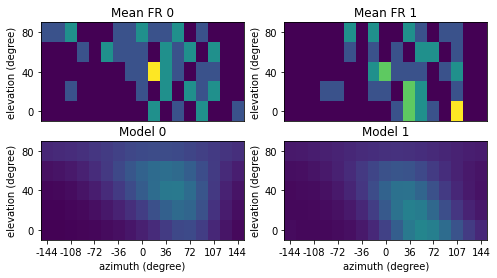

Plotting neuron 646: vmin=0, vmax=0.13
Plotting neuron 646: vmin=0, vmax=0.13


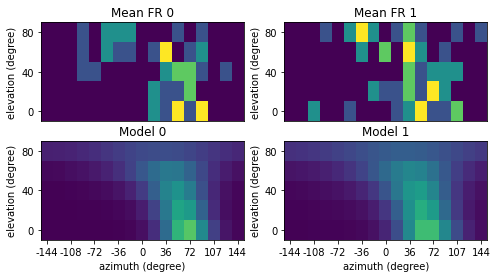

Plotting neuron 647: vmin=0, vmax=0.33
Plotting neuron 647: vmin=0, vmax=0.33


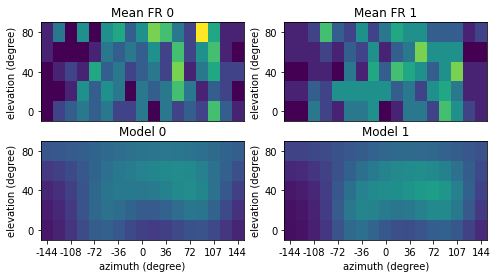

Plotting neuron 654: vmin=0, vmax=0.3
Plotting neuron 654: vmin=0, vmax=0.3


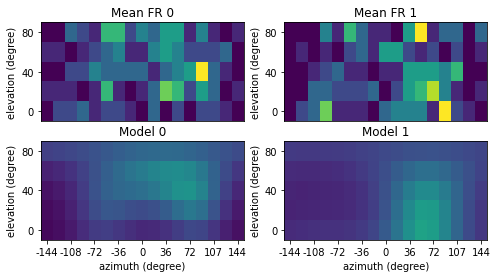

Plotting neuron 657: vmin=0, vmax=0.07
Plotting neuron 657: vmin=0, vmax=0.07


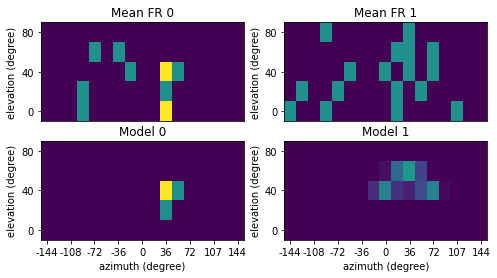

Plotting neuron 658: vmin=0, vmax=0.23
Plotting neuron 658: vmin=0, vmax=0.23


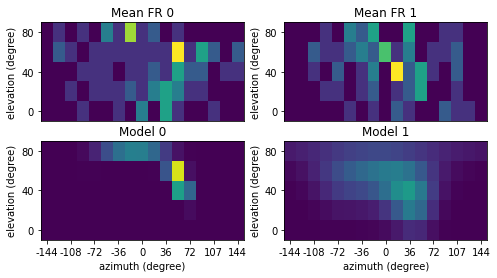

Plotting neuron 659: vmin=0, vmax=0.13
Plotting neuron 659: vmin=0, vmax=0.13


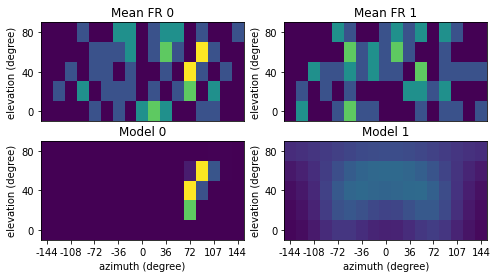

Plotting neuron 660: vmin=0, vmax=0.07
Plotting neuron 660: vmin=0, vmax=0.07


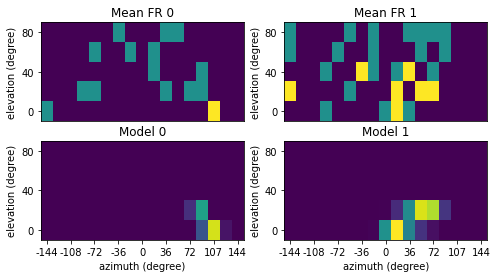

Plotting neuron 661: vmin=0, vmax=0.03
Plotting neuron 661: vmin=0, vmax=0.03


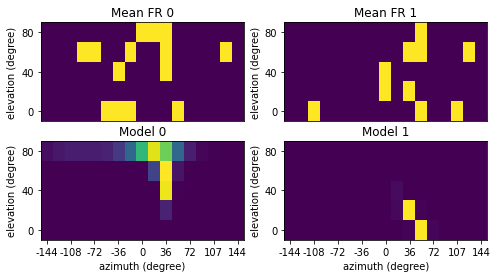

Plotting neuron 663: vmin=0, vmax=0.07
Plotting neuron 663: vmin=0, vmax=0.07


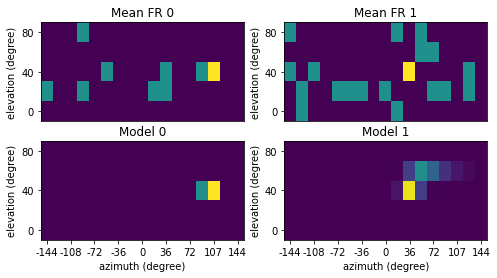

Plotting neuron 664: vmin=0, vmax=0.07
Plotting neuron 664: vmin=0, vmax=0.07


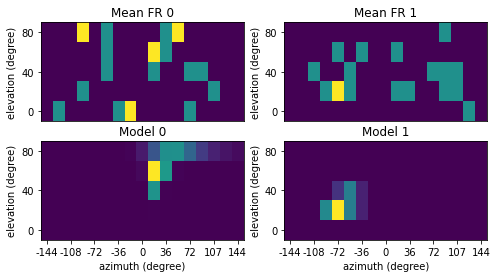

Plotting neuron 667: vmin=0, vmax=0.1
Plotting neuron 667: vmin=0, vmax=0.1


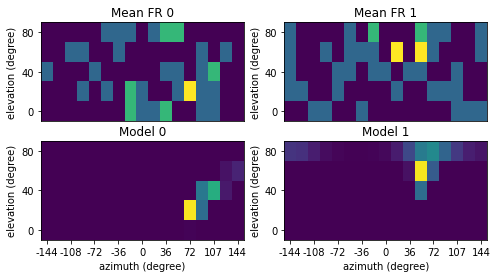

Plotting neuron 671: vmin=0, vmax=0.1
Plotting neuron 671: vmin=0, vmax=0.1


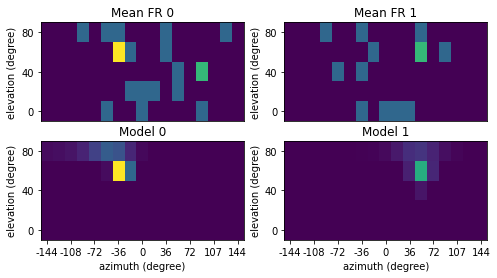

Plotting neuron 676: vmin=0, vmax=0.07
Plotting neuron 676: vmin=0, vmax=0.07


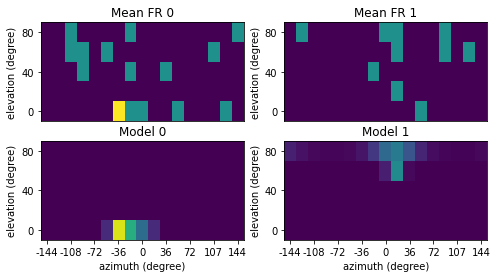

Plotting neuron 678: vmin=0, vmax=0.1
Plotting neuron 678: vmin=0, vmax=0.1


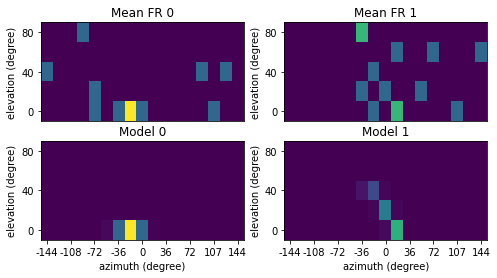

Plotting neuron 680: vmin=0, vmax=0.23
Plotting neuron 680: vmin=0, vmax=0.23


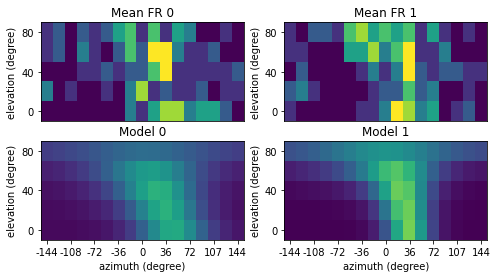

Plotting neuron 682: vmin=0, vmax=0.03
Plotting neuron 682: vmin=0, vmax=0.03


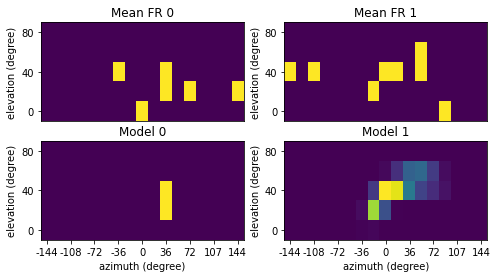

Plotting neuron 683: vmin=0, vmax=0.1
Plotting neuron 683: vmin=0, vmax=0.1


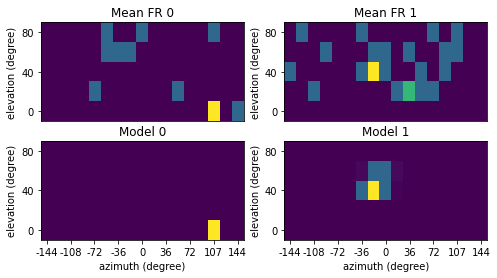

Plotting neuron 684: vmin=0, vmax=0.03
Plotting neuron 684: vmin=0, vmax=0.03


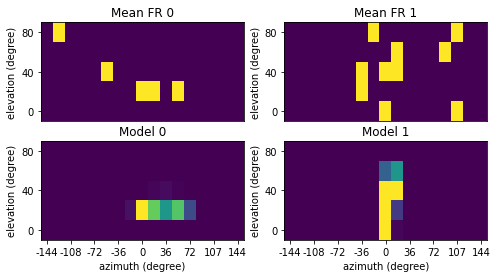

Plotting neuron 685: vmin=0, vmax=0.03
Plotting neuron 685: vmin=0, vmax=0.03


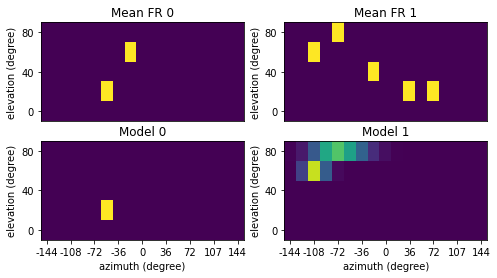

Plotting neuron 686: vmin=0, vmax=0.07
Plotting neuron 686: vmin=0, vmax=0.07


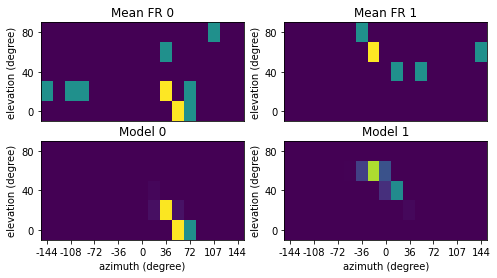

Plotting neuron 687: vmin=0, vmax=0.07
Plotting neuron 687: vmin=0, vmax=0.07


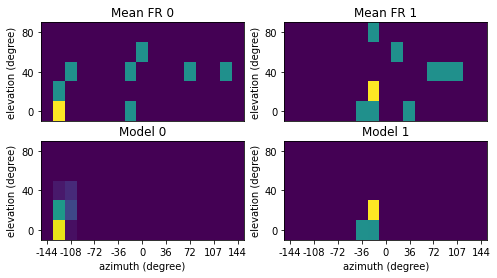

Plotting neuron 690: vmin=0, vmax=0.07
Plotting neuron 690: vmin=0, vmax=0.07


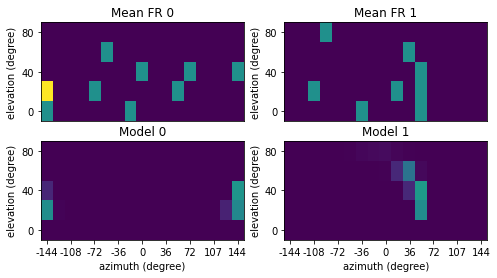

Plotting neuron 691: vmin=0, vmax=0.03
Plotting neuron 691: vmin=0, vmax=0.03


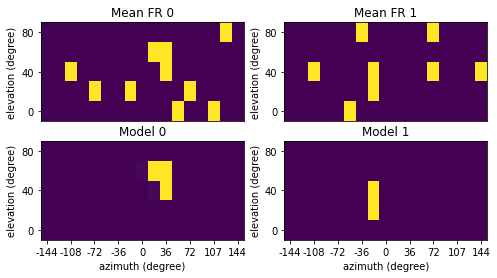

Plotting neuron 692: vmin=0, vmax=0.03
Plotting neuron 692: vmin=0, vmax=0.03


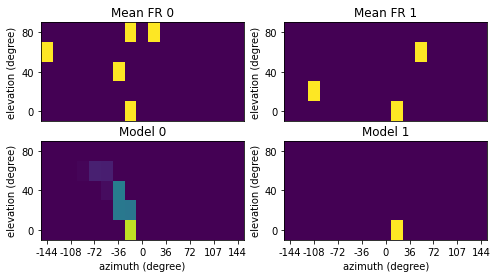

Plotting neuron 693: vmin=0, vmax=0.07
Plotting neuron 693: vmin=0, vmax=0.07


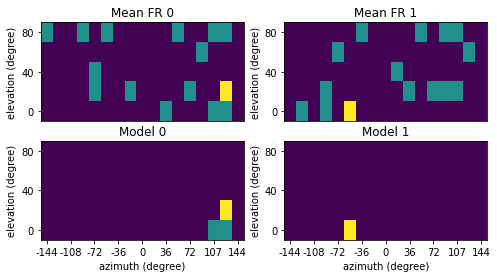

Plotting neuron 703: vmin=0, vmax=0.03
Plotting neuron 703: vmin=0, vmax=0.03


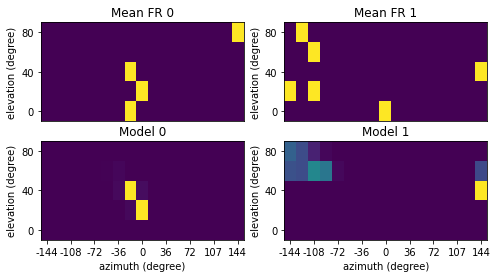

Plotting neuron 709: vmin=0, vmax=0.33
Plotting neuron 709: vmin=0, vmax=0.33


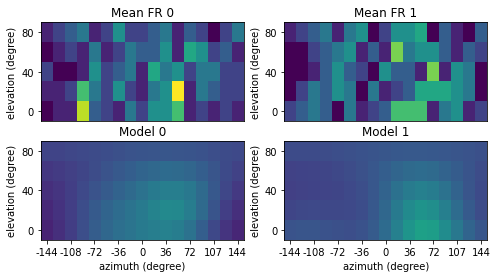

Plotting neuron 717: vmin=0, vmax=0.03
Plotting neuron 717: vmin=0, vmax=0.03


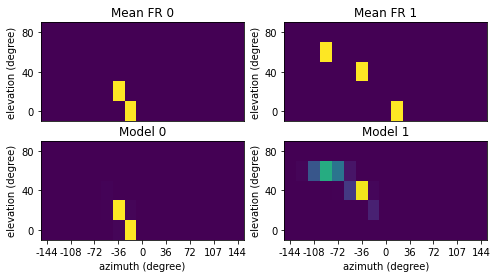

Plotting neuron 718: vmin=0, vmax=0.07
Plotting neuron 718: vmin=0, vmax=0.07


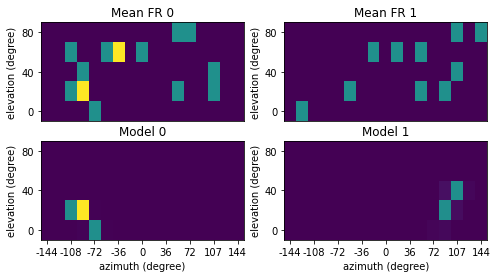

Plotting neuron 719: vmin=0, vmax=0.07
Plotting neuron 719: vmin=0, vmax=0.07


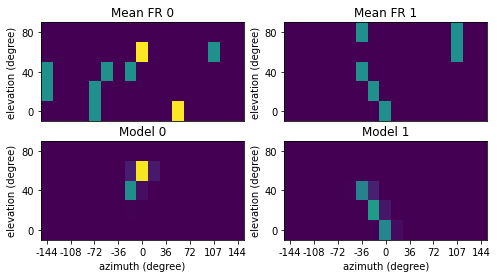

Plotting neuron 723: vmin=0, vmax=0.03
Plotting neuron 723: vmin=0, vmax=0.03


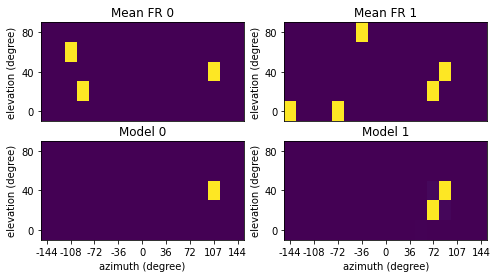

Plotting neuron 725: vmin=0, vmax=0.07
Plotting neuron 725: vmin=0, vmax=0.07


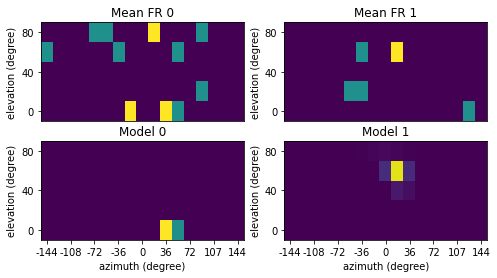

Plotting neuron 726: vmin=0, vmax=0.1
Plotting neuron 726: vmin=0, vmax=0.1


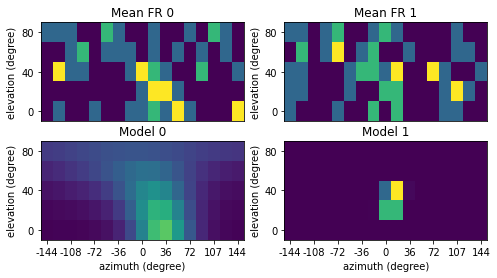

Plotting neuron 727: vmin=0, vmax=0.07
Plotting neuron 727: vmin=0, vmax=0.07


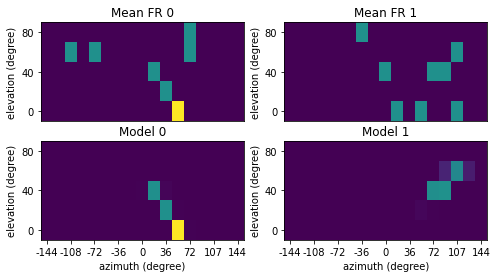

Plotting neuron 728: vmin=0, vmax=0.23
Plotting neuron 728: vmin=0, vmax=0.23


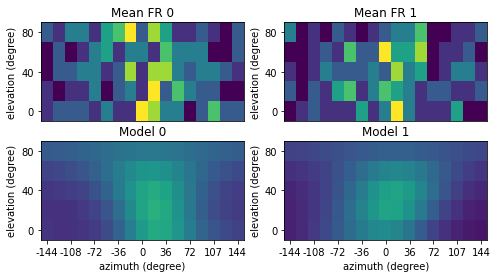

Plotting neuron 731: vmin=0, vmax=0.1
Plotting neuron 731: vmin=0, vmax=0.1


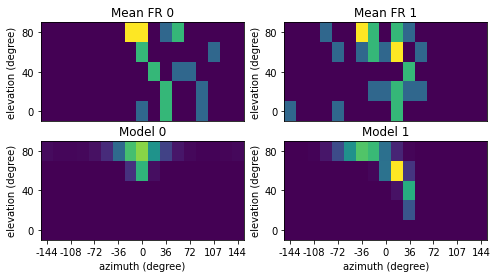

Plotting neuron 732: vmin=0, vmax=0.17
Plotting neuron 732: vmin=0, vmax=0.17


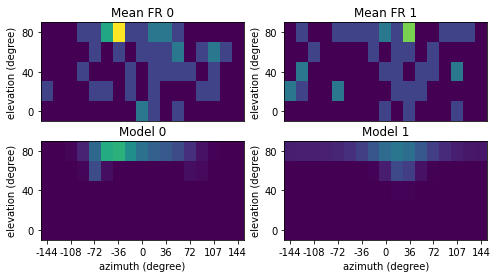

Plotting neuron 733: vmin=0, vmax=0.1
Plotting neuron 733: vmin=0, vmax=0.1


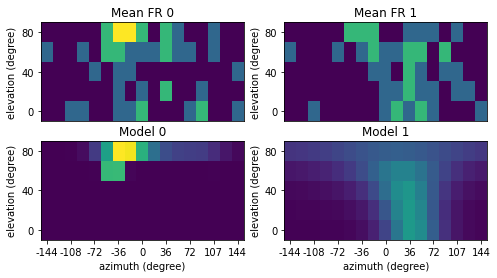

Plotting neuron 734: vmin=0, vmax=0.13
Plotting neuron 734: vmin=0, vmax=0.13


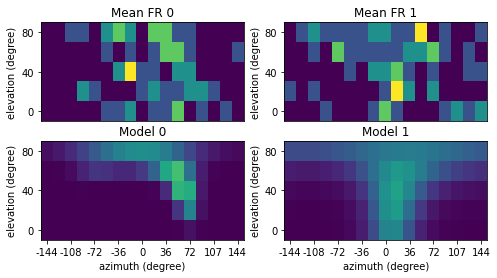

Plotting neuron 736: vmin=0, vmax=0.03
Plotting neuron 736: vmin=0, vmax=0.03


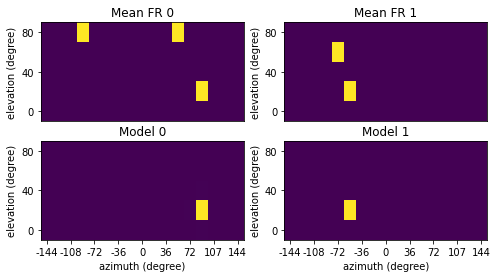

Plotting neuron 741: vmin=0, vmax=0.03
Plotting neuron 741: vmin=0, vmax=0.03


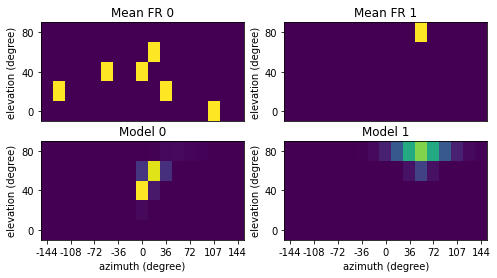

Plotting neuron 749: vmin=0, vmax=0.07
Plotting neuron 749: vmin=0, vmax=0.07


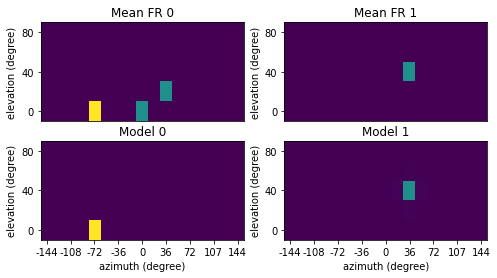

Plotting neuron 757: vmin=0, vmax=0.07
Plotting neuron 757: vmin=0, vmax=0.07


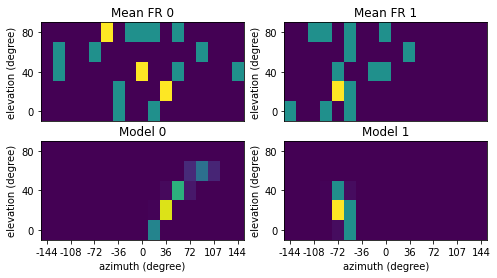

Plotting neuron 767: vmin=0, vmax=0.03
Plotting neuron 767: vmin=0, vmax=0.03


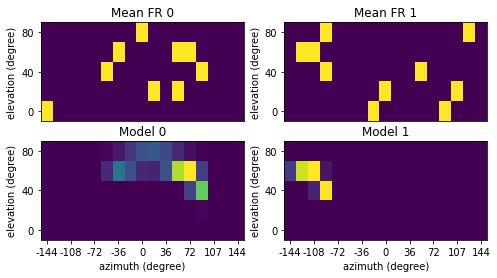

Plotting neuron 778: vmin=0, vmax=0.03
Plotting neuron 778: vmin=0, vmax=0.03


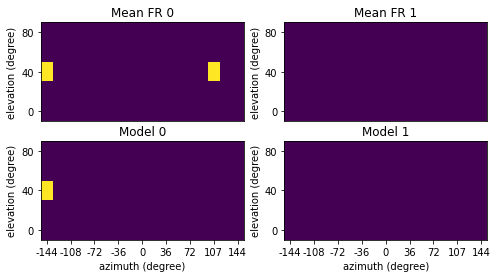

Plotting neuron 782: vmin=0, vmax=0.13
Plotting neuron 782: vmin=0, vmax=0.13


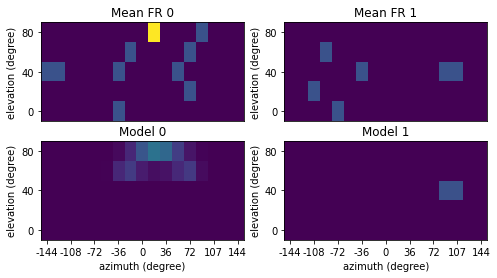

Plotting neuron 785: vmin=0, vmax=0.5
Plotting neuron 785: vmin=0, vmax=0.5


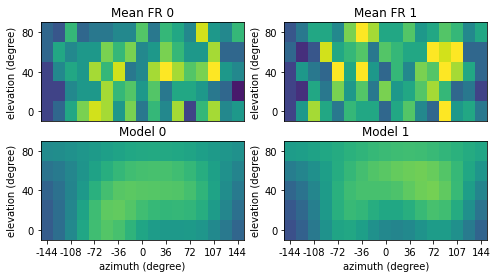

Plotting neuron 787: vmin=0, vmax=2.33
Plotting neuron 787: vmin=0, vmax=2.33


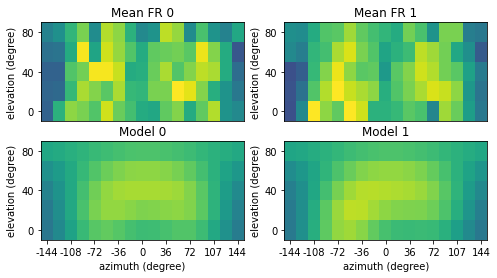

Plotting neuron 789: vmin=0, vmax=0.1
Plotting neuron 789: vmin=0, vmax=0.1


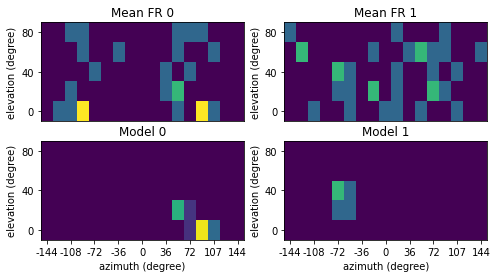

Plotting neuron 794: vmin=0, vmax=0.13
Plotting neuron 794: vmin=0, vmax=0.13


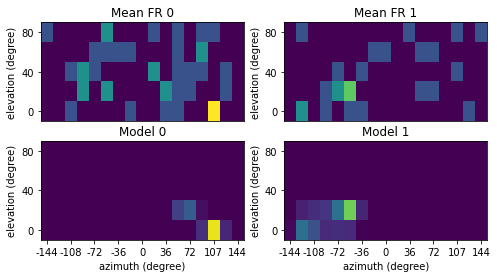

Plotting neuron 795: vmin=0, vmax=0.1
Plotting neuron 795: vmin=0, vmax=0.1


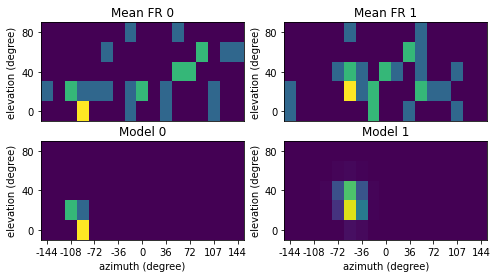

Plotting neuron 800: vmin=0, vmax=0.07
Plotting neuron 800: vmin=0, vmax=0.07


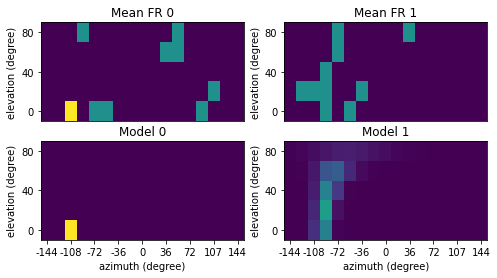

Plotting neuron 802: vmin=0, vmax=0.07
Plotting neuron 802: vmin=0, vmax=0.07


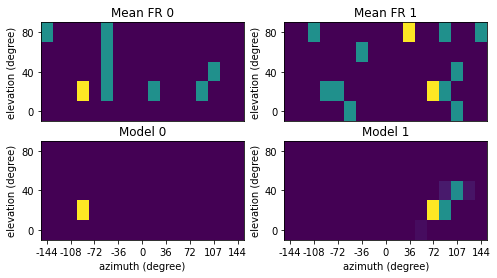

Plotting neuron 803: vmin=0, vmax=0.1
Plotting neuron 803: vmin=0, vmax=0.1


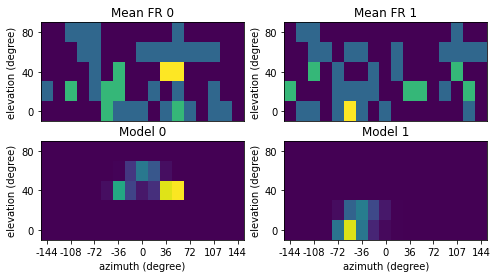

Plotting neuron 805: vmin=0, vmax=0.03
Plotting neuron 805: vmin=0, vmax=0.03


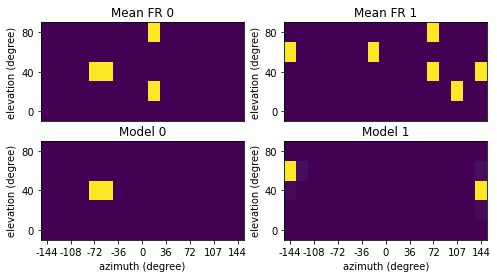

Plotting neuron 809: vmin=0, vmax=0.17
Plotting neuron 809: vmin=0, vmax=0.17


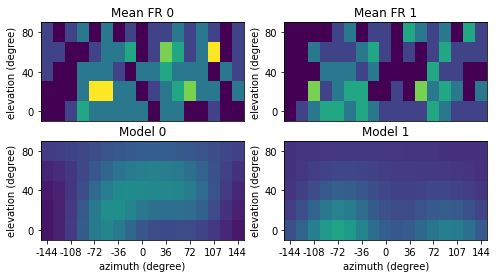

Plotting neuron 810: vmin=0, vmax=0.03
Plotting neuron 810: vmin=0, vmax=0.03


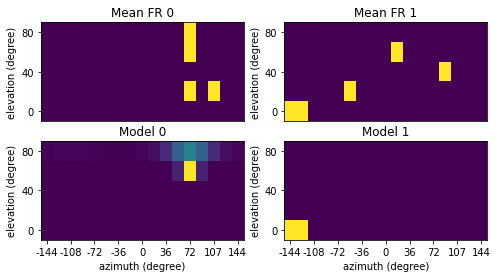

Plotting neuron 814: vmin=0, vmax=0.2
Plotting neuron 814: vmin=0, vmax=0.2


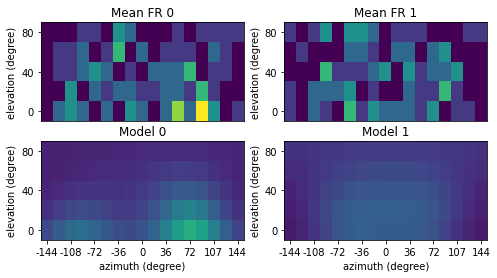

Plotting neuron 815: vmin=0, vmax=0.07
Plotting neuron 815: vmin=0, vmax=0.07


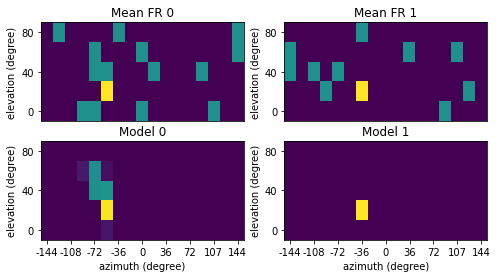

Plotting neuron 818: vmin=0, vmax=0.07
Plotting neuron 818: vmin=0, vmax=0.07


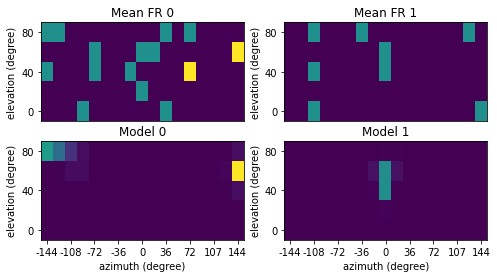

Plotting neuron 819: vmin=0, vmax=0.03
Plotting neuron 819: vmin=0, vmax=0.03


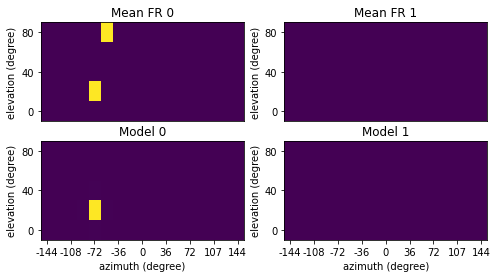

Plotting neuron 823: vmin=0, vmax=0.03
Plotting neuron 823: vmin=0, vmax=0.03


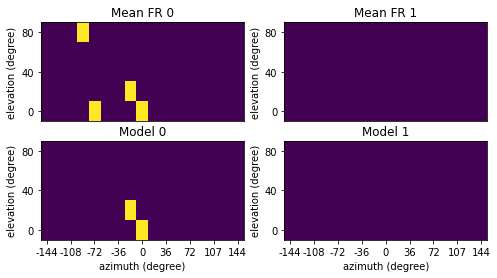

Plotting neuron 828: vmin=0, vmax=0.07
Plotting neuron 828: vmin=0, vmax=0.07


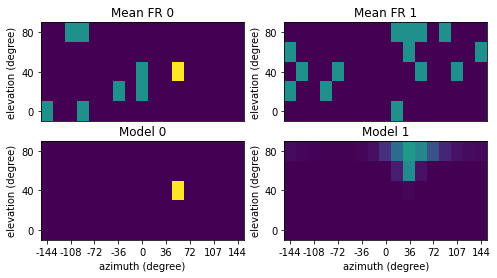

Plotting neuron 829: vmin=0, vmax=0.07
Plotting neuron 829: vmin=0, vmax=0.07


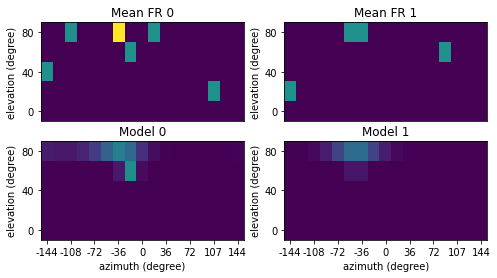

Plotting neuron 830: vmin=0, vmax=0.07
Plotting neuron 830: vmin=0, vmax=0.07


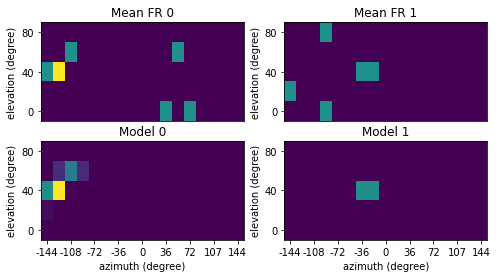

Plotting neuron 831: vmin=0, vmax=0.13
Plotting neuron 831: vmin=0, vmax=0.13


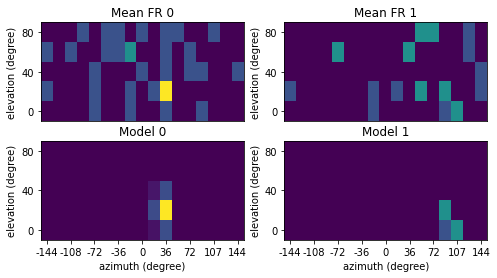

Plotting neuron 832: vmin=0, vmax=0.03
Plotting neuron 832: vmin=0, vmax=0.03


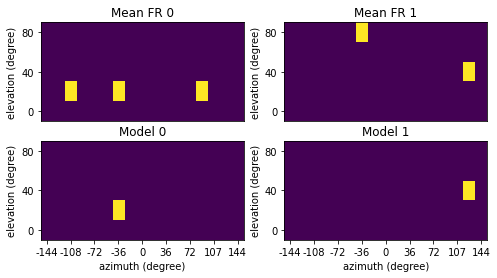

Plotting neuron 833: vmin=0, vmax=0.03
Plotting neuron 833: vmin=0, vmax=0.03


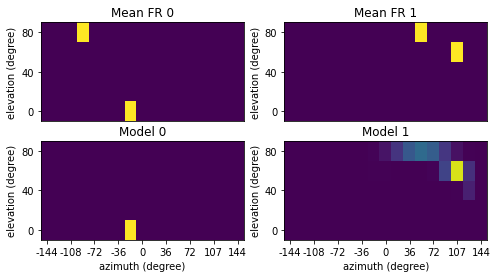

Plotting neuron 835: vmin=0, vmax=0.03
Plotting neuron 835: vmin=0, vmax=0.03


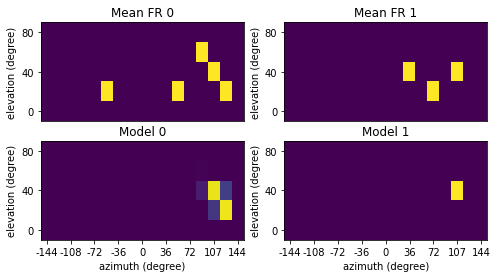

Plotting neuron 838: vmin=0, vmax=0.03
Plotting neuron 838: vmin=0, vmax=0.03


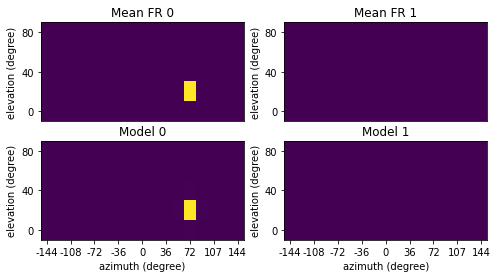

Plotting neuron 841: vmin=0, vmax=0.03
Plotting neuron 841: vmin=0, vmax=0.03


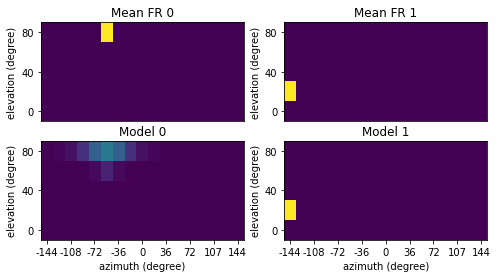

Plotting neuron 843: vmin=0, vmax=0.03
Plotting neuron 843: vmin=0, vmax=0.03


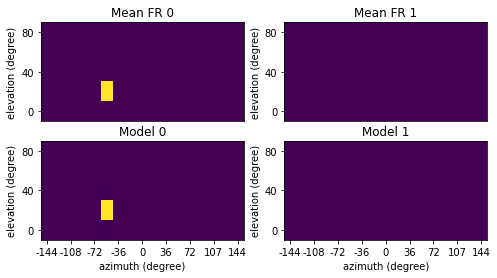

Plotting neuron 844: vmin=0, vmax=0.03
Plotting neuron 844: vmin=0, vmax=0.03


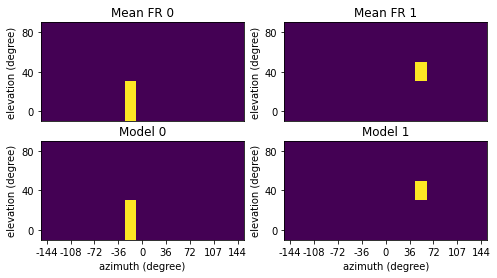

Plotting neuron 863: vmin=0, vmax=0.03
Plotting neuron 863: vmin=0, vmax=0.03


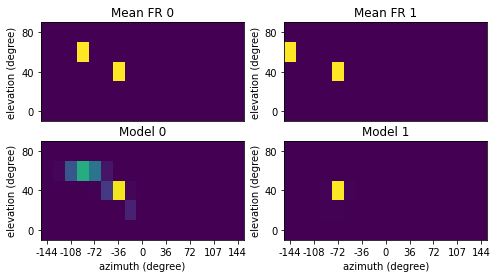

Plotting neuron 866: vmin=0, vmax=0.03
Plotting neuron 866: vmin=0, vmax=0.03


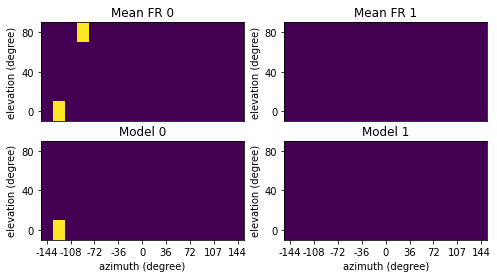

Plotting neuron 867: vmin=0, vmax=0.23
Plotting neuron 867: vmin=0, vmax=0.23


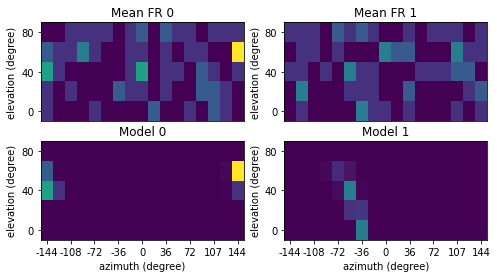

Plotting neuron 874: vmin=0, vmax=0.07
Plotting neuron 874: vmin=0, vmax=0.07


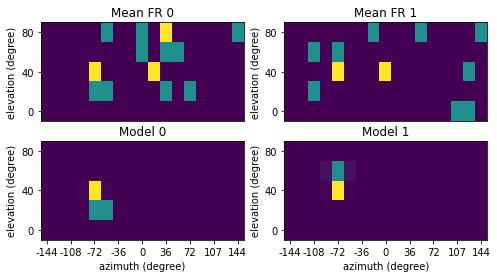

Plotting neuron 876: vmin=0, vmax=0.07
Plotting neuron 876: vmin=0, vmax=0.07


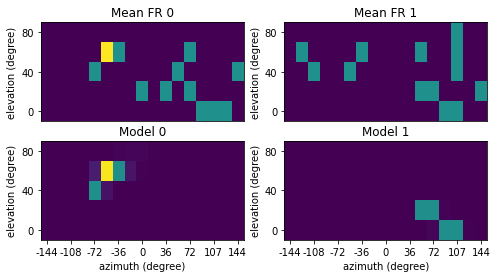

Plotting neuron 877: vmin=0, vmax=0.1
Plotting neuron 877: vmin=0, vmax=0.1


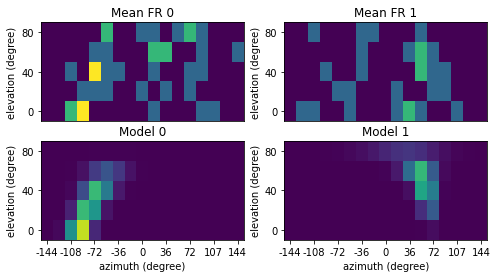

Plotting neuron 881: vmin=0, vmax=0.03
Plotting neuron 881: vmin=0, vmax=0.03


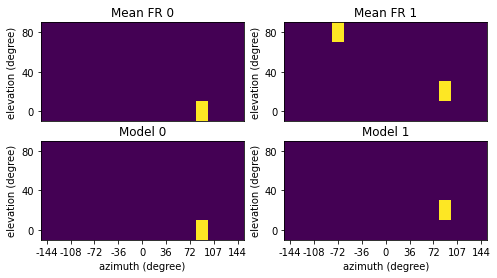

Plotting neuron 886: vmin=0, vmax=0.07
Plotting neuron 886: vmin=0, vmax=0.07


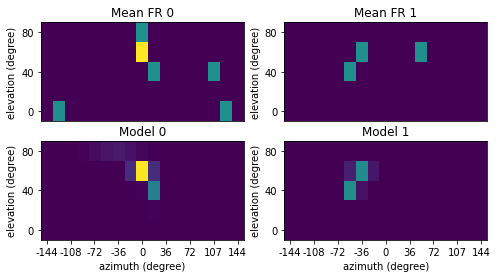

Plotting neuron 891: vmin=0, vmax=0.13
Plotting neuron 891: vmin=0, vmax=0.13


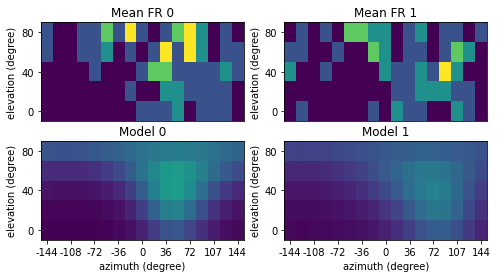

Plotting neuron 892: vmin=0, vmax=0.17
Plotting neuron 892: vmin=0, vmax=0.17


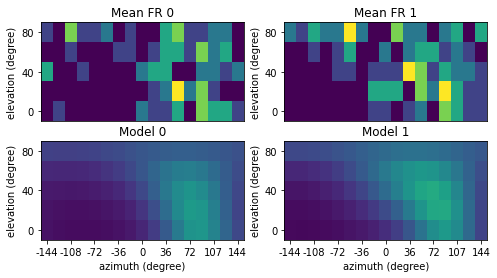

Plotting neuron 893: vmin=0, vmax=0.03
Plotting neuron 893: vmin=0, vmax=0.03


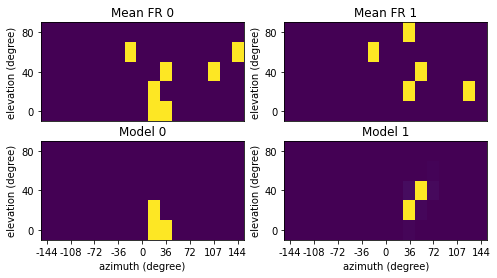

Plotting neuron 894: vmin=0, vmax=0.13
Plotting neuron 894: vmin=0, vmax=0.13


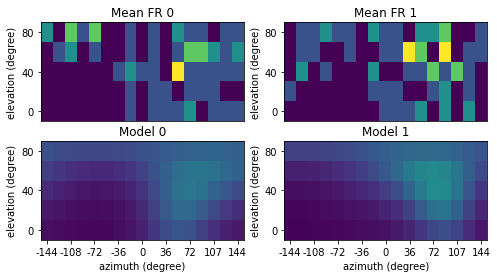

Plotting neuron 895: vmin=0, vmax=0.13
Plotting neuron 895: vmin=0, vmax=0.13


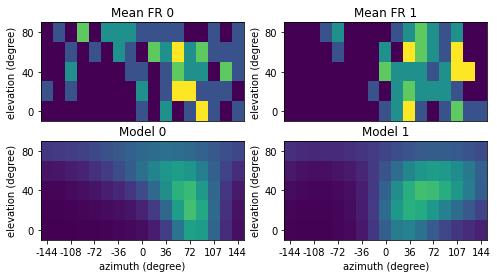

Plotting neuron 896: vmin=0, vmax=0.2
Plotting neuron 896: vmin=0, vmax=0.2


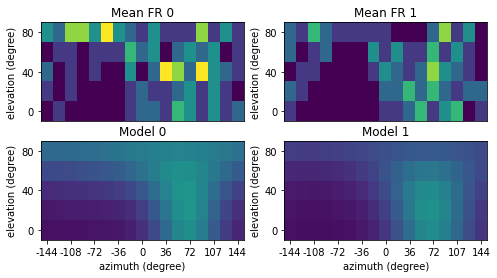

Plotting neuron 897: vmin=0, vmax=0.3
Plotting neuron 897: vmin=0, vmax=0.3


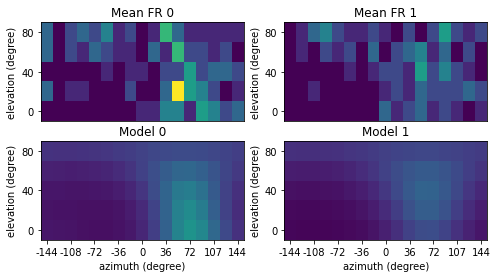

Plotting neuron 898: vmin=0, vmax=0.03
Plotting neuron 898: vmin=0, vmax=0.03


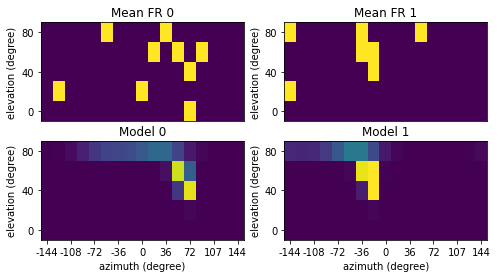

Plotting neuron 900: vmin=0, vmax=0.1
Plotting neuron 900: vmin=0, vmax=0.1


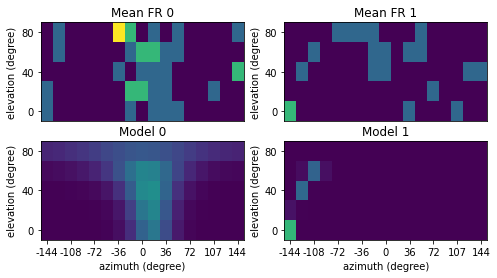

Plotting neuron 904: vmin=0, vmax=0.03
Plotting neuron 904: vmin=0, vmax=0.03


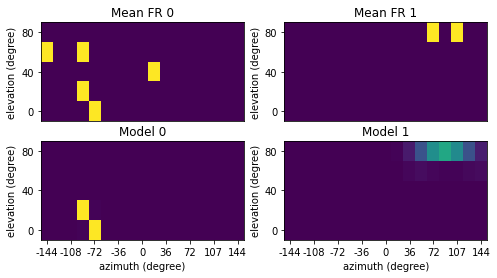

Plotting neuron 905: vmin=0, vmax=0.1
Plotting neuron 905: vmin=0, vmax=0.1


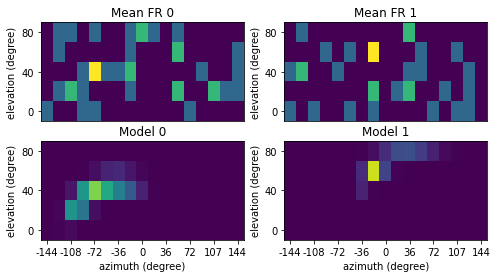

Plotting neuron 906: vmin=0, vmax=0.07
Plotting neuron 906: vmin=0, vmax=0.07


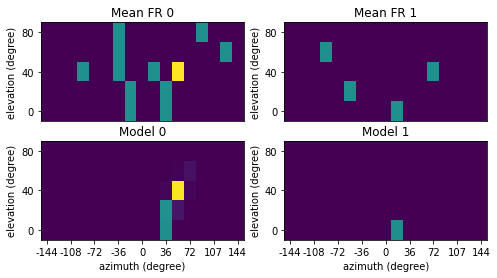

Plotting neuron 909: vmin=0, vmax=0.93
Plotting neuron 909: vmin=0, vmax=0.93


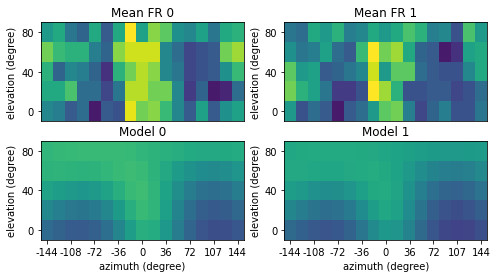

Plotting neuron 910: vmin=0, vmax=0.03
Plotting neuron 910: vmin=0, vmax=0.03


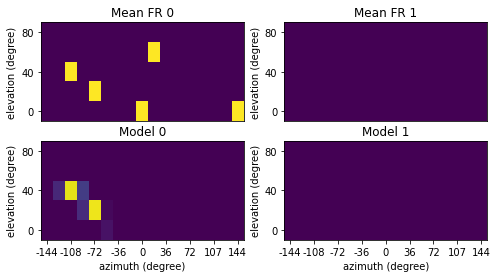

Plotting neuron 913: vmin=0, vmax=0.67
Plotting neuron 913: vmin=0, vmax=0.67


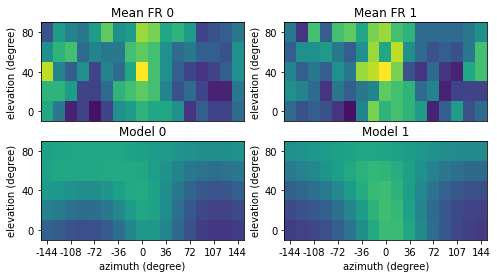

Plotting neuron 919: vmin=0, vmax=0.47
Plotting neuron 919: vmin=0, vmax=0.47


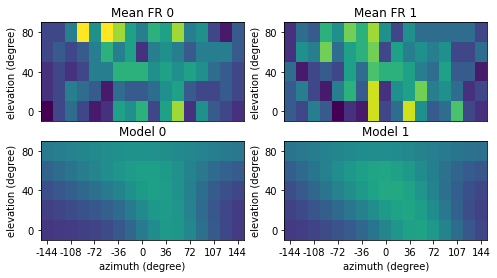

Plotting neuron 921: vmin=0, vmax=0.03
Plotting neuron 921: vmin=0, vmax=0.03


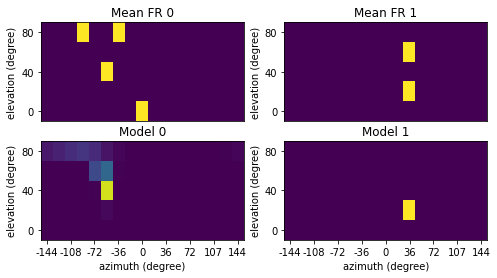

Plotting neuron 922: vmin=0, vmax=0.03
Plotting neuron 922: vmin=0, vmax=0.03


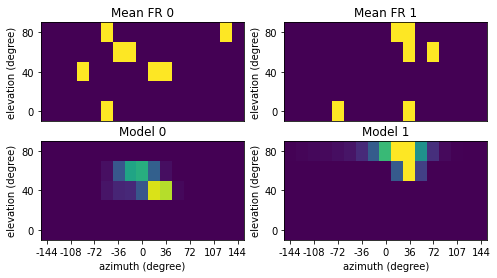

Plotting neuron 924: vmin=0, vmax=0.1
Plotting neuron 924: vmin=0, vmax=0.1


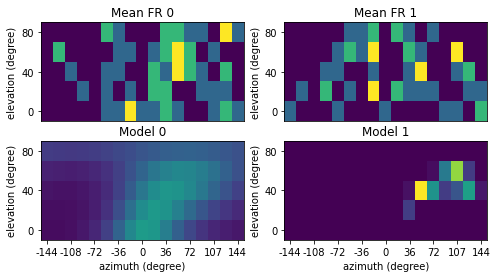

Plotting neuron 926: vmin=0, vmax=0.03
Plotting neuron 926: vmin=0, vmax=0.03


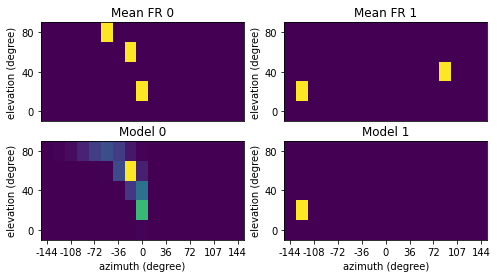

Plotting neuron 927: vmin=0, vmax=0.03
Plotting neuron 927: vmin=0, vmax=0.03


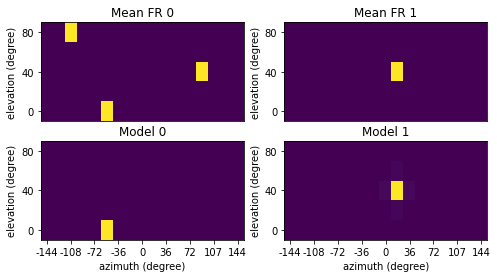

Plotting neuron 929: vmin=0, vmax=0.13
Plotting neuron 929: vmin=0, vmax=0.13


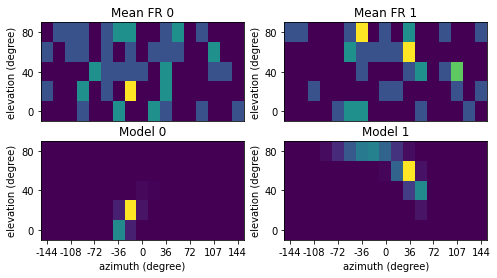

Plotting neuron 930: vmin=0, vmax=0.97
Plotting neuron 930: vmin=0, vmax=0.97


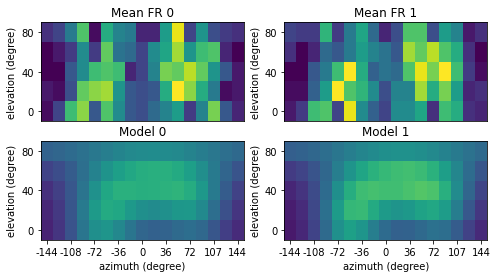

Plotting neuron 932: vmin=0, vmax=0.07
Plotting neuron 932: vmin=0, vmax=0.07


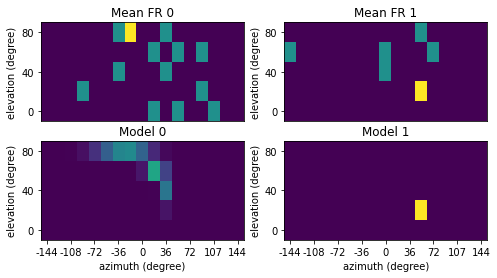

Plotting neuron 934: vmin=0, vmax=0.1
Plotting neuron 934: vmin=0, vmax=0.1


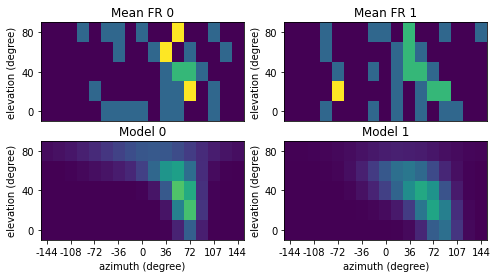

Plotting neuron 936: vmin=0, vmax=0.07
Plotting neuron 936: vmin=0, vmax=0.07


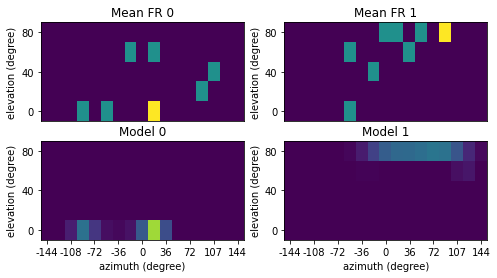

Plotting neuron 941: vmin=0, vmax=0.07
Plotting neuron 941: vmin=0, vmax=0.07


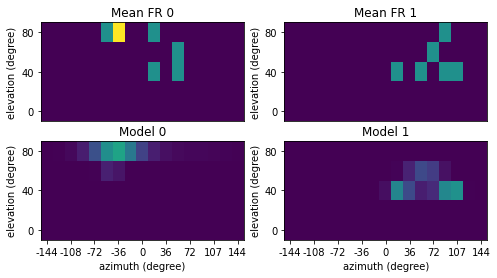

Plotting neuron 944: vmin=0, vmax=0.03
Plotting neuron 944: vmin=0, vmax=0.03


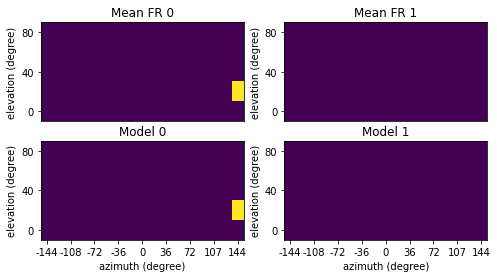

Plotting neuron 945: vmin=0, vmax=0.03
Plotting neuron 945: vmin=0, vmax=0.03


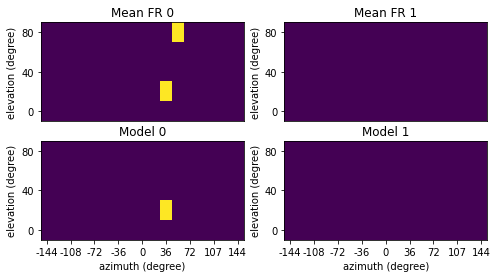

Plotting neuron 954: vmin=0, vmax=0.13
Plotting neuron 954: vmin=0, vmax=0.13


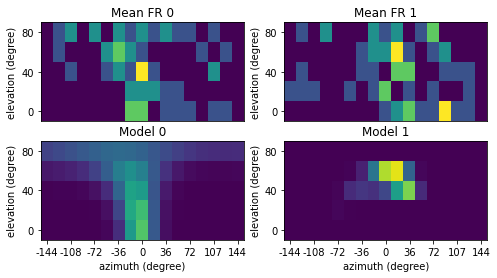

Plotting neuron 956: vmin=0, vmax=0.2
Plotting neuron 956: vmin=0, vmax=0.2


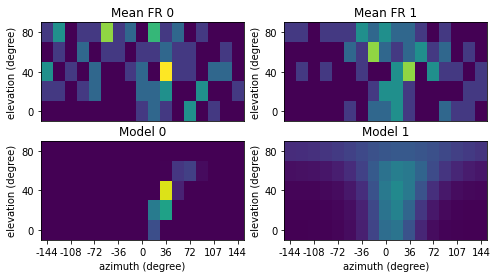

Plotting neuron 957: vmin=0, vmax=0.03
Plotting neuron 957: vmin=0, vmax=0.03


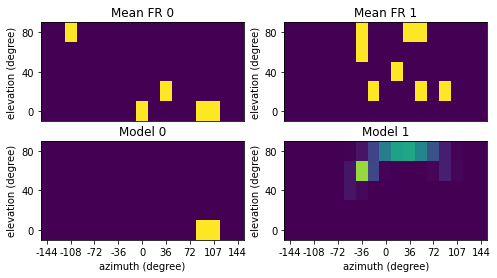

Plotting neuron 958: vmin=0, vmax=0.37
Plotting neuron 958: vmin=0, vmax=0.37


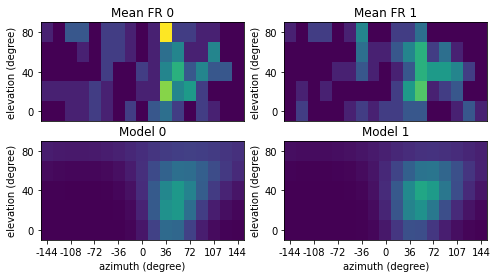

Plotting neuron 959: vmin=0, vmax=0.17
Plotting neuron 959: vmin=0, vmax=0.17


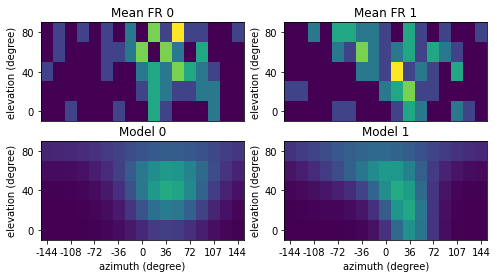

Plotting neuron 962: vmin=0, vmax=0.17
Plotting neuron 962: vmin=0, vmax=0.17


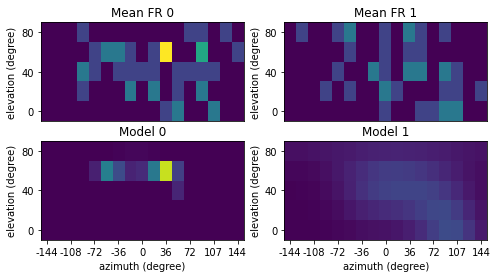

Plotting neuron 963: vmin=0, vmax=0.17
Plotting neuron 963: vmin=0, vmax=0.17


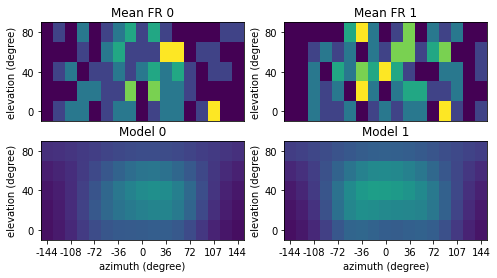

Plotting neuron 964: vmin=0, vmax=0.93
Plotting neuron 964: vmin=0, vmax=0.93


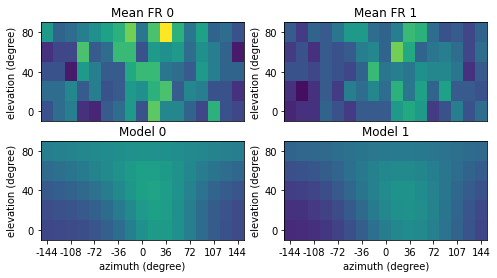

Plotting neuron 965: vmin=0, vmax=0.53
Plotting neuron 965: vmin=0, vmax=0.53


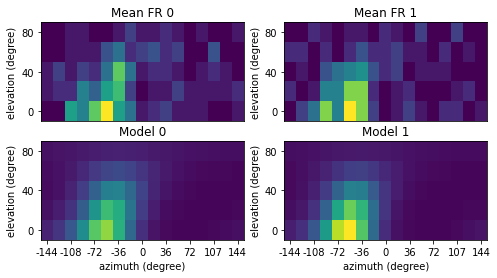

Plotting neuron 966: vmin=0, vmax=0.1
Plotting neuron 966: vmin=0, vmax=0.1


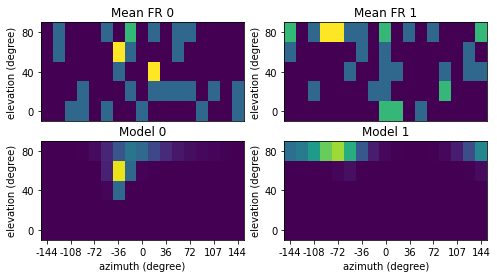

Plotting neuron 968: vmin=0, vmax=0.1
Plotting neuron 968: vmin=0, vmax=0.1


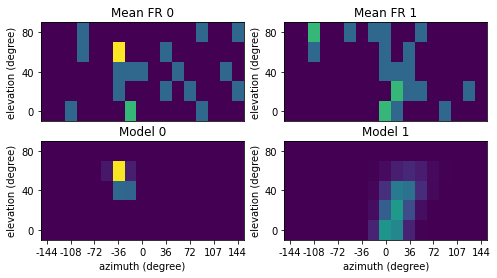

Plotting neuron 971: vmin=0, vmax=0.2
Plotting neuron 971: vmin=0, vmax=0.2


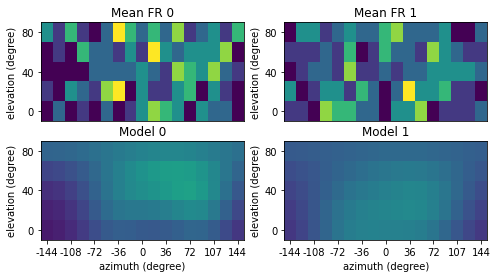

Plotting neuron 976: vmin=0, vmax=0.17
Plotting neuron 976: vmin=0, vmax=0.17


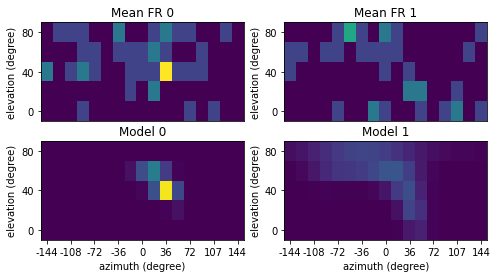

Plotting neuron 977: vmin=0, vmax=0.1
Plotting neuron 977: vmin=0, vmax=0.1


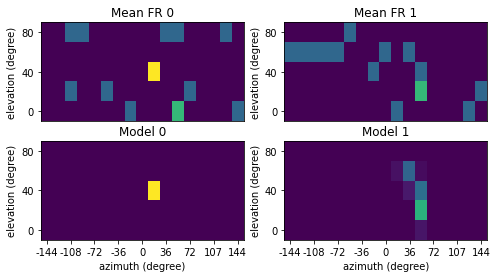

Plotting neuron 978: vmin=0, vmax=0.07
Plotting neuron 978: vmin=0, vmax=0.07


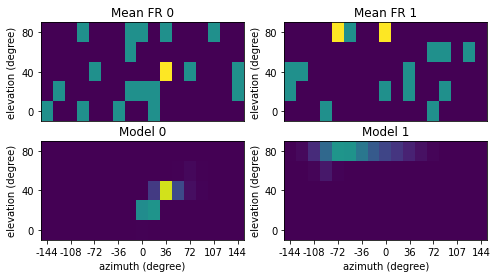

Plotting neuron 980: vmin=0, vmax=0.17
Plotting neuron 980: vmin=0, vmax=0.17


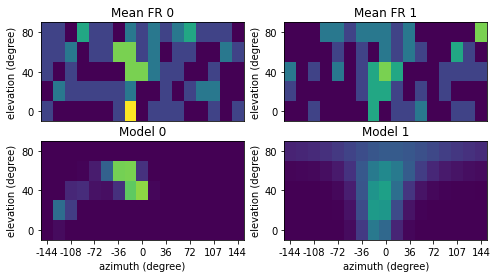

Plotting neuron 983: vmin=0, vmax=0.07
Plotting neuron 983: vmin=0, vmax=0.07


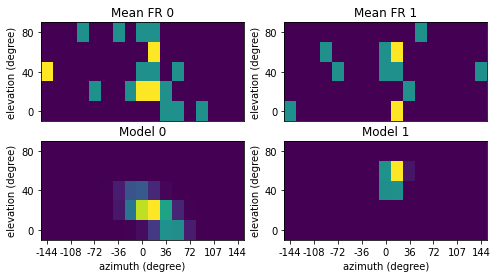

Plotting neuron 988: vmin=0, vmax=0.03
Plotting neuron 988: vmin=0, vmax=0.03


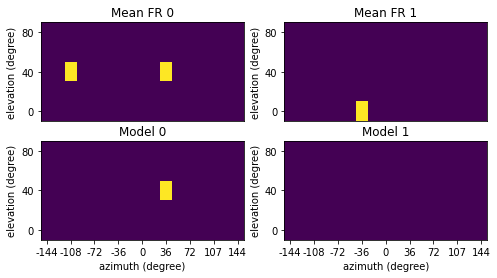

Plotting neuron 990: vmin=0, vmax=0.2
Plotting neuron 990: vmin=0, vmax=0.2


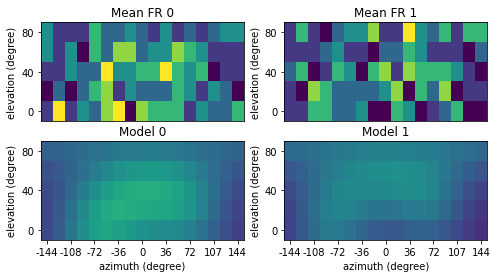

Plotting neuron 993: vmin=0, vmax=0.43
Plotting neuron 993: vmin=0, vmax=0.43


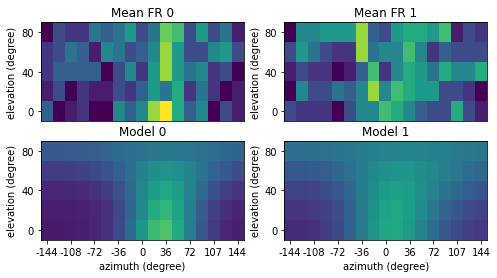

Plotting neuron 994: vmin=0, vmax=0.3
Plotting neuron 994: vmin=0, vmax=0.3


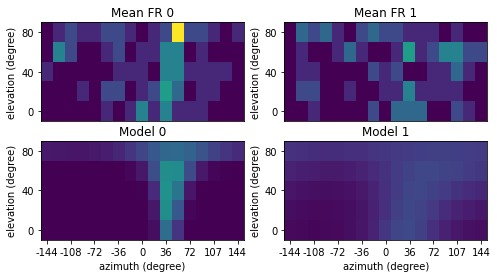

Plotting neuron 996: vmin=0, vmax=0.07
Plotting neuron 996: vmin=0, vmax=0.07


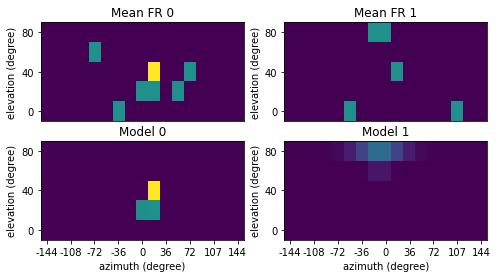

Plotting neuron 997: vmin=0, vmax=0.17
Plotting neuron 997: vmin=0, vmax=0.17


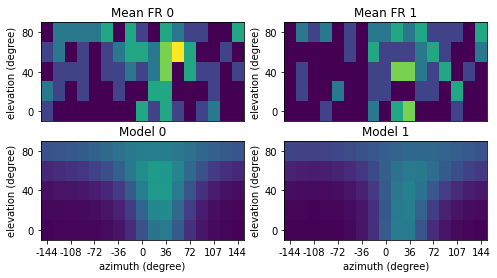

Plotting neuron 1001: vmin=0, vmax=0.03
Plotting neuron 1001: vmin=0, vmax=0.03


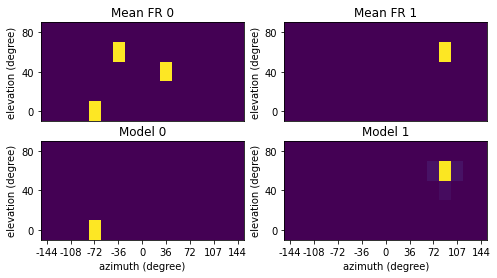

Plotting neuron 1002: vmin=0, vmax=0.03
Plotting neuron 1002: vmin=0, vmax=0.03


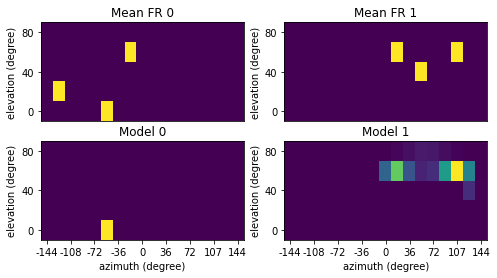

Plotting neuron 1004: vmin=0, vmax=0.93
Plotting neuron 1004: vmin=0, vmax=0.93


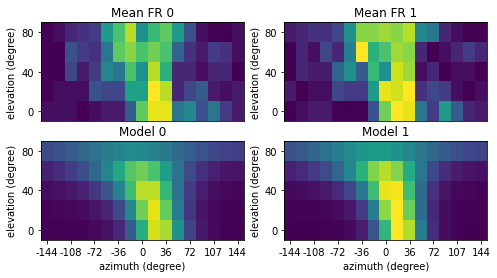

Plotting neuron 1006: vmin=0, vmax=0.43
Plotting neuron 1006: vmin=0, vmax=0.43


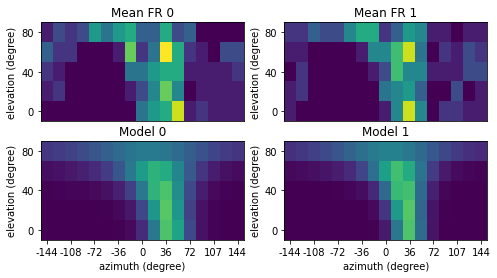

Plotting neuron 1007: vmin=0, vmax=0.1
Plotting neuron 1007: vmin=0, vmax=0.1


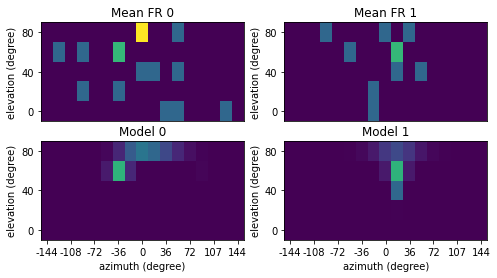

Plotting neuron 1008: vmin=0, vmax=0.07
Plotting neuron 1008: vmin=0, vmax=0.07


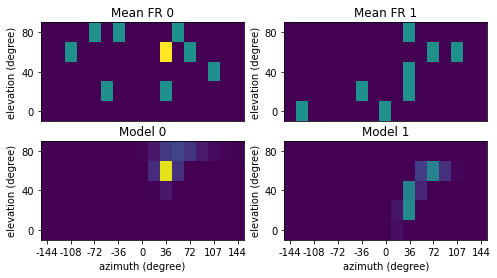

Plotting neuron 1009: vmin=0, vmax=0.03
Plotting neuron 1009: vmin=0, vmax=0.03


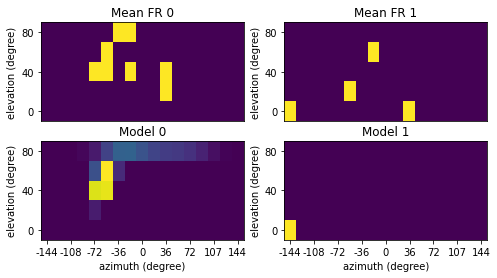

Plotting neuron 1010: vmin=0, vmax=0.07
Plotting neuron 1010: vmin=0, vmax=0.07


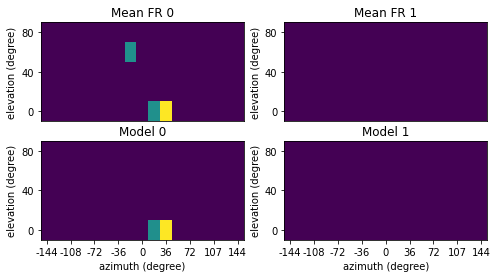

Plotting neuron 1011: vmin=0, vmax=0.2
Plotting neuron 1011: vmin=0, vmax=0.2


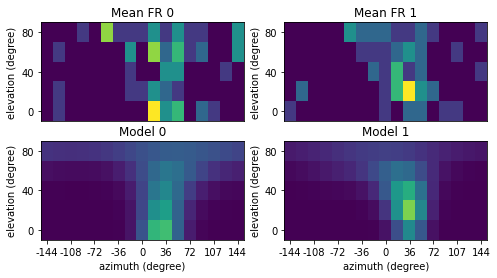

Plotting neuron 1012: vmin=0, vmax=0.1
Plotting neuron 1012: vmin=0, vmax=0.1


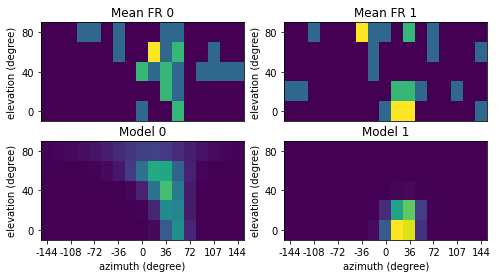

Plotting neuron 1015: vmin=0, vmax=0.13
Plotting neuron 1015: vmin=0, vmax=0.13


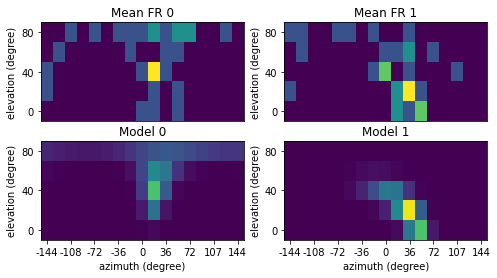

Plotting neuron 1016: vmin=0, vmax=0.1
Plotting neuron 1016: vmin=0, vmax=0.1


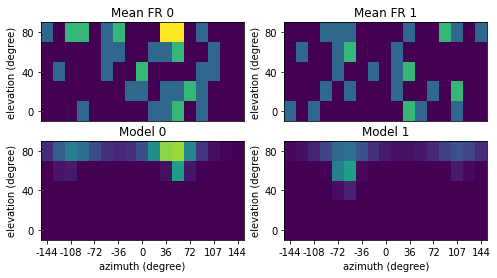

Plotting neuron 1033: vmin=0, vmax=0.07
Plotting neuron 1033: vmin=0, vmax=0.07


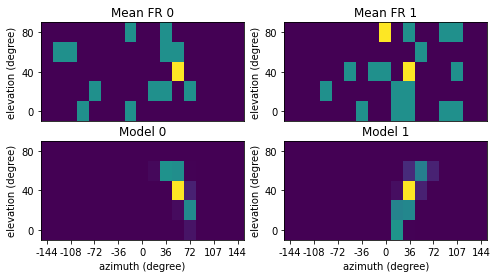

Plotting neuron 1034: vmin=0, vmax=0.13
Plotting neuron 1034: vmin=0, vmax=0.13


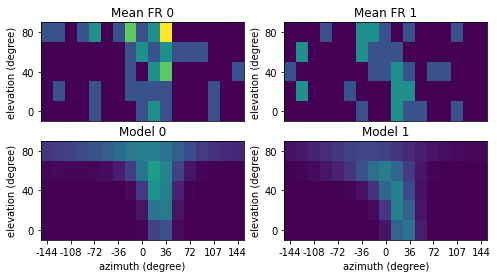

Plotting neuron 1036: vmin=0, vmax=0.03
Plotting neuron 1036: vmin=0, vmax=0.03


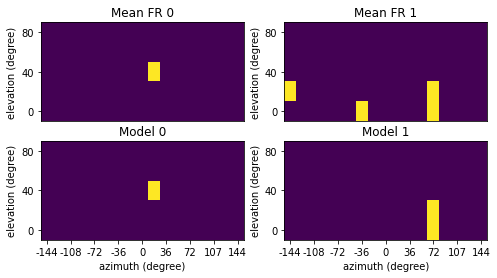

Plotting neuron 1037: vmin=0, vmax=0.03
Plotting neuron 1037: vmin=0, vmax=0.03


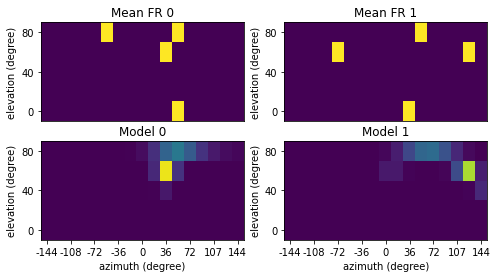

Plotting neuron 1040: vmin=0, vmax=0.93
Plotting neuron 1040: vmin=0, vmax=0.93


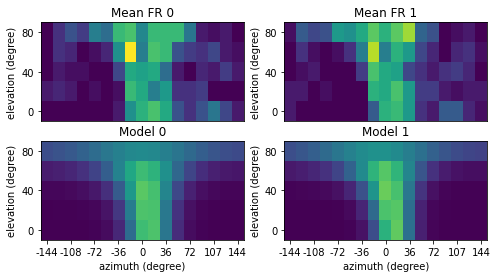

Plotting neuron 1041: vmin=0, vmax=0.03
Plotting neuron 1041: vmin=0, vmax=0.03


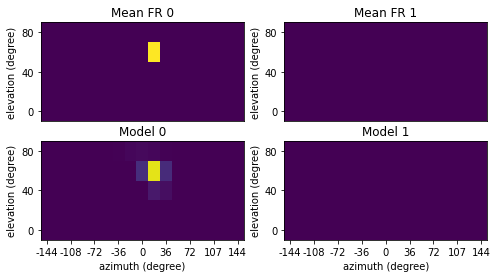

Plotting neuron 1043: vmin=0, vmax=0.03
Plotting neuron 1043: vmin=0, vmax=0.03


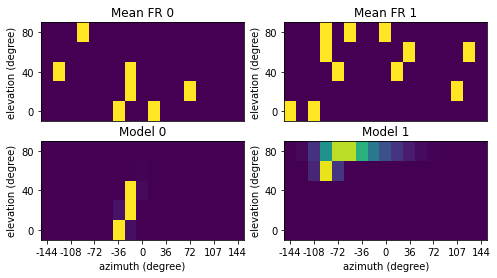

Plotting neuron 1045: vmin=0, vmax=0.03
Plotting neuron 1045: vmin=0, vmax=0.03


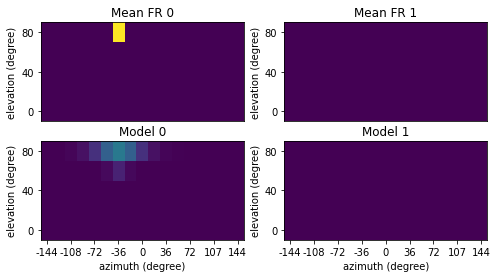

Plotting neuron 1048: vmin=0, vmax=0.07
Plotting neuron 1048: vmin=0, vmax=0.07


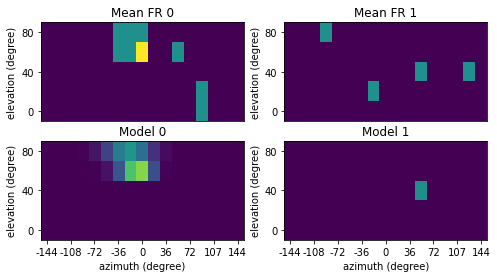

Plotting neuron 1051: vmin=0, vmax=0.07
Plotting neuron 1051: vmin=0, vmax=0.07


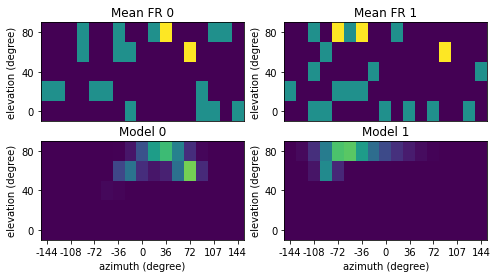

Plotting neuron 1052: vmin=0, vmax=0.03
Plotting neuron 1052: vmin=0, vmax=0.03


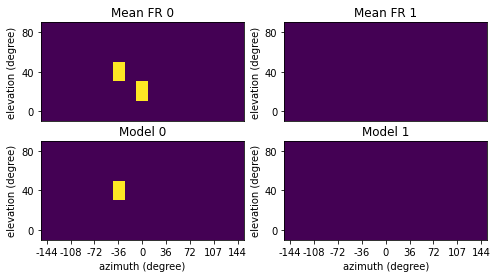

Plotting neuron 1056: vmin=0, vmax=0.03
Plotting neuron 1056: vmin=0, vmax=0.03


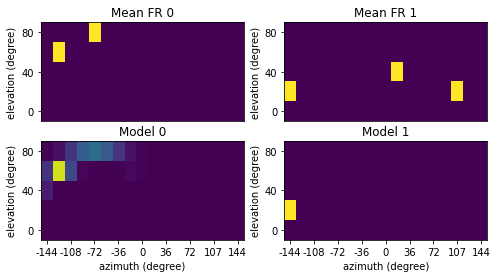

Plotting neuron 1058: vmin=0, vmax=0.03
Plotting neuron 1058: vmin=0, vmax=0.03


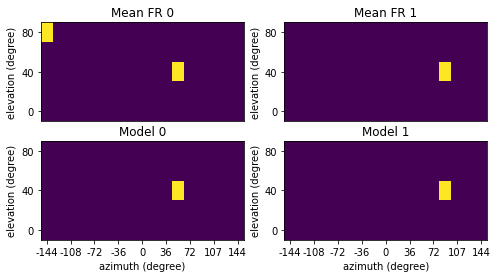

Plotting neuron 1061: vmin=0, vmax=0.03
Plotting neuron 1061: vmin=0, vmax=0.03


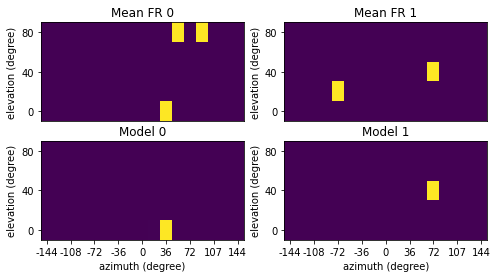

Plotting neuron 1064: vmin=0, vmax=0.9
Plotting neuron 1064: vmin=0, vmax=0.9


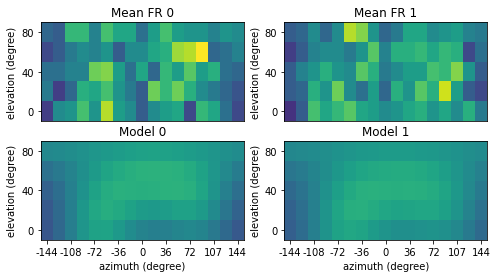

Plotting neuron 1067: vmin=0, vmax=0.03
Plotting neuron 1067: vmin=0, vmax=0.03


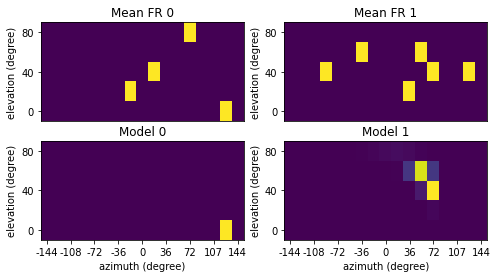

Plotting neuron 1068: vmin=0, vmax=0.47
Plotting neuron 1068: vmin=0, vmax=0.47


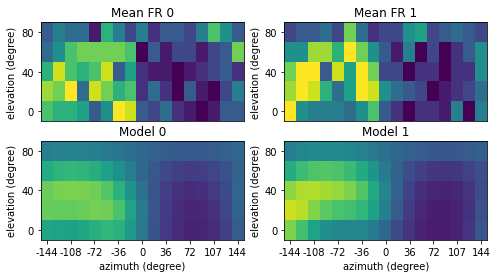

Plotting neuron 1085: vmin=0, vmax=0.77
Plotting neuron 1085: vmin=0, vmax=0.77


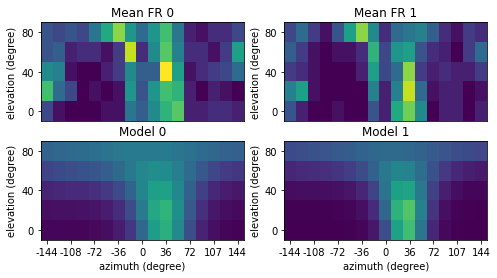

Plotting neuron 1088: vmin=0, vmax=0.07
Plotting neuron 1088: vmin=0, vmax=0.07


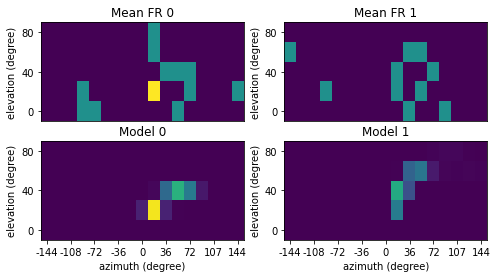

Plotting neuron 1109: vmin=0, vmax=0.03
Plotting neuron 1109: vmin=0, vmax=0.03


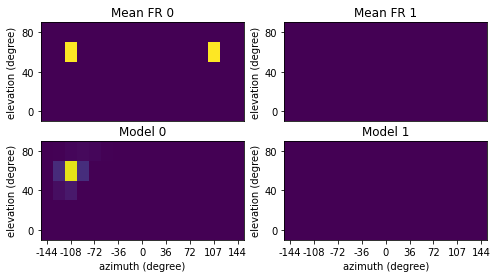

Plotting neuron 1112: vmin=0, vmax=0.03
Plotting neuron 1112: vmin=0, vmax=0.03


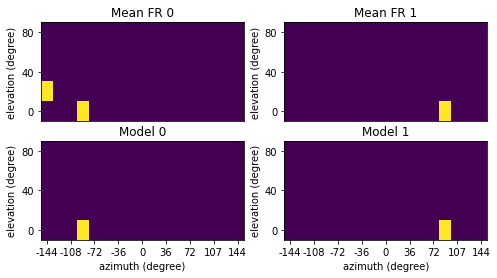

Plotting neuron 1118: vmin=0, vmax=0.07
Plotting neuron 1118: vmin=0, vmax=0.07


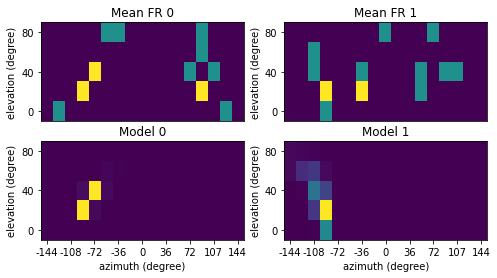

Plotting neuron 1121: vmin=0, vmax=0.1
Plotting neuron 1121: vmin=0, vmax=0.1


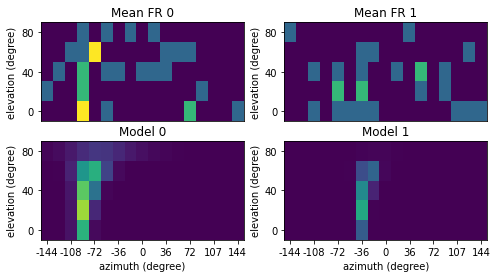

Plotting neuron 1123: vmin=0, vmax=0.03
Plotting neuron 1123: vmin=0, vmax=0.03


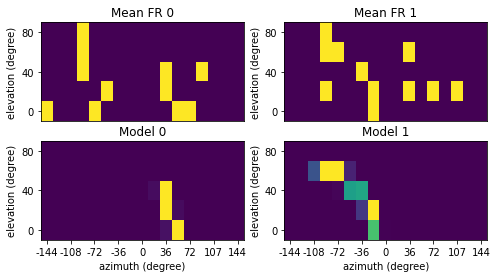

Plotting neuron 1125: vmin=0, vmax=0.07
Plotting neuron 1125: vmin=0, vmax=0.07


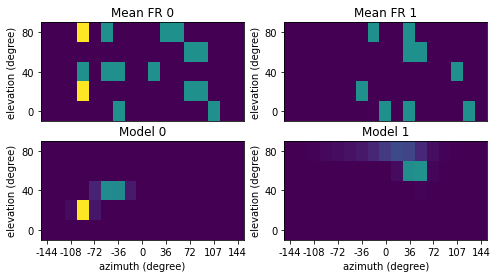

Plotting neuron 1126: vmin=0, vmax=0.07
Plotting neuron 1126: vmin=0, vmax=0.07


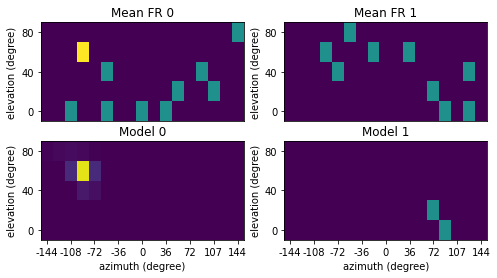

Plotting neuron 1129: vmin=0, vmax=0.07
Plotting neuron 1129: vmin=0, vmax=0.07


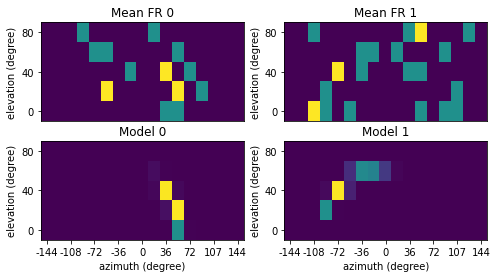

Plotting neuron 1130: vmin=0, vmax=0.07
Plotting neuron 1130: vmin=0, vmax=0.07


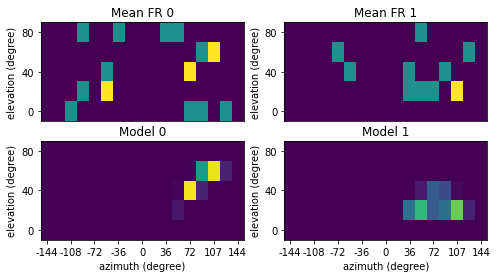

Plotting neuron 1131: vmin=0, vmax=0.03
Plotting neuron 1131: vmin=0, vmax=0.03


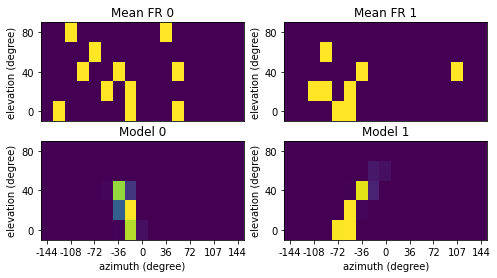

Plotting neuron 1132: vmin=0, vmax=0.07
Plotting neuron 1132: vmin=0, vmax=0.07


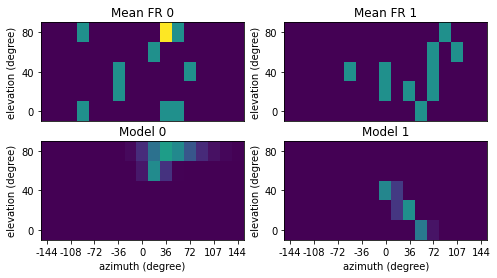

Plotting neuron 1133: vmin=0, vmax=0.03
Plotting neuron 1133: vmin=0, vmax=0.03


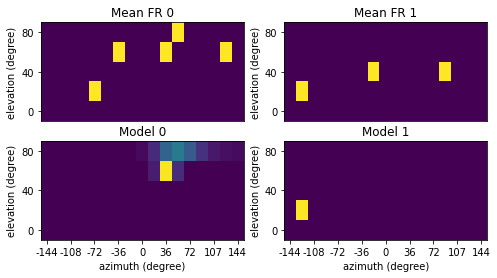

Plotting neuron 1134: vmin=0, vmax=0.03
Plotting neuron 1134: vmin=0, vmax=0.03


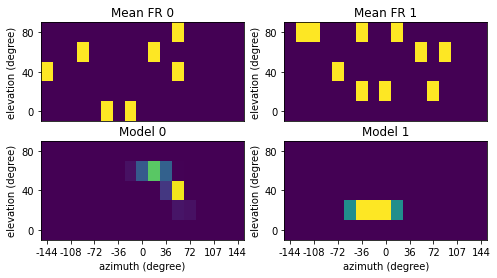

Plotting neuron 1135: vmin=0, vmax=0.07
Plotting neuron 1135: vmin=0, vmax=0.07


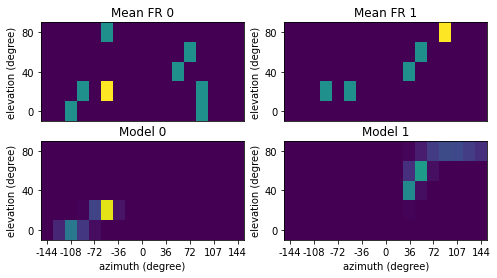

Plotting neuron 1139: vmin=0, vmax=0.03
Plotting neuron 1139: vmin=0, vmax=0.03


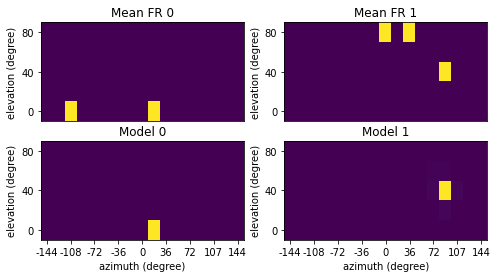

Plotting neuron 1140: vmin=0, vmax=0.1
Plotting neuron 1140: vmin=0, vmax=0.1


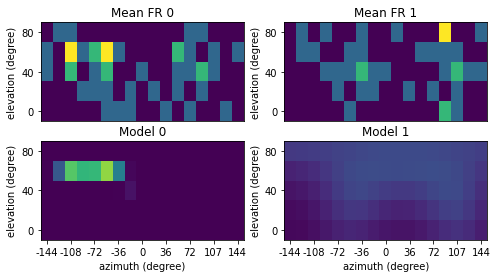

Plotting neuron 1141: vmin=0, vmax=0.07
Plotting neuron 1141: vmin=0, vmax=0.07


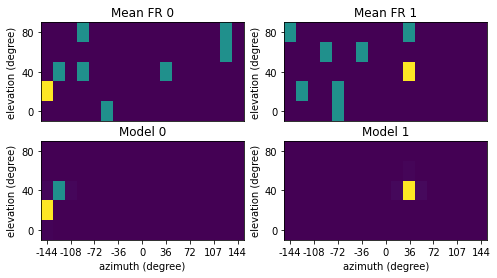

Plotting neuron 1149: vmin=0, vmax=0.03
Plotting neuron 1149: vmin=0, vmax=0.03


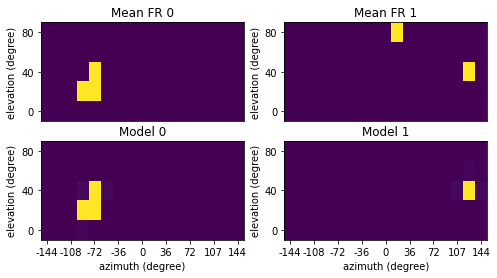

Plotting neuron 1155: vmin=0, vmax=0.03
Plotting neuron 1155: vmin=0, vmax=0.03


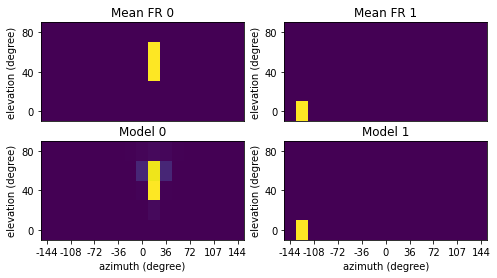

Plotting neuron 1157: vmin=0, vmax=0.03
Plotting neuron 1157: vmin=0, vmax=0.03


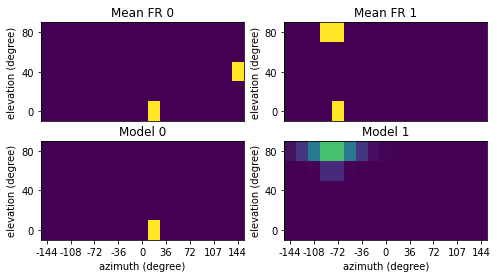

Plotting neuron 1159: vmin=0, vmax=0.07
Plotting neuron 1159: vmin=0, vmax=0.07


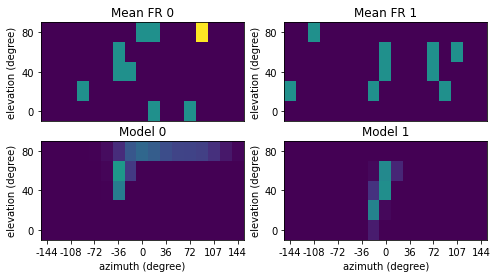

Plotting neuron 1168: vmin=0, vmax=0.87
Plotting neuron 1168: vmin=0, vmax=0.87


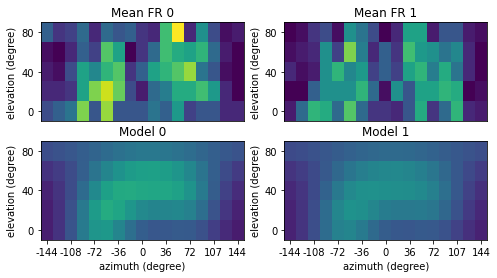

Plotting neuron 1170: vmin=0, vmax=0.1
Plotting neuron 1170: vmin=0, vmax=0.1


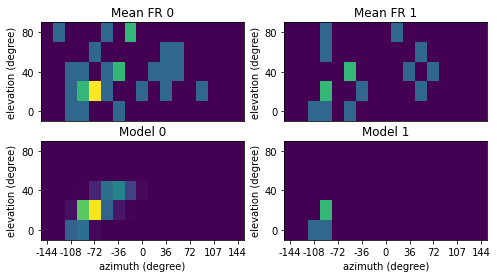

Plotting neuron 1175: vmin=0, vmax=0.07
Plotting neuron 1175: vmin=0, vmax=0.07


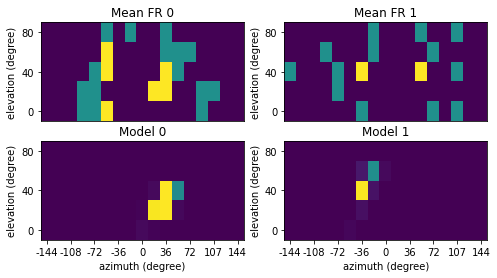

Plotting neuron 1178: vmin=0, vmax=0.53
Plotting neuron 1178: vmin=0, vmax=0.53


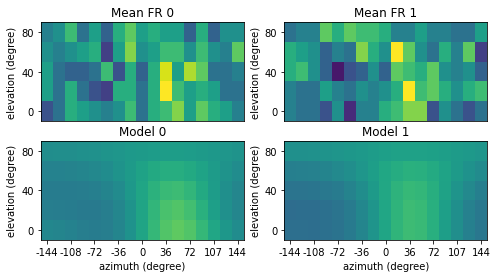

Plotting neuron 1183: vmin=0, vmax=0.03
Plotting neuron 1183: vmin=0, vmax=0.03


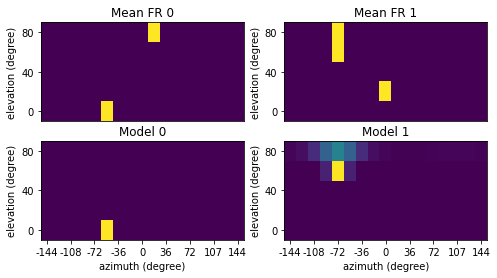

Plotting neuron 1185: vmin=0, vmax=0.07
Plotting neuron 1185: vmin=0, vmax=0.07


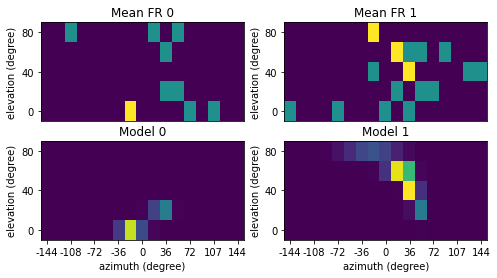

Plotting neuron 1186: vmin=0, vmax=0.03
Plotting neuron 1186: vmin=0, vmax=0.03


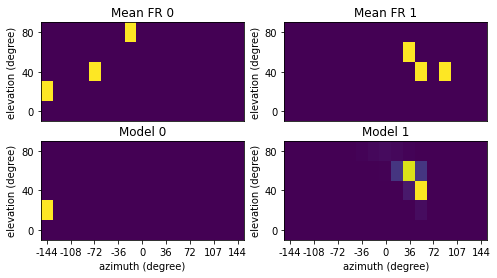

Plotting neuron 1192: vmin=0, vmax=0.03
Plotting neuron 1192: vmin=0, vmax=0.03


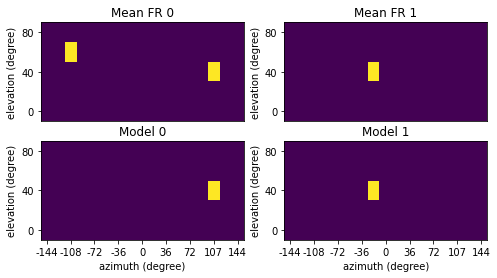

Plotting neuron 1210: vmin=0, vmax=0.7
Plotting neuron 1210: vmin=0, vmax=0.7


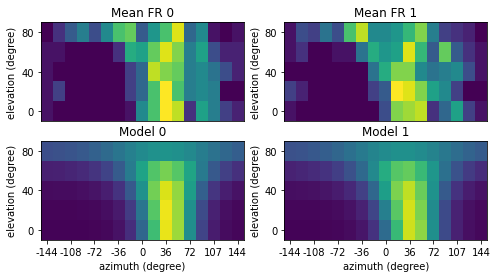

Plotting neuron 1211: vmin=0, vmax=0.47
Plotting neuron 1211: vmin=0, vmax=0.47


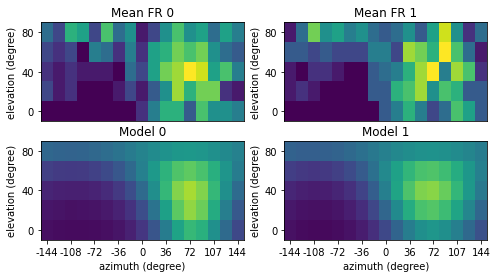

Plotting neuron 1212: vmin=0, vmax=0.3
Plotting neuron 1212: vmin=0, vmax=0.3


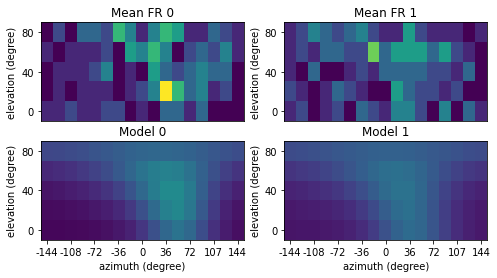

Plotting neuron 1213: vmin=0, vmax=0.03
Plotting neuron 1213: vmin=0, vmax=0.03


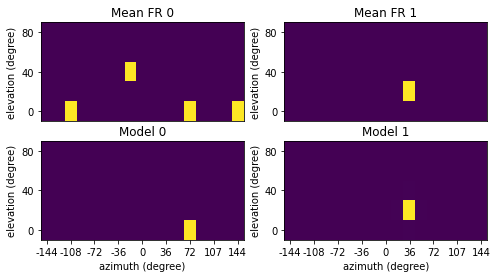

Plotting neuron 1217: vmin=0, vmax=0.93
Plotting neuron 1217: vmin=0, vmax=0.93


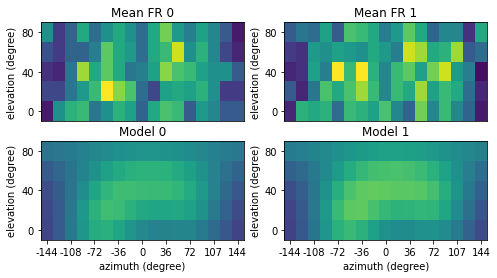

In [61]:
goodneur = np.where(aic[:,0,0] > aic[:,0,1])[0]
n_audresp  = aic.shape[0] - np.sum(aic[:,0,0]==0)
print('Number of neurons with RF of auditory responsive neurons: {0}/{1} {2}%'.format(goodneur.shape[0], 
                n_audresp, np.round(goodneur.shape[0]/n_audresp*100,2)))
savedir = '/media/feldheimlab/E82E-1525/240131 labmeeting/'
# nois =[6, 24, 61, 100, 154, 155]
save = False
for neur in goodneur:
    fig, axs =  plt.subplots(2,2, figsize=(8,4))
    vmax = np.max(data_fits[neur,0])
    vmin = 0
    for l in laser:
        print('Plotting neuron {0}: vmin={1}, vmax={2}'.format(neur, vmin, np.round(vmax,2)))
        axs[0][l].imshow(data_fits[neur, l][::-1], vmax=vmax, vmin=vmin, aspect='auto')
        axs[0][l].title.set_text('Mean FR {}'.format(l))
        axs[0][l].set_yticks([4,2,0])
        axs[0][l].set_yticklabels([0,40,80])
        axs[0][l].set_xticks([])
        axs[0][l].set_ylabel('elevation (degree)')   

        axs[1][l].imshow(modelfits[neur, l][::-1], vmax=vmax, vmin=vmin, aspect='auto')
        axs[1][l].title.set_text('Model {}'.format(l))
        axs[1][l].set_yticks([4,2,0])
        axs[1][l].set_yticklabels([0,40,80])
        axs[1][l].set_xticks(np.arange(17)[::2])
        axs[1][l].set_xticklabels((-1*180*azim[::2]//np.pi).astype(int))
        axs[1][l].set_ylabel('elevation (degree)')   
        axs[1][l].set_xlabel('azimuth (degree)')
    if save:
        plt.savefig(savedir + 'neuron-{}_rf_.png'.format(neur))    
    plt.show()

# Visualize azmuthal paramter fit vs AP location

(1, 164)
(45, 2, 6)



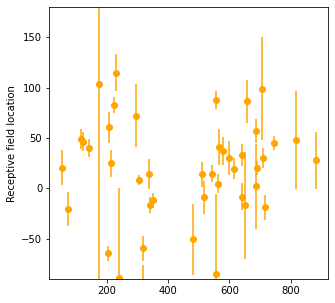

6 39.92651476694892 40.84157634849164
24 -97.83200990564822 -65.07196529300961
61 103.68936755111167 4.032334663378482
100 30.015421208649585 24.933945102045847
154 56.89209189115943 57.85118413660382
155 -174.42200284915057 70.80082768367716


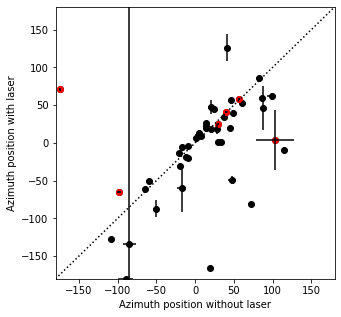

In [93]:

def rotate(origin, point, angle):
    """
    Rotate a point counterclockwise by a given angle around a given origin.

    The angle should be given in radians.
    """
    ox, oy = origin
    px, py = point

    qx = ox + math.cos(angle) * (px - ox) - math.sin(angle) * (py - oy)
    qy = oy + math.sin(angle) * (px - ox) + math.cos(angle) * (py - oy)
    return qx, qy


print(basicinfo['y'].shape)
print(parameters[goodneur].shape)
print()

fig, axs = plt.subplots(1,1, figsize = (5,5), sharey=True)

newx, newy = rotate([0,0], [np.squeeze(basicinfo['y'])[goodneur], np.squeeze(basicinfo['x'])[goodneur]], 25*np.pi/180)

# axs[0].scatter(chanposition[:,0], chanposition[:,1], facecolors='None', edgecolors='k')
# axs.errorbar(basicinfo['y'][goodneur], parameters[goodneur, 3], yerr = 0.1,#np.sqrt(variances[goodneur,3]), 
#                 c='black', linestyle='none')
axs.errorbar(newy, -1*180/np.pi*np.squeeze(parameters[goodneur, 0, 3]), yerr = np.sqrt(180/np.pi*variances[goodneur, 0, 3]), 
                c='orange', linestyle='none')
axs.scatter(newy, -1*180/np.pi*parameters[goodneur, 0, 3], c='orange')
axs.set_ylim(-90,180)
axs.set_ylabel('Receptive field location')
plt.show()
fig, axs = plt.subplots(1,1, figsize = (5,5), sharey=True)


newx, newy = rotate([0,0], [np.squeeze(basicinfo['y'])[goodneur], np.squeeze(basicinfo['x'])[goodneur]], 25*np.pi/180)

# axs[0].scatter(chanposition[:,0], chanposition[:,1], facecolors='None', edgecolors='k')
# axs.errorbar(basicinfo['y'][goodneur], parameters[goodneur, 3], yerr = 0.1,#np.sqrt(variances[goodneur,3]), 
#                 c='black', linestyle='none')
axs.plot([-180,180],[-180,180], linestyle=':', c='k')
axs.errorbar(-1*180/np.pi*np.squeeze(parameters[goodneur, 0, 3]), -1*180/np.pi*np.squeeze(parameters[goodneur, 1, 3]), 
             xerr = np.sqrt(180/np.pi*variances[goodneur, 0, 3])/np.sqrt(85), yerr = np.sqrt(180/np.pi*variances[goodneur, 1, 3])/np.sqrt(85), 
                c='k', linestyle='none')
axs.scatter(-1*180/np.pi*parameters[goodneur, 0, 3], -1*180/np.pi*parameters[goodneur, 1, 3], c='black')

axs.scatter(-1*180/np.pi*parameters[nois, 0, 3], -1*180/np.pi*parameters[nois, 1, 3], c='red')

for noi in nois:
    print(noi, -1*180/np.pi*parameters[noi, 0, 3], -1*180/np.pi*parameters[noi, 1, 3])

axs.set_ylim(-180,180)
axs.set_xlim(-180,180)
axs.set_ylabel('Azimuth position with laser')
axs.set_xlabel('Azimuth position without laser')
# axs[1].set_xlabel('span (um)')
# axs[1].set_xlabel('FR')

plt.savefig(savedir + 'laser_nolaser_azimuthpos.png', dpi=300)
plt.show()

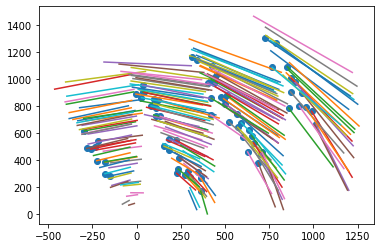

In [99]:
# verify the rotation is working properly

newx, newy = rotate([0,0], [basicinfo['y'], basicinfo['x']], 25*np.pi/180)

for neur in np.arange(nNeu):
    plt.plot([basicinfo['y'][neur], newx[neur]], [basicinfo['x'][neur], newy[neur]])

plt.scatter(newx[goodneur], newy[goodneur])
plt.show()


# Visualize the azmuthal vs elevation parameter fits, AP position in color

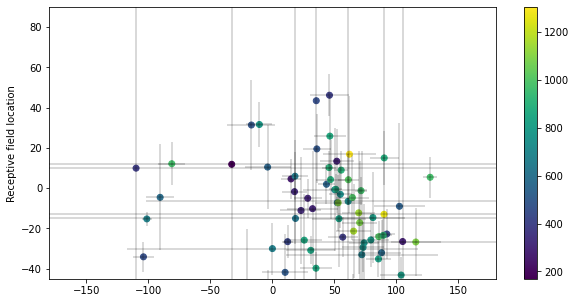

In [194]:
fig = plt.figure(figsize = (10,5))

plt.errorbar(-1*180/np.pi*parameters[goodneur, 3], 180/np.pi*parameters[goodneur, 2]-90, 
             xerr = np.sqrt(180/np.pi*variances[goodneur,3]), yerr = np.sqrt(180/np.pi*variances[goodneur,2]), 
             color = 'k', linestyle='none', alpha = 0.2)
plt.scatter(-1*180/np.pi*parameters[goodneur, 3], 180/np.pi*parameters[goodneur, 2]-90, 
            c=newy)
plt.xlim(-180,180)
plt.ylim(-45,90)
plt.colorbar()
plt.ylabel('Receptive field location')
# axs[1].set_xlabel('span (um)')
# axs[1].set_xlabel('FR')

# plt.savefig('cluster_loc_wnoise.png', dpi=300)
plt.show()


(149, 10)


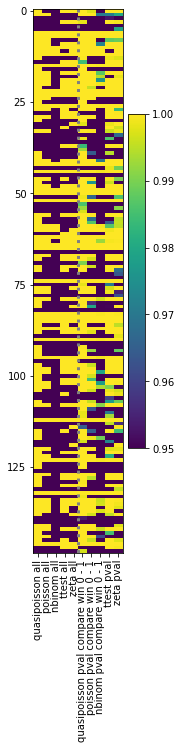

quasipoisson all : 103/149 = 69.13 %
poisson all : 65/149 = 43.62 %
nbinom all : 30/149 = 20.13 %
ttest all : 73/149 = 48.99 %
zeta all : 71/149 = 47.65 %


In [29]:
# oldpipeline = np.squeeze(aud_ids)
# activity_df['oldpipeline'] = oldpipeline

ttestpvalcopy, zetapval

activity_df['quasipoisson all'] = activity_df['quasipoisson win 0 pos'] + activity_df['quasipoisson win 0 neg'] 
activity_df['poisson all'] = activity_df['poisson win 0 pos'] + activity_df['poisson win 0 neg'] 
activity_df['nbinom all'] = activity_df['nbinom win 0 pos'] + activity_df['nbinom win 0 neg'] 
activity_df['ttest all'] = ttestpvalcopy<0.001
activity_df['zeta all'] = zetapval<0.001
activity_df['ttest pval'] = 1-ttestpvalcopy
activity_df['zeta pval'] = 1-zetapval

activity_df.loc[activity_df['quasipoisson all']==True, 'quasipoisson all'] = 1
activity_df.loc[activity_df['quasipoisson all']==False, 'quasipoisson all'] = 0
activity_df.loc[activity_df['poisson all']==True, 'poisson all'] = 1
activity_df.loc[activity_df['poisson all']==False, 'poisson all'] = 0
activity_df.loc[activity_df['nbinom all']==True, 'nbinom all'] = 1
activity_df.loc[activity_df['nbinom all']==False, 'nbinom all'] = 0
activity_df.loc[activity_df['ttest all']==True, 'ttest all'] = 1
activity_df.loc[activity_df['ttest all']==False, 'ttest all'] = 0
activity_df.loc[activity_df['zeta all']==True, 'zeta all'] = 1
activity_df.loc[activity_df['zeta all']==False, 'zeta all'] = 0

fig = plt.figure(figsize = (2,10))
allcolumns = ['quasipoisson all', 'poisson all', 'nbinom all','ttest all','zeta all',
                'quasipoisson pval compare win 0 - 1','poisson pval compare win 0 - 1',
                'nbinom pval compare win 0 - 1','ttest pval','zeta pval']
pvalcolumns = ['quasipoisson pval compare win 0 - 1','poisson pval compare win 0 - 1',
                'nbinom pval compare win 0 - 1' ]
compare = activity_df[allcolumns].copy()
compare.loc[activity_df.index, pvalcolumns] -= 0.5
compare.loc[activity_df.index, pvalcolumns] = np.abs(compare[pvalcolumns]).values
compare.loc[activity_df.index, pvalcolumns] += 0.5


comp = np.array(compare.values[:,:len(allcolumns)], dtype='float')
print()
print(comp.shape)
plt.imshow(comp, vmin = 0.95, vmax = 1, aspect='auto',interpolation='none')
plt.xticks(np.arange(len(allcolumns)), allcolumns, rotation=90)
plt.yticks(np.arange(nNeu)[::25], np.arange(nNeu)[::25])

plt.vlines([4.5], -0.5, nNeu-0.5, linestyle=':', color='grey', linewidth=3)
plt.ylim(nNeu-0.5,-0.5)
plt.colorbar()
plt.show()


totals = np.sum(comp, axis=0)
for c, column in enumerate(allcolumns[:5]):
    print('{0} : {1}/{2} = {3} %' .format(column, int(totals[c]), comp.shape[0], np.round(totals[c]/comp.shape[0]*100,2)))
